In [ ]:
import sys
import os
import time
import numpy as np
import pandas as pd
import pickle
from collections import Counter
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from imblearn.over_sampling import RandomOverSampler
from sklearn.feature_selection import f_classif
from itertools import combinations

import cupy as cp
import cudf
from cuml.linear_model import LogisticRegression as cuMLLogisticRegression


print('NOVA_HOME is at', os.getenv('NOVA_HOME'))
sys.path.insert(1, os.getenv('NOVA_HOME'))
%load_ext autoreload
%autoreload 2

from src.common.utils import load_config_file
from src.embeddings.embeddings_utils import load_embeddings
from src.analysis.analyzer_multiplex_markers import AnalyzerMultiplexMarkers
from utils import * 

### Load embeddings and labels

In [10]:
batch = 10  # You can change this value as needed
pickle_path = f"data/newNeuronsD8FigureConfig_UMAP2_B{batch}.pkl"

# Load the pickle file
with open(pickle_path, "rb") as f:
    data = pickle.load(f)

# Extract embeddings and labels
embeddings = data.get("embeddings")
labels = data.get("labels")
print(np.shape(labels), np.shape(embeddings), np.unique(labels), len(np.unique(labels)))
count_labels(labels)

(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated'] 7
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196


6: 1756
3: 1410
5: 1721
1: 533
4: 150
0: 214
2: 36
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.98      1.00      0.99        53
  FUSHomozygous_Untreated       1.00      1.00      1.00       133
   FUSRevertant_Untreated       1.00      0.78      0.88         9
           OPTN_Untreated       0.99      0.98      0.99       353
           TBK1_Untreated       1.00      0.92      0.96        38
          TDP43_Untreated       0.95      0.98      0.97       430
             WT_Untreated       0.98      0.97      0.98       440

                 accuracy                           0.98      1456
                macro avg       0.99      0.95      0.96      1456
             weighted avg       0.98      0.98      0.98      1456



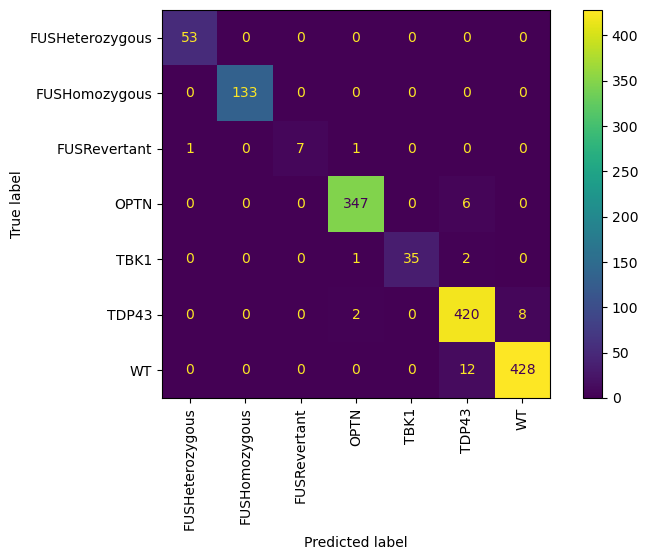

In [26]:
## 3 balance oversample, no norm

y = labels
X = embeddings

# Encode labels to integers
le = LabelEncoder()
y_encoded = le.fit_transform(y)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y)
count_labels(y_train)

balance = True
if balance: # Balance
    ros = RandomOverSampler(random_state=42)
    X_train, y_train = ros.fit_resample(X_train, y_train)

norm = True
if norm: # Normalize
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    
# Convert to GPU format
X_train = cudf.DataFrame.from_records(X_train)
X_test = cudf.DataFrame.from_records(X_test)
y_train = cudf.Series(y_train)

print('fit')
clf = cuMLLogisticRegression(verbose=1)
clf.fit(X_train, y_train)
print('predict')
y_pred = clf.predict(X_test).to_numpy()  # cupy → numpy
print(classification_report(y_test, y_pred, target_names=le.classes_))  
plot_confusion_matrix(y_test, y_pred, le)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.64      0.88      0.74      1222
  FUSHomozygous_Untreated       0.84      0.49      0.62      1245
   FUSRevertant_Untreated

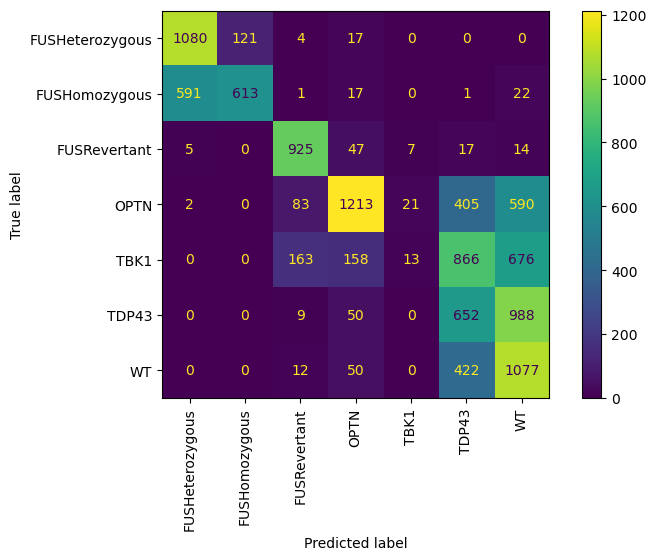

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.60      0.57      0.59      1231
  FUSHomozygous_Untreated       0.58      0.57      0.58      1162
   FUSRevertant_Untreated    

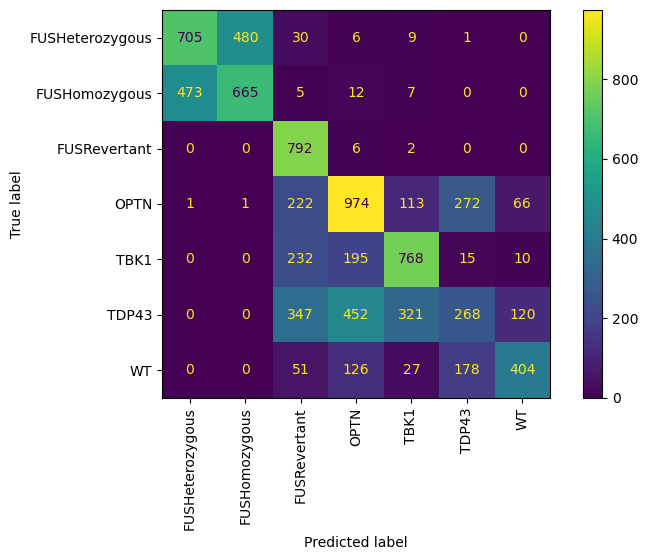

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.70      0.96      0.81      1004
  FUSHomozygous_Untreated       0.91      0.53      0.67       800
   FUSRevertant_Untreated     

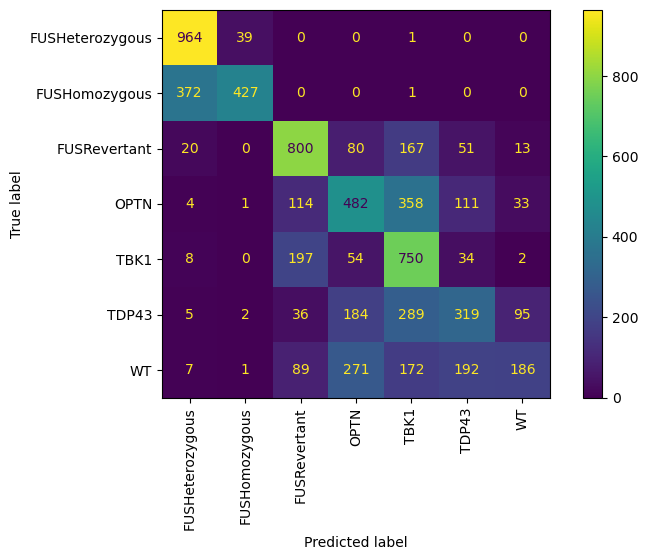

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       1.00      0.12      0.21        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

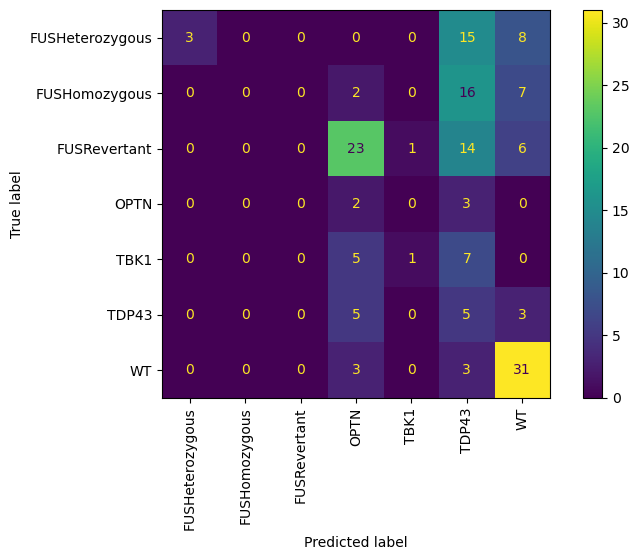

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.79      0.23      0.36      1567
  FUSHomozygous_Untreated       0.55      0.93      0.69      1562
   FUSRevertant_Untreated   

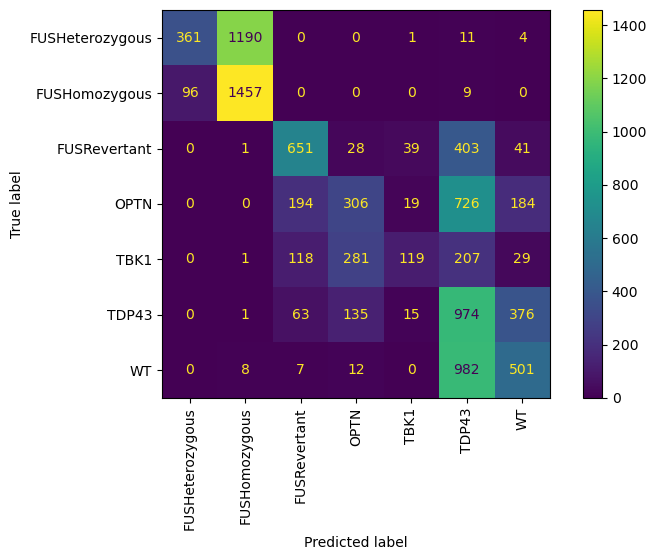

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.24      0.35      0.28       963
  FUSHomozygous_Untreated       0.25      0.47      0.32       619
   FUSRevertant_Untreated     

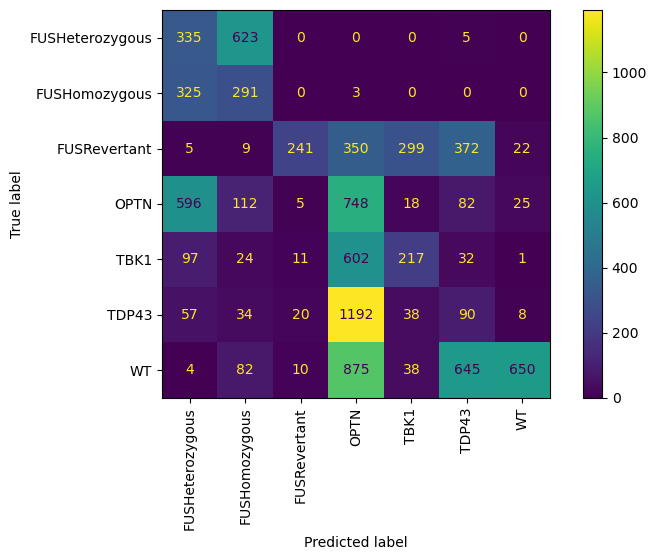

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.45      0.17      0.25       267
  FUSHomozygous_Untreated       0.74      0.92      0.82       666
   FUSRevertant_Untreated       

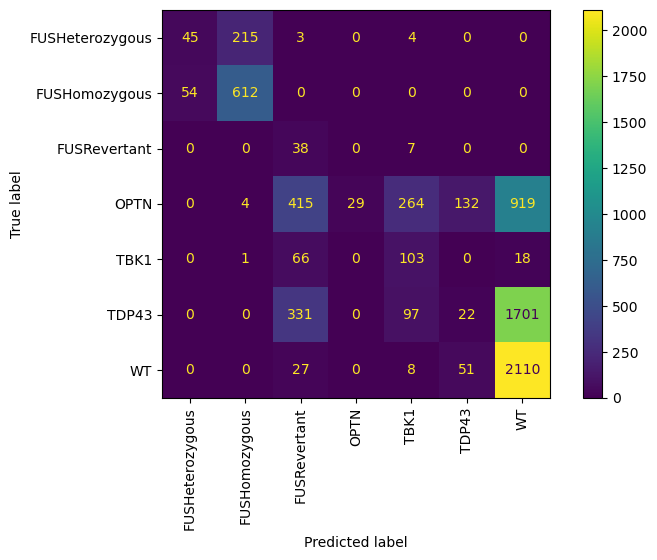

[0.5097877789974388, 0.5476304451890857, 0.5667291877074015, 0.25766871165644173, 0.4574869109947644, 0.2797780920265419, 0.4066794942275976]


In [58]:
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = True
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

Train dataset
batches [2, 3, 8, 9, 10]
(41306,) (41306, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5032
FUSHomozygous_Untreated: 4809
FUSRevertant_Untreated: 4437
OPTN_Untreated: 7530
TBK1_Untreated: 4192
TDP43_Untreated: 7592
WT_Untreated: 7714
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.64      0.89      0.75      1222
  FUSHomozygous_Untreated       0.84      0.49      0.62      1245
   FUSRevertant_Untreated   

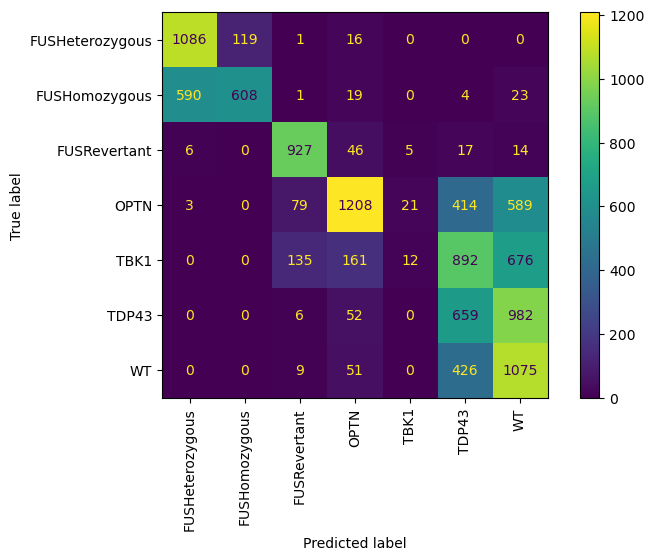

Train dataset
batches [1, 3, 8, 9, 10]
(43882,) (43882, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5023
FUSHomozygous_Untreated: 4892
FUSRevertant_Untreated: 4652
OPTN_Untreated: 8195
TBK1_Untreated: 4848
TDP43_Untreated: 7783
WT_Untreated: 8489
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.58      0.58      0.58      1231
  FUSHomozygous_Untreated       0.57      0.54      0.56      1162
   FUSRevertant_Untreated       

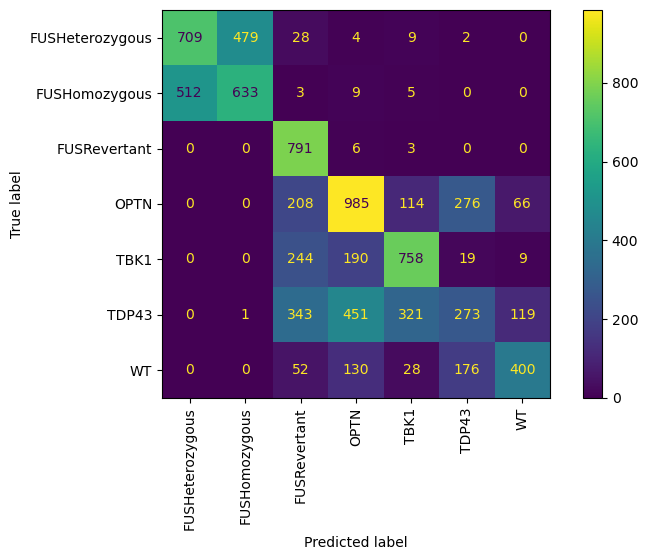

Train dataset
batches [1, 2, 8, 9, 10]
(45307,) (45307, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5250
FUSHomozygous_Untreated: 5254
FUSRevertant_Untreated: 4321
OPTN_Untreated: 8741
TBK1_Untreated: 5023
TDP43_Untreated: 8361
WT_Untreated: 8357
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.70      0.96      0.81      1004
  FUSHomozygous_Untreated       0.90      0.55      0.68       800
   FUSRevertant_Untreated       0

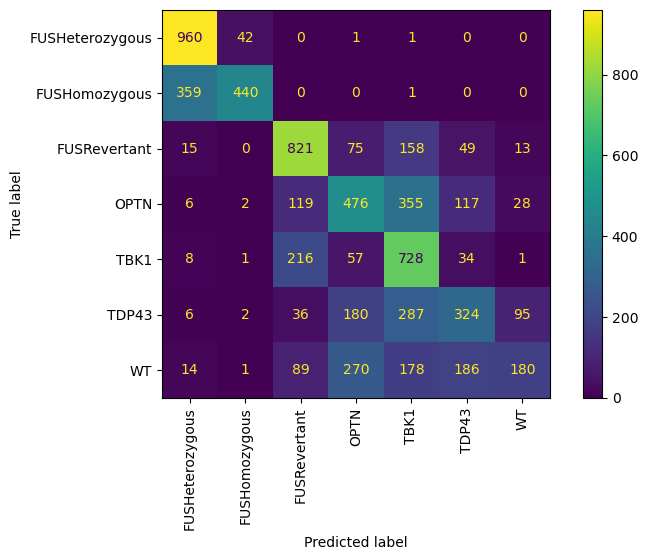

Train dataset
batches [1, 2, 3, 9, 10]
(42688,) (42688, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4687
FUSHomozygous_Untreated: 4492
FUSRevertant_Untreated: 4289
OPTN_Untreated: 8415
TBK1_Untreated: 5313
TDP43_Untreated: 7727
WT_Untreated: 7765
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.79      0.23      0.36      1567
  FUSHomozygous_Untreated       0.55      0.92      0.69      1562
   FUSRevertant_Untreated      

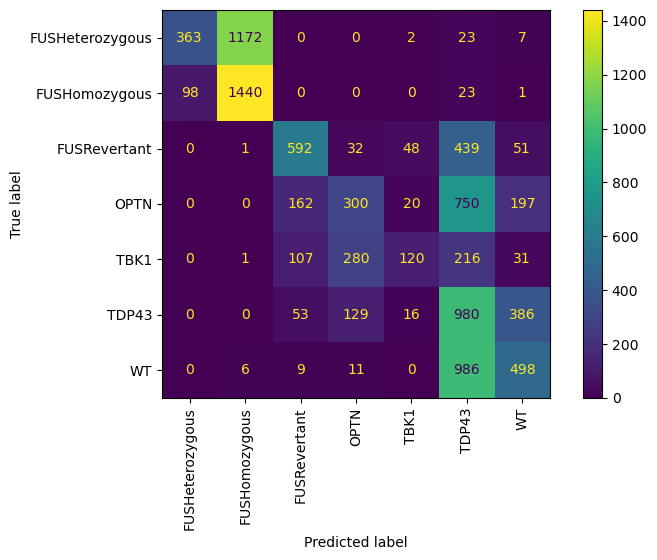

Train dataset
batches [1, 2, 3, 8, 10]
(43045,) (43045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5291
FUSHomozygous_Untreated: 5435
FUSRevertant_Untreated: 4154
OPTN_Untreated: 8258
TBK1_Untreated: 5084
TDP43_Untreated: 7852
WT_Untreated: 6971
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.22      0.36      0.28       963
  FUSHomozygous_Untreated       0.26      0.48      0.34       619
   FUSRevertant_Untreated       0

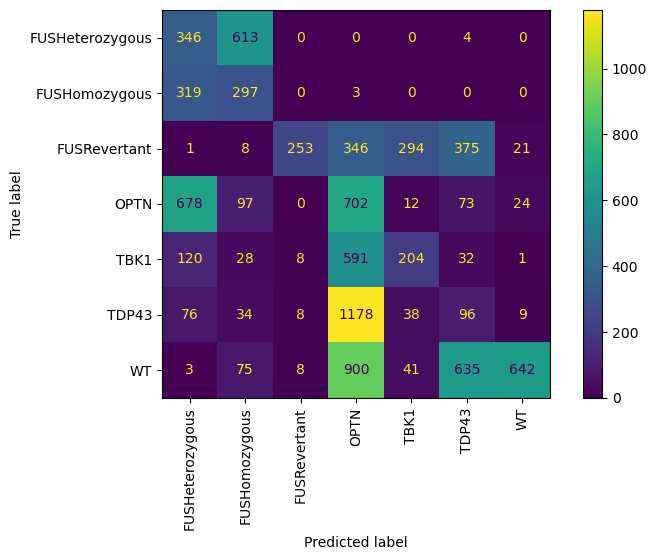

Train dataset
batches [1, 2, 3, 8, 9]
(44962,) (44962, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5987
FUSHomozygous_Untreated: 5388
FUSRevertant_Untreated: 5407
OPTN_Untreated: 8081
TBK1_Untreated: 5880
TDP43_Untreated: 7140
WT_Untreated: 7079
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.46      0.17      0.25       267
  FUSHomozygous_Untreated       0.74      0.92      0.82       666
   FUSRevertant_Untreated       0.0

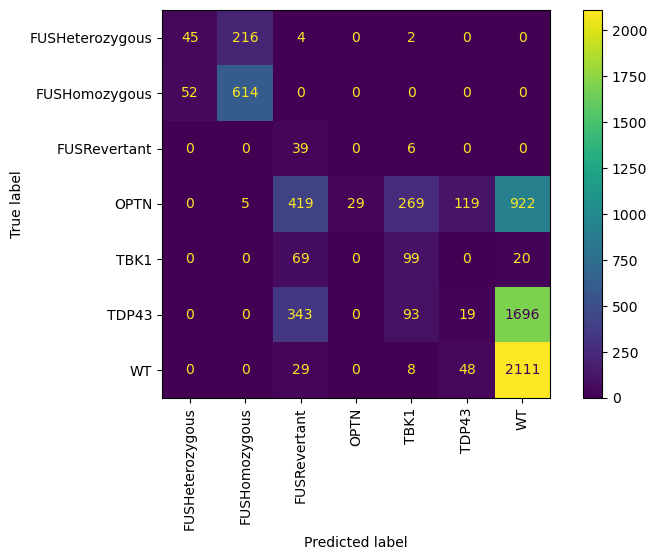

[0.5099707281375777, 0.5443992340832935, 0.5668734670321743, 0.44952879581151833, 0.2762971826389644, 0.4062671797691039]


In [59]:
## Result - does not improve

batches = [1,2,3,8,9,10] ##Remove batch 7
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = True
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.64      0.88      0.74      1222
  FUSHomozygous_Untreated       0.84      0.50      0.62      1245
   FUSRevertant_Untreated

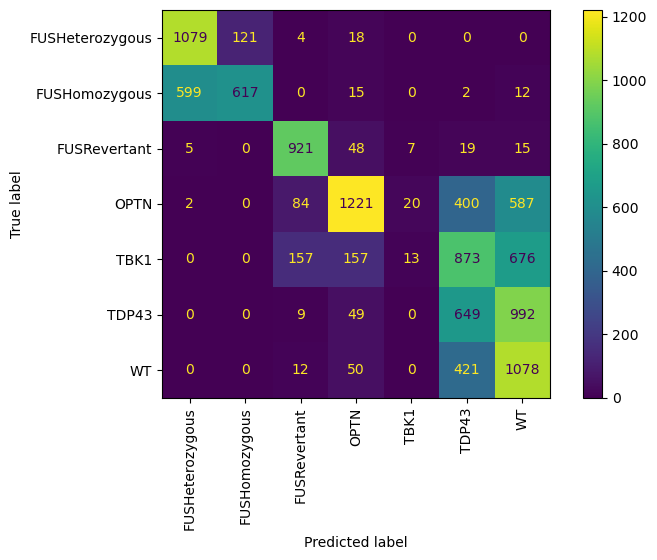

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.60      0.57      0.58      1231
  FUSHomozygous_Untreated       0.58      0.58      0.58      1162
   FUSRevertant_Untreated    

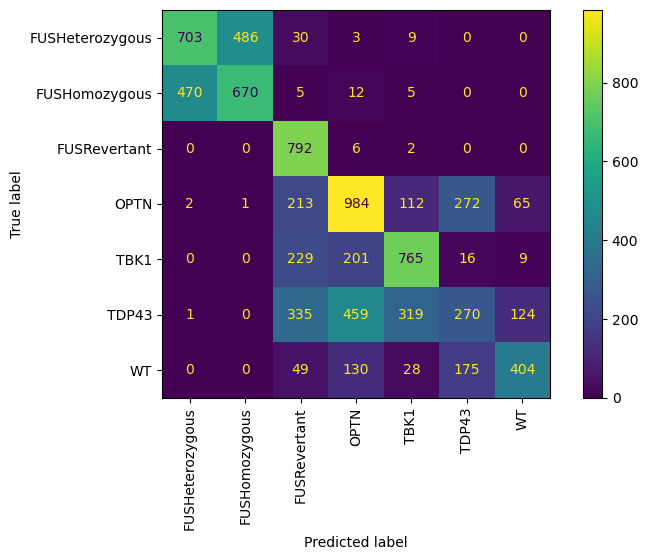

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.69      0.96      0.80      1004
  FUSHomozygous_Untreated       0.90      0.54      0.67       800
   FUSRevertant_Untreated     

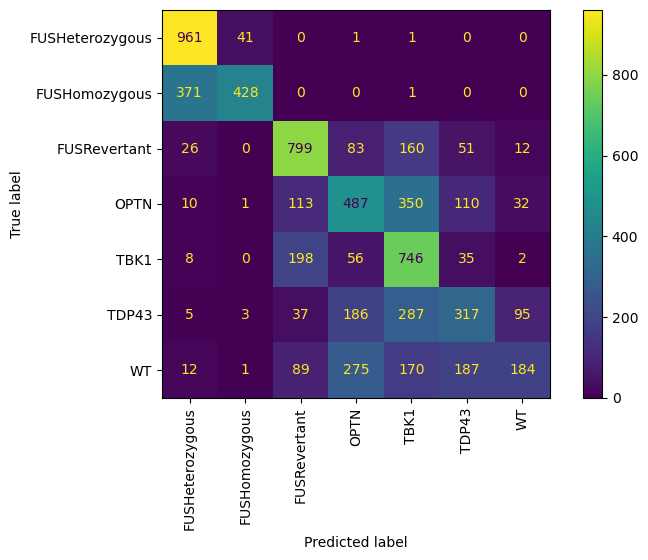

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       1.00      0.12      0.21        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

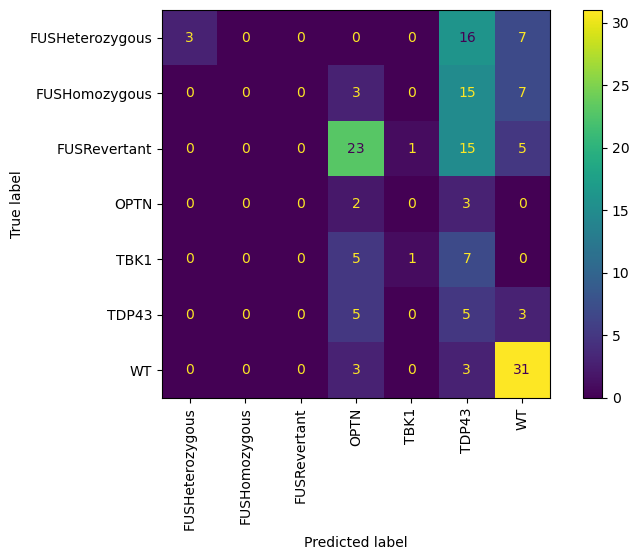

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.79      0.23      0.36      1567
  FUSHomozygous_Untreated       0.55      0.93      0.69      1562
   FUSRevertant_Untreated   

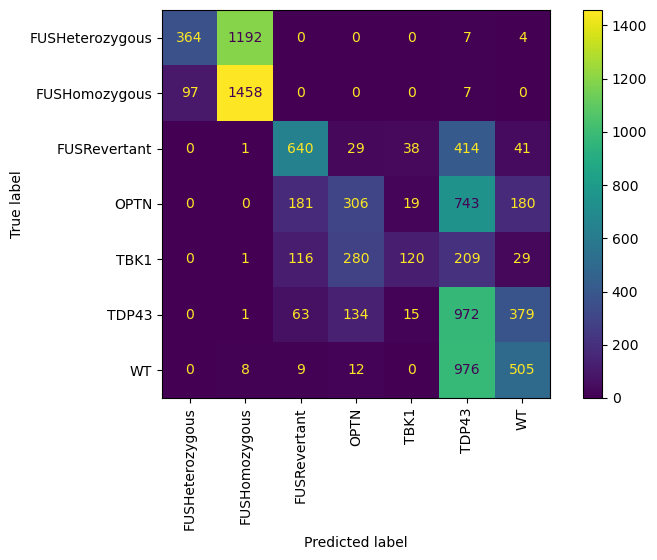

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.23      0.36      0.28       963
  FUSHomozygous_Untreated       0.25      0.46      0.32       619
   FUSRevertant_Untreated     

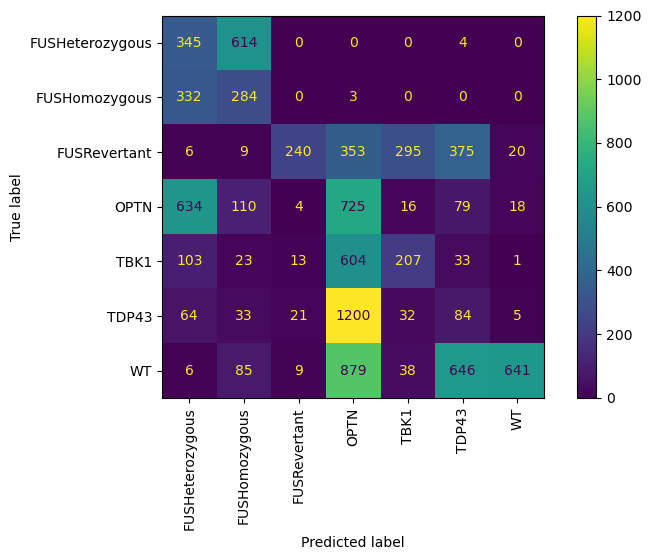

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.45      0.17      0.25       267
  FUSHomozygous_Untreated       0.73      0.92      0.82       666
   FUSRevertant_Untreated       

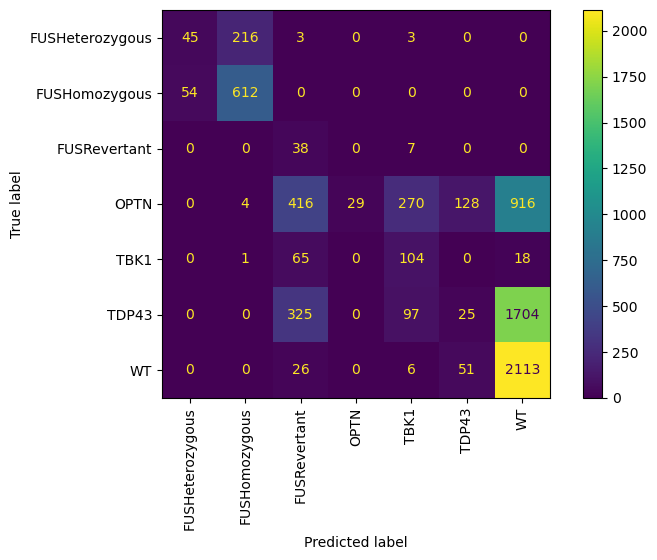

[0.5102451518477863, 0.5490665390138822, 0.5658635117587649, 0.25766871165644173, 0.4570680628272251, 0.27477428478189925, 0.4076415612974162]


In [60]:
## balance=False => minor improvment
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = True
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.65      0.92      0.77      1222
  FUSHomozygous_Untreated       0.87      0.52      0.65      1245
   FUSRevertant_Untreated

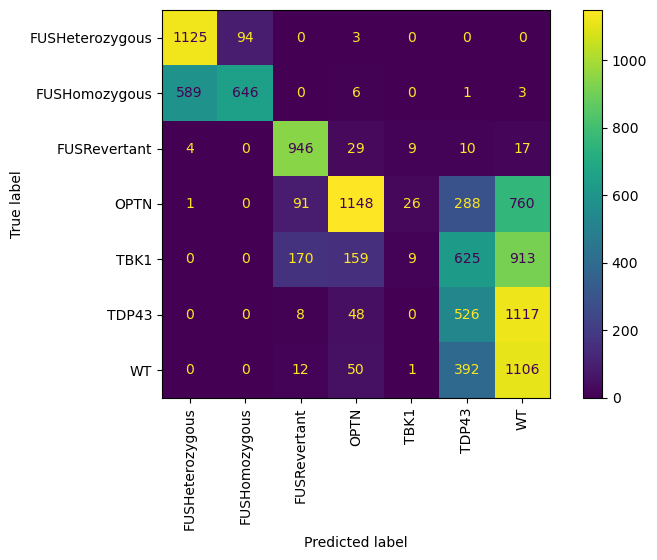

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.62      0.64      0.63      1231
  FUSHomozygous_Untreated       0.62      0.57      0.59      1162
   FUSRevertant_Untreated    

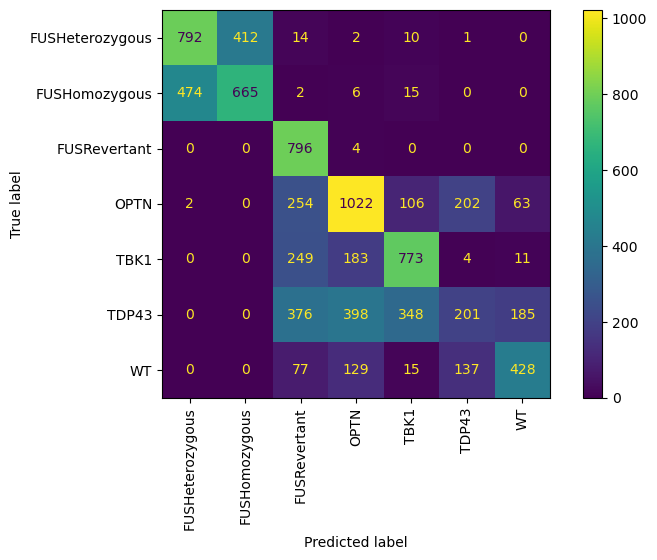

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.74      0.96      0.83      1004
  FUSHomozygous_Untreated       0.93      0.57      0.71       800
   FUSRevertant_Untreated     

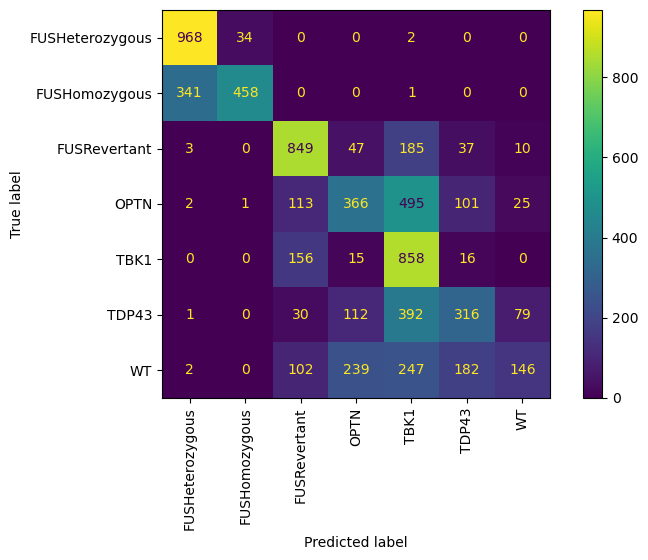

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       1.00      0.04      0.07        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

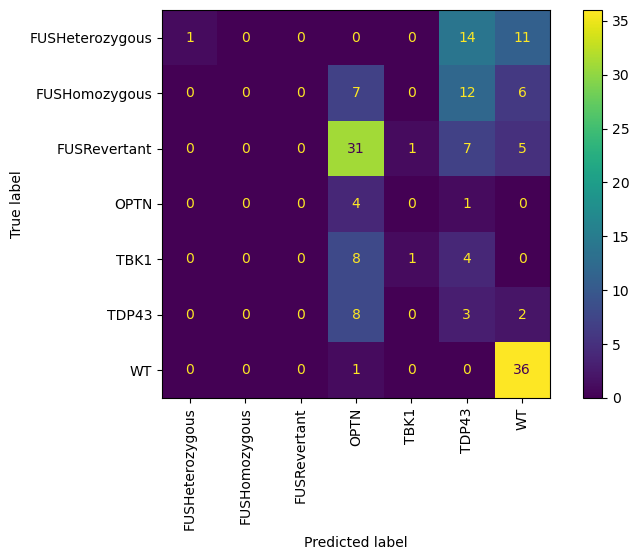

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.81      0.22      0.34      1567
  FUSHomozygous_Untreated       0.55      0.94      0.69      1562
   FUSRevertant_Untreated   

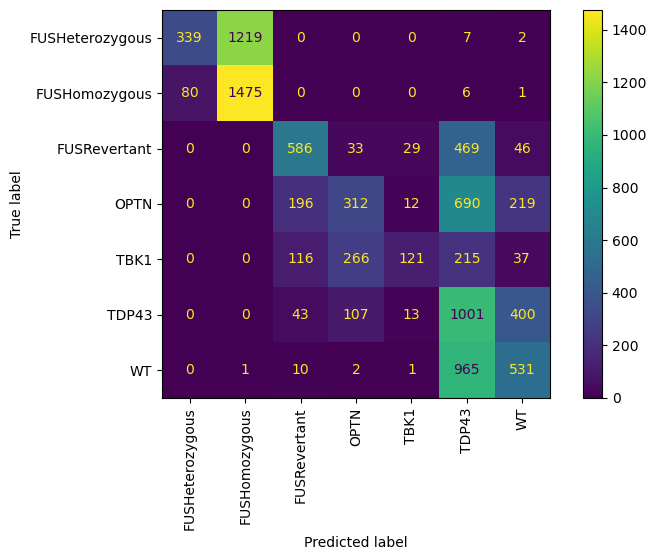

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.20      0.31      0.24       963
  FUSHomozygous_Untreated       0.27      0.52      0.36       619
   FUSRevertant_Untreated     

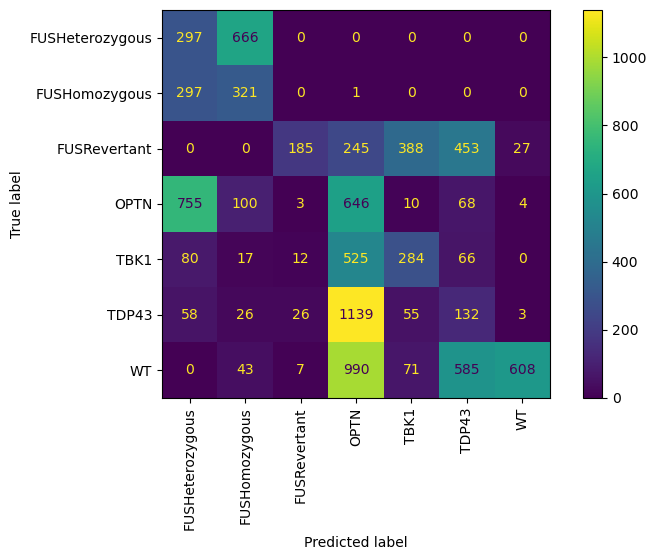

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.58      0.19      0.29       267
  FUSHomozygous_Untreated       0.75      0.94      0.84       666
   FUSRevertant_Untreated       

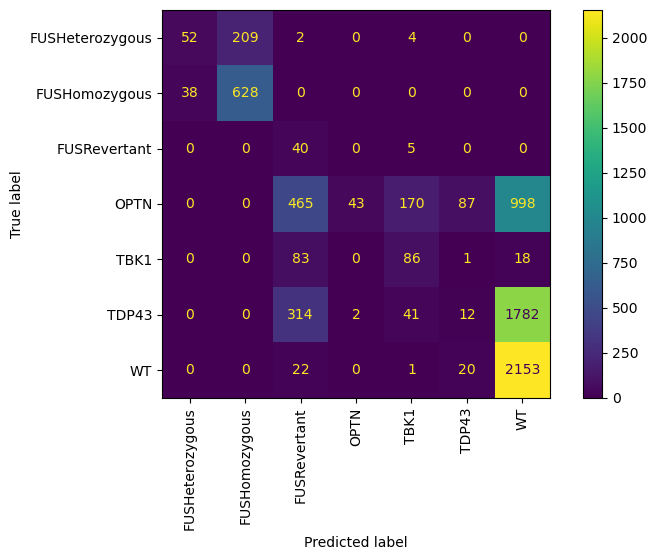

[0.5036589828027809, 0.5597175682144567, 0.5714904054249026, 0.27607361963190186, 0.4570680628272251, 0.26900902860872405, 0.41423859263331503]


In [61]:
## No norm: minor improvement

batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.66      0.92      0.77      1222
  FUSHomozygous_Untreated       0.87      0.53      0.66      1245
   FUSRevertant_Untreated

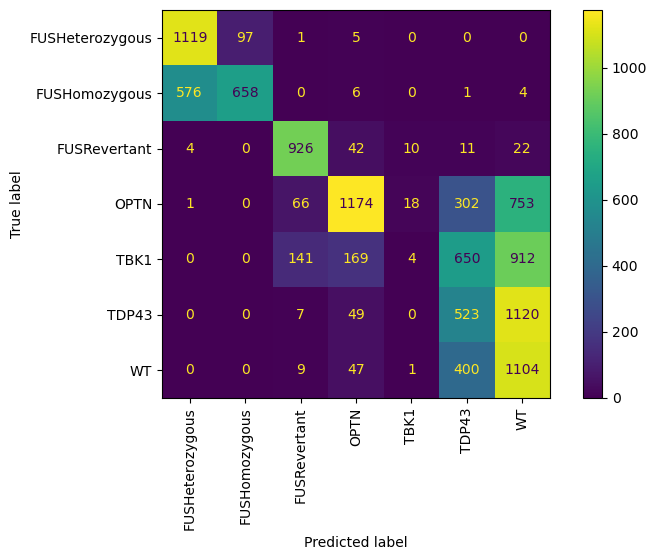

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.63      0.64      0.63      1231
  FUSHomozygous_Untreated       0.62      0.59      0.60      1162
   FUSRevertant_Untreated    

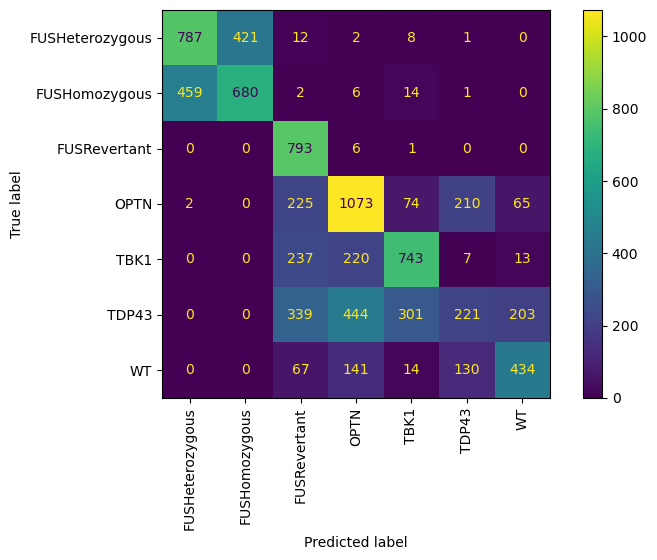

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.74      0.97      0.84      1004
  FUSHomozygous_Untreated       0.94      0.57      0.71       800
   FUSRevertant_Untreated     

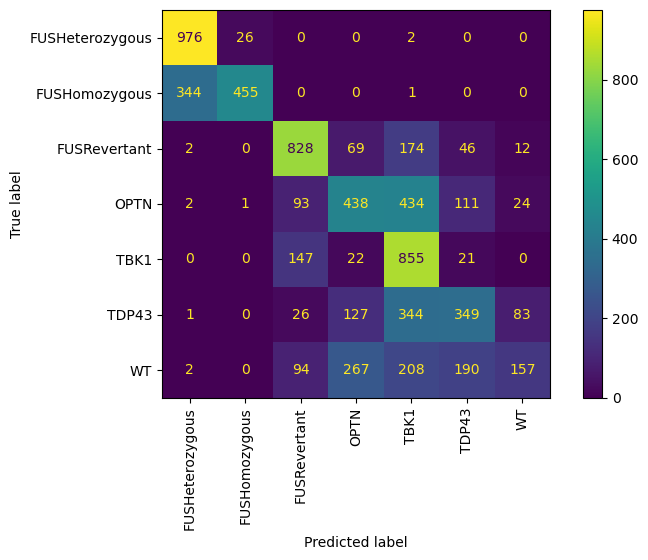

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

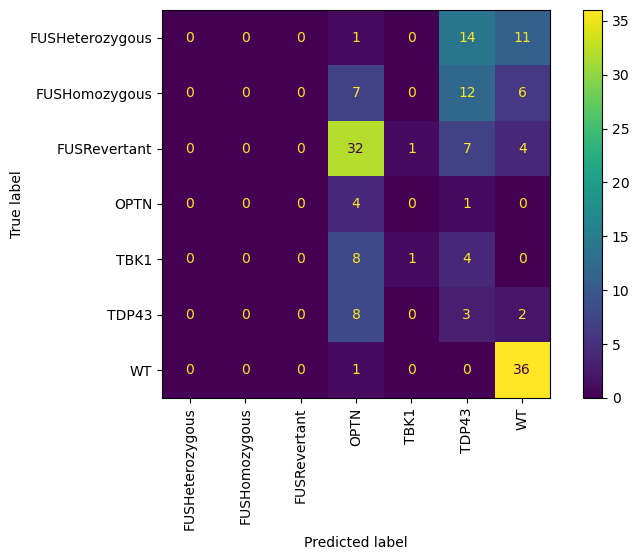

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.81      0.19      0.31      1567
  FUSHomozygous_Untreated       0.54      0.95      0.69      1562
   FUSRevertant_Untreated   

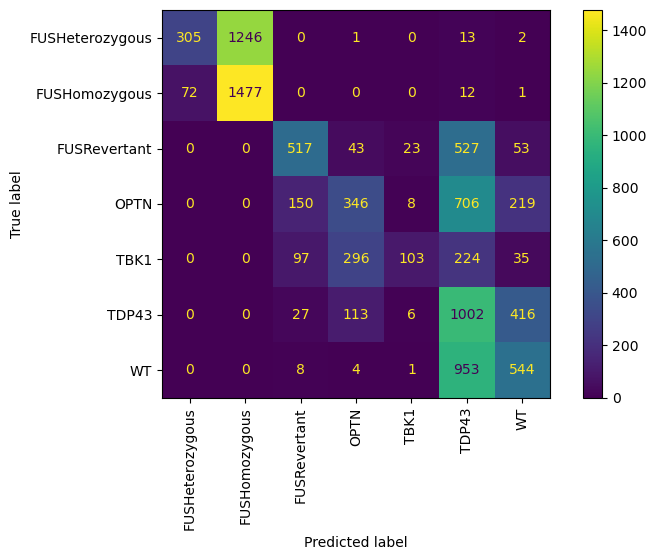

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.19      0.27      0.22       963
  FUSHomozygous_Untreated       0.28      0.53      0.37       619
   FUSRevertant_Untreated     

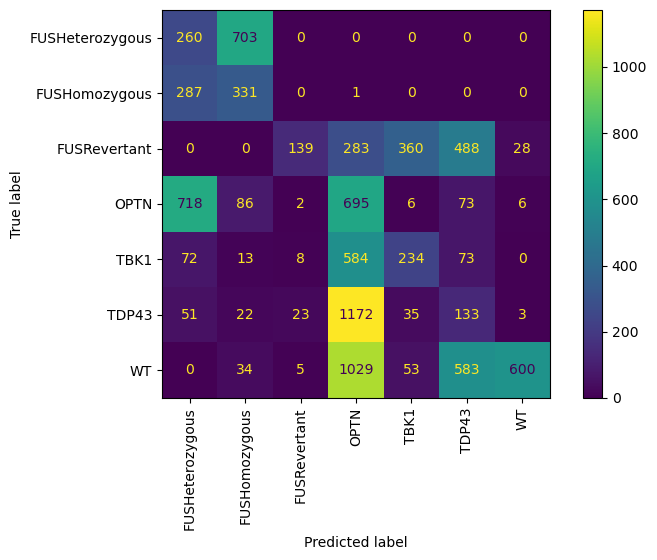

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.57      0.21      0.30       267
  FUSHomozygous_Untreated       0.75      0.94      0.84       666
   FUSRevertant_Untreated       

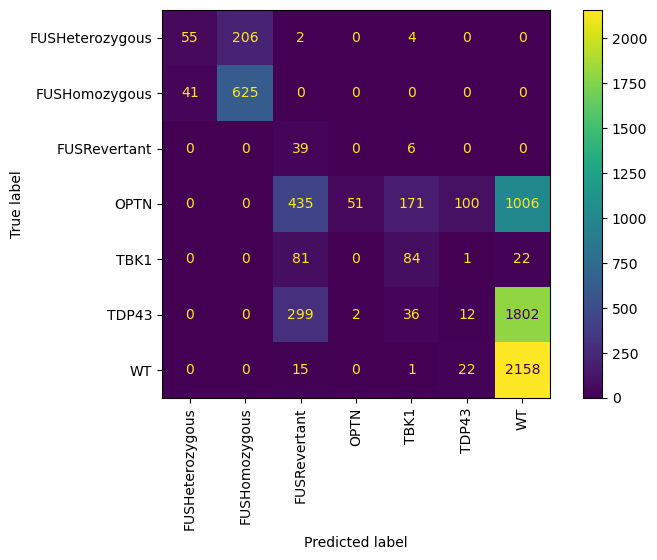

[0.5038419319429198, 0.5661799904260412, 0.5854854999278604, 0.26993865030674846, 0.4496335078534031, 0.2601979767214185, 0.4156129741616273]


In [62]:
## No norm no balance => minor improvment
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

In [ ]:
X_train, y_train = load_batches([1])

le = LabelEncoder()
y_encoded = le.fit_transform(y_train)

f_scores, p_values = f_classif(X_train, y_encoded)

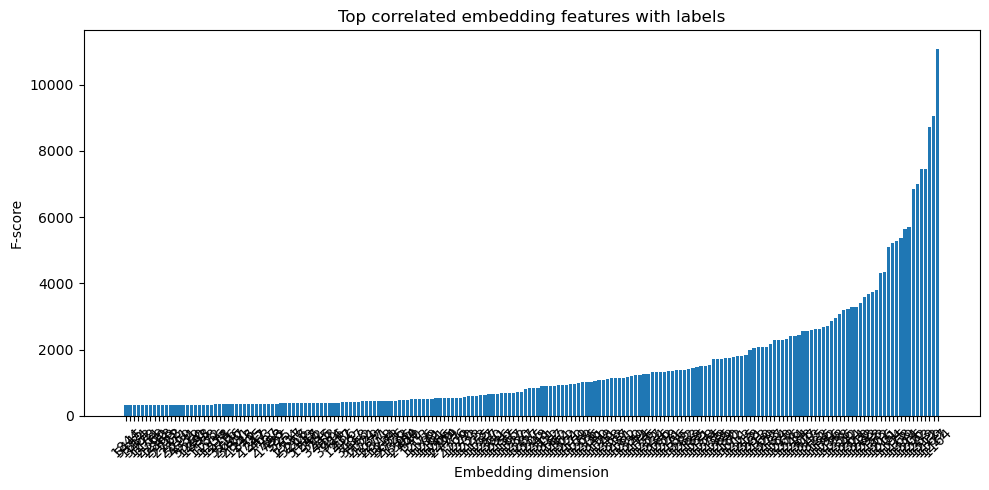

In [76]:
top_n = 200
top_idx = np.argsort(f_scores)[-top_n:]

plt.figure(figsize=(10, 5))
plt.bar(range(top_n), f_scores[top_idx])
plt.xticks(range(top_n), top_idx, rotation=45)
plt.ylabel("F-score")
plt.xlabel("Embedding dimension")
plt.title("Top correlated embedding features with labels")
plt.tight_layout()
plt.show()

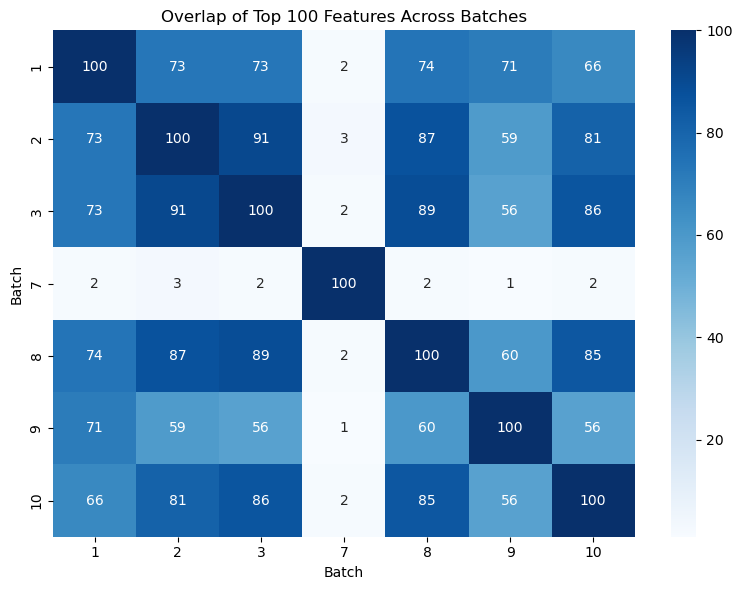

In [83]:
def get_top_features_for_batch(batch, top_k=200):
    X, y = load_batches([batch])
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    f_scores, _ = f_classif(X, y_encoded)
    top_features = np.argsort(f_scores)[-top_k:]
    return set(top_features)

batches = [1, 2, 3, 7, 8, 9, 10]
top_k = 100

# Get top features per batch
batch_feature_map = {batch: get_top_features_for_batch(batch, top_k) for batch in batches}

# Create overlap matrix
overlap_matrix = pd.DataFrame(index=batches, columns=batches, dtype=int)
for b1, b2 in combinations(batches, 2):
    overlap = len(batch_feature_map[b1] & batch_feature_map[b2])
    overlap_matrix.loc[b1, b2] = overlap
    overlap_matrix.loc[b2, b1] = overlap
for b in batches:
    overlap_matrix.loc[b, b] = top_k

# Plot
plt.figure(figsize=(8, 6))
sns.heatmap(overlap_matrix.astype(int), annot=True, fmt='d', cmap='Blues')
plt.title(f'Overlap of Top {top_k} Features Across Batches')
plt.xlabel("Batch")
plt.ylabel("Batch")
plt.tight_layout()
plt.show()

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.69      0.89      0.78      1222
  FUSHomozygous_Untreated       0.85      0.61      0.71      1245
   FUSRevertant_Untreated

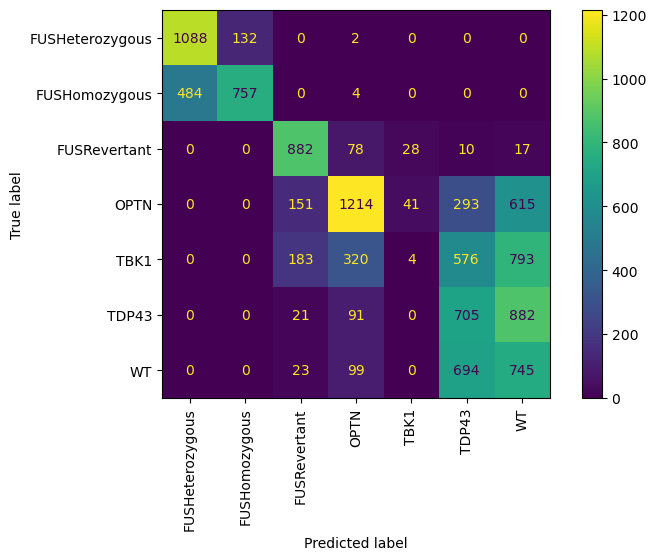

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.60      0.54      0.57      1231
  FUSHomozygous_Untreated       0.56      0.61      0.58      1162
   FUSRevertant_Untreated    

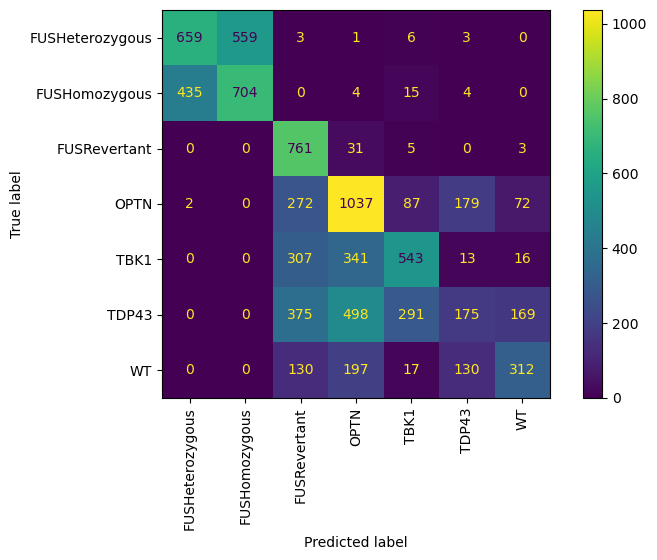

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.68      0.94      0.79      1004
  FUSHomozygous_Untreated       0.86      0.44      0.58       800
   FUSRevertant_Untreated     

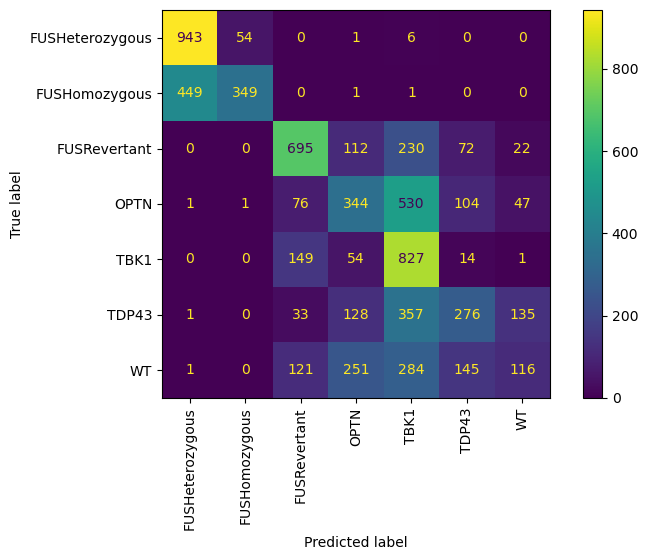

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

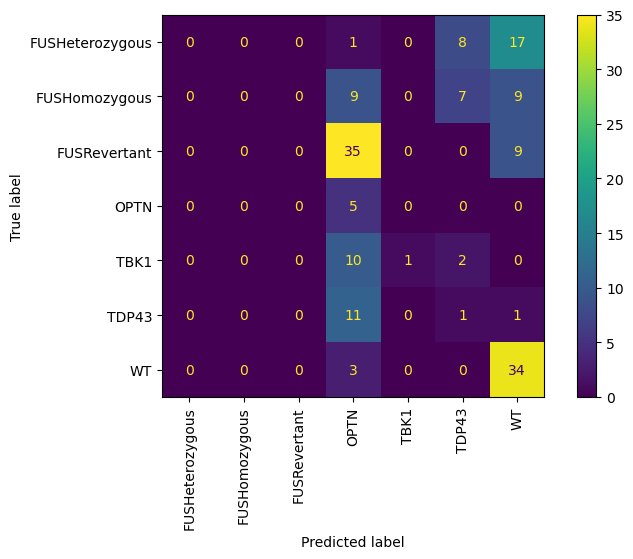

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.82      0.11      0.20      1567
  FUSHomozygous_Untreated       0.52      0.97      0.68      1562
   FUSRevertant_Untreated   

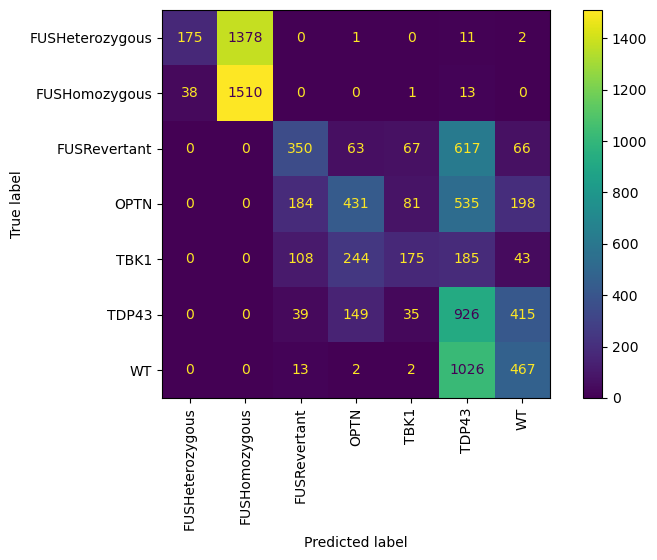

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.26      0.46      0.34       963
  FUSHomozygous_Untreated       0.29      0.46      0.36       619
   FUSRevertant_Untreated     

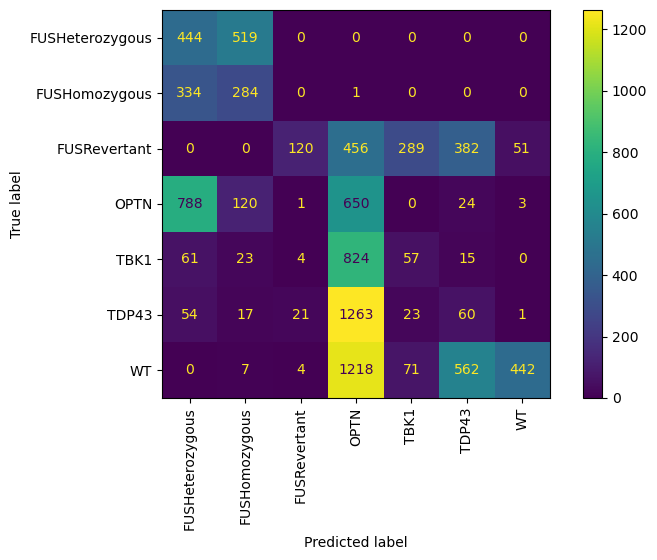

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.60      0.30      0.40       267
  FUSHomozygous_Untreated       0.77      0.92      0.84       666
   FUSRevertant_Untreated       

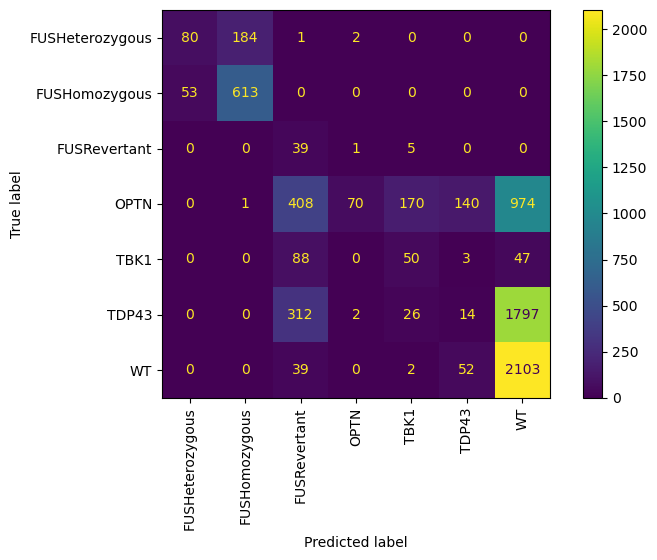

[0.49350530552506405, 0.5015557683101962, 0.5121916029432982, 0.25153374233128833, 0.42240837696335076, 0.22375720657021647, 0.40805387575590985]


In [86]:
## No norm no balance => minor improvment
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)
    
    # Select top 100 features using F-score
    f_scores, _ = f_classif(X_train, y_train_enc)
    top_features = np.argsort(f_scores)[-000:]

    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.67      0.91      0.78      1222
  FUSHomozygous_Untreated       0.87      0.56      0.68      1245
   FUSRevertant_Untreated

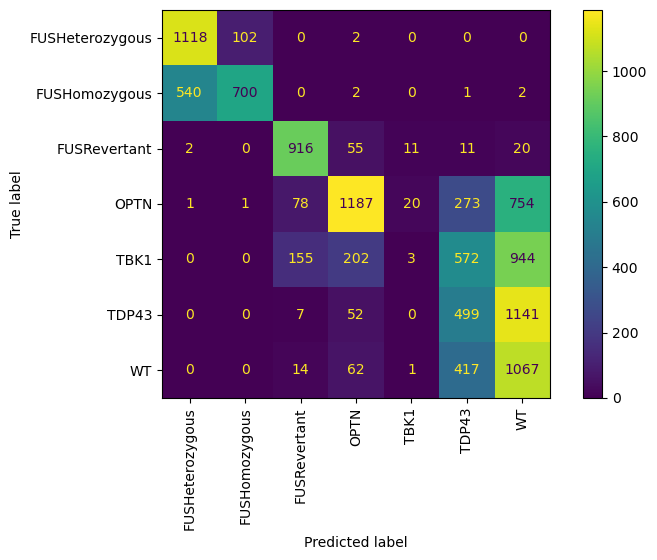

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.62      0.62      0.62      1231
  FUSHomozygous_Untreated       0.60      0.59      0.59      1162
   FUSRevertant_Untreated    

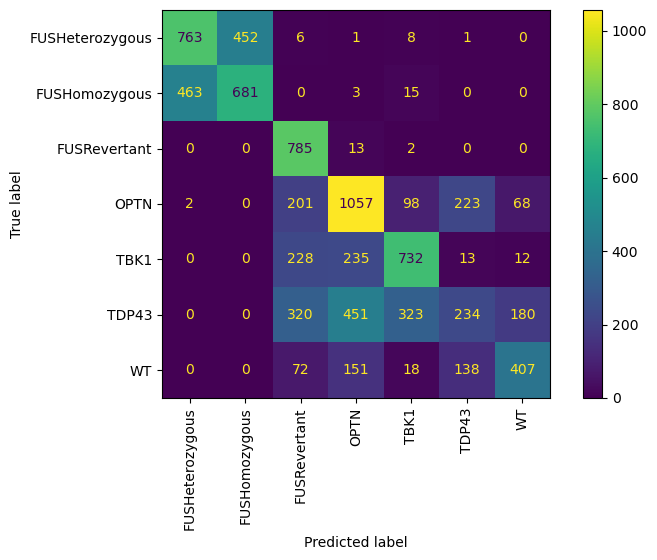

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.72      0.97      0.83      1004
  FUSHomozygous_Untreated       0.93      0.54      0.68       800
   FUSRevertant_Untreated     

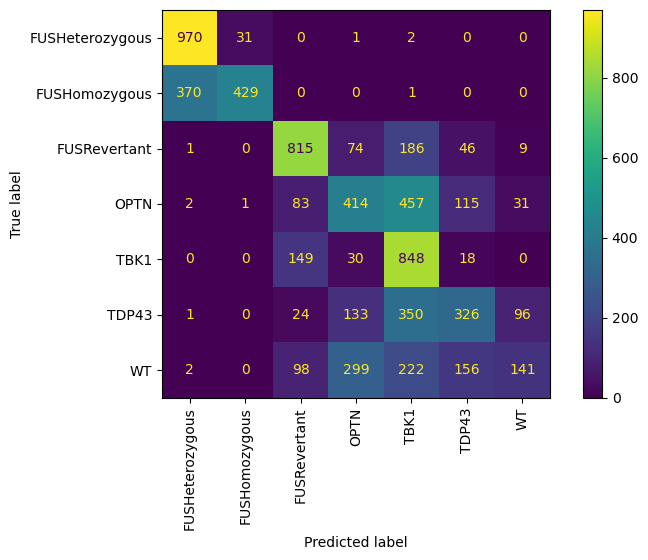

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

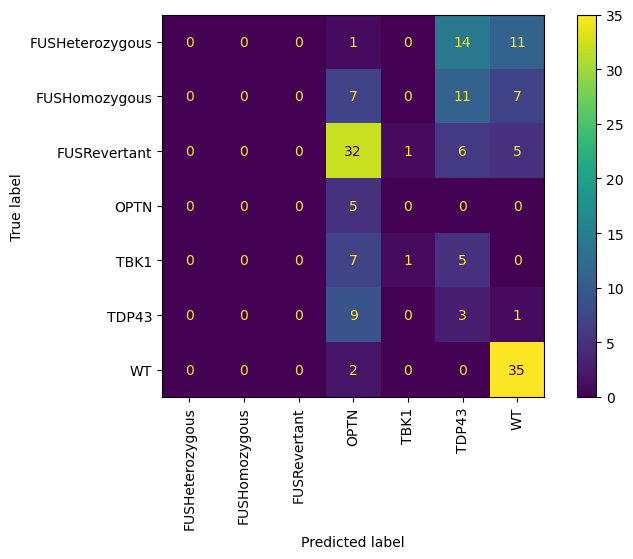

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.83      0.19      0.31      1567
  FUSHomozygous_Untreated       0.54      0.95      0.69      1562
   FUSRevertant_Untreated   

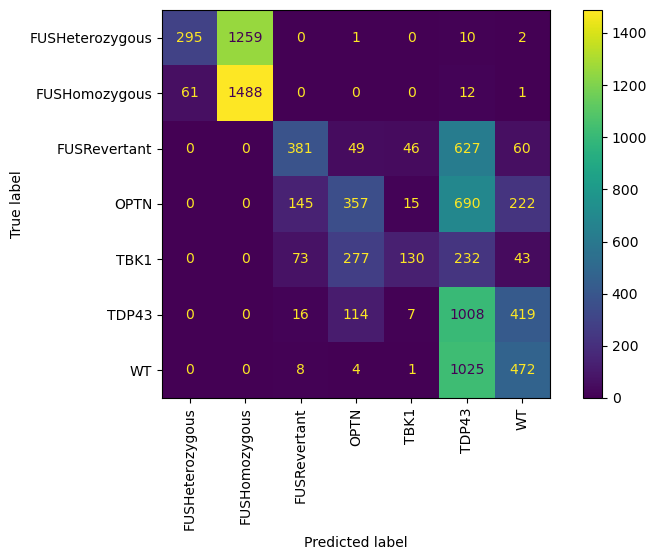

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.20      0.32      0.24       963
  FUSHomozygous_Untreated       0.29      0.52      0.37       619
   FUSRevertant_Untreated     

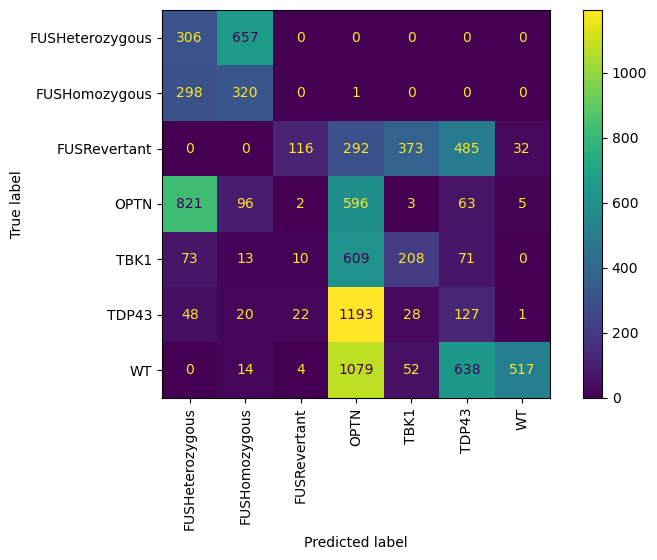

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.62      0.27      0.38       267
  FUSHomozygous_Untreated       0.77      0.93      0.84       666
   FUSRevertant_Untreated       

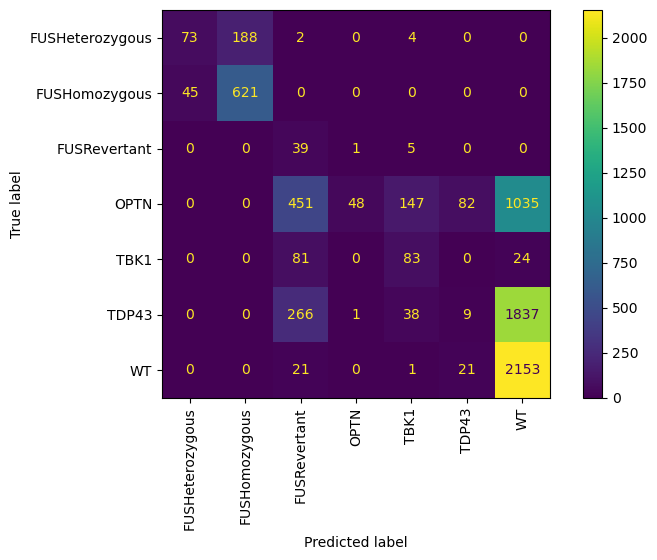

[0.5021953896816685, 0.5575634274772618, 0.5688933775789929, 0.26993865030674846, 0.432565445026178, 0.23822473621233548, 0.4158878504672897]


In [17]:
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)
    
    # Ensure inputs are float32 for speed
    X_train = np.asarray(X_train, dtype=np.float32)
    y_encoded = np.asarray(y_train_enc, dtype=np.float32)

    # Center inputs
    X_centered = X_train - X_train.mean(axis=0)
    y_centered = y_encoded - y_encoded.mean()

    # Compute Pearson manually: vectorized
    numerator = np.dot(X_centered.T, y_centered)
    denominator = np.linalg.norm(X_centered, axis=0) * np.linalg.norm(y_centered)
    correlations = np.abs(numerator / denominator)

    # Get top 100 indices
    top_indices = np.argsort(correlations)[-3000:]
    X_train = X_train[:, top_indices]
    X_test = X_test[:, top_indices]

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
print(accuracies)

In [18]:
np.mean(accuracies)

0.42646698239292496

In [14]:
np.mean([0.5038419319429198, 0.5661799904260412, 0.5854854999278604, 0.26993865030674846, 0.4496335078534031, 0.2601979767214185, 0.4156129741616273])

0.4358415044771455

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.66      0.91      0.77      1222
  FUSHomozygous_Untreated       0.87      0.53      0.66      1245
   FUSRevertant_Untreated

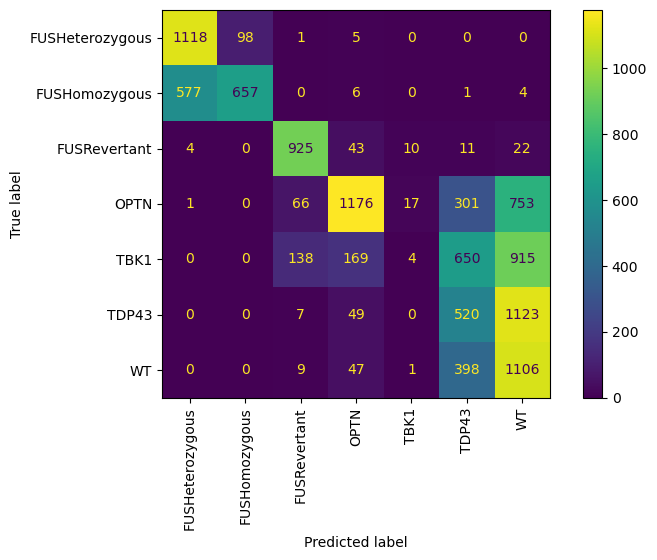

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.63      0.63      0.63      1231
  FUSHomozygous_Untreated       0.61      0.59      0.60      1162
   FUSRevertant_Untreated    

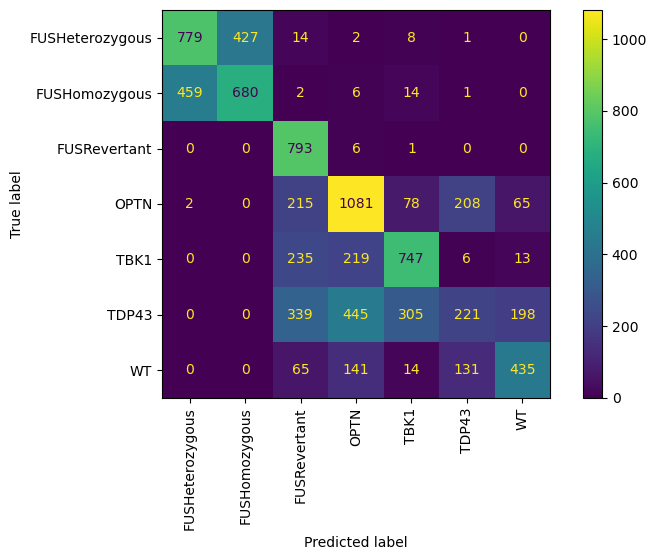

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.74      0.97      0.84      1004
  FUSHomozygous_Untreated       0.94      0.57      0.71       800
   FUSRevertant_Untreated     

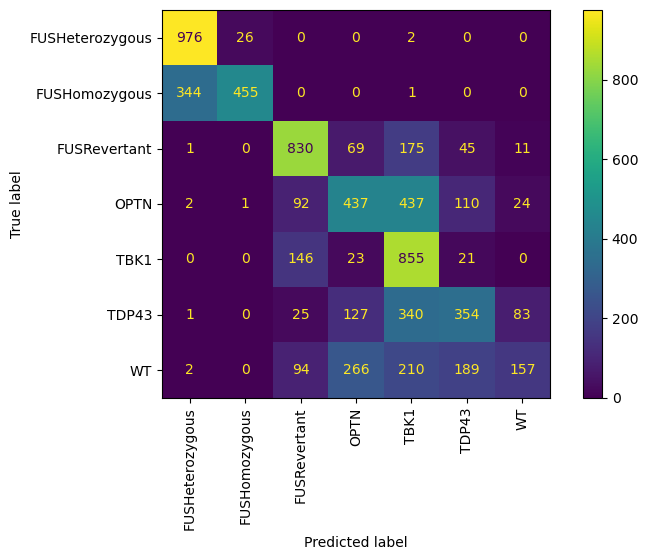

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.00      0.00        44
           OPTN_Untreated       0.07      0.80      0.12         5
           TBK1_Untreated       0.50      0.08      0.13        13
          TDP43_Untreated       0.07      0.23      0.11        13
             WT_Untreated       0.61      0.97      0.75        37

                 accuracy                           0.27       163
                macro avg       0.18      0.30      0.16       163
             weighted avg       0.19      0.27      0.19       163



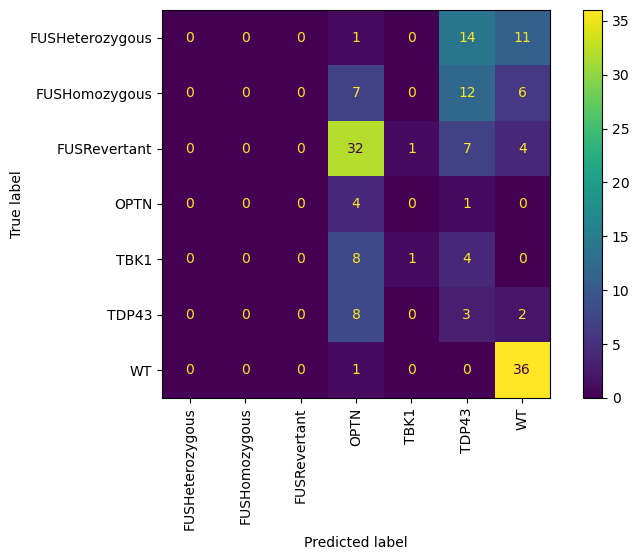

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.81      0.20      0.32      1567
  FUSHomozygous_Untreated       0.54      0.94      0.69      1562
   FUSRevertant_Untreated   

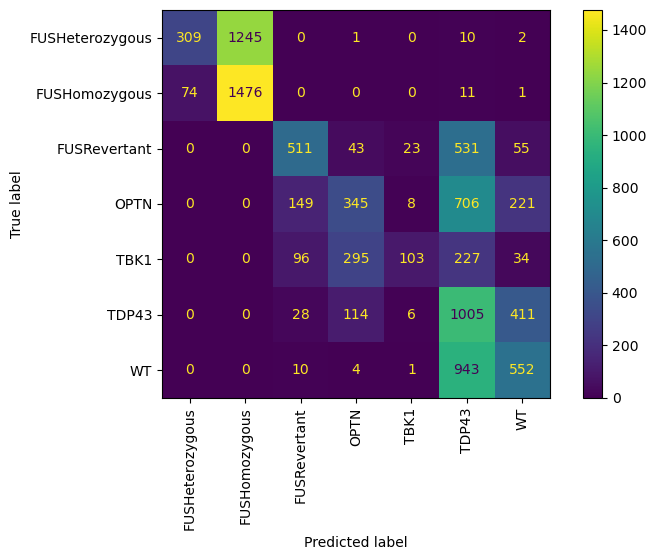

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.19      0.28      0.23       963
  FUSHomozygous_Untreated       0.28      0.53      0.37       619
   FUSRevertant_Untreated     

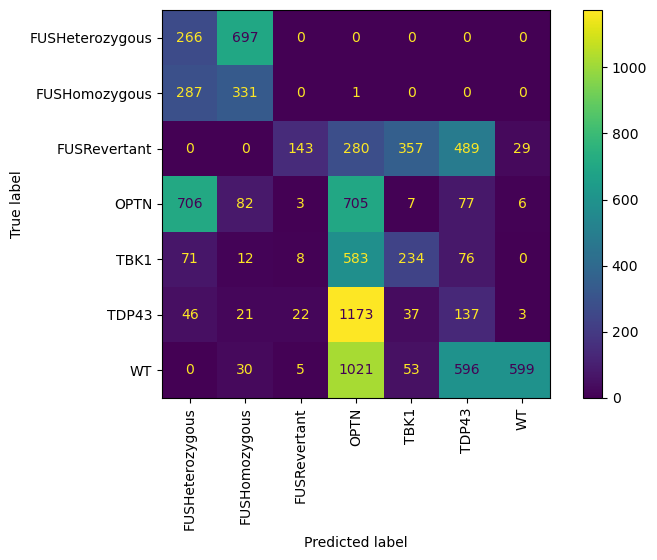

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.58      0.21      0.31       267
  FUSHomozygous_Untreated       0.75      0.94      0.84       666
   FUSRevertant_Untreated       

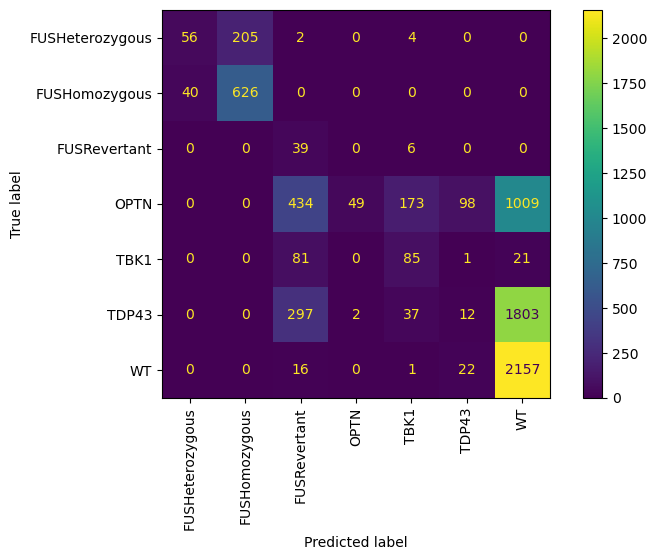

0.4364866454987185 [0.5036589828027809, 0.5667783628530397, 0.5863511758764969, 0.26993865030674846, 0.45036649214659685, 0.2626998803437398, 0.4156129741616273]


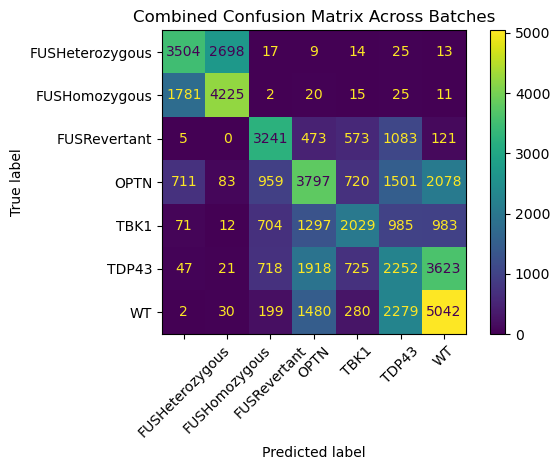

In [20]:
batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
    # Accumulate confusion matrix
    cm = confusion_matrix(y_test_enc, y_pred, labels=np.arange(len(le.classes_)))
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm
print(np.mean(accuracies), accuracies)
display_labels = [label.replace('_Untreated', '') for label in le.classes_]
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=display_labels)
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

In [ ]:
##100 first pca components 
## TAKE 80 20 of two batches, does it work? what are the best features?

Train dataset
batches [2, 3, 7, 8, 9, 10]
(15356,) (15356, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(3260,) (3260, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.51      0.23      0.32      1699
   WT_Untreated       0.47      0.76      0.58      1561

       accuracy                           0.48      3260
      macro avg       0.49      0.49      0.45      3260
   weighted avg       0.49      0.48      0.44      3260



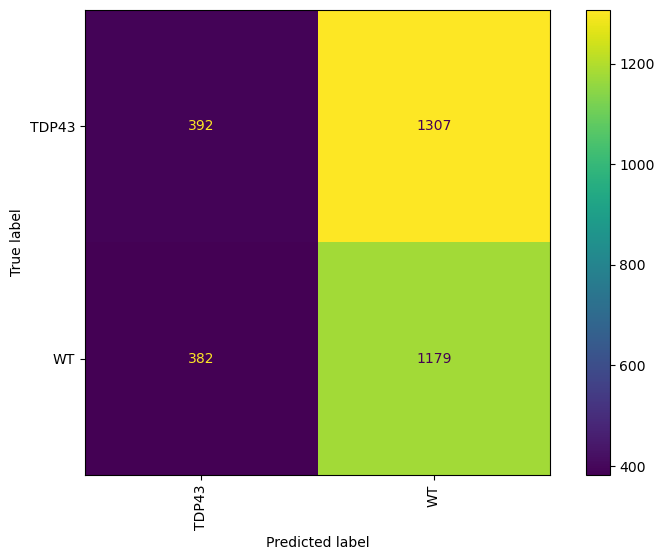

Train dataset
batches [1, 3, 7, 8, 9, 10]
(16322,) (16322, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(2294,) (2294, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.80      0.65      0.72      1508
   WT_Untreated       0.51      0.70      0.59       786

       accuracy                           0.67      2294
      macro avg       0.66      0.67      0.65      2294
   weighted avg       0.70      0.67      0.67      2294



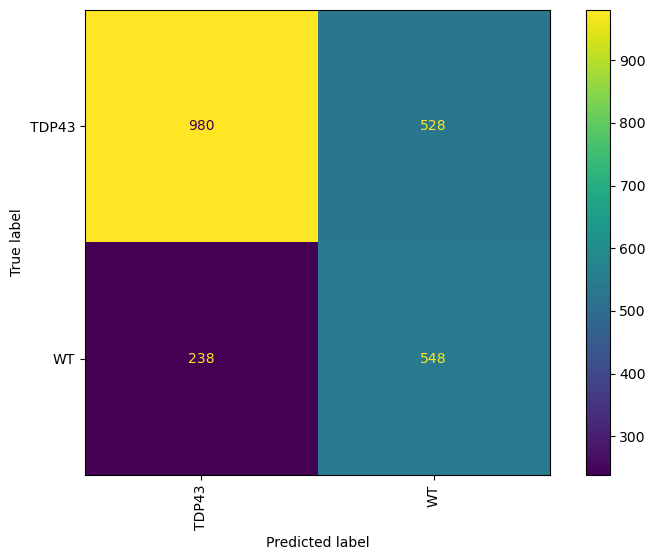

Train dataset
batches [1, 2, 7, 8, 9, 10]
(16768,) (16768, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(1848,) (1848, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.54      0.88      0.67       930
   WT_Untreated       0.66      0.23      0.34       918

       accuracy                           0.56      1848
      macro avg       0.60      0.56      0.51      1848
   weighted avg       0.60      0.56      0.51      1848



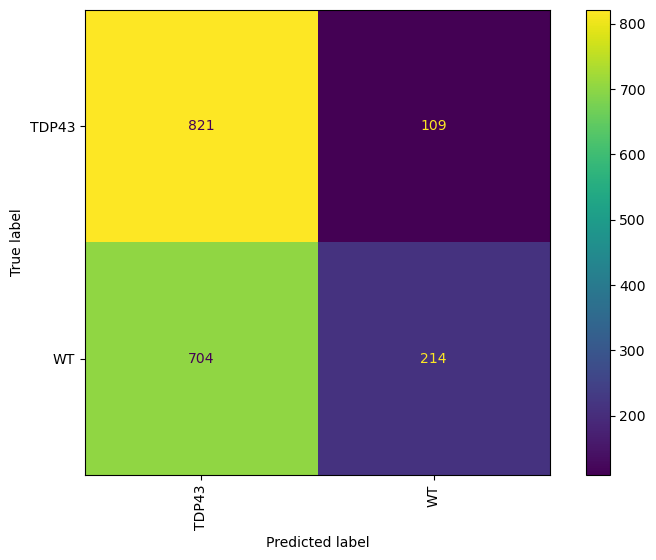

Train dataset
batches [1, 2, 3, 8, 9, 10]
(18566,) (18566, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(50,) (50, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.91      0.77      0.83        13
   WT_Untreated       0.92      0.97      0.95        37

       accuracy                           0.92        50
      macro avg       0.92      0.87      0.89        50
   weighted avg       0.92      0.92      0.92        50



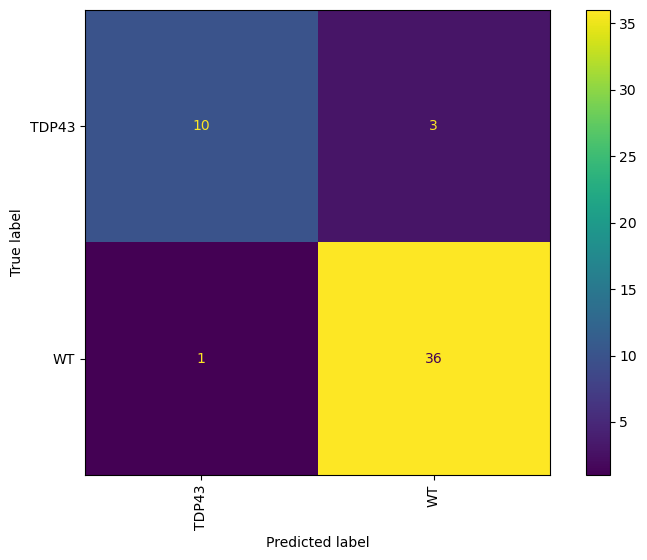

Train dataset
batches [1, 2, 3, 7, 9, 10]
(15542,) (15542, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(3074,) (3074, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.53      0.67      0.59      1564
   WT_Untreated       0.53      0.39      0.45      1510

       accuracy                           0.53      3074
      macro avg       0.53      0.53      0.52      3074
   weighted avg       0.53      0.53      0.52      3074



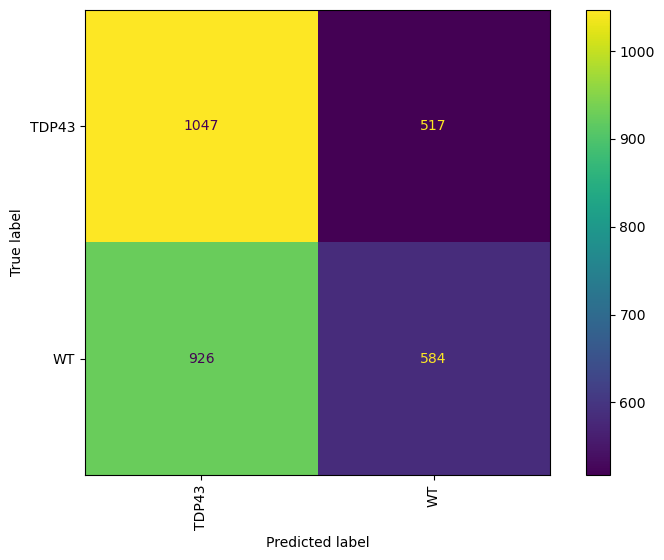

Train dataset
batches [1, 2, 3, 7, 8, 10]
(14873,) (14873, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(3743,) (3743, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.47      0.99      0.64      1439
   WT_Untreated       0.98      0.30      0.46      2304

       accuracy                           0.57      3743
      macro avg       0.73      0.65      0.55      3743
   weighted avg       0.79      0.57      0.53      3743



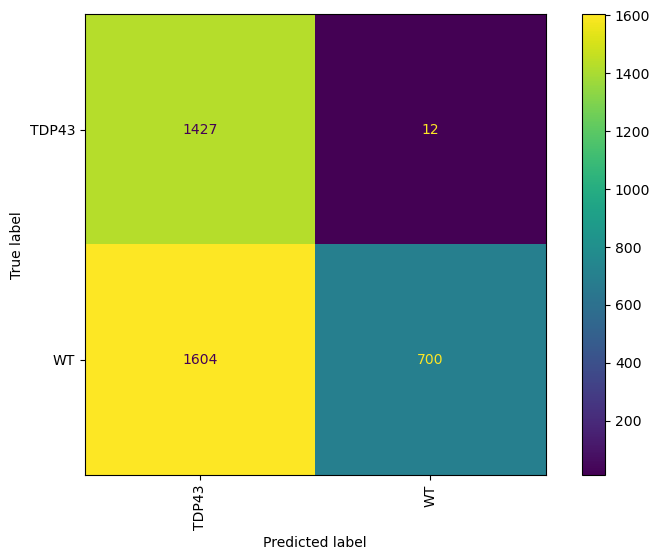

Train dataset
batches [1, 2, 3, 7, 8, 9]
(14269,) (14269, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(4347,) (4347, 5568) ['TDP43_Untreated' 'WT_Untreated']
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                 precision    recall  f1-score   support

TDP43_Untreated       0.53      0.01      0.02      2151
   WT_Untreated       0.51      0.99      0.67      2196

       accuracy                           0.51      4347
      macro avg       0.52      0.50      0.34      4347
   weighted avg       0.52      0.51      0.35      4347



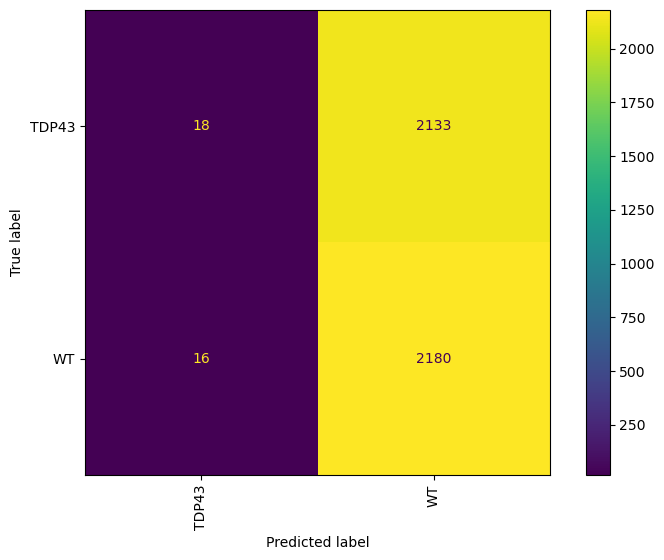

0.6046468700274479 [0.48190184049079754, 0.6660854402789886, 0.560064935064935, 0.92, 0.5305790500975928, 0.5682607534063585, 0.5056360708534622]


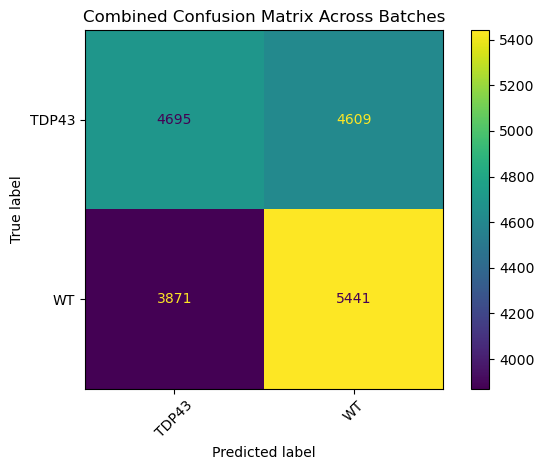

In [21]:
batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

# Keep only these two labels
target_labels = ['WT_Untreated', 'TDP43_Untreated']

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)
    
    mask_train = np.isin(y_train, target_labels)
    mask_test = np.isin(y_test, target_labels)

    X_train = X_train[mask_train]
    y_train = y_train[mask_train]
    X_test = X_test[mask_test]
    y_test = y_test[mask_test]

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
    # Accumulate confusion matrix
    cm = confusion_matrix(y_test_enc, y_pred, labels=np.arange(len(le.classes_)))
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm
print(np.mean(accuracies), accuracies)
display_labels = [label.replace('_Untreated', '') for label in le.classes_]
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=display_labels)
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
fit
predict


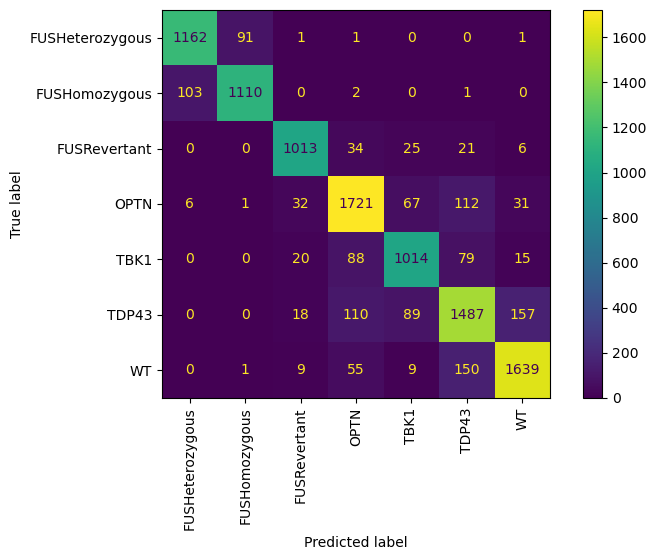

In [26]:
batches = [1,2,3,7,8,9,10]
X, y = load_batches(batches)
# Encode labels to integers
le = LabelEncoder()
y_encoded = le.fit_transform(y)
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y)

    
print('Train dataset')
print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
count_labels(y_train)
print('Test dataset')
print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
count_labels(y_test)

# Encode with same label encoder
# Already encoded earlier
y_train_enc = y_train
y_test_enc = y_test

# Optional: balance training set
balance = False
if balance:
    ros = RandomOverSampler(random_state=42)
    X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

# Optional: normalize
norm = False
if norm:
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)

# Convert to GPU
X_train = cudf.DataFrame.from_records(X_train)
X_test = cudf.DataFrame.from_records(X_test)
y_train_enc = cudf.Series(y_train_enc)

# Train
print('fit')
clf = cuMLLogisticRegression(verbose=1)
clf.fit(X_train, y_train_enc)

# Predict
print('predict')
y_pred = clf.predict(X_test).to_numpy()
report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
# print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
plot_confusion_matrix(y_test_enc, y_pred, le)

In [16]:
#### DONT FORGET
from utils import *

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
Selecting top 100 features...
              precision    recall  f1-score   support

           0       0.61      0.64      0.62      1256
           1       0.61      0.56      0.59      1216
           2       0.33      0.16      0.22      1099
           3       0.43      0.46      0.44      1970
           4       0.27      0.06      0.10      1216
           5       0.32      0.48      0.38      1861
           6       0.35      0.45      0.40      1863

    accuracy                           0.42     10481
   macro avg       0.42      0.40      0.39     10481
weighted avg       0.41      0.42      0.40     10481



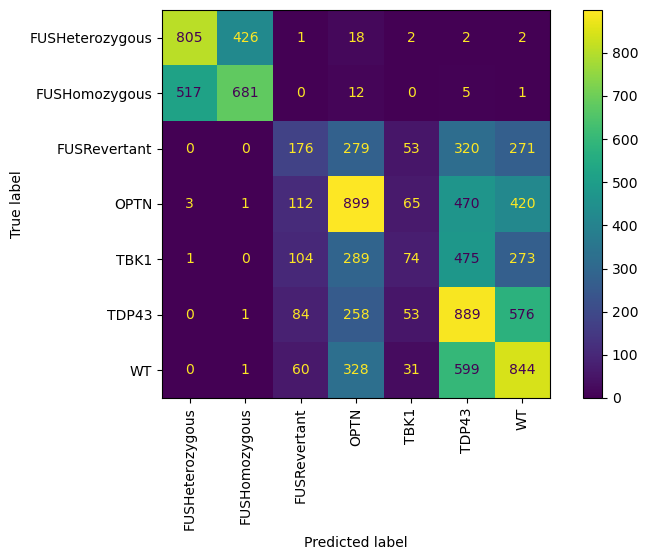


Accuracy: 0.4168

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.907261     0.640924     0.943523 0.607089 0.950737
  FUSHomozygous_Untreated  0.908024     0.560033     0.953697 0.613514 0.942909
   FUSRevertant_Untreated  0.877493     0.160146     0.961522 0.327747 0.907180
           OPTN_Untreated  0.784849     0.456345     0.860886 0.431589 0.872470
           TBK1_Untreated  0.871577     0.060855     0.977982 0.266187 0.888072
          TDP43_Untreated  0.728747     0.477700     0.782947 0.322101 0.874110
             WT_Untreated  0.755558     0.453033     0.820956 0.353582 0.874104
            Macro Average  0.833358     0.401291     0.900216 0.417401 0.901369


In [21]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    balance=False,
    norm=False,
    choose_features=True,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
              precision    recall  f1-score   support

           0       0.91      0.93      0.92      1256
           1       0.92      0.91      0.92      1216
           2       0.93      0.92      0.93      1099
           3       0.86      0.87      0.86      1970
           4       0.84      0.84      0.84      1216
           5       0.80      0.80      0.80      1861
           6       0.88      0.88      0.88      1863

    accuracy                           0.87     10481
   macro avg       0.88      0.88      0.88     10481
weighted avg       0.87      0.87      0.87     10481



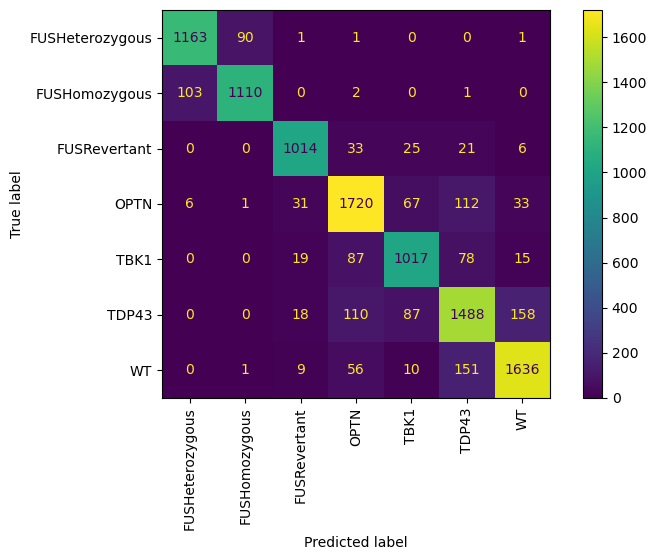


Accuracy: 0.8728

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.980727     0.925955     0.988184 0.914308 0.989901
  FUSHomozygous_Untreated  0.981109     0.912829     0.990070 0.923461 0.988576
   FUSRevertant_Untreated  0.984448     0.922657     0.991686 0.928571 0.990947
           OPTN_Untreated  0.948574     0.873096     0.966044 0.856147 0.970491
           TBK1_Untreated  0.962981     0.836349     0.979601 0.843284 0.978544
          TDP43_Untreated  0.929778     0.799570     0.957889 0.803890 0.956779
             WT_Untreated  0.958019     0.878154     0.975284 0.884803 0.973703
            Macro Average  0.963662     0.878373     0.978394 0.879209 0.978420


In [22]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    balance=False,
    norm=False,
    choose_features=False,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
              precision    recall  f1-score   support

           0       0.72      0.75      0.74      1256
           1       0.74      0.71      0.72      1216
           2       0.61      0.60      0.61      1099
           3       0.57      0.62      0.59      1970
           4       0.53      0.45      0.48      1216
           5       0.47      0.43      0.45      1861
           6       0.63      0.68      0.65      1863

    accuracy                           0.60     10481
   macro avg       0.61      0.61      0.61     10481
weighted avg       0.60      0.60      0.60     10481



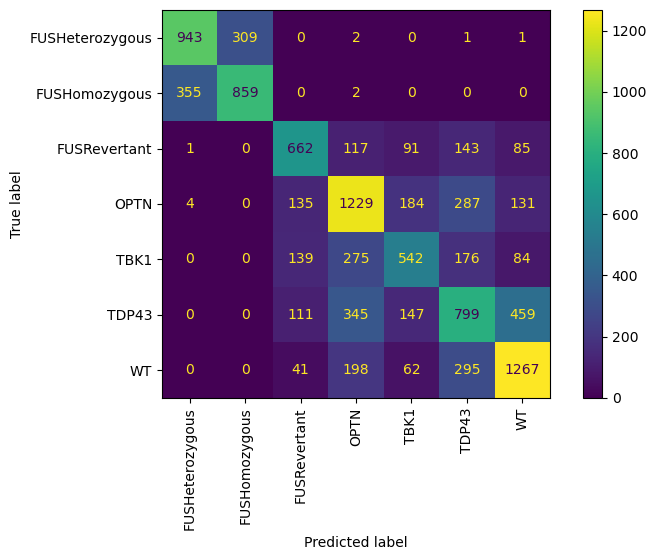


Accuracy: 0.6012

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.935789     0.750796     0.960976 0.723715 0.965897
  FUSHomozygous_Untreated  0.936456     0.706414     0.966649 0.735445 0.961666
   FUSRevertant_Untreated  0.917661     0.602366     0.954594 0.608456 0.953476
           OPTN_Untreated  0.839710     0.623858     0.889672 0.566882 0.910863
           TBK1_Untreated  0.889514     0.445724     0.947760 0.528265 0.928715
          TDP43_Untreated  0.812613     0.429339     0.895360 0.469724 0.879043
             WT_Untreated  0.870623     0.680086     0.911812 0.625062 0.929501
            Macro Average  0.886052     0.605512     0.932403 0.608221 0.932737


In [25]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = True,
    balance=False,
    norm=False,
    choose_features=False,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
              precision    recall  f1-score   support

           0       0.73      0.74      0.74      1256
           1       0.74      0.73      0.73      1216
           2       0.55      0.71      0.62      1099
           3       0.60      0.52      0.56      1970
           4       0.48      0.58      0.52      1216
           5       0.48      0.38      0.42      1861
           6       0.63      0.65      0.64      1863

    accuracy                           0.60     10481
   macro avg       0.60      0.62      0.60     10481
weighted avg       0.60      0.60      0.59     10481



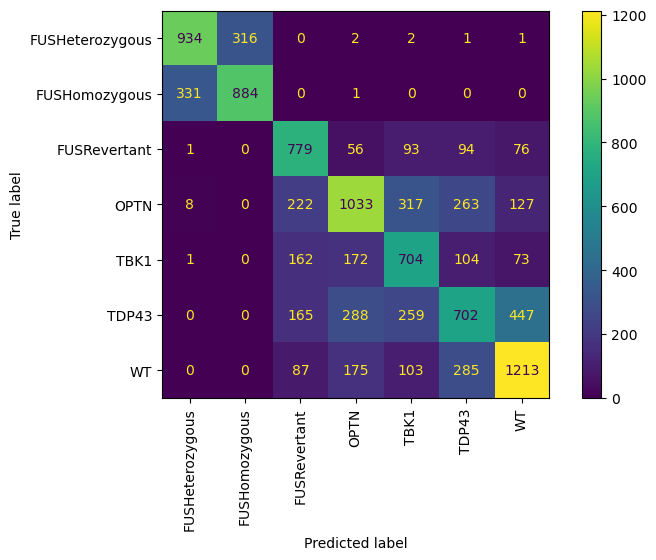


Accuracy: 0.5962

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.936743     0.743631     0.963035 0.732549 0.965023
  FUSHomozygous_Untreated  0.938174     0.726974     0.965893 0.736667 0.964228
   FUSRevertant_Untreated  0.908787     0.708826     0.932211 0.550530 0.964703
           OPTN_Untreated  0.844385     0.524365     0.918458 0.598147 0.892963
           TBK1_Untreated  0.877302     0.578947     0.916460 0.476319 0.943130
          TDP43_Untreated  0.818147     0.377217     0.913341 0.484472 0.871678
             WT_Untreated  0.868906     0.651100     0.915990 0.626226 0.923923
            Macro Average  0.884635     0.615866     0.932198 0.600701 0.932236


In [26]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = True,
    balance=True,
    norm=False,
    choose_features=False,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
[W] [11:58:20.309520] L-BFGS line search failed (code 3); stopping at the last valid step
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      1256
           1       0.74      0.74      0.74      1216
           2       0.57      0.70      0.63      1099
           3       0.54      0.48      0.51      1970
           4       0.45      0.55      0.50      1216
           5       0.47      0.36      0.41      1861
           6       0.60      0.65      0.63      1863

    accuracy                           0.58     10481
   macro avg       0.59      0.60      0.59     10481
weighted avg       0.58      0.58      0.58     10481



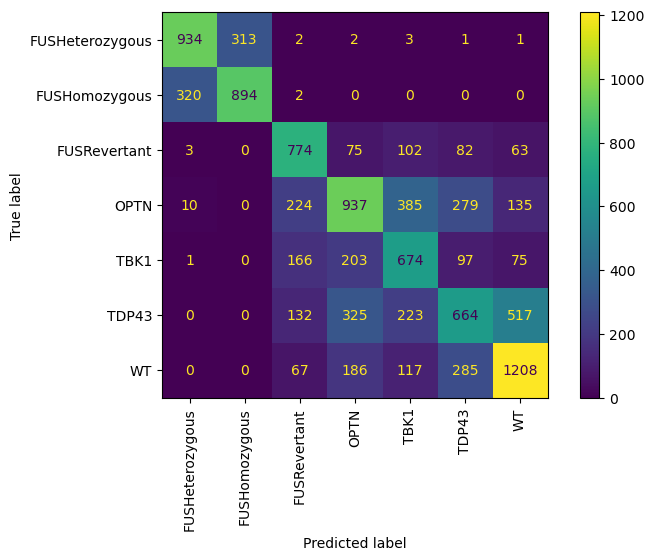


Accuracy: 0.5806

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.937411     0.743631     0.963794 0.736593 0.965049
  FUSHomozygous_Untreated  0.939414     0.735197     0.966217 0.740679 0.965279
   FUSRevertant_Untreated  0.912413     0.704277     0.936794 0.566203 0.964341
           OPTN_Untreated  0.825971     0.475635     0.907061 0.542245 0.881983
           TBK1_Untreated  0.869096     0.554276     0.910416 0.448138 0.939623
          TDP43_Untreated  0.814808     0.356797     0.913689 0.471591 0.868070
             WT_Untreated  0.862036     0.648417     0.908215 0.604302 0.922778
            Macro Average  0.880164     0.602604     0.929455 0.587108 0.929589


In [27]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = True,
    balance=True,
    norm=True,
    choose_features=False,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)


=== Batch 1 ===
Train: (41469, 5568) Labels: [0 1 2 3 4 5 6]
Test: (10932, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
              precision    recall  f1-score   support

           0       0.55      0.87      0.68      1222
           1       0.70      0.31      0.43      1245
           2       0.62      0.65      0.63      1015
           3       0.55      0.22      0.31      2314
           4       0.02      0.00      0.00      1876
           5       0.14      0.10      0.12      1699
           6       0.21      0.68      0.32      1561

    accuracy                           0.35     10932
   macro avg       0.40      0.40      0.36     10932
weighted avg       0.37      0.35      0.31     10932


=== Batch 2 ===
Train: (44045, 5568) Labels: [0 1 2 3 4 5 6]
Test: (8356, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Un

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

              precision    recall  f1-score   support

           0       0.50      0.04      0.07        26
           1       0.00      0.00      0.00        25
           2       0.00      0.00      0.00        44
           3       0.05      1.00      0.10         5
           4       0.00      0.00      0.00        13
           5       0.08      0.23      0.12        13
           6       0.72      0.57      0.64        37

    accuracy                           0.18       163
   macro avg       0.19      0.26      0.13       163
weighted avg       0.25      0.18      0.17       163


=== Batch 8 ===
Train: (42851, 5568) Labels: [0 1 2 3 4 5 6]
Test: (9550, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
              precision    recall  f1-score   support

           0       0.83      0.05      0.10      1567
           1   

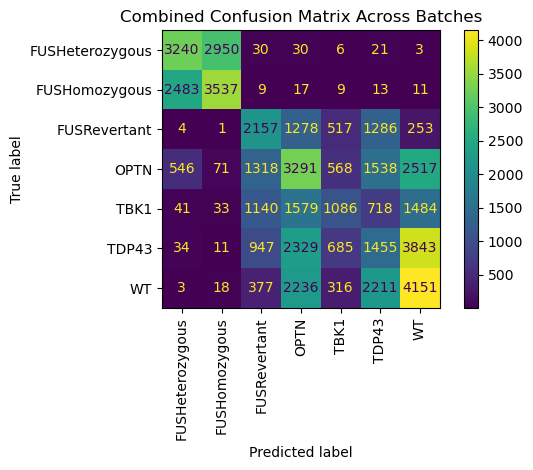


=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.882617     0.515924     0.932547 0.510156 0.933985
  FUSHomozygous_Untreated  0.892636     0.581839     0.933423 0.534209 0.944474
   FUSRevertant_Untreated  0.863361     0.392467     0.918537 0.360823 0.928074
           OPTN_Untreated  0.732314     0.334146     0.824474 0.305855 0.842511
           TBK1_Untreated  0.864583     0.178589     0.954642 0.340759 0.898504
          TDP43_Untreated  0.739776     0.156384     0.865722 0.200911 0.826192
             WT_Untreated  0.746722     0.445769     0.811762 0.338526 0.871422
            Macro Average  0.817430     0.372160     0.891586 0.370177 0.892166


In [59]:
run_baseline_model(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = True,
    balance=False,
    norm=False,
    choose_features=False,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
Selecting top 50 features...
              precision    recall  f1-score   support

           0       0.58      0.59      0.58      1256
           1       0.57      0.53      0.55      1216
           2       0.31      0.09      0.14      1099
           3       0.42      0.45      0.43      1970
           4       0.26      0.04      0.06      1216
           5       0.31      0.49      0.38      1861
           6       0.34      0.45      0.38      1863

    accuracy                           0.40     10481
   macro avg       0.40      0.38      0.36     10481
weighted avg       0.39      0.40      0.37     10481



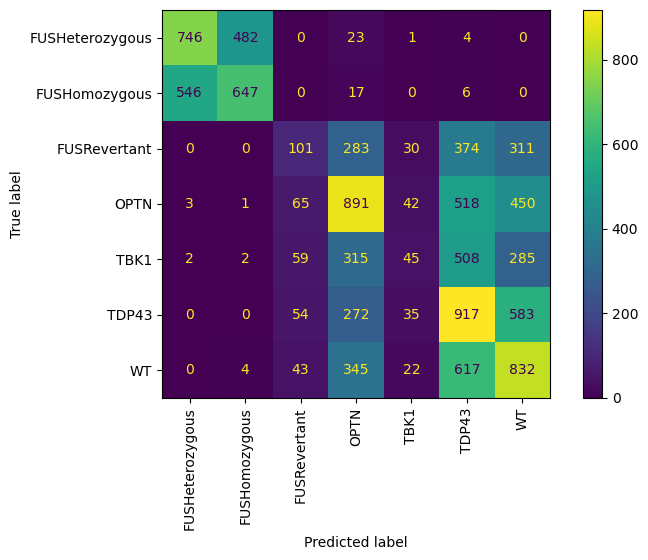


Accuracy: 0.3987

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.898769     0.593949     0.940271 0.575173 0.944469
  FUSHomozygous_Untreated  0.899055     0.532072     0.947221 0.569542 0.939112
   FUSRevertant_Untreated  0.883694     0.091902     0.976444 0.313665 0.901762
           OPTN_Untreated  0.777311     0.452284     0.852544 0.415191 0.870546
           TBK1_Untreated  0.875871     0.037007     0.985969 0.257143 0.886377
          TDP43_Untreated  0.716535     0.492746     0.764849 0.311481 0.874751
             WT_Untreated  0.746207     0.446592     0.810977 0.338074 0.871446
            Macro Average  0.828206     0.378079     0.896896 0.397181 0.898352


In [62]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = False,
    balance=False,
    norm=False,
    choose_features=True,
    top_k=50,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
Selecting top 10 features...
              precision    recall  f1-score   support

           0       0.55      0.56      0.56      1256
           1       0.56      0.52      0.54      1216
           2       0.47      0.01      0.01      1099
           3       0.35      0.43      0.39      1970
           4       0.18      0.01      0.02      1216
           5       0.29      0.51      0.37      1861
           6       0.30      0.37      0.33      1863

    accuracy                           0.37     10481
   macro avg       0.39      0.35      0.32     10481
weighted avg       0.37      0.37      0.33     10481



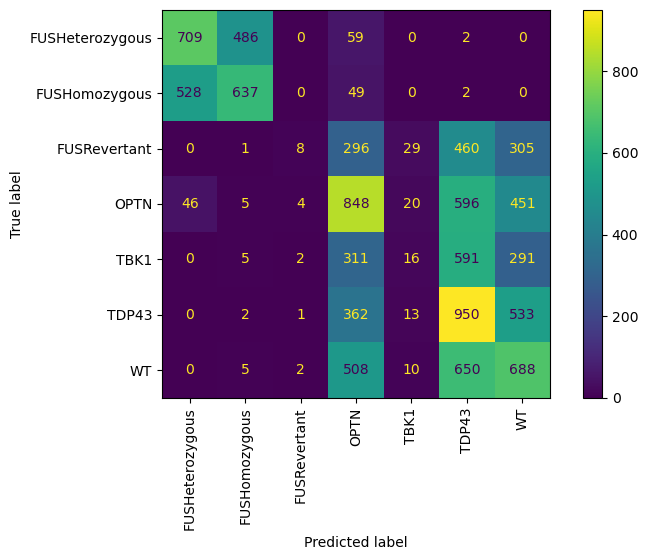


Accuracy: 0.3679

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.893045     0.564490     0.937778 0.552611 0.940531
  FUSHomozygous_Untreated  0.896670     0.523849     0.945602 0.558282 0.938009
   FUSRevertant_Untreated  0.895048     0.007279     0.999041 0.470588 0.895738
           OPTN_Untreated  0.741723     0.430457     0.813770 0.348541 0.860586
           TBK1_Untreated  0.878638     0.013158     0.992229 0.181818 0.884538
          TDP43_Untreated  0.693541     0.510478     0.733063 0.292218 0.873997
             WT_Untreated  0.737143     0.369297     0.816663 0.303351 0.856934
            Macro Average  0.819401     0.345573     0.891164 0.386773 0.892905


In [63]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = False,
    balance=False,
    norm=False,
    choose_features=True,
    top_k=10,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)

Train dataset
(41920,) (41920, 5568) [0 1 2 3 4 5 6]
1: 4863
6: 7449
3: 7879
0: 5024
4: 4865
5: 7443
2: 4397
Test dataset
(10481,) (10481, 5568) [0 1 2 3 4 5 6]
6: 1863
1: 1216
5: 1861
2: 1099
4: 1216
3: 1970
0: 1256
Selecting top 10 features...
              precision    recall  f1-score   support

           0       0.55      0.53      0.54      1256
           1       0.55      0.58      0.56      1216
           2       0.19      0.25      0.22      1099
           3       0.37      0.30      0.33      1970
           4       0.23      0.27      0.25      1216
           5       0.30      0.28      0.29      1861
           6       0.32      0.29      0.31      1863

    accuracy                           0.35     10481
   macro avg       0.36      0.36      0.36     10481
weighted avg       0.35      0.35      0.35     10481



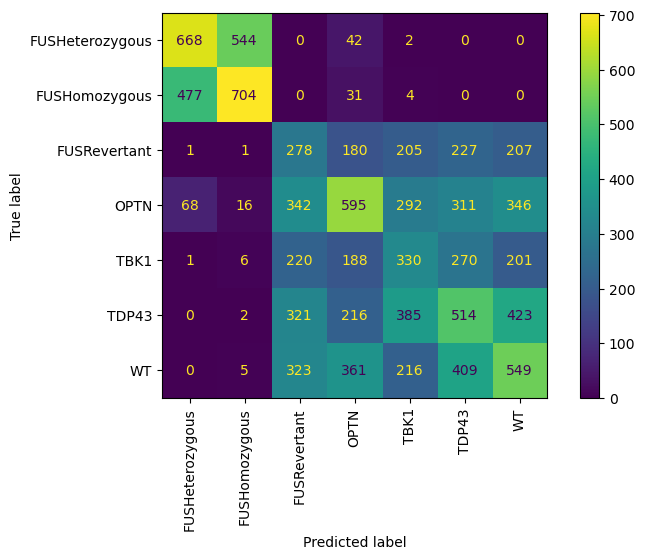


Accuracy: 0.3471

=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.891709     0.531847     0.940705 0.549794 0.936542
  FUSHomozygous_Untreated  0.896384     0.578947     0.938046 0.550861 0.944366
   FUSRevertant_Untreated  0.806602     0.252957     0.871456 0.187332 0.908747
           OPTN_Untreated  0.771682     0.302030     0.880390 0.368878 0.844948
           TBK1_Untreated  0.810133     0.271382     0.880842 0.230126 0.902067
          TDP43_Untreated  0.755367     0.276196     0.858817 0.296938 0.846057
             WT_Untreated  0.762332     0.294686     0.863425 0.318076 0.849914
            Macro Average  0.813458     0.358292     0.890526 0.357429 0.890377


In [64]:
run_train_test_split_baseline(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = False,
    balance=True,
    norm=False,
    choose_features=True,
    top_k=10,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)


=== Batch 1 ===
Train: (41469, 5568) Labels: [0 1 2 3 4 5 6]
Test: (10932, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Selecting top 10 features...
              precision    recall  f1-score   support

           0       0.44      0.62      0.51      1222
           1       0.37      0.20      0.26      1245
           2       0.50      0.00      0.00      1015
           3       0.18      0.07      0.10      2314
           4       0.23      0.00      0.00      1876
           5       0.25      0.14      0.18      1699
           6       0.13      0.53      0.20      1561

    accuracy                           0.21     10932
   macro avg       0.30      0.22      0.18     10932
weighted avg       0.27      0.21      0.17     10932


=== Batch 2 ===
Train: (44045, 5568) Labels: [0 1 2 3 4 5 6]
Test: (8356, 5568) Labels: [0 1 

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

              precision    recall  f1-score   support

           0       0.36      0.15      0.22        26
           1       0.15      0.76      0.25        25
           2       0.00      0.00      0.00        44
           3       0.04      0.20      0.07         5
           4       0.00      0.00      0.00        13
           5       0.00      0.00      0.00        13
           6       0.00      0.00      0.00        37

    accuracy                           0.15       163
   macro avg       0.08      0.16      0.08       163
weighted avg       0.08      0.15      0.07       163


=== Batch 8 ===
Train: (42851, 5568) Labels: [0 1 2 3 4 5 6]
Test: (9550, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Selecting top 10 features...
              precision    recall  f1-score   support

           0       0.50      0.56      0

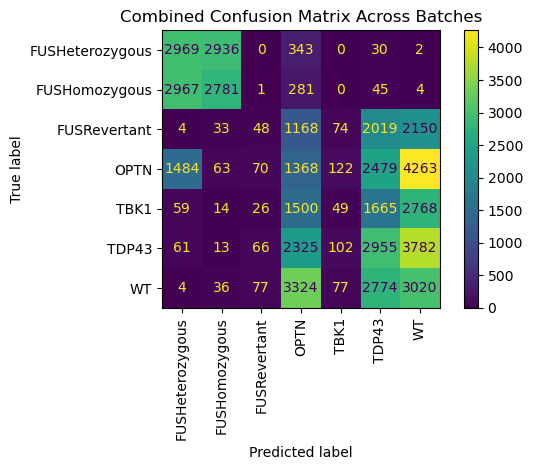


=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.849430     0.472771     0.900718 0.393349 0.926181
  FUSHomozygous_Untreated  0.877999     0.457477     0.933185 0.473281 0.929113
   FUSRevertant_Untreated  0.891452     0.008734     0.994883 0.166667 0.895458
           OPTN_Untreated  0.667525     0.138897     0.789881 0.132700 0.798513
           TBK1_Untreated  0.877731     0.008058     0.991904 0.115566 0.883949
          TDP43_Untreated  0.706857     0.317605     0.790890 0.246929 0.842979
             WT_Untreated  0.632431     0.324313     0.699018 0.188880 0.827200
            Macro Average  0.786204     0.246836     0.871497 0.245339 0.871913


In [65]:
run_baseline_model(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = False,
    balance=False,
    norm=False,
    choose_features=True,
    top_k=10,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)


=== Batch 1 ===
Train: (41469, 5568) Labels: [0 1 2 3 4 5 6]
Test: (10932, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Selecting top 100 features...
              precision    recall  f1-score   support

           0       0.47      0.81      0.59      1222
           1       0.28      0.07      0.11      1245
           2       0.13      0.08      0.10      1015
           3       0.20      0.22      0.21      2314
           4       0.05      0.00      0.00      1876
           5       0.24      0.09      0.13      1699
           6       0.11      0.32      0.16      1561

    accuracy                           0.21     10932
   macro avg       0.21      0.23      0.19     10932
weighted avg       0.20      0.21      0.17     10932


=== Batch 2 ===
Train: (44045, 5568) Labels: [0 1 2 3 4 5 6]
Test: (8356, 5568) Labels: [0 1

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

              precision    recall  f1-score   support

           0       0.25      0.04      0.07        26
           1       0.00      0.00      0.00        25
           2       0.00      0.00      0.00        44
           3       0.03      1.00      0.06         5
           4       0.00      0.00      0.00        13
           5       0.00      0.00      0.00        13
           6       0.00      0.00      0.00        37

    accuracy                           0.04       163
   macro avg       0.04      0.15      0.02       163
weighted avg       0.04      0.04      0.01       163


=== Batch 8 ===
Train: (42851, 5568) Labels: [0 1 2 3 4 5 6]
Test: (9550, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Selecting top 100 features...
              precision    recall  f1-score   support

           0       0.55      0.30      

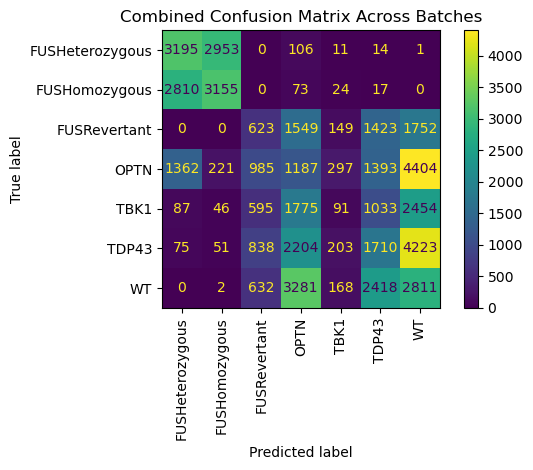


=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.858419     0.508758     0.906030 0.424359 0.931249
  FUSHomozygous_Untreated  0.881739     0.519000     0.929342 0.490821 0.936397
   FUSRevertant_Untreated  0.848801     0.113355     0.934975 0.169616 0.899996
           OPTN_Untreated  0.663174     0.120520     0.788776 0.116658 0.794866
           TBK1_Untreated  0.869430     0.014965     0.981606 0.096501 0.883594
          TDP43_Untreated  0.734891     0.183792     0.853865 0.213536 0.828937
             WT_Untreated  0.631018     0.301869     0.702151 0.179674 0.823131
            Macro Average  0.783925     0.251751     0.870964 0.241595 0.871167


In [66]:
run_baseline_model(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = True,
    balance=False,
    norm=False,
    choose_features=True,
    top_k=100,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)


=== Batch 1 ===
Train: (41469, 5568) Labels: [0 1 2 3 4 5 6]
Test: (10932, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Selecting top 20 features...
              precision    recall  f1-score   support

           0       0.47      0.72      0.57      1222
           1       0.41      0.17      0.24      1245
           2       0.18      0.03      0.05      1015
           3       0.17      0.19      0.18      2314
           4       0.20      0.00      0.00      1876
           5       0.25      0.10      0.14      1699
           6       0.09      0.30      0.14      1561

    accuracy                           0.20     10932
   macro avg       0.25      0.22      0.19     10932
weighted avg       0.24      0.20      0.18     10932


=== Batch 2 ===
Train: (44045, 5568) Labels: [0 1 2 3 4 5 6]
Test: (8356, 5568) Labels: [0 1 

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

              precision    recall  f1-score   support

           0       0.38      0.12      0.18        26
           1       0.13      0.72      0.23        25
           2       0.00      0.00      0.00        44
           3       0.05      0.20      0.08         5
           4       0.00      0.00      0.00        13
           5       0.00      0.00      0.00        13
           6       0.00      0.00      0.00        37

    accuracy                           0.13       163
   macro avg       0.08      0.15      0.07       163
weighted avg       0.08      0.13      0.07       163


=== Batch 8 ===
Train: (42851, 5568) Labels: [0 1 2 3 4 5 6]
Test: (9550, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Selecting top 20 features...
              precision    recall  f1-score   support

           0       0.50      0.51      0

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

              precision    recall  f1-score   support

           0       0.35      0.96      0.51       963
           1       0.13      0.17      0.15       619
           2       0.30      0.01      0.02      1298
           3       0.00      0.00      0.00      1586
           4       0.00      0.00      0.00       984
           5       0.00      0.00      0.00      1439
           6       0.12      0.01      0.01      2304

    accuracy                           0.12      9193
   macro avg       0.13      0.16      0.10      9193
weighted avg       0.12      0.12      0.07      9193


=== Batch 10 ===
Train: (45125, 5568) Labels: [0 1 2 3 4 5 6]
Test: (7276, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Selecting top 20 features...
              precision    recall  f1-score   support

           0       0.18      0.26      

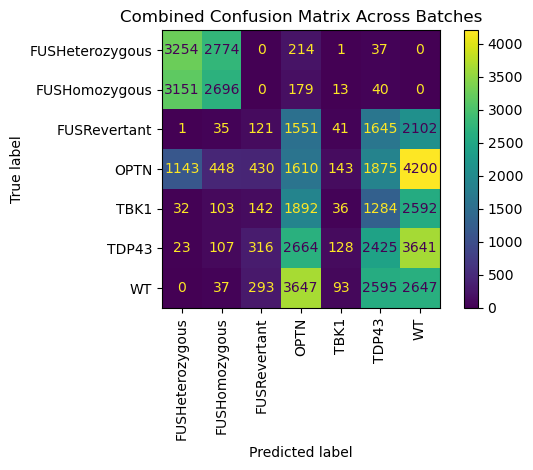


=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.859239     0.518153     0.905683 0.427933 0.932451
  FUSHomozygous_Untreated  0.868571     0.443494     0.924356 0.434839 0.926776
   FUSRevertant_Untreated  0.874888     0.022016     0.974821 0.092934 0.894812
           OPTN_Untreated  0.649129     0.163468     0.761539 0.136940 0.797289
           TBK1_Untreated  0.876644     0.005920     0.990954 0.079121 0.883629
          TDP43_Untreated  0.726055     0.260641     0.826531 0.244925 0.838141
             WT_Untreated  0.633595     0.284257     0.709090 0.174351 0.820925
            Macro Average  0.784017     0.242564     0.870425 0.227292 0.870575


In [67]:
run_baseline_model(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = False,
    balance=False,
    norm=False,
    choose_features=True,
    top_k=20,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=dict()
)


=== Batch 1 ===
Train: (41469, 5568) Labels: [0 1 2 3 4 5 6]
Test: (10932, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
              precision    recall  f1-score   support

           0       0.66      0.91      0.77      1222
           1       0.87      0.53      0.66      1245
           2       0.81      0.91      0.86      1015
           3       0.79      0.51      0.62      2314
           4       0.13      0.00      0.00      1876
           5       0.28      0.31      0.29      1699
           6       0.28      0.71      0.40      1561

    accuracy                           0.50     10932
   macro avg       0.54      0.56      0.51     10932
weighted avg       0.52      0.50      0.47     10932


=== Batch 2 ===
Train: (44045, 5568) Labels: [0 1 2 3 4 5 6]
Test: (8356, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Un

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        26
           1       0.00      0.00      0.00        25
           2       0.00      0.00      0.00        44
           3       0.07      0.80      0.12         5
           4       0.50      0.08      0.13        13
           5       0.07      0.23      0.11        13
           6       0.61      0.97      0.75        37

    accuracy                           0.27       163
   macro avg       0.18      0.30      0.16       163
weighted avg       0.19      0.27      0.19       163


=== Batch 8 ===
Train: (42851, 5568) Labels: [0 1 2 3 4 5 6]
Test: (9550, 5568) Labels: [0 1 2 3 4 5 6]
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
              precision    recall  f1-score   support

           0       0.81      0.19      0.31      1567
           1   

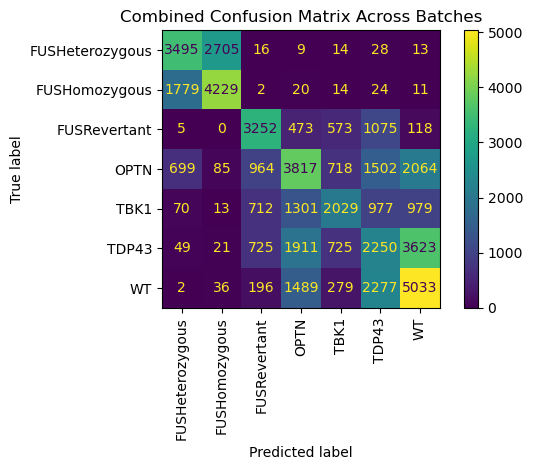


=== Evaluation Metrics ===
                    Label  Accuracy  Sensitivity  Specificity      PPV      NPV
FUSHeterozygous_Untreated  0.897158     0.556529     0.943540 0.573045 0.939851
  FUSHomozygous_Untreated  0.910116     0.695674     0.938258 0.596558 0.959172
   FUSRevertant_Untreated  0.907273     0.591703     0.944249 0.554287 0.951777
           OPTN_Untreated  0.785596     0.387552     0.877726 0.423171 0.860953
           TBK1_Untreated  0.878342     0.333662     0.949849 0.466222 0.915669
          TDP43_Untreated  0.753115     0.241831     0.863494 0.276651 0.840652
             WT_Untreated  0.788420     0.540485     0.842001 0.425049 0.894502
            Macro Average  0.845717     0.478205     0.908445 0.473569 0.908940


In [71]:
run_baseline_model(
    batches=[1, 2, 3, 7, 8, 9, 10],
    apply_pca = False,
    balance=False,
    norm=False,
    choose_features=False,
    top_k=20,
    classifier_class=cuMLLogisticRegression,
    classifier_kwargs=
)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.58      0.86      0.69      1222
  FUSHomozygous_Untreated       0.75      0.38      0.51      1245
   FUSRevertant_Untreated

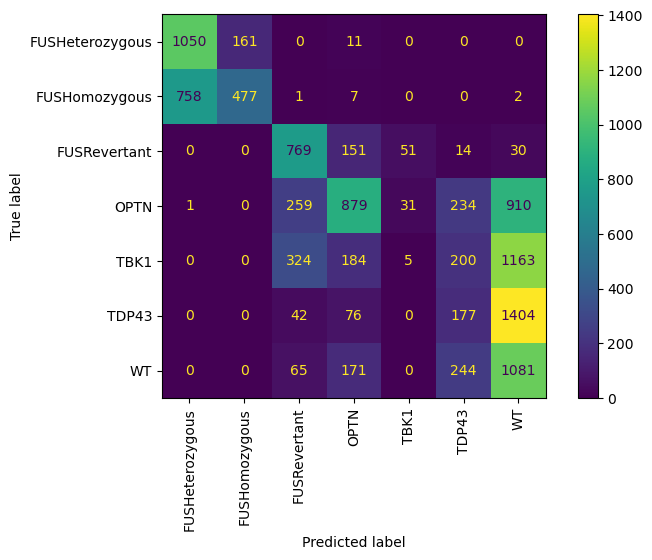

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.53      0.62      0.57      1231
  FUSHomozygous_Untreated       0.52      0.41      0.46      1162
   FUSRevertant_Untreated    

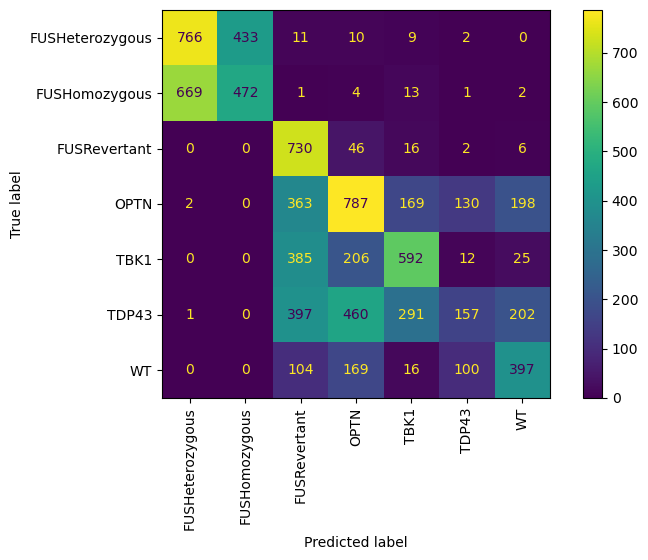

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.71      0.89      0.79      1004
  FUSHomozygous_Untreated       0.81      0.57      0.67       800
   FUSRevertant_Untreated     

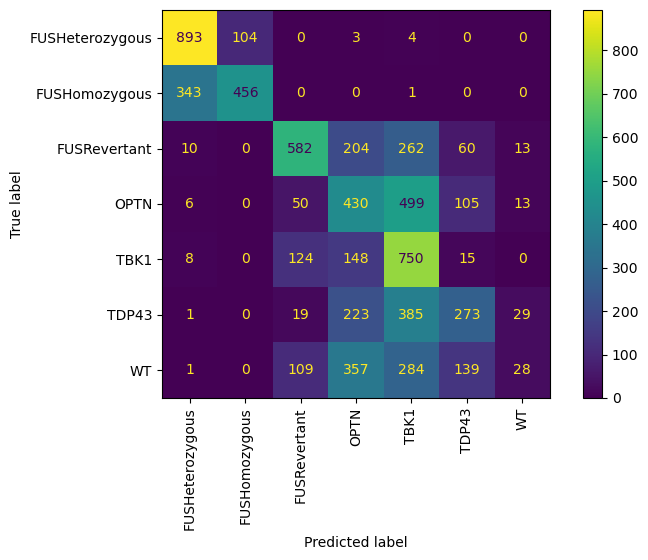

Train dataset
batches [1, 2, 3, 8, 9, 10]
(52238,) (52238, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
TDP43_Untreated: 9291
WT_Untreated: 9275
Test dataset
batches [7]
(163,) (163, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
TDP43_Untreated: 13
WT_Untreated: 37
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.50      0.04      0.07        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

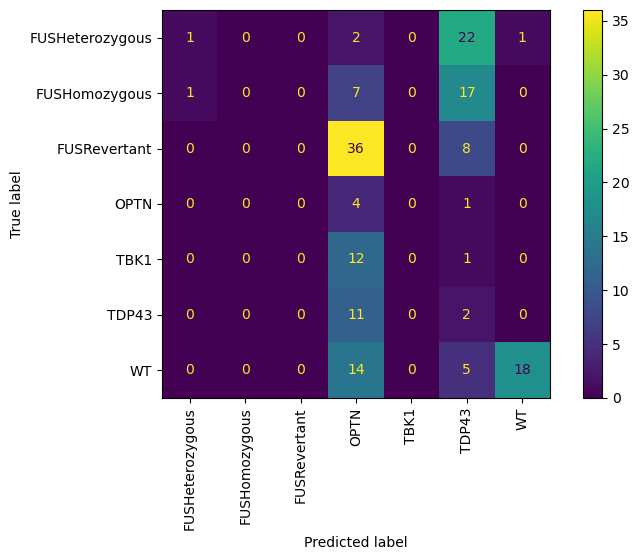

Train dataset
batches [1, 2, 3, 7, 9, 10]
(42851,) (42851, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
TDP43_Untreated: 7740
WT_Untreated: 7802
Test dataset
batches [8]
(9550,) (9550, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
TDP43_Untreated: 1564
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.79      0.10      0.18      1567
  FUSHomozygous_Untreated       0.52      0.97      0.67      1562
   FUSRevertant_Untreated   

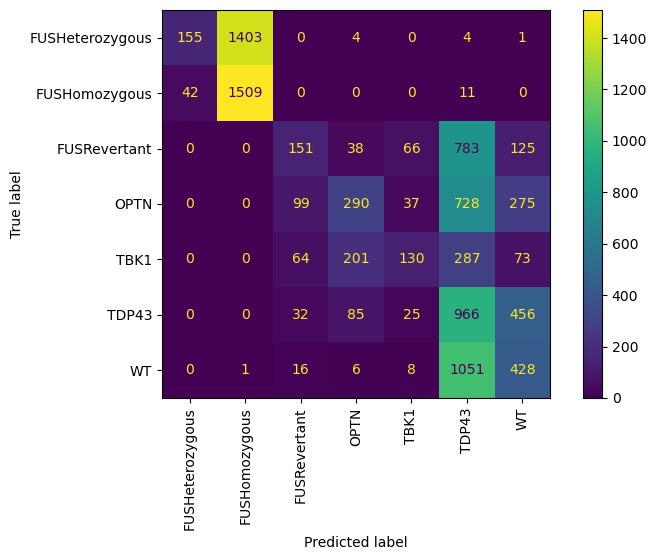

Train dataset
batches [1, 2, 3, 7, 8, 10]
(43208,) (43208, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
TDP43_Untreated: 7865
WT_Untreated: 7008
Test dataset
batches [9]
(9193,) (9193, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
TDP43_Untreated: 1439
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.15      0.18      0.16       963
  FUSHomozygous_Untreated       0.32      0.72      0.44       619
   FUSRevertant_Untreated     

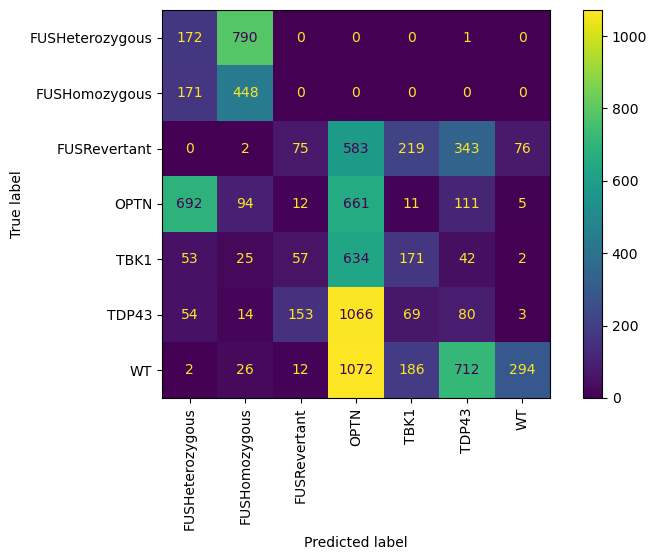

Train dataset
batches [1, 2, 3, 7, 8, 9]
(45125,) (45125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
TDP43_Untreated: 7153
WT_Untreated: 7116
Test dataset
batches [10]
(7276,) (7276, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
TDP43_Untreated: 2151
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.51      0.73      0.60       267
  FUSHomozygous_Untreated       0.89      0.72      0.79       666
   FUSRevertant_Untreated       

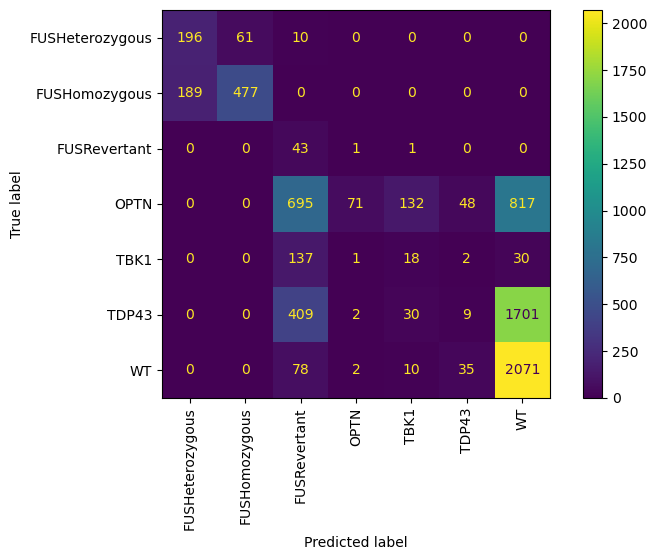

[0.40596414196853275, 0.46685016754427955, 0.49228105612465733, 0.15337423312883436, 0.38, 0.20678777330577613, 0.39650907091808685]


In [27]:
from sklearn.decomposition import PCA

## No norm no balance => minor improvement
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode labels
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # --- PCA (after optional normalization) ---
    pca = PCA(n_components=100, random_state=42)
    X_train = pca.fit_transform(X_train)
    X_test = pca.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)

    accuracies.append(report['accuracy'])

print(accuracies)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
TDP43_Untreated: 7605
WT_Untreated: 7751
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561
UMAP(n_components=100, n_jobs=1, random_state=42, verbose=True)


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Tue Aug  5 10:47:27 2025 Construct fuzzy simplicial set
Tue Aug  5 10:47:29 2025 Finding Nearest Neighbors
Tue Aug  5 10:47:30 2025 Building RP forest with 15 trees
Tue Aug  5 10:47:51 2025 NN descent for 15 iterations
	 1  /  15
	 2  /  15
	 3  /  15
	 4  /  15
	 5  /  15
	 6  /  15
	 7  /  15
	Stopping threshold met -- exiting after 7 iterations
Tue Aug  5 10:48:30 2025 Finished Nearest Neighbor Search
Tue Aug  5 10:48:33 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Tue Aug  5 10:50:02 2025 Finished embedding
Tue Aug  5 10:50:06 2025 Worst tree score: 0.12066845
Tue Aug  5 10:50:06 2025 Mean tree score: 0.13105050
Tue Aug  5 10:50:06 2025 Best tree score: 0.13622224
Tue Aug  5 10:50:10 2025 Forward diversification reduced edges from 622035 to 249890
Tue Aug  5 10:50:12 2025 Reverse diversification reduced edges from 249890 to 249890
Tue Aug  5 10:50:13 2025 Degree pruning reduced edges from 338180 to 304108
Tue Aug  5 10:50:13 2025 Resorting data and graph based on tree order
Tue Aug  5 10:50:14 2025 Building and compiling search function


Epochs completed:   0%|            0/30 [00:00]

	completed  0  /  30 epochs
	completed  3  /  30 epochs
	completed  6  /  30 epochs
	completed  9  /  30 epochs
	completed  12  /  30 epochs
	completed  15  /  30 epochs
	completed  18  /  30 epochs
	completed  21  /  30 epochs
	completed  24  /  30 epochs
	completed  27  /  30 epochs
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.63      0.39      0.48      1222
  FUSHomozygous_Untreated       0.58      0.82      0.68      1245
   FUSRevertant_Untreated       0.92      0.23      0.37      1015
           OPTN_Untreated       0.50      0.56      0.53      2314
           TBK1_Untreated       0.04      0.01      0.01      1876
          TDP43_Untreated       0.28      0.76      0.41      1699
             WT_Untreated       0.43      0.18      0.25      1561

                 accuracy                           0.42     10932
                macro avg       0.48      0.42      0.39     10932
             weighted avg     

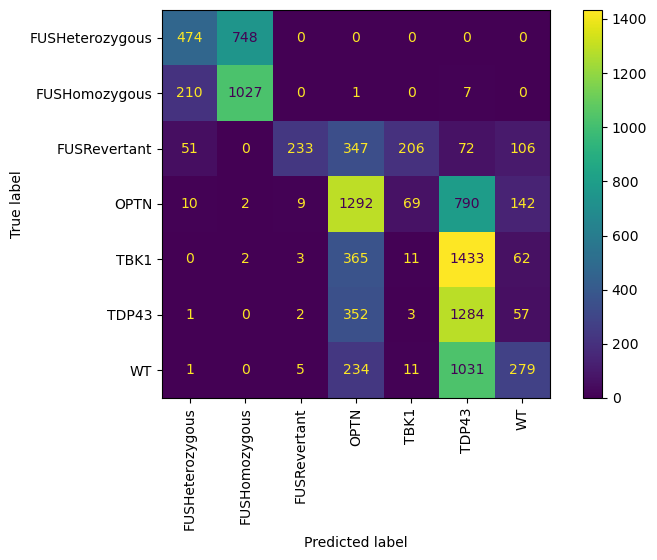

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
TDP43_Untreated: 7796
WT_Untreated: 8526
Test dataset
batches [2]
(8356,) (8356, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
TDP43_Untreated: 1508
WT_Untreated: 786
UMAP(n_components=100, n_jobs=1, random_state=42, verbose=True)


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Tue Aug  5 10:51:26 2025 Construct fuzzy simplicial set
Tue Aug  5 10:51:26 2025 Finding Nearest Neighbors
Tue Aug  5 10:51:26 2025 Building RP forest with 15 trees
Tue Aug  5 10:51:38 2025 NN descent for 15 iterations
	 1  /  15
	 2  /  15
	 3  /  15
	 4  /  15
	 5  /  15
	 6  /  15
	 7  /  15
	Stopping threshold met -- exiting after 7 iterations
Tue Aug  5 10:52:10 2025 Finished Nearest Neighbor Search
Tue Aug  5 10:52:11 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Tue Aug  5 10:53:36 2025 Finished embedding
Tue Aug  5 10:53:38 2025 Worst tree score: 0.12373709
Tue Aug  5 10:53:38 2025 Mean tree score: 0.13105082
Tue Aug  5 10:53:38 2025 Best tree score: 0.13808605
Tue Aug  5 10:53:40 2025 Forward diversification reduced edges from 660675 to 265074
Tue Aug  5 10:53:40 2025 Reverse diversification reduced edges from 265074 to 265074
Tue Aug  5 10:53:40 2025 Degree pruning reduced edges from 358906 to 323014
Tue Aug  5 10:53:40 2025 Resorting data and graph based on tree order
Tue Aug  5 10:53:41 2025 Building and compiling search function


Epochs completed:   0%|            0/100 [00:00]

	completed  0  /  100 epochs
	completed  10  /  100 epochs
	completed  20  /  100 epochs
	completed  30  /  100 epochs
	completed  40  /  100 epochs
	completed  50  /  100 epochs
	completed  60  /  100 epochs
	completed  70  /  100 epochs
	completed  80  /  100 epochs
	completed  90  /  100 epochs
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.64      0.36      0.46      1231
  FUSHomozygous_Untreated       0.55      0.79      0.65      1162
   FUSRevertant_Untreated       0.48      0.83      0.61       800
           OPTN_Untreated       0.49      0.61      0.54      1649
           TBK1_Untreated       0.38      0.32      0.35      1220
          TDP43_Untreated       0.31      0.23      0.27      1508
             WT_Untreated       0.41      0.22      0.29       786

                 accuracy                           0.47      8356
                macro avg       0.47      0.48      0.45      8356
             weig

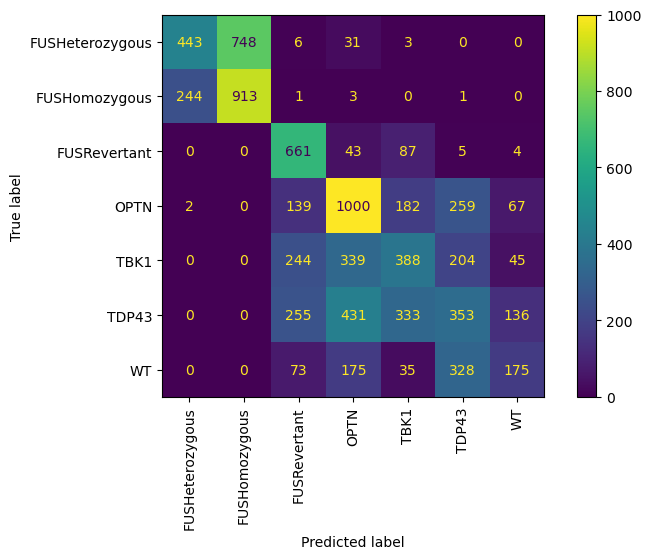

Train dataset
batches [1, 2, 7, 8, 9, 10]
(45470,) (45470, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
TDP43_Untreated: 8374
WT_Untreated: 8394
Test dataset
batches [3]
(6931,) (6931, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
TDP43_Untreated: 930
WT_Untreated: 918
UMAP(n_components=100, n_jobs=1, random_state=42, verbose=True)


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Tue Aug  5 10:54:48 2025 Construct fuzzy simplicial set
Tue Aug  5 10:54:48 2025 Finding Nearest Neighbors
Tue Aug  5 10:54:48 2025 Building RP forest with 16 trees
Tue Aug  5 10:55:03 2025 NN descent for 15 iterations
	 1  /  15
	 2  /  15
	 3  /  15
	 4  /  15
	 5  /  15
	 6  /  15
	 7  /  15
	Stopping threshold met -- exiting after 7 iterations
Tue Aug  5 10:55:40 2025 Finished Nearest Neighbor Search
Tue Aug  5 10:55:41 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs


KeyboardInterrupt: 

In [4]:
import umap

## No norm no balance => minor improvement
batches = [1,2,3,7,8,9,10]
accuracies = []

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode labels
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # --- PCA (after optional normalization) ---
    reducer = umap.UMAP(n_components=100, random_state=42, verbose=True)
    X_train = reducer.fit_transform(X_train, y_train_enc)
    X_test = reducer.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)

    accuracies.append(report['accuracy'])

print(accuracies)

Train dataset
batches [2, 3]
(15287,) (15287, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 2235
FUSHomozygous_Untreated: 1962
FUSRevertant_Untreated: 1931
OPTN_Untreated: 2752
TBK1_Untreated: 2265
TDP43_Untreated: 2438
WT_Untreated: 1704
Test dataset
batches [1]
(10932,) (10932, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
TDP43_Untreated: 1699
WT_Untreated: 1561

--- Chunk 1/29 (features 0 to 192) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.24      0.18      0.21      1222
  FUSHomozygous_Untreated       0.23      0.48      0.31      124

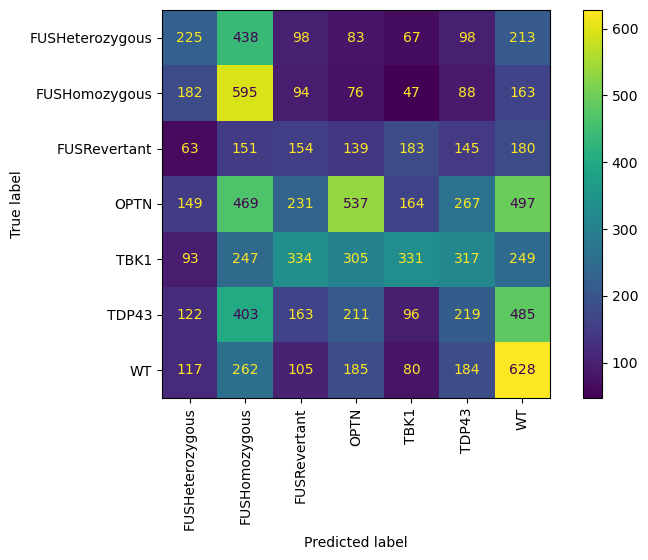


--- Chunk 2/29 (features 192 to 384) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.25      0.13      0.17      1222
  FUSHomozygous_Untreated       0.21      0.41      0.28      1245
   FUSRevertant_Untreated       0.42      0.28      0.34      1015
           OPTN_Untreated       0.19      0.10      0.13      2314
           TBK1_Untreated       0.15      0.06      0.09      1876
          TDP43_Untreated       0.21      0.50      0.29      1699
             WT_Untreated       0.42      0.28      0.33      1561

                 accuracy                           0.24     10932
                macro avg       0.26      0.25      0.23     10932
             weighted avg       0.25      0.24      0.22     10932



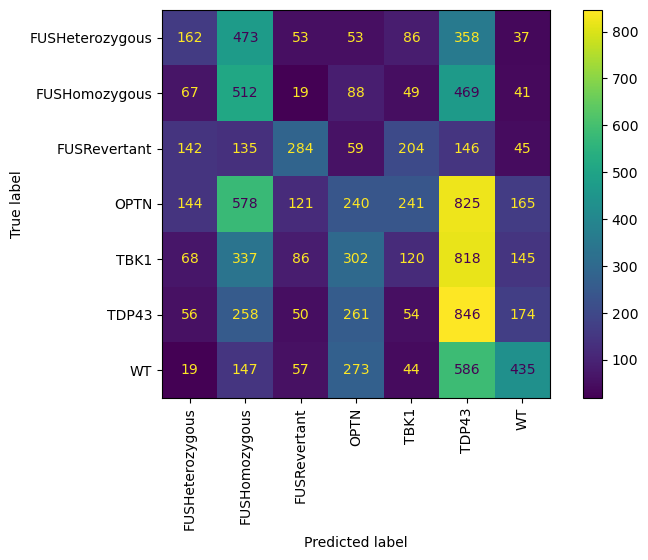


--- Chunk 3/29 (features 384 to 576) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.28      0.12      0.17      1222
  FUSHomozygous_Untreated       0.16      0.25      0.19      1245
   FUSRevertant_Untreated       0.43      0.21      0.28      1015
           OPTN_Untreated       0.25      0.44      0.31      2314
           TBK1_Untreated       0.18      0.08      0.11      1876
          TDP43_Untreated       0.23      0.26      0.24      1699
             WT_Untreated       0.21      0.13      0.16      1561

                 accuracy                           0.23     10932
                macro avg       0.25      0.21      0.21     10932
             weighted avg       0.24      0.23      0.21     10932



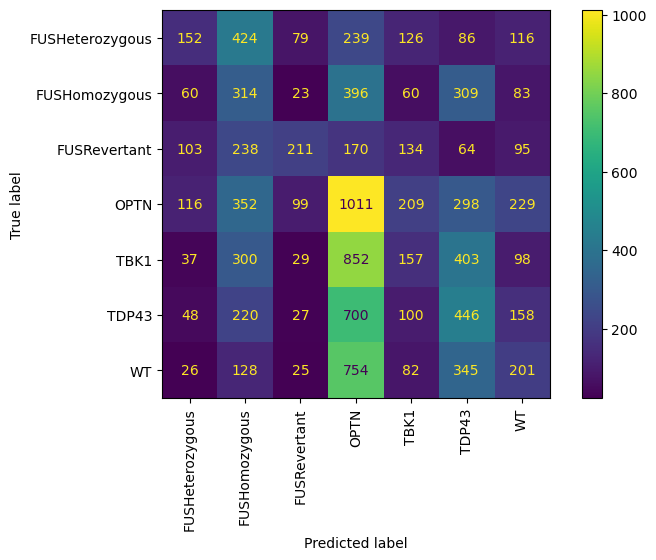


--- Chunk 4/29 (features 576 to 768) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.14      0.14      0.14      1222
  FUSHomozygous_Untreated       0.19      0.28      0.23      1245
   FUSRevertant_Untreated       0.12      0.22      0.15      1015
           OPTN_Untreated       0.27      0.17      0.21      2314
           TBK1_Untreated       0.21      0.15      0.18      1876
          TDP43_Untreated       0.17      0.11      0.14      1699
             WT_Untreated       0.19      0.24      0.21      1561

                 accuracy                           0.18     10932
                macro avg       0.18      0.19      0.18     10932
             weighted avg       0.19      0.18      0.18     10932



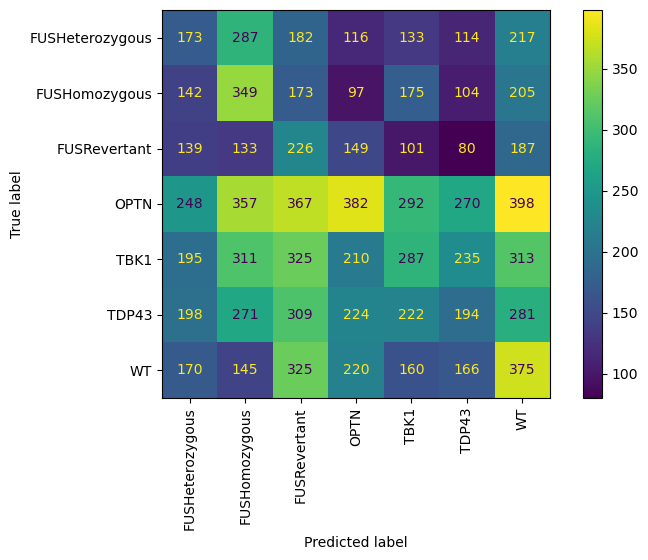


--- Chunk 5/29 (features 768 to 960) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.21      0.12      0.16      1222
  FUSHomozygous_Untreated       0.21      0.11      0.14      1245
   FUSRevertant_Untreated       0.23      0.31      0.27      1015
           OPTN_Untreated       0.24      0.26      0.25      2314
           TBK1_Untreated       0.28      0.33      0.30      1876
          TDP43_Untreated       0.23      0.32      0.27      1699
             WT_Untreated       0.29      0.21      0.25      1561

                 accuracy                           0.25     10932
                macro avg       0.24      0.24      0.23     10932
             weighted avg       0.24      0.25      0.24     10932



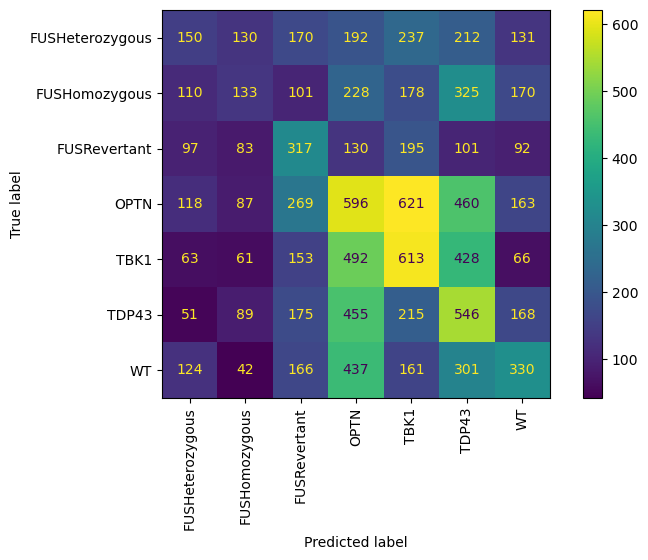


--- Chunk 6/29 (features 960 to 1152) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.24      0.18      0.20      1222
  FUSHomozygous_Untreated       0.22      0.14      0.17      1245
   FUSRevertant_Untreated       0.44      0.31      0.36      1015
           OPTN_Untreated       0.28      0.30      0.29      2314
           TBK1_Untreated       0.20      0.09      0.12      1876
          TDP43_Untreated       0.22      0.33      0.27      1699
             WT_Untreated       0.16      0.29      0.21      1561

                 accuracy                           0.24     10932
                macro avg       0.25      0.23      0.23     10932
             weighted avg       0.25      0.24      0.23     10932



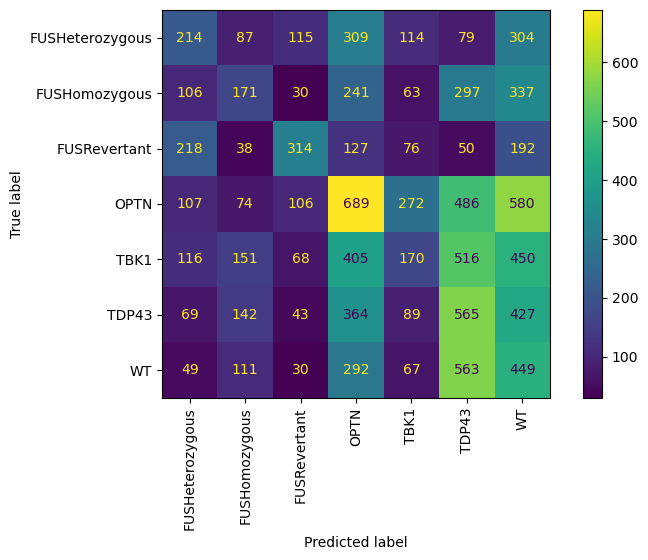


--- Chunk 7/29 (features 1152 to 1344) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.50      0.60      0.55      1222
  FUSHomozygous_Untreated       0.52      0.42      0.46      1245
   FUSRevertant_Untreated       0.13      0.05      0.07      1015
           OPTN_Untreated       0.38      0.73      0.50      2314
           TBK1_Untreated       0.13      0.01      0.03      1876
          TDP43_Untreated       0.22      0.03      0.05      1699
             WT_Untreated       0.24      0.50      0.32      1561

                 accuracy                           0.35     10932
                macro avg       0.30      0.33      0.28     10932
             weighted avg       0.30      0.35      0.28     10932



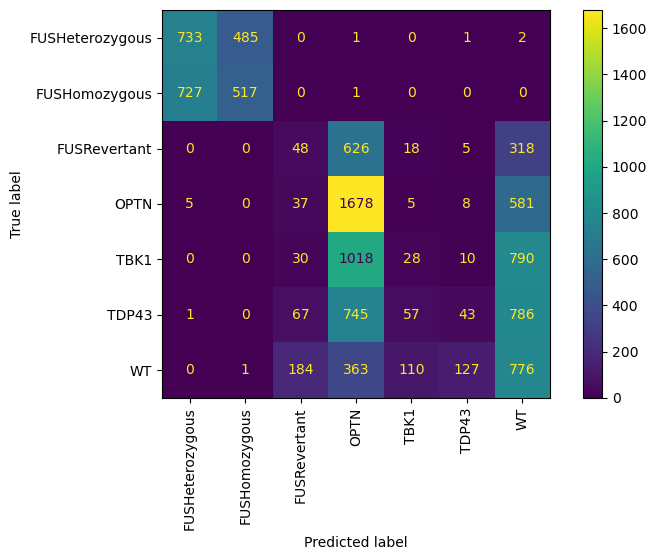


--- Chunk 8/29 (features 1344 to 1536) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.20      0.27      0.23      1222
  FUSHomozygous_Untreated       0.28      0.23      0.25      1245
   FUSRevertant_Untreated       0.30      0.36      0.33      1015
           OPTN_Untreated       0.27      0.20      0.23      2314
           TBK1_Untreated       0.18      0.08      0.11      1876
          TDP43_Untreated       0.19      0.20      0.19      1699
             WT_Untreated       0.20      0.35      0.26      1561

                 accuracy                           0.23     10932
                macro avg       0.23      0.24      0.23     10932
             weighted avg       0.23      0.23      0.22     10932



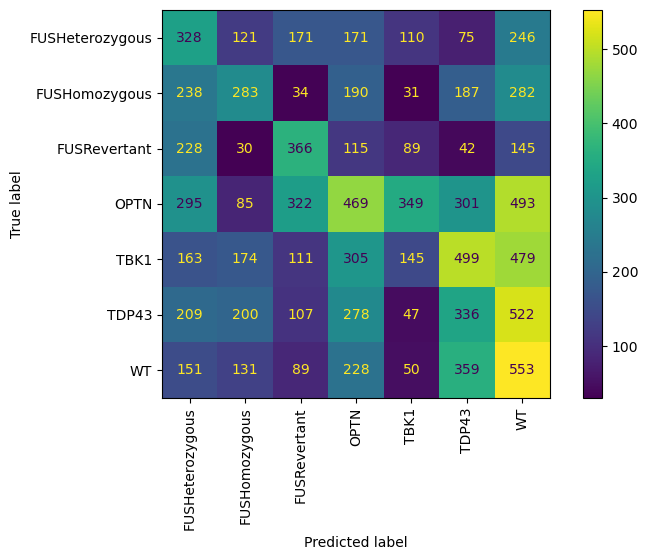


--- Chunk 9/29 (features 1536 to 1728) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.15      0.20      0.17      1222
  FUSHomozygous_Untreated       0.11      0.15      0.13      1245
   FUSRevertant_Untreated       0.33      0.06      0.10      1015
           OPTN_Untreated       0.23      0.21      0.22      2314
           TBK1_Untreated       0.20      0.04      0.07      1876
          TDP43_Untreated       0.16      0.25      0.19      1699
             WT_Untreated       0.17      0.24      0.20      1561

                 accuracy                           0.17     10932
                macro avg       0.19      0.16      0.15     10932
             weighted avg       0.19      0.17      0.16     10932



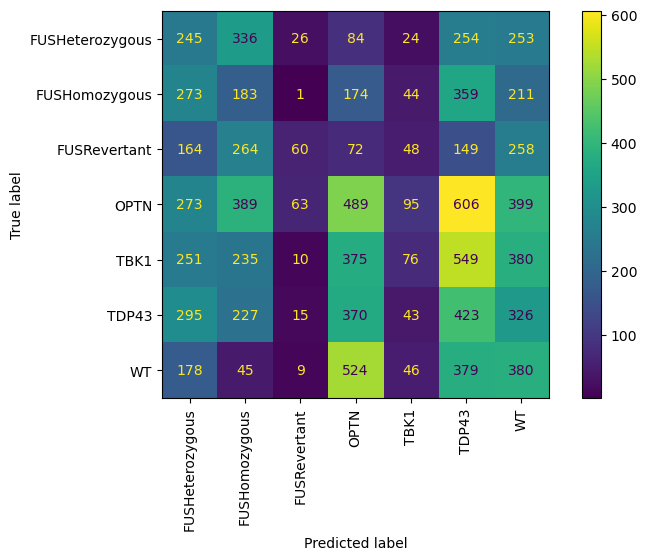


--- Chunk 10/29 (features 1728 to 1920) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.29      0.23      0.26      1222
  FUSHomozygous_Untreated       0.25      0.32      0.28      1245
   FUSRevertant_Untreated       0.42      0.20      0.27      1015
           OPTN_Untreated       0.25      0.28      0.27      2314
           TBK1_Untreated       0.17      0.06      0.08      1876
          TDP43_Untreated       0.19      0.23      0.20      1699
             WT_Untreated       0.20      0.34      0.25      1561

                 accuracy                           0.23     10932
                macro avg       0.25      0.24      0.23     10932
             weighted avg       0.24      0.23      0.22     10932



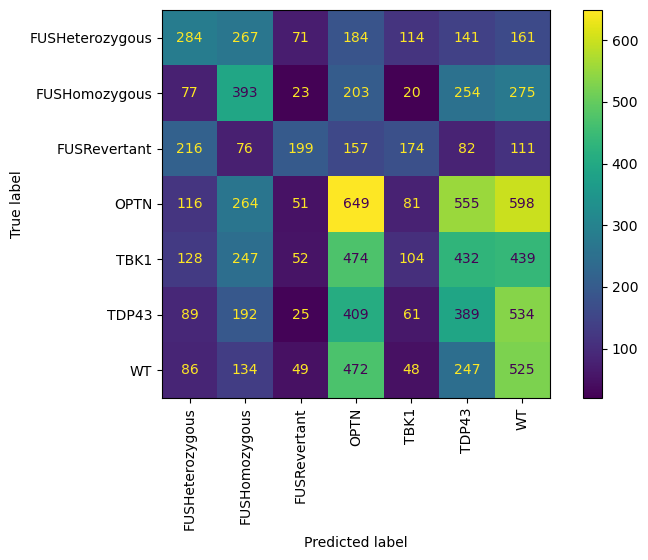


--- Chunk 11/29 (features 1920 to 2112) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.20      0.15      0.17      1222
  FUSHomozygous_Untreated       0.20      0.45      0.27      1245
   FUSRevertant_Untreated       0.17      0.20      0.18      1015
           OPTN_Untreated       0.23      0.11      0.15      2314
           TBK1_Untreated       0.22      0.15      0.18      1876
          TDP43_Untreated       0.22      0.30      0.25      1699
             WT_Untreated       0.23      0.20      0.21      1561

                 accuracy                           0.21     10932
                macro avg       0.21      0.22      0.20     10932
             weighted avg       0.21      0.21      0.20     10932



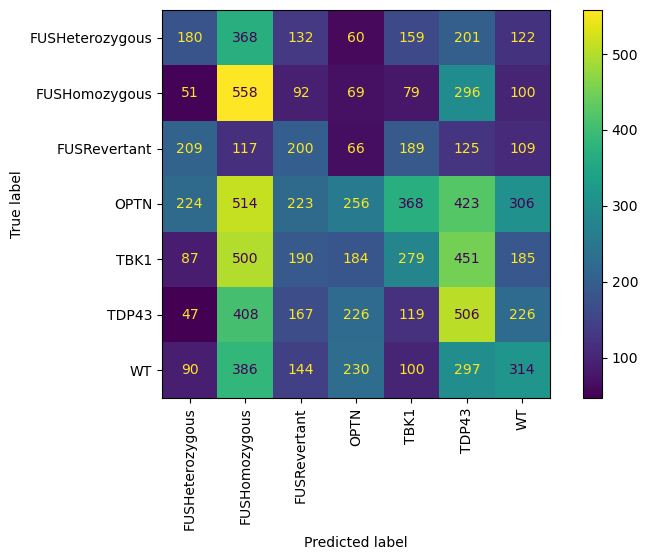


--- Chunk 12/29 (features 2112 to 2304) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.20      0.20      0.20      1222
  FUSHomozygous_Untreated       0.23      0.27      0.25      1245
   FUSRevertant_Untreated       0.13      0.22      0.16      1015
           OPTN_Untreated       0.47      0.18      0.27      2314
           TBK1_Untreated       0.26      0.09      0.14      1876
          TDP43_Untreated       0.18      0.11      0.14      1699
             WT_Untreated       0.24      0.59      0.34      1561

                 accuracy                           0.23     10932
                macro avg       0.24      0.24      0.21     10932
             weighted avg       0.27      0.23      0.22     10932



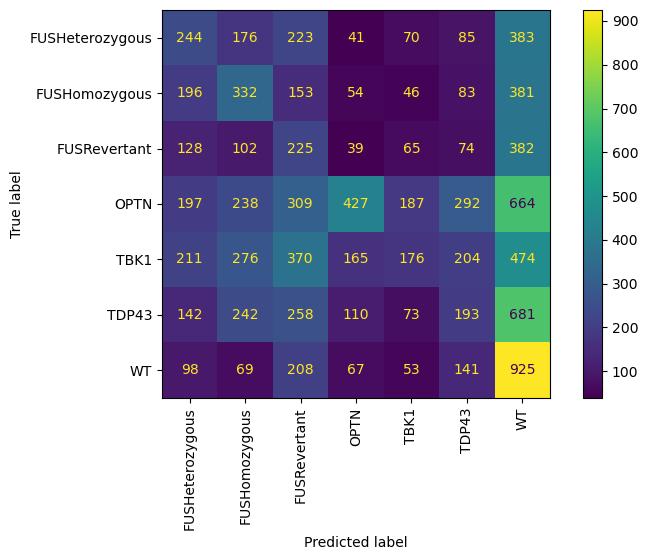


--- Chunk 13/29 (features 2304 to 2496) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.18      0.21      0.19      1222
  FUSHomozygous_Untreated       0.18      0.35      0.23      1245
   FUSRevertant_Untreated       0.13      0.16      0.14      1015
           OPTN_Untreated       0.25      0.21      0.23      2314
           TBK1_Untreated       0.26      0.14      0.18      1876
          TDP43_Untreated       0.16      0.07      0.10      1699
             WT_Untreated       0.28      0.37      0.32      1561

                 accuracy                           0.21     10932
                macro avg       0.21      0.22      0.20     10932
             weighted avg       0.22      0.21      0.20     10932



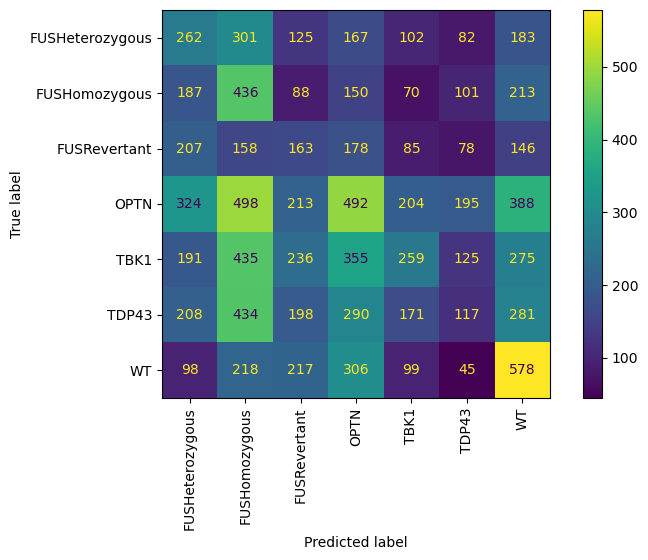


--- Chunk 14/29 (features 2496 to 2688) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.25      0.29      0.27      1222
  FUSHomozygous_Untreated       0.31      0.16      0.21      1245
   FUSRevertant_Untreated       0.12      0.27      0.17      1015
           OPTN_Untreated       0.26      0.09      0.14      2314
           TBK1_Untreated       0.19      0.27      0.23      1876
          TDP43_Untreated       0.17      0.11      0.14      1699
             WT_Untreated       0.24      0.33      0.28      1561

                 accuracy                           0.20     10932
                macro avg       0.22      0.22      0.20     10932
             weighted avg       0.22      0.20      0.20     10932



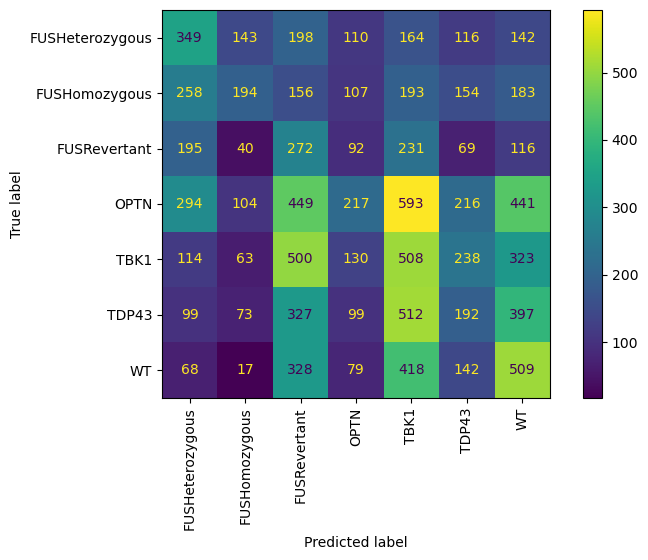


--- Chunk 15/29 (features 2688 to 2880) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.16      0.25      0.20      1222
  FUSHomozygous_Untreated       0.23      0.18      0.20      1245
   FUSRevertant_Untreated       0.16      0.32      0.21      1015
           OPTN_Untreated       0.16      0.13      0.15      2314
           TBK1_Untreated       0.07      0.04      0.05      1876
          TDP43_Untreated       0.21      0.21      0.21      1699
             WT_Untreated       0.15      0.14      0.14      1561

                 accuracy                           0.17     10932
                macro avg       0.16      0.18      0.17     10932
             weighted avg       0.16      0.17      0.16     10932



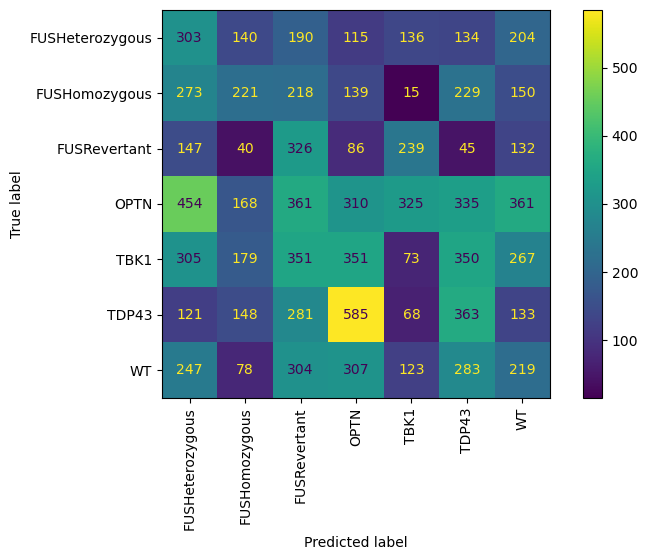


--- Chunk 16/29 (features 2880 to 3072) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.22      0.26      0.24      1222
  FUSHomozygous_Untreated       0.21      0.25      0.23      1245
   FUSRevertant_Untreated       0.26      0.27      0.27      1015
           OPTN_Untreated       0.32      0.18      0.23      2314
           TBK1_Untreated       0.16      0.04      0.07      1876
          TDP43_Untreated       0.19      0.32      0.24      1699
             WT_Untreated       0.17      0.25      0.20      1561

                 accuracy                           0.21     10932
                macro avg       0.22      0.23      0.21     10932
             weighted avg       0.22      0.21      0.20     10932



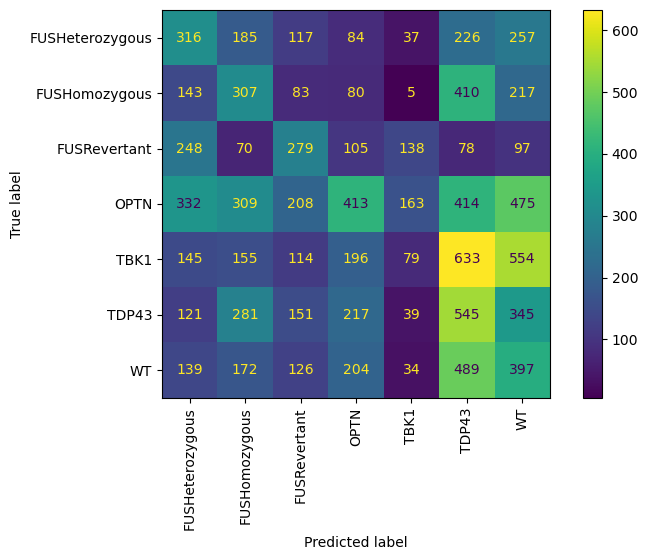


--- Chunk 17/29 (features 3072 to 3264) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.36      0.40      0.38      1222
  FUSHomozygous_Untreated       0.47      0.35      0.40      1245
   FUSRevertant_Untreated       0.14      0.35      0.20      1015
           OPTN_Untreated       0.30      0.12      0.17      2314
           TBK1_Untreated       0.29      0.12      0.16      1876
          TDP43_Untreated       0.26      0.17      0.21      1699
             WT_Untreated       0.26      0.53      0.35      1561

                 accuracy                           0.26     10932
                macro avg       0.30      0.29      0.27     10932
             weighted avg       0.30      0.26      0.25     10932



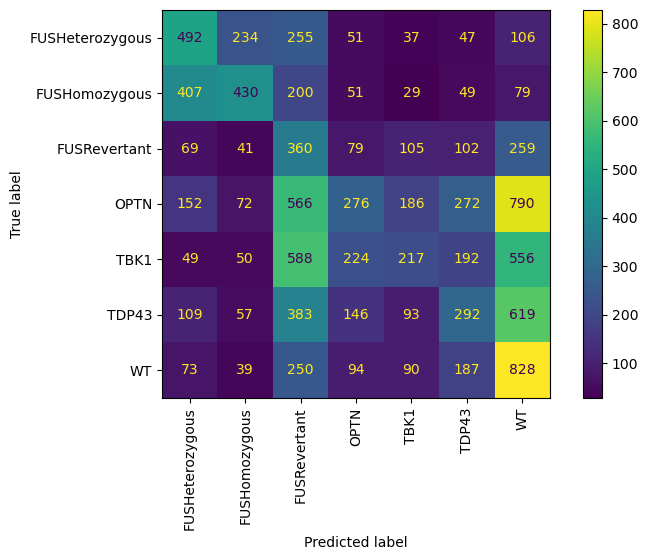


--- Chunk 18/29 (features 3264 to 3456) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.24      0.15      0.18      1222
  FUSHomozygous_Untreated       0.19      0.21      0.20      1245
   FUSRevertant_Untreated       0.11      0.21      0.14      1015
           OPTN_Untreated       0.31      0.36      0.33      2314
           TBK1_Untreated       0.15      0.05      0.08      1876
          TDP43_Untreated       0.23      0.19      0.21      1699
             WT_Untreated       0.26      0.33      0.29      1561

                 accuracy                           0.22     10932
                macro avg       0.21      0.22      0.20     10932
             weighted avg       0.22      0.22      0.21     10932



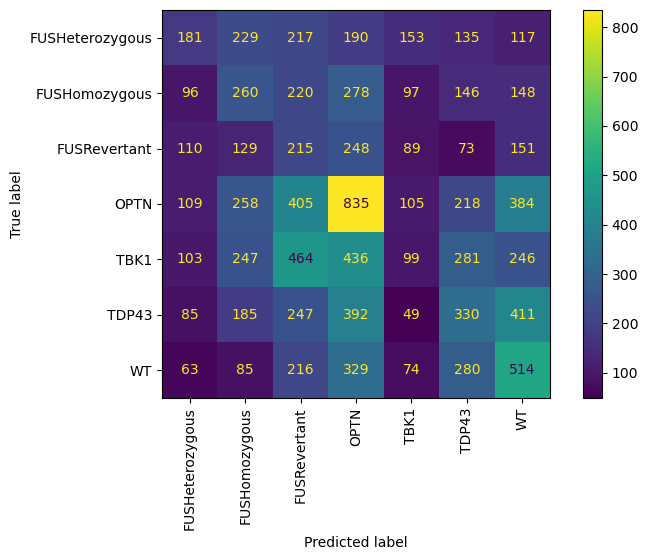


--- Chunk 19/29 (features 3456 to 3648) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.23      0.15      0.18      1222
  FUSHomozygous_Untreated       0.18      0.24      0.21      1245
   FUSRevertant_Untreated       0.47      0.21      0.29      1015
           OPTN_Untreated       0.33      0.09      0.14      2314
           TBK1_Untreated       0.14      0.06      0.08      1876
          TDP43_Untreated       0.20      0.65      0.31      1699
             WT_Untreated       0.23      0.18      0.20      1561

                 accuracy                           0.22     10932
                macro avg       0.26      0.23      0.20     10932
             weighted avg       0.25      0.22      0.19     10932



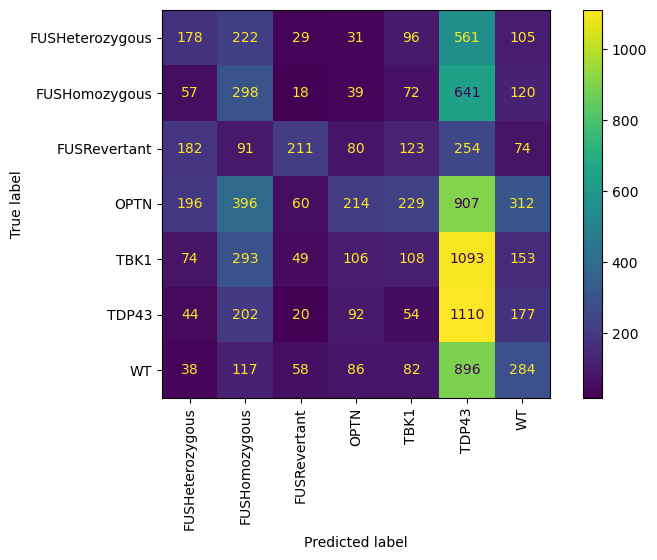


--- Chunk 20/29 (features 3648 to 3840) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.20      0.24      0.22      1222
  FUSHomozygous_Untreated       0.29      0.22      0.25      1245
   FUSRevertant_Untreated       0.28      0.36      0.31      1015
           OPTN_Untreated       0.28      0.23      0.25      2314
           TBK1_Untreated       0.22      0.06      0.09      1876
          TDP43_Untreated       0.20      0.21      0.21      1699
             WT_Untreated       0.19      0.38      0.25      1561

                 accuracy                           0.23     10932
                macro avg       0.24      0.24      0.23     10932
             weighted avg       0.24      0.23      0.22     10932



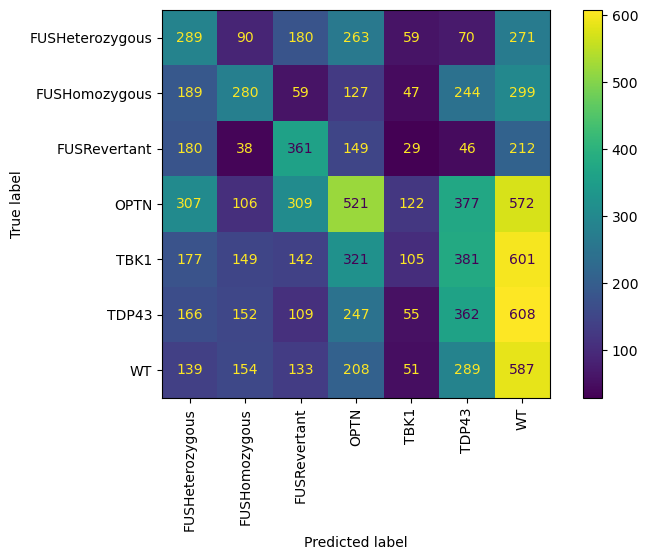


--- Chunk 21/29 (features 3840 to 4032) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.25      0.25      0.25      1222
  FUSHomozygous_Untreated       0.21      0.32      0.25      1245
   FUSRevertant_Untreated       0.33      0.30      0.31      1015
           OPTN_Untreated       0.21      0.19      0.20      2314
           TBK1_Untreated       0.19      0.07      0.10      1876
          TDP43_Untreated       0.17      0.22      0.19      1699
             WT_Untreated       0.24      0.31      0.27      1561

                 accuracy                           0.22     10932
                macro avg       0.23      0.24      0.23     10932
             weighted avg       0.22      0.22      0.21     10932



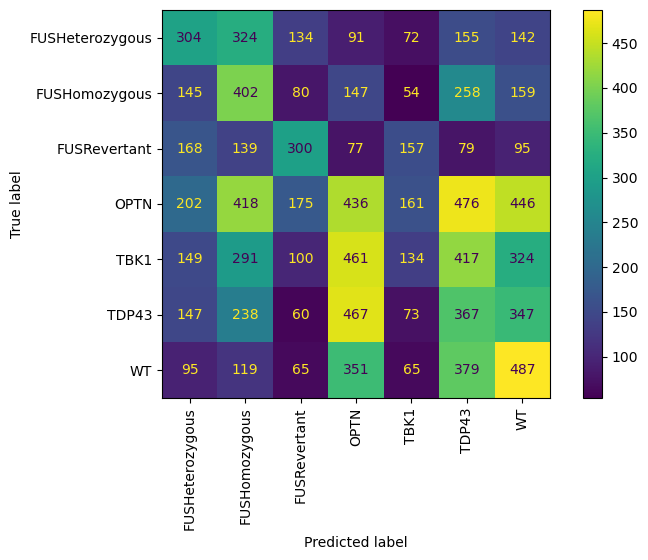


--- Chunk 22/29 (features 4032 to 4224) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.22      0.24      0.23      1222
  FUSHomozygous_Untreated       0.23      0.29      0.26      1245
   FUSRevertant_Untreated       0.18      0.31      0.23      1015
           OPTN_Untreated       0.27      0.22      0.24      2314
           TBK1_Untreated       0.20      0.07      0.11      1876
          TDP43_Untreated       0.23      0.17      0.20      1699
             WT_Untreated       0.26      0.41      0.32      1561

                 accuracy                           0.23     10932
                macro avg       0.23      0.24      0.23     10932
             weighted avg       0.23      0.23      0.22     10932



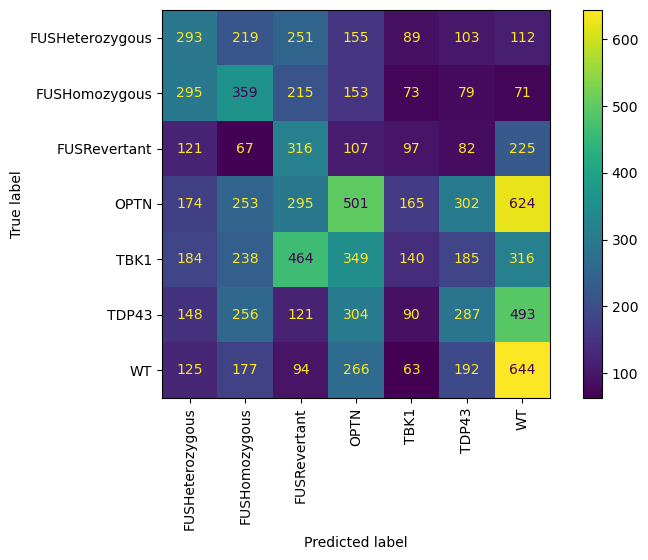


--- Chunk 23/29 (features 4224 to 4416) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.23      0.13      0.17      1222
  FUSHomozygous_Untreated       0.17      0.27      0.21      1245
   FUSRevertant_Untreated       0.22      0.23      0.23      1015
           OPTN_Untreated       0.28      0.22      0.25      2314
           TBK1_Untreated       0.13      0.04      0.06      1876
          TDP43_Untreated       0.18      0.32      0.23      1699
             WT_Untreated       0.14      0.14      0.14      1561

                 accuracy                           0.19     10932
                macro avg       0.19      0.19      0.18     10932
             weighted avg       0.19      0.19      0.18     10932



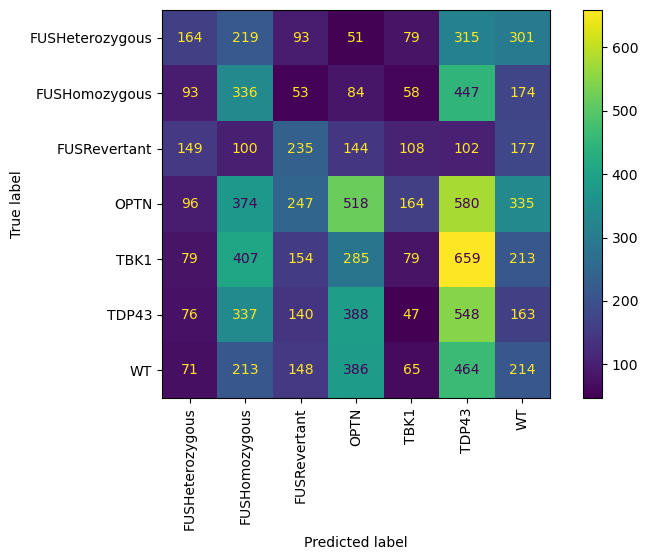


--- Chunk 24/29 (features 4416 to 4608) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.18      0.09      0.12      1222
  FUSHomozygous_Untreated       0.20      0.43      0.27      1245
   FUSRevertant_Untreated       0.18      0.24      0.21      1015
           OPTN_Untreated       0.23      0.19      0.21      2314
           TBK1_Untreated       0.21      0.19      0.20      1876
          TDP43_Untreated       0.18      0.17      0.17      1699
             WT_Untreated       0.15      0.11      0.13      1561

                 accuracy                           0.20     10932
                macro avg       0.19      0.20      0.19     10932
             weighted avg       0.20      0.20      0.19     10932



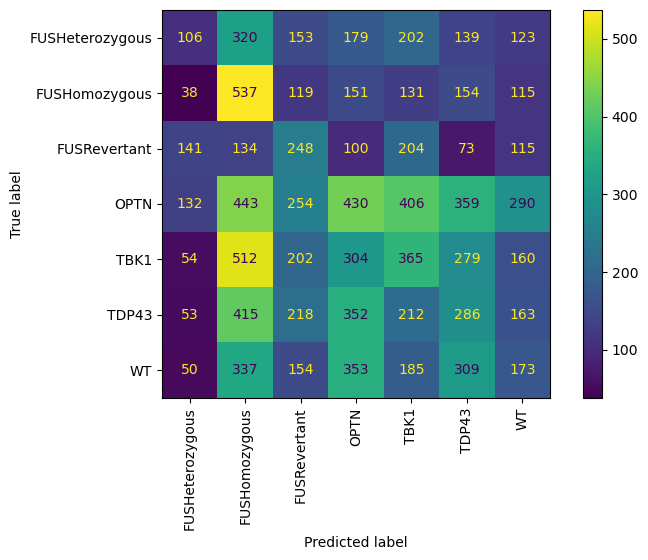


--- Chunk 25/29 (features 4608 to 4800) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.29      0.21      0.24      1222
  FUSHomozygous_Untreated       0.21      0.21      0.21      1245
   FUSRevertant_Untreated       0.19      0.27      0.23      1015
           OPTN_Untreated       0.29      0.34      0.31      2314
           TBK1_Untreated       0.24      0.12      0.15      1876
          TDP43_Untreated       0.27      0.30      0.28      1699
             WT_Untreated       0.27      0.33      0.30      1561

                 accuracy                           0.26     10932
                macro avg       0.25      0.25      0.25     10932
             weighted avg       0.26      0.26      0.25     10932



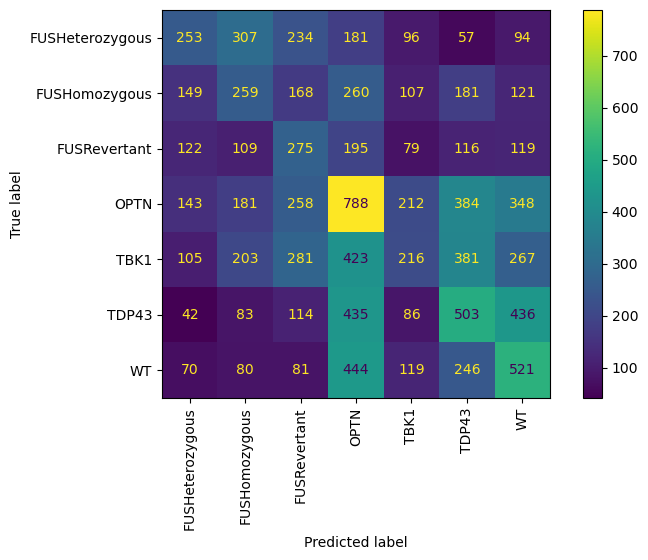


--- Chunk 26/29 (features 4800 to 4992) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.22      0.36      0.27      1222
  FUSHomozygous_Untreated       0.17      0.17      0.17      1245
   FUSRevertant_Untreated       0.09      0.23      0.13      1015
           OPTN_Untreated       0.27      0.26      0.27      2314
           TBK1_Untreated       0.26      0.10      0.15      1876
          TDP43_Untreated       0.18      0.07      0.11      1699
             WT_Untreated       0.31      0.30      0.31      1561

                 accuracy                           0.21     10932
                macro avg       0.22      0.21      0.20     10932
             weighted avg       0.23      0.21      0.20     10932



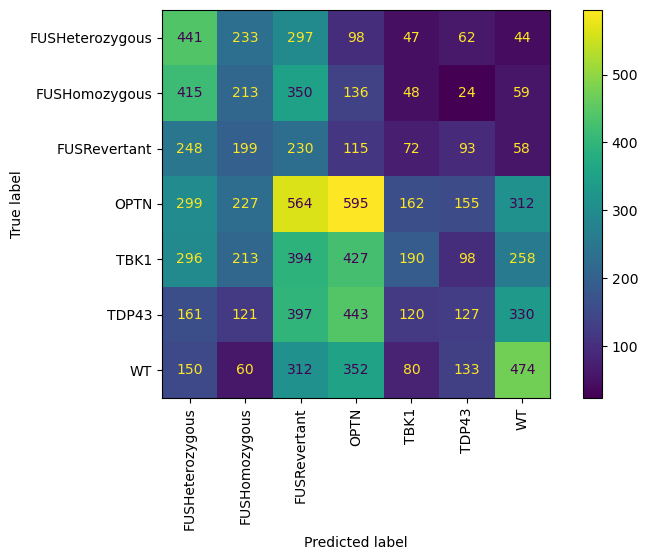


--- Chunk 27/29 (features 4992 to 5184) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.18      0.28      0.22      1222
  FUSHomozygous_Untreated       0.26      0.23      0.24      1245
   FUSRevertant_Untreated       0.12      0.20      0.15      1015
           OPTN_Untreated       0.35      0.27      0.30      2314
           TBK1_Untreated       0.28      0.16      0.20      1876
          TDP43_Untreated       0.19      0.11      0.14      1699
             WT_Untreated       0.26      0.41      0.32      1561

                 accuracy                           0.23     10932
                macro avg       0.23      0.24      0.22     10932
             weighted avg       0.25      0.23      0.23     10932



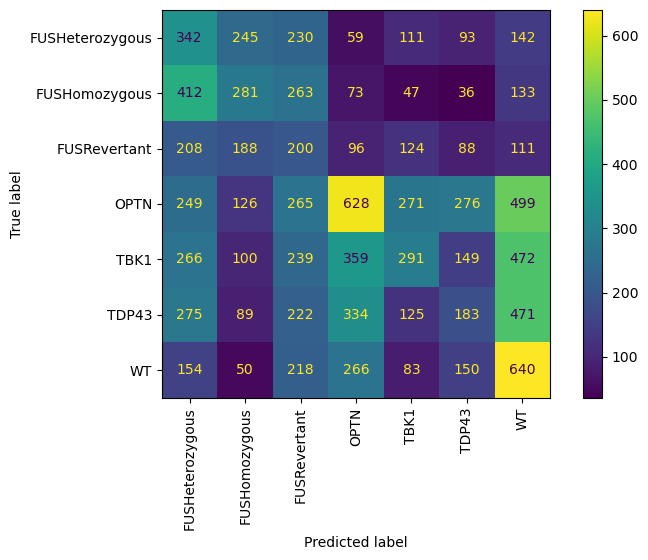


--- Chunk 28/29 (features 5184 to 5376) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.19      0.09      0.12      1222
  FUSHomozygous_Untreated       0.17      0.27      0.21      1245
   FUSRevertant_Untreated       0.17      0.20      0.18      1015
           OPTN_Untreated       0.24      0.12      0.16      2314
           TBK1_Untreated       0.22      0.20      0.21      1876
          TDP43_Untreated       0.19      0.33      0.24      1699
             WT_Untreated       0.18      0.15      0.17      1561

                 accuracy                           0.19     10932
                macro avg       0.19      0.20      0.18     10932
             weighted avg       0.20      0.19      0.19     10932



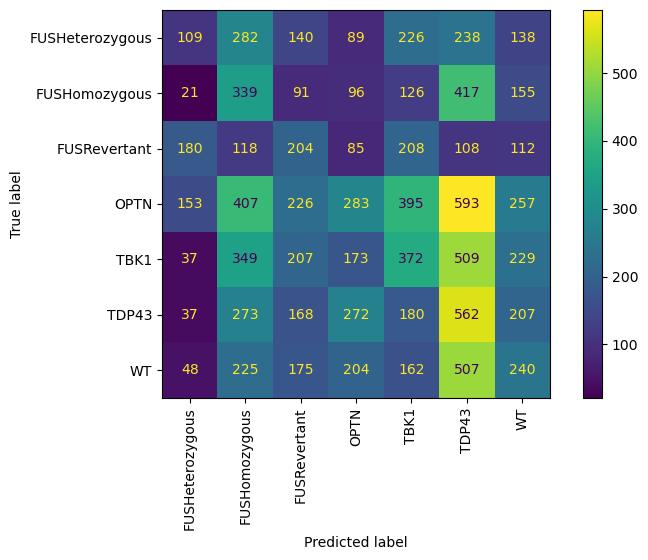


--- Chunk 29/29 (features 5376 to 5568) ---
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.17      0.28      0.21      1222
  FUSHomozygous_Untreated       0.23      0.25      0.24      1245
   FUSRevertant_Untreated       0.18      0.67      0.28      1015
           OPTN_Untreated       0.33      0.20      0.25      2314
           TBK1_Untreated       0.30      0.09      0.14      1876
          TDP43_Untreated       0.19      0.12      0.14      1699
             WT_Untreated       0.31      0.15      0.20      1561

                 accuracy                           0.22     10932
                macro avg       0.24      0.25      0.21     10932
             weighted avg       0.26      0.22      0.20     10932



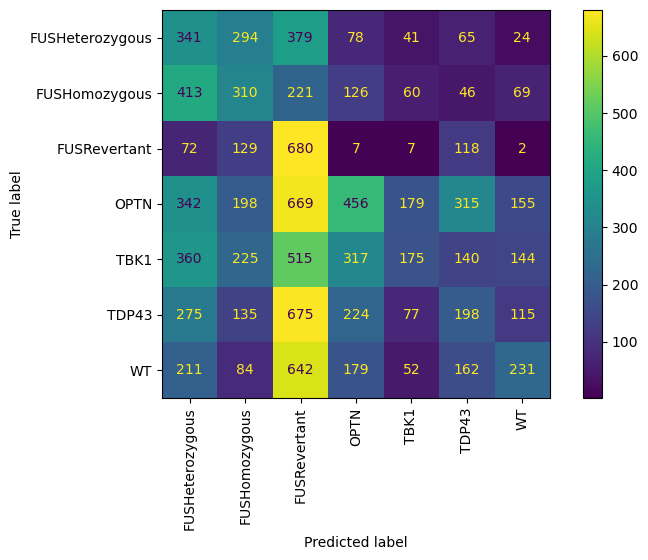


All chunk accuracies: [0.2459751189169411, 0.23774240761068424, 0.22795462861324553, 0.18166849615806804, 0.24560922063666302, 0.23527259421880717, 0.34970728137577756, 0.22685693377241126, 0.16977680204903037, 0.23261983168679107, 0.2097511891694109, 0.23069886571533113, 0.21103183315038418, 0.20499451152579584, 0.16602634467618002, 0.21368459568240028, 0.26481888035126233, 0.22264910354921333, 0.21981339187705817, 0.22914379802414928, 0.22228320526893525, 0.2323454079765825, 0.19154774972557628, 0.19621295279912185, 0.2575009147457007, 0.20764727405781191, 0.23463227222832053, 0.1929198682766191, 0.21871569703622393]


In [10]:
## No norm no balance => minor improvement
batches = [1,2,3,]#7,8,9,10]
accuracies = []

test_batch = batches[0]
test_batches = [test_batch]
train_batches = list(set(batches) - set(test_batches))

X_train, y_train = load_batches(train_batches)
X_test, y_test = load_batches(test_batches)

print('Train dataset')
print('batches', train_batches)
print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
count_labels(y_train)
print('Test dataset')
print('batches', test_batches)
print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
count_labels(y_test)

# Encode labels
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
y_test_enc = le.transform(y_test)

# Optional: balance
balance = True
if balance:
    ros = RandomOverSampler(random_state=42)
    X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

# Optional: normalize
norm = True
if norm:
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)

chunk_size = 192
n_chunks = X_train.shape[1] // chunk_size
accuracies = []

for i in range(n_chunks):
    print(f"\n--- Chunk {i+1}/{n_chunks} (features {i*chunk_size} to {(i+1)*chunk_size}) ---")
    
    # Slice marker chunk
    X_train_chunk = X_train[:, i*chunk_size : (i+1)*chunk_size]
    X_test_chunk = X_test[:, i*chunk_size : (i+1)*chunk_size]

    # Convert to GPU
    X_train_gpu = cudf.DataFrame.from_records(X_train_chunk)
    X_test_gpu = cudf.DataFrame.from_records(X_test_chunk)
    y_train_gpu = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=0)
    clf.fit(X_train_gpu, y_train_gpu)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test_gpu).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)

    accuracies.append(report['accuracy'])

print(f"\nAll chunk accuracies: {accuracies}")


In [15]:
def spearman_gpu(X, y, top_n=100):
    # Convert to GPU
    X_gpu = cp.asarray(X)
    y_gpu = cp.asarray(y)

    # Rank columns of X and y
    X_ranked = X_gpu.argsort(axis=0).argsort(axis=0).astype(cp.float32)
    y_ranked = y_gpu.argsort().argsort().astype(cp.float32)

    # Centered ranks
    X_ranked -= X_ranked.mean(axis=0)
    y_ranked -= y_ranked.mean()

    # Compute numerator and denominator of correlation
    numerator = cp.sum(X_ranked * y_ranked[:, None], axis=0)
    denominator = cp.sqrt(cp.sum(X_ranked**2, axis=0) * cp.sum(y_ranked**2))
    correlations = numerator / denominator

    # Get top N features by absolute correlation
    top_indices = cp.argsort(cp.abs(correlations))[-top_n:][::-1].get()
    return top_indices, correlations[top_indices].get()

X_train, y_train = load_batches(batches)
# Encode string labels to integers
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
top_indices, top_corrs = spearman_gpu(X_train, y_train_enc, top_n=100)
X_train_selected = X_train[:, top_indices]

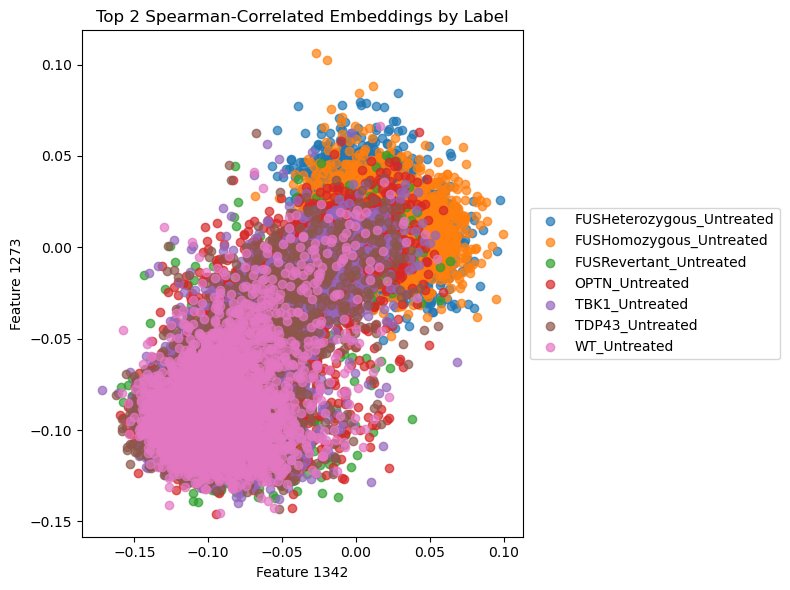

In [18]:
feat1, feat2 = top_indices[:2]
X_vis = X_train[:, [feat1, feat2]]

# Convert encoded labels back to original strings
labels_str = le.inverse_transform(y_train_enc)

# Create a scatter plot
plt.figure(figsize=(8, 6))
for label in np.unique(labels_str):
    idx = labels_str == label
    plt.scatter(X_vis[idx, 0], X_vis[idx, 1], label=label, alpha=0.7)

plt.xlabel(f'Feature {feat1}')
plt.ylabel(f'Feature {feat2}')
plt.title('Top 2 Spearman-Correlated Embeddings by Label')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()


In [20]:
from sklearn.decomposition import PCA
# import umap
# import matplotlib.pyplot as plt

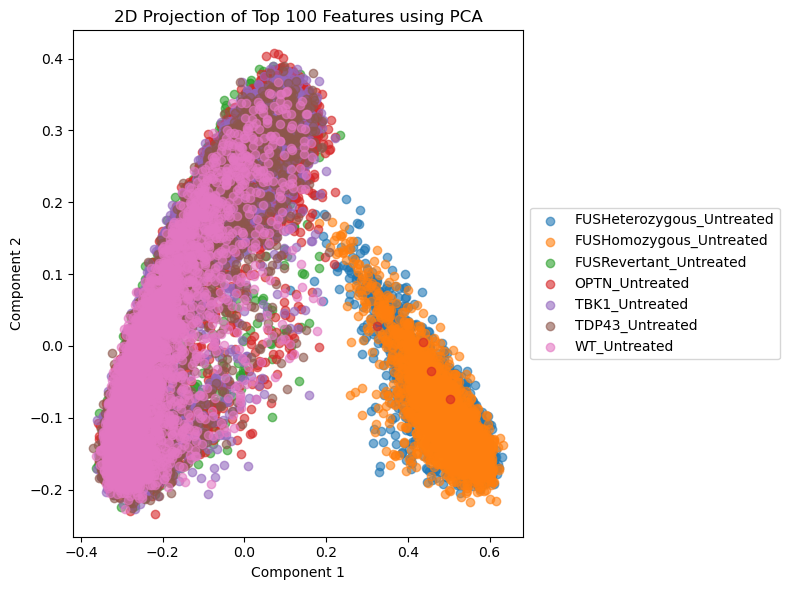

In [28]:
# 1. Select top 100 features from X_train
X_top = X_train[:, top_indices[:2000]]

# 2. Encode labels to color
labels_str = le.inverse_transform(y_train_enc)

# --- Option A: PCA ---
use_pca = True
if use_pca:
    reducer = PCA(n_components=2, random_state=42)
else:
    # --- Option B: UMAP ---
    reducer = umap.UMAP(n_components=2, random_state=42)

# 3. Reduce dimensions
X_embedded = reducer.fit_transform(X_top)

# 4. Plot
plt.figure(figsize=(8, 6))
for label in np.unique(labels_str):
    idx = labels_str == label
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], label=label, alpha=0.6)

plt.title("2D Projection of Top 100 Features using " + ("PCA" if use_pca else "UMAP"))
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


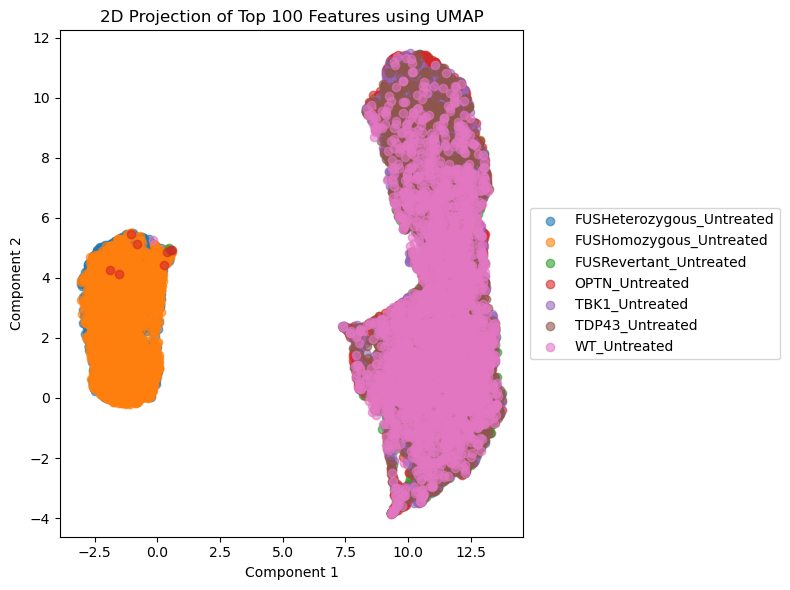

In [30]:
# 1. Select top 100 features from X_train
X_top = X_train[:, top_indices[:200]]

# 2. Encode labels to color
labels_str = le.inverse_transform(y_train_enc)

# --- Option A: PCA ---
use_pca = False
if use_pca:
    reducer = PCA(n_components=2, random_state=42)
else:
    # --- Option B: UMAP ---
    reducer = umap.UMAP(n_components=2, random_state=42)

# 3. Reduce dimensions
X_embedded = reducer.fit_transform(X_top)

# 4. Plot
plt.figure(figsize=(8, 6))
for label in np.unique(labels_str):
    idx = labels_str == label
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], label=label, alpha=0.6)

plt.title("2D Projection of Top 100 Features using " + ("PCA" if use_pca else "UMAP"))
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

In [31]:
# --- Load and convert labels ---
X_train, y_train_str = load_batches(batches)
y_train_str = np.array(y_train_str)

# Binary ALS label: 1 = ALS, 0 = Healthy (WT & Revertant)
healthy_labels = ['WT_Untreated', 'FUSRevertant_Untreated']
y_binary = (~np.isin(y_train_str, healthy_labels)).astype(int)

# Run Spearman correlation
top_indices, top_corrs = spearman_gpu(X_train, y_binary, top_n=100)

# Select features
X_train_selected = X_train[:, top_indices]

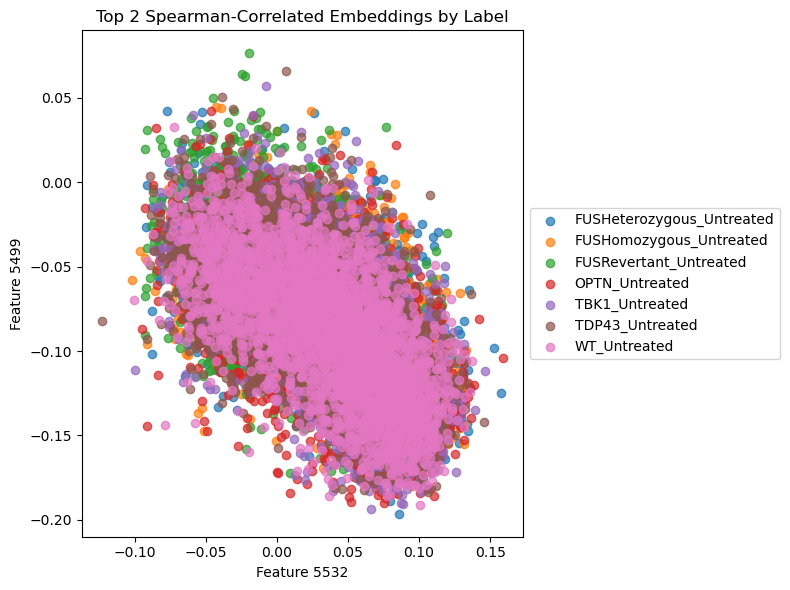

In [32]:
feat1, feat2 = top_indices[:2]
X_vis = X_train[:, [feat1, feat2]]

# Convert encoded labels back to original strings
labels_str = le.inverse_transform(y_train_enc)

# Create a scatter plot
plt.figure(figsize=(8, 6))
for label in np.unique(labels_str):
    idx = labels_str == label
    plt.scatter(X_vis[idx, 0], X_vis[idx, 1], label=label, alpha=0.7)

plt.xlabel(f'Feature {feat1}')
plt.ylabel(f'Feature {feat2}')
plt.title('Top 2 Spearman-Correlated Embeddings by Label')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

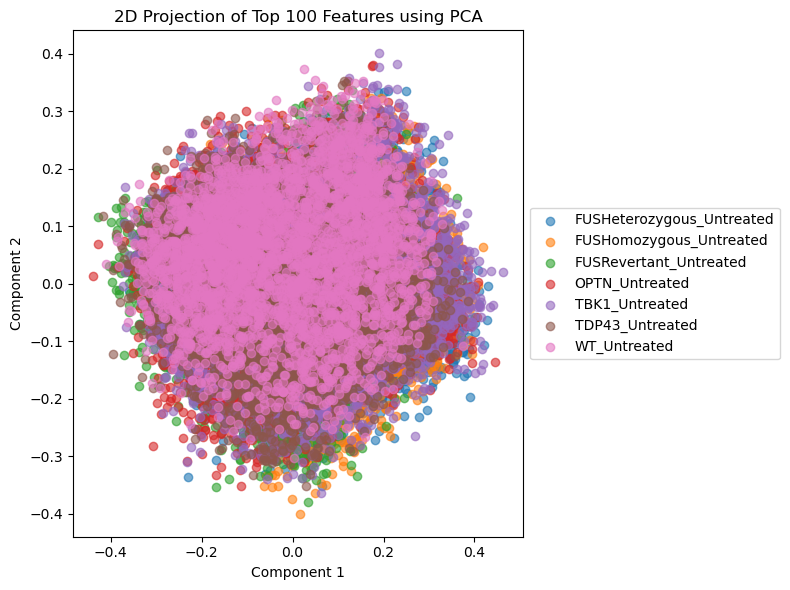

In [34]:
# 1. Select top 100 features from X_train
X_top = X_train[:, top_indices[:100]]

# 2. Encode labels to color
labels_str = le.inverse_transform(y_train_enc)

# --- Option A: PCA ---
use_pca = True
if use_pca:
    reducer = PCA(n_components=2, random_state=42)
else:
    # --- Option B: UMAP ---
    reducer = umap.UMAP(n_components=2, random_state=42)

# 3. Reduce dimensions
X_embedded = reducer.fit_transform(X_top)

# 4. Plot
plt.figure(figsize=(8, 6))
for label in np.unique(labels_str):
    idx = labels_str == label
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], label=label, alpha=0.6)

plt.title("2D Projection of Top 100 Features using " + ("PCA" if use_pca else "UMAP"))
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


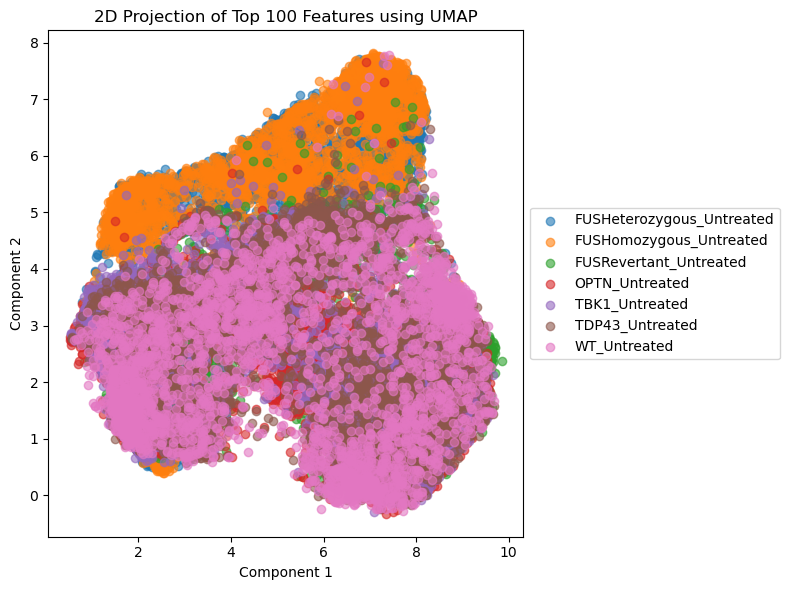

In [36]:
# 1. Select top 100 features from X_train
X_top = X_train[:, top_indices[:200]]

# 2. Encode labels to color
labels_str = le.inverse_transform(y_train_enc)

# --- Option A: PCA ---
use_pca = False
if use_pca:
    reducer = PCA(n_components=2, random_state=42)
else:
    # --- Option B: UMAP ---
    reducer = umap.UMAP(n_components=2, random_state=42)

# 3. Reduce dimensions
X_embedded = reducer.fit_transform(X_top)

# 4. Plot
plt.figure(figsize=(8, 6))
for label in np.unique(labels_str):
    idx = labels_str == label
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], label=label, alpha=0.6)

plt.title("2D Projection of Top 100 Features using " + ("PCA" if use_pca else "UMAP"))
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568)
1: 9892
0: 31577
Test dataset
batches [1]
(10932,) (10932, 5568)
1: 2467
0: 8465
fit
predict
              precision    recall  f1-score   support

       Other       1.00      1.00      1.00      8465
         FUS       1.00      0.99      1.00      2467

    accuracy                           1.00     10932
   macro avg       1.00      1.00      1.00     10932
weighted avg       1.00      1.00      1.00     10932

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568)
1: 9966
0: 34079
Test dataset
batches [2]
(8356,) (8356, 5568)
1: 2393
0: 5963
fit
predict
              precision    recall  f1-score   support

       Other       0.99      1.00      0.99      5963
         FUS       1.00      0.97      0.99      2393

    accuracy                           0.99      8356
   macro avg       0.99      0.99      0.99      8356
weighted avg       0.99      0.99      0.99      8356

Train dataset
batches [1, 2, 7, 

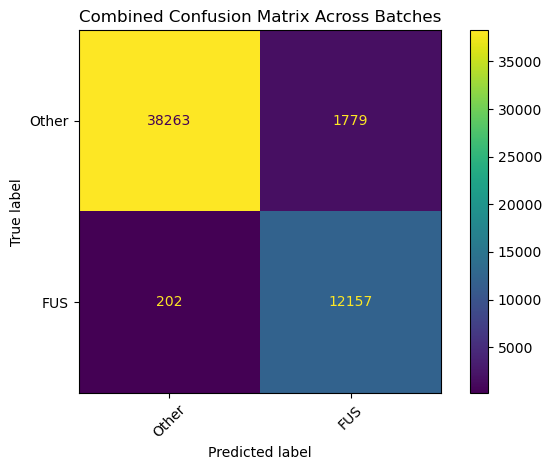

In [37]:
## It is possible to classify the fushomo fushetro out

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

positive_labels = ['FUSHomozygous_Untreated', 'FUSHeterozygous_Untreated']

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train_str = load_batches(train_batches)
    X_test, y_test_str = load_batches(test_batches)

    y_train_bin = np.isin(y_train_str, positive_labels).astype(int)
    y_test_bin = np.isin(y_test_str, positive_labels).astype(int)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train_bin), np.shape(X_train))
    count_labels(y_train_bin)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test_bin), np.shape(X_test))
    count_labels(y_test_bin)

    # Feature selection by F-score
    f_scores, _ = f_classif(X_train, y_train_bin)
    top_features = np.argsort(f_scores)[-100:]  # Top 100
    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_bin = ros.fit_resample(X_train, y_train_bin)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_bin = cudf.Series(y_train_bin)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_bin)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_bin, y_pred, target_names=["Other", "FUS"], output_dict=True)
    print(classification_report(y_test_bin, y_pred, target_names=["Other", "FUS"]))

    # Confusion matrix
    cm = confusion_matrix(y_test_bin, y_pred, labels=[0, 1])
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm

    accuracy = report['accuracy']
    accuracies.append(accuracy)

# Report results
print(np.mean(accuracies), accuracies)
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=["Other", "FUS"])
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568)
0: 33718
1: 7751
Test dataset
batches [1]
(10932,) (10932, 5568)
0: 9371
1: 1561
fit
predict
              precision    recall  f1-score   support

       Other       0.92      0.53      0.67      9371
          WT       0.20      0.71      0.32      1561

    accuracy                           0.56     10932
   macro avg       0.56      0.62      0.50     10932
weighted avg       0.82      0.56      0.62     10932

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568)
0: 35519
1: 8526
Test dataset
batches [2]
(8356,) (8356, 5568)
0: 7570
1: 786
fit
predict
              precision    recall  f1-score   support

       Other       0.94      0.90      0.92      7570
          WT       0.30      0.42      0.35       786

    accuracy                           0.85      8356
   macro avg       0.62      0.66      0.64      8356
weighted avg       0.88      0.85      0.86      8356

Train dataset
batches [1, 2, 7, 8

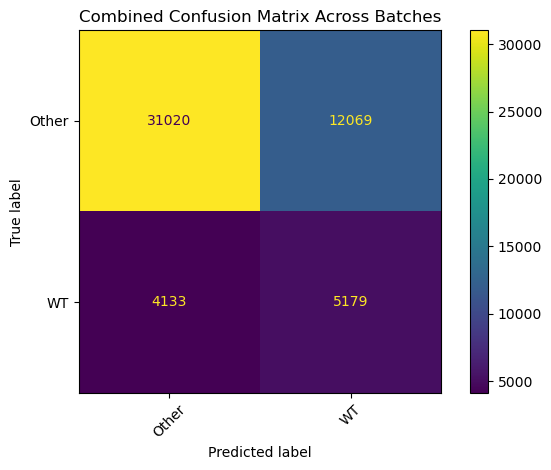

,Predicted Other,Predicted WT
True Label,,
FUSHeterozygous_Untreated,6276,4
FUSHomozygous_Untreated,6072,7
FUSRevertant_Untreated,4319,1177
OPTN_Untreated,5779,4070
TBK1_Untreated,4239,1842
TDP43_Untreated,4335,4969
WT_Untreated,4133,5179


In [41]:
from collections import defaultdict
import pandas as pd

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

positive_labels = ['WT_Untreated']
positive_name = 'WT'

# --- New: For confusion per original label ---
label_confusion = defaultdict(lambda: [0, 0])  # {label: [predicted_other_count, predicted_wt_count]}

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train_str = load_batches(train_batches)
    X_test, y_test_str = load_batches(test_batches)

    y_train_bin = np.isin(y_train_str, positive_labels).astype(int)
    y_test_bin = np.isin(y_test_str, positive_labels).astype(int)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train_bin), np.shape(X_train))
    count_labels(y_train_bin)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test_bin), np.shape(X_test))
    count_labels(y_test_bin)

    # Feature selection by F-score
    f_scores, _ = f_classif(X_train, y_train_bin)
    top_features = np.argsort(f_scores)[-100:]  # Top 100
    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_bin = ros.fit_resample(X_train, y_train_bin)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_bin = cudf.Series(y_train_bin)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_bin)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_bin, y_pred, target_names=["Other", positive_name], output_dict=True)
    print(classification_report(y_test_bin, y_pred, target_names=["Other", positive_name]))

    # Track per original label predictions
    for true_label, pred_binary in zip(y_test_str, y_pred):
        label_confusion[true_label][pred_binary] += 1

    # Accumulate binary confusion matrix
    cm = confusion_matrix(y_test_bin, y_pred, labels=[0, 1])
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm

    accuracy = report['accuracy']
    accuracies.append(accuracy)

# Report overall binary performance
print(np.mean(accuracies), accuracies)
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=["Other", positive_name])
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

# Build and display label-level confusion
label_confusion_df = pd.DataFrame.from_dict(
    label_confusion, orient='index', columns=['Predicted Other', f'Predicted {positive_name}']
)
label_confusion_df.index.name = 'True Label'
label_confusion_df = label_confusion_df.sort_index()
display(label_confusion_df)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(41469,) (41469, 5568)
0: 33718
1: 7751
Test dataset
batches [1]
(10932,) (10932, 5568)
0: 9371
1: 1561
fit
predict
              precision    recall  f1-score   support

       Other       0.92      0.54      0.68      9371
          WT       0.20      0.70      0.32      1561

    accuracy                           0.56     10932
   macro avg       0.56      0.62      0.50     10932
weighted avg       0.81      0.56      0.63     10932

Train dataset
batches [1, 3, 7, 8, 9, 10]
(44045,) (44045, 5568)
0: 35519
1: 8526
Test dataset
batches [2]
(8356,) (8356, 5568)
0: 7570
1: 786
fit
predict
              precision    recall  f1-score   support

       Other       0.94      0.89      0.92      7570
          WT       0.30      0.43      0.35       786

    accuracy                           0.85      8356
   macro avg       0.62      0.66      0.63      8356
weighted avg       0.88      0.85      0.86      8356

Train dataset
batches [1, 2, 7, 8

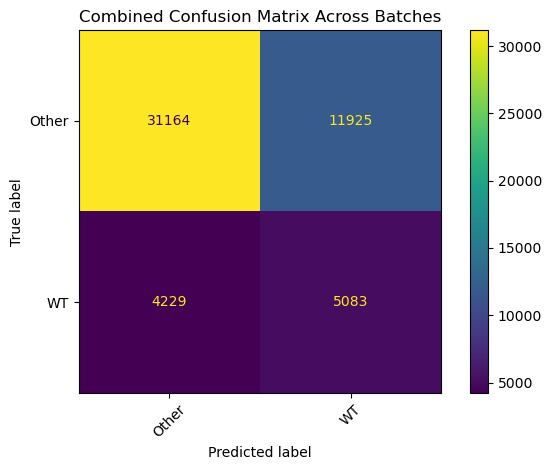

,Predicted Other,Predicted WT
True Label,,
FUSHeterozygous_Untreated,6271,9
FUSHomozygous_Untreated,6070,9
FUSRevertant_Untreated,4335,1161
OPTN_Untreated,5848,4001
TBK1_Untreated,4257,1824
TDP43_Untreated,4383,4921
WT_Untreated,4229,5083


In [42]:
from collections import defaultdict
import pandas as pd

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

positive_labels = ['WT_Untreated']
positive_name = 'WT'

# --- New: For confusion per original label ---
label_confusion = defaultdict(lambda: [0, 0])  # {label: [predicted_other_count, predicted_wt_count]}

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train_str = load_batches(train_batches)
    X_test, y_test_str = load_batches(test_batches)

    y_train_bin = np.isin(y_train_str, positive_labels).astype(int)
    y_test_bin = np.isin(y_test_str, positive_labels).astype(int)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train_bin), np.shape(X_train))
    count_labels(y_train_bin)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test_bin), np.shape(X_test))
    count_labels(y_test_bin)

    # Feature selection by F-score
    f_scores, _ = f_classif(X_train, y_train_bin)
    top_features = np.argsort(f_scores)[-100:]  # Top 100
    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_bin = ros.fit_resample(X_train, y_train_bin)

    # Optional: normalize
    norm = True
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_bin = cudf.Series(y_train_bin)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_bin)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_bin, y_pred, target_names=["Other", positive_name], output_dict=True)
    print(classification_report(y_test_bin, y_pred, target_names=["Other", positive_name]))

    # Track per original label predictions
    for true_label, pred_binary in zip(y_test_str, y_pred):
        label_confusion[true_label][pred_binary] += 1

    # Accumulate binary confusion matrix
    cm = confusion_matrix(y_test_bin, y_pred, labels=[0, 1])
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm

    accuracy = report['accuracy']
    accuracies.append(accuracy)

# Report overall binary performance
print(np.mean(accuracies), accuracies)
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=["Other", positive_name])
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

# Build and display label-level confusion
label_confusion_df = pd.DataFrame.from_dict(
    label_confusion, orient='index', columns=['Predicted Other', f'Predicted {positive_name}']
)
label_confusion_df.index.name = 'True Label'
label_confusion_df = label_confusion_df.sort_index()
display(label_confusion_df)

Train dataset
batches [2, 3, 7, 8, 9, 10]
(14373,) (14373, 5568)
1: 9892
0: 4481
Test dataset
batches [1]
(3482,) (3482, 5568)
1: 2467
0: 1015
fit
predict
              precision    recall  f1-score   support

      FUSHet       1.00      1.00      1.00      1015
     FUSHomo       1.00      1.00      1.00      2467

    accuracy                           1.00      3482
   macro avg       1.00      1.00      1.00      3482
weighted avg       1.00      1.00      1.00      3482

Train dataset
batches [1, 3, 7, 8, 9, 10]
(14662,) (14662, 5568)
1: 9966
0: 4696
Test dataset
batches [2]
(3193,) (3193, 5568)
1: 2393
0: 800
fit
predict
              precision    recall  f1-score   support

      FUSHet       0.99      1.00      1.00       800
     FUSHomo       1.00      1.00      1.00      2393

    accuracy                           1.00      3193
   macro avg       1.00      1.00      1.00      3193
weighted avg       1.00      1.00      1.00      3193

Train dataset
batches [1, 2, 7, 8, 9,

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

Train dataset
batches [1, 2, 3, 7, 9, 10]
(13563,) (13563, 5568)
1: 9230
0: 4333
Test dataset
batches [8]
(4292,) (4292, 5568)
1: 3129
0: 1163
fit
predict
              precision    recall  f1-score   support

      FUSHet       1.00      1.00      1.00      1163
     FUSHomo       1.00      1.00      1.00      3129

    accuracy                           1.00      4292
   macro avg       1.00      1.00      1.00      4292
weighted avg       1.00      1.00      1.00      4292

Train dataset
batches [1, 2, 3, 7, 8, 10]
(14975,) (14975, 5568)
1: 10777
0: 4198
Test dataset
batches [9]
(2880,) (2880, 5568)
1: 1582
0: 1298
fit
predict
              precision    recall  f1-score   support

      FUSHet       1.00      1.00      1.00      1298
     FUSHomo       1.00      1.00      1.00      1582

    accuracy                           1.00      2880
   macro avg       1.00      1.00      1.00      2880
weighted avg       1.00      1.00      1.00      2880

Train dataset
batches [1, 2, 3, 7, 

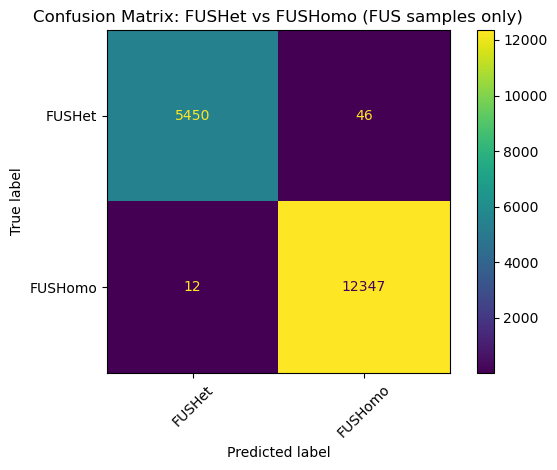

,Predicted FUSHet,Predicted FUSHomo
True Label,,
FUSHeterozygous_Untreated,9,6271
FUSHomozygous_Untreated,3,6076
FUSRevertant_Untreated,5450,46


In [43]:
from collections import defaultdict
import pandas as pd

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

positive_labels = ['FUSHomozygous_Untreated', 'FUSHeterozygous_Untreated']
positive_name = 'FUS'

# --- New: For confusion per original label ---
label_confusion = defaultdict(lambda: [0, 0])  # {label: [predicted_other, predicted_fus]}

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train_str = load_batches(train_batches)
    X_test, y_test_str = load_batches(test_batches)

    # Filter to only FUS samples
    fus_train_mask = [s.startswith("FUS") for s in y_train_str]
    fus_test_mask = [s.startswith("FUS") for s in y_test_str]
    X_train, y_train_str = X_train[fus_train_mask], np.array(y_train_str)[fus_train_mask]
    X_test, y_test_str = X_test[fus_test_mask], np.array(y_test_str)[fus_test_mask]

    # Skip if not enough samples in batch
    if len(y_train_str) == 0 or len(y_test_str) == 0:
        continue

    y_train_bin = np.isin(y_train_str, positive_labels).astype(int)
    y_test_bin = np.isin(y_test_str, positive_labels).astype(int)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train_bin), np.shape(X_train))
    count_labels(y_train_bin)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test_bin), np.shape(X_test))
    count_labels(y_test_bin)

    # Feature selection by F-score
    f_scores, _ = f_classif(X_train, y_train_bin)
    top_features = np.argsort(f_scores)[-100:]  # Top 100
    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_bin = ros.fit_resample(X_train, y_train_bin)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_bin = cudf.Series(y_train_bin)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_bin)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_bin, y_pred, target_names=["FUSHet", "FUSHomo"], output_dict=True)
    print(classification_report(y_test_bin, y_pred, target_names=["FUSHet", "FUSHomo"]))

    # Track per original label predictions
    for true_label, pred_binary in zip(y_test_str, y_pred):
        label_confusion[true_label][pred_binary] += 1

    # Accumulate binary confusion matrix
    cm = confusion_matrix(y_test_bin, y_pred, labels=[0, 1])
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm

    accuracy = report['accuracy']
    accuracies.append(accuracy)

# Report overall binary performance
print(np.mean(accuracies), accuracies)
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=["FUSHet", "FUSHomo"])
disp.plot(xticks_rotation=45)
plt.title("Confusion Matrix: FUSHet vs FUSHomo (FUS samples only)")
plt.tight_layout()
plt.show()

# Display label-level confusion
label_confusion_df = pd.DataFrame.from_dict(
    label_confusion, orient='index', columns=['Predicted FUSHet', 'Predicted FUSHomo']
)
label_confusion_df.index.name = 'True Label'
label_confusion_df = label_confusion_df.sort_index()
display(label_confusion_df)


Train dataset
batches [2, 3, 7, 8, 9, 10]
(27096,) (27096, 5568)
0: 19345
1: 7751
Test dataset
batches [1]
(7450,) (7450, 5568)
0: 5889
1: 1561
fit
predict
              precision    recall  f1-score   support

       Other       0.74      0.33      0.46      5889
          WT       0.18      0.56      0.28      1561

    accuracy                           0.38      7450
   macro avg       0.46      0.45      0.37      7450
weighted avg       0.62      0.38      0.42      7450

Train dataset
batches [1, 3, 7, 8, 9, 10]
(29383,) (29383, 5568)
0: 20857
1: 8526
Test dataset
batches [2]
(5163,) (5163, 5568)
0: 4377
1: 786
fit
predict
              precision    recall  f1-score   support

       Other       0.87      0.97      0.91      4377
          WT       0.46      0.16      0.24       786

    accuracy                           0.84      5163
   macro avg       0.66      0.56      0.58      5163
weighted avg       0.80      0.84      0.81      5163

Train dataset
batches [1, 2, 7, 8, 

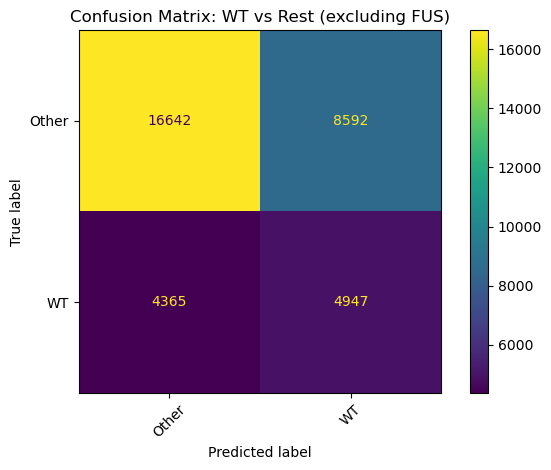

,Predicted Other,Predicted WT
True Label,,
OPTN_Untreated,7055,2794
TBK1_Untreated,4447,1634
TDP43_Untreated,5140,4164
WT_Untreated,4365,4947


In [44]:
from collections import defaultdict
import pandas as pd

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

positive_labels = ['WT_Untreated']
positive_name = 'WT'

# --- For confusion per original label ---
label_confusion = defaultdict(lambda: [0, 0])  # {label: [predicted_other, predicted_WT]}

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train_str = load_batches(train_batches)
    X_test, y_test_str = load_batches(test_batches)

    # Remove FUS lines
    keep_train_mask = [not s.startswith("FUS") for s in y_train_str]
    keep_test_mask = [not s.startswith("FUS") for s in y_test_str]
    X_train, y_train_str = X_train[keep_train_mask], np.array(y_train_str)[keep_train_mask]
    X_test, y_test_str = X_test[keep_test_mask], np.array(y_test_str)[keep_test_mask]

    # Skip batch if no data left
    if len(y_train_str) == 0 or len(y_test_str) == 0:
        continue

    # Binary labels
    y_train_bin = np.isin(y_train_str, positive_labels).astype(int)
    y_test_bin = np.isin(y_test_str, positive_labels).astype(int)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train_bin), np.shape(X_train))
    count_labels(y_train_bin)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test_bin), np.shape(X_test))
    count_labels(y_test_bin)

    # Feature selection
    f_scores, _ = f_classif(X_train, y_train_bin)
    top_features = np.argsort(f_scores)[-100:]
    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Balance
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_bin = ros.fit_resample(X_train, y_train_bin)

    # Normalize (optional)
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # To GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_bin = cudf.Series(y_train_bin)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_bin)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_bin, y_pred, target_names=["Other", positive_name], output_dict=True)
    print(classification_report(y_test_bin, y_pred, target_names=["Other", positive_name]))

    # Track confusion by true label
    for true_label, pred_binary in zip(y_test_str, y_pred):
        label_confusion[true_label][pred_binary] += 1

    # Binary confusion matrix
    cm = confusion_matrix(y_test_bin, y_pred, labels=[0, 1])
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm

    accuracies.append(report['accuracy'])

# Show binary classification summary
print(np.mean(accuracies), accuracies)
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=["Other", positive_name])
disp.plot(xticks_rotation=45)
plt.title("Confusion Matrix: WT vs Rest (excluding FUS)")
plt.tight_layout()
plt.show()

# Per-label confusion summary
label_confusion_df = pd.DataFrame.from_dict(
    label_confusion, orient='index', columns=['Predicted Other', f'Predicted {positive_name}']
)
label_confusion_df.index.name = 'True Label'
label_confusion_df = label_confusion_df.sort_index()
display(label_confusion_df)


Train dataset
batches [2, 3, 7, 8, 9, 10]
(27096,) (27096, 5568)
0: 19345
1: 7751
Test dataset
batches [1]
(7450,) (7450, 5568)
0: 5889
1: 1561
fit
predict
              precision    recall  f1-score   support

       Other       0.75      0.36      0.49      5889
          WT       0.19      0.55      0.28      1561

    accuracy                           0.40      7450
   macro avg       0.47      0.46      0.38      7450
weighted avg       0.63      0.40      0.45      7450

Train dataset
batches [1, 3, 7, 8, 9, 10]
(29383,) (29383, 5568)
0: 20857
1: 8526
Test dataset
batches [2]
(5163,) (5163, 5568)
0: 4377
1: 786
fit
predict
              precision    recall  f1-score   support

       Other       0.87      0.94      0.91      4377
          WT       0.40      0.21      0.28       786

    accuracy                           0.83      5163
   macro avg       0.64      0.58      0.59      5163
weighted avg       0.80      0.83      0.81      5163

Train dataset
batches [1, 2, 7, 8, 

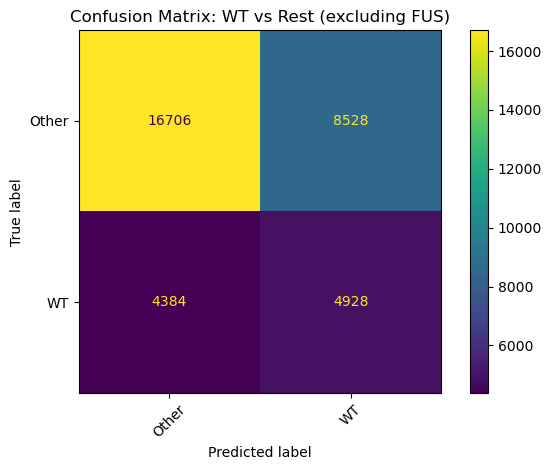

,Predicted Other,Predicted WT
True Label,,
OPTN_Untreated,7013,2836
TBK1_Untreated,4519,1562
TDP43_Untreated,5174,4130
WT_Untreated,4384,4928


In [46]:
from collections import defaultdict
import pandas as pd

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

positive_labels = ['WT_Untreated']
positive_name = 'WT'

# --- For confusion per original label ---
label_confusion = defaultdict(lambda: [0, 0])  # {label: [predicted_other, predicted_WT]}

for test_batch in batches:
    test_batches = [test_batch]
    train_batches = list(set(batches) - set(test_batches))

    X_train, y_train_str = load_batches(train_batches)
    X_test, y_test_str = load_batches(test_batches)

    # Remove FUS lines
    keep_train_mask = [not s.startswith("FUS") for s in y_train_str]
    keep_test_mask = [not s.startswith("FUS") for s in y_test_str]
    X_train, y_train_str = X_train[keep_train_mask], np.array(y_train_str)[keep_train_mask]
    X_test, y_test_str = X_test[keep_test_mask], np.array(y_test_str)[keep_test_mask]

    # Skip batch if no data left
    if len(y_train_str) == 0 or len(y_test_str) == 0:
        continue

    # Binary labels
    y_train_bin = np.isin(y_train_str, positive_labels).astype(int)
    y_test_bin = np.isin(y_test_str, positive_labels).astype(int)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train_bin), np.shape(X_train))
    count_labels(y_train_bin)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test_bin), np.shape(X_test))
    count_labels(y_test_bin)

    # Feature selection
    f_scores, _ = f_classif(X_train, y_train_bin)
    top_features = np.argsort(f_scores)[-100:]
    X_train = X_train[:, top_features]
    X_test = X_test[:, top_features]

    # Balance
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_bin = ros.fit_resample(X_train, y_train_bin)

    # Normalize (optional)
    norm = True
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # To GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_bin = cudf.Series(y_train_bin)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_bin)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_bin, y_pred, target_names=["Other", positive_name], output_dict=True)
    print(classification_report(y_test_bin, y_pred, target_names=["Other", positive_name]))

    # Track confusion by true label
    for true_label, pred_binary in zip(y_test_str, y_pred):
        label_confusion[true_label][pred_binary] += 1

    # Binary confusion matrix
    cm = confusion_matrix(y_test_bin, y_pred, labels=[0, 1])
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm

    accuracies.append(report['accuracy'])

# Show binary classification summary
print(np.mean(accuracies), accuracies)
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=["Other", positive_name])
disp.plot(xticks_rotation=45)
plt.title("Confusion Matrix: WT vs Rest (excluding FUS)")
plt.tight_layout()
plt.show()

# Per-label confusion summary
label_confusion_df = pd.DataFrame.from_dict(
    label_confusion, orient='index', columns=['Predicted Other', f'Predicted {positive_name}']
)
label_confusion_df.index.name = 'True Label'
label_confusion_df = label_confusion_df.sort_index()
display(label_confusion_df)


In [ ]:
## The standard pipeline!

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
    # Accumulate confusion matrix
    cm = confusion_matrix(y_test_enc, y_pred, labels=np.arange(len(le.classes_)))
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm
print(np.mean(accuracies), accuracies)
display_labels = [label.replace('_Untreated', '') for label in le.classes_]
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=display_labels)
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

Train dataset
batches [2, 3, 7, 8, 9, 10]
(33864,) (33864, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
WT_Untreated: 7751
Test dataset
batches [1]
(9233,) (9233, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.66      0.92      0.77      1222
  FUSHomozygous_Untreated       0.87      0.53      0.66      1245
   FUSRevertant_Untreated       0.80      0.93      0.86      1015
           OPTN_Untreated       0.76      

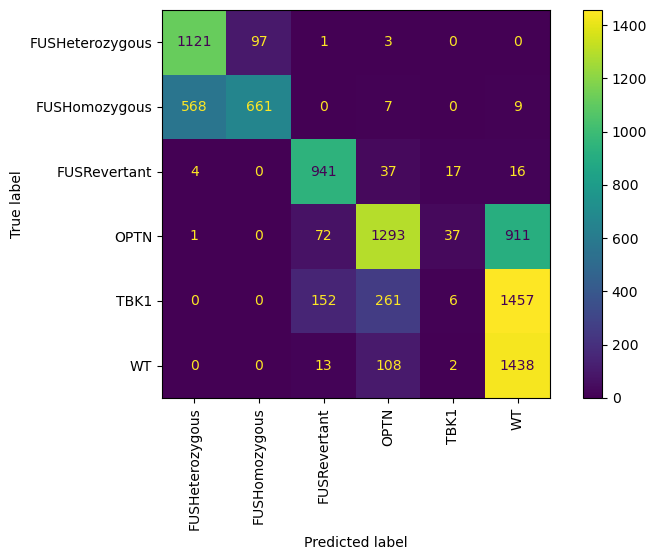

Train dataset
batches [1, 3, 7, 8, 9, 10]
(36249,) (36249, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
WT_Untreated: 8526
Test dataset
batches [2]
(6848,) (6848, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.63      0.63      0.63      1231
  FUSHomozygous_Untreated       0.61      0.58      0.60      1162
   FUSRevertant_Untreated       0.58      0.99      0.73       800
           OPTN_Untreated       0.74      0.

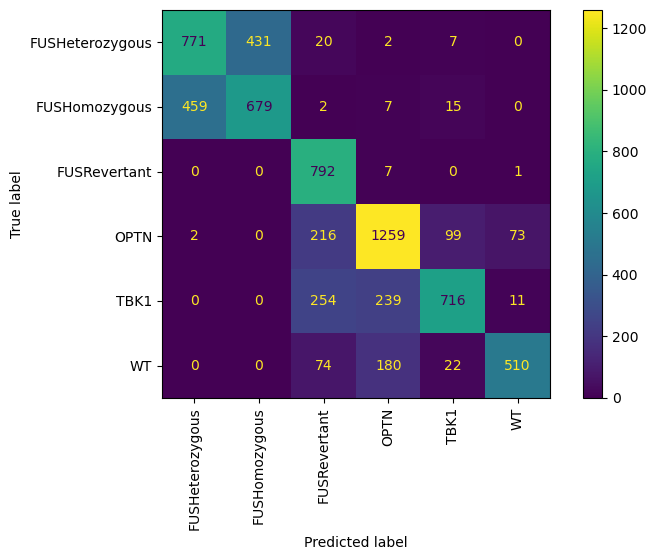

Train dataset
batches [1, 2, 7, 8, 9, 10]
(37096,) (37096, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
WT_Untreated: 8394
Test dataset
batches [3]
(6001,) (6001, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.74      0.97      0.84      1004
  FUSHomozygous_Untreated       0.94      0.57      0.71       800
   FUSRevertant_Untreated       0.70      0.72      0.71      1131
           OPTN_Untreated       0.53      0.

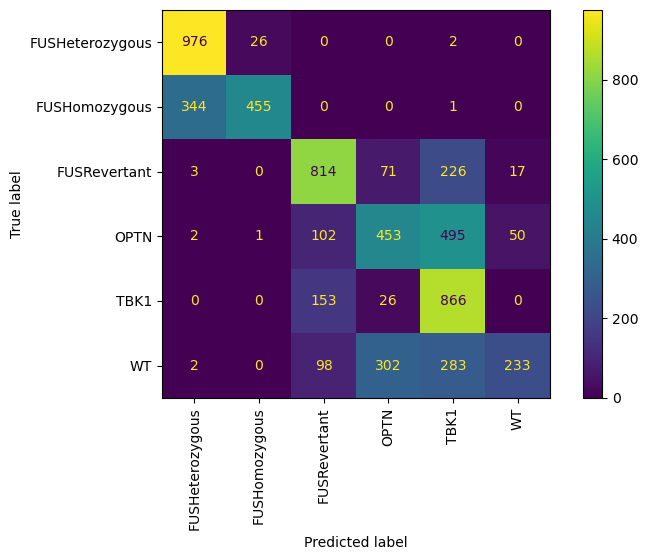

Train dataset
batches [1, 2, 3, 8, 9, 10]
(42947,) (42947, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
WT_Untreated: 9275
Test dataset
batches [7]
(150,) (150, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
WT_Untreated: 37
fit
predict


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.00      0.00        44
           OPTN_Untreated       0.07      1.00      0.12         5
           TBK1_Untreated       0.40      0.15      0.22        13
             WT_Untreated       0.48      0.89      0.62        37

                 accuracy                           0.27       150
                macro avg       0.16      0.34      0.16       150
             weighted avg       0.15      0.27      0.18       150



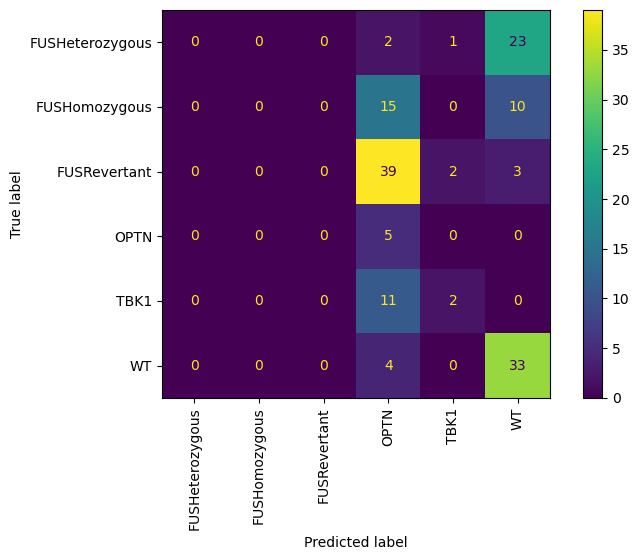

Train dataset
batches [1, 2, 3, 7, 9, 10]
(35111,) (35111, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
WT_Untreated: 7802
Test dataset
batches [8]
(7986,) (7986, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.81      0.20      0.32      1567
  FUSHomozygous_Untreated       0.54      0.95      0.69      1562
   FUSRevertant_Untreated       0.67      0.62      0.65      1163
           OPTN_Untreated       0.57      0

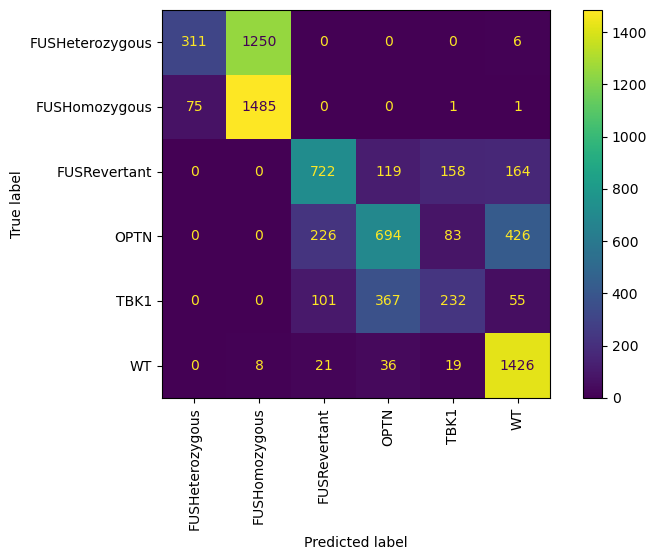

Train dataset
batches [1, 2, 3, 7, 8, 10]
(35343,) (35343, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
WT_Untreated: 7008
Test dataset
batches [9]
(7754,) (7754, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.21      0.27      0.24       963
  FUSHomozygous_Untreated       0.29      0.54      0.38       619
   FUSRevertant_Untreated       0.91      0.13      0.23      1298
           OPTN_Untreated       0.26      0.5

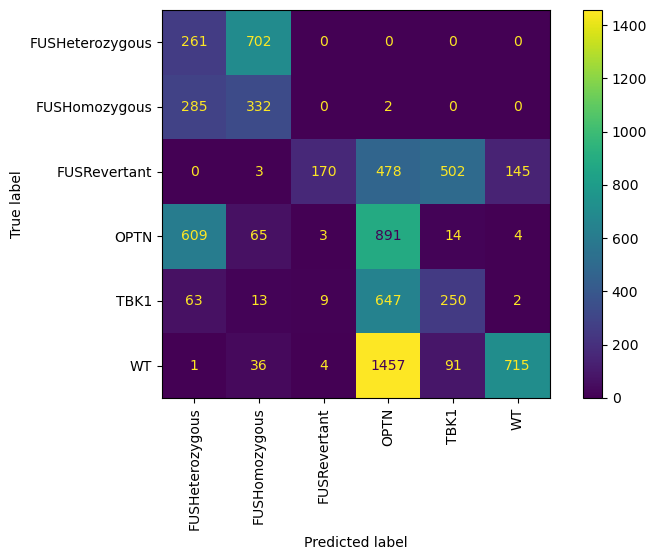

Train dataset
batches [1, 2, 3, 7, 8, 9]
(37972,) (37972, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
WT_Untreated: 7116
Test dataset
batches [10]
(5125,) (5125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.58      0.21      0.31       267
  FUSHomozygous_Untreated       0.75      0.94      0.84       666
   FUSRevertant_Untreated       0.06      0.87      0.12        45
           OPTN_Untreated       0.99      0.06 

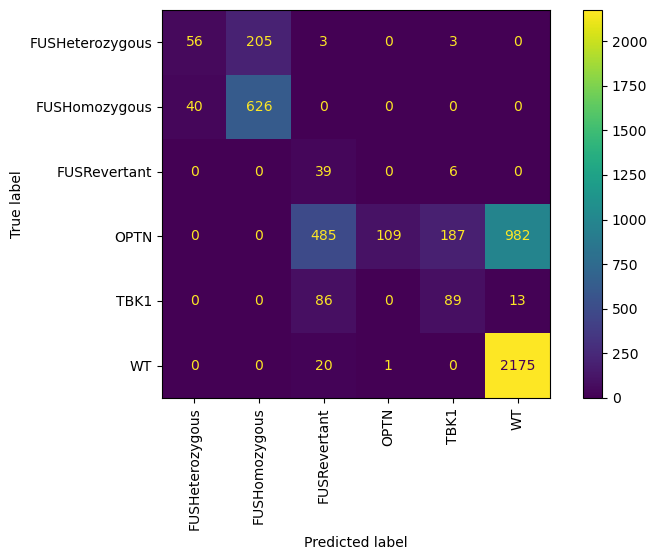

0.5331874027769012 [0.5913570887035633, 0.6902745327102804, 0.6327278786868855, 0.26666666666666666, 0.609817180065114, 0.3377611555326283, 0.6037073170731707]


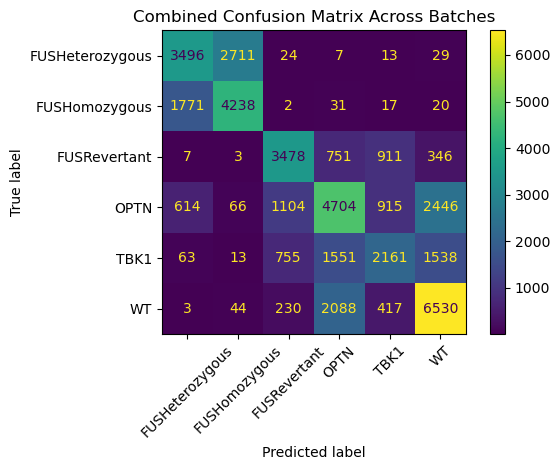

In [52]:
## without tdp43

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    # Filter out TDP43 from training and testing
    train_mask = [not str(lbl).startswith('TDP43') for lbl in y_train]
    test_mask = [not str(lbl).startswith('TDP43') for lbl in y_test]

    X_train = X_train[train_mask]
    y_train = np.array(y_train)[train_mask]
    X_test = X_test[test_mask]
    y_test = np.array(y_test)[test_mask]


    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = False
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
    # Accumulate confusion matrix
    cm = confusion_matrix(y_test_enc, y_pred, labels=np.arange(len(le.classes_)))
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm
print(np.mean(accuracies), accuracies)
display_labels = [label.replace('_Untreated', '') for label in le.classes_]
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=display_labels)
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

Train dataset
batches [2, 3, 7, 8, 9, 10]
(33864,) (33864, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5058
FUSHomozygous_Untreated: 4834
FUSRevertant_Untreated: 4481
OPTN_Untreated: 7535
TBK1_Untreated: 4205
WT_Untreated: 7751
Test dataset
batches [1]
(9233,) (9233, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1222
FUSHomozygous_Untreated: 1245
FUSRevertant_Untreated: 1015
OPTN_Untreated: 2314
TBK1_Untreated: 1876
WT_Untreated: 1561
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.65      0.92      0.76      1222
  FUSHomozygous_Untreated       0.87      0.52      0.65      1245
   FUSRevertant_Untreated       0.75      0.94      0.84      1015
           OPTN_Untreated       0.76      

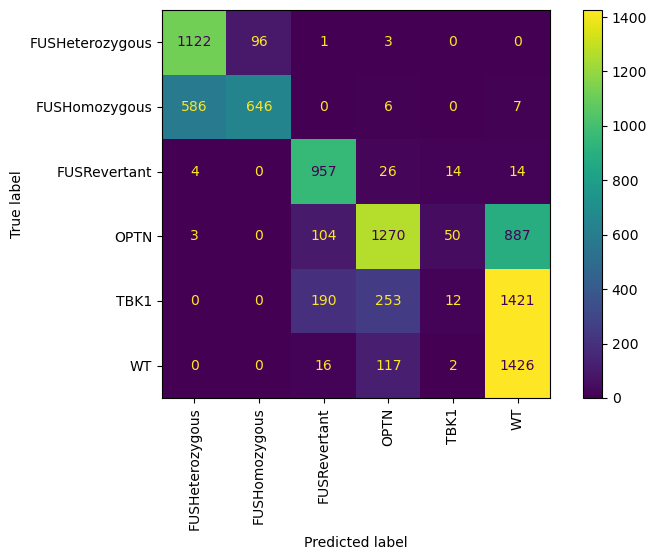

Train dataset
batches [1, 3, 7, 8, 9, 10]
(36249,) (36249, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5049
FUSHomozygous_Untreated: 4917
FUSRevertant_Untreated: 4696
OPTN_Untreated: 8200
TBK1_Untreated: 4861
WT_Untreated: 8526
Test dataset
batches [2]
(6848,) (6848, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1231
FUSHomozygous_Untreated: 1162
FUSRevertant_Untreated: 800
OPTN_Untreated: 1649
TBK1_Untreated: 1220
WT_Untreated: 786
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.63      0.64      0.63      1231
  FUSHomozygous_Untreated       0.62      0.57      0.59      1162
   FUSRevertant_Untreated       0.56      0.99      0.72       800
           OPTN_Untreated       0.76      0.

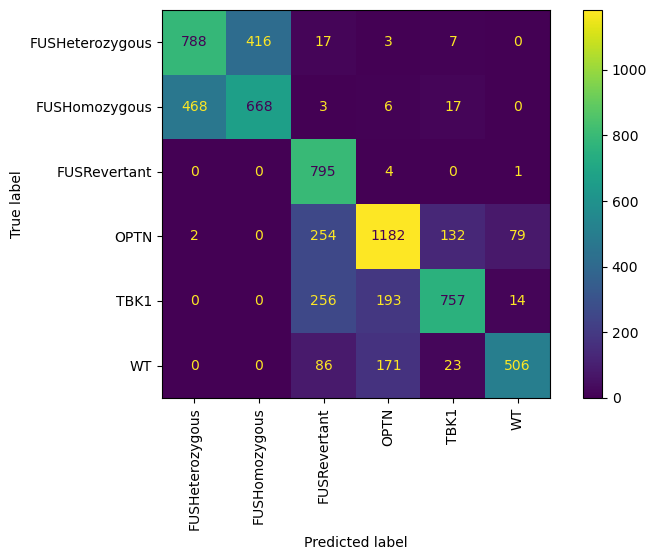

Train dataset
batches [1, 2, 7, 8, 9, 10]
(37096,) (37096, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5276
FUSHomozygous_Untreated: 5279
FUSRevertant_Untreated: 4365
OPTN_Untreated: 8746
TBK1_Untreated: 5036
WT_Untreated: 8394
Test dataset
batches [3]
(6001,) (6001, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1004
FUSHomozygous_Untreated: 800
FUSRevertant_Untreated: 1131
OPTN_Untreated: 1103
TBK1_Untreated: 1045
WT_Untreated: 918
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.73      0.96      0.83      1004
  FUSHomozygous_Untreated       0.93      0.57      0.71       800
   FUSRevertant_Untreated       0.69      0.74      0.71      1131
           OPTN_Untreated       0.53      0.

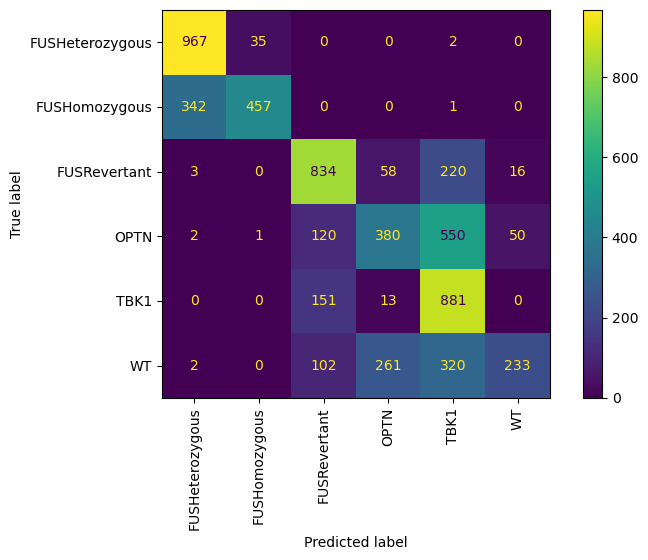

Train dataset
batches [1, 2, 3, 8, 9, 10]
(42947,) (42947, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6254
FUSHomozygous_Untreated: 6054
FUSRevertant_Untreated: 5452
OPTN_Untreated: 9844
TBK1_Untreated: 6068
WT_Untreated: 9275
Test dataset
batches [7]
(150,) (150, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 26
FUSHomozygous_Untreated: 25
FUSRevertant_Untreated: 44
OPTN_Untreated: 5
TBK1_Untreated: 13
WT_Untreated: 37
fit
predict


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavi

                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       1.00      0.04      0.07        26
  FUSHomozygous_Untreated       0.00      0.00      0.00        25
   FUSRevertant_Untreated       0.00      0.00      0.00        44
           OPTN_Untreated       0.07      1.00      0.12         5
           TBK1_Untreated       0.33      0.15      0.21        13
             WT_Untreated       0.49      0.89      0.63        37

                 accuracy                           0.27       150
                macro avg       0.32      0.35      0.17       150
             weighted avg       0.33      0.27      0.19       150



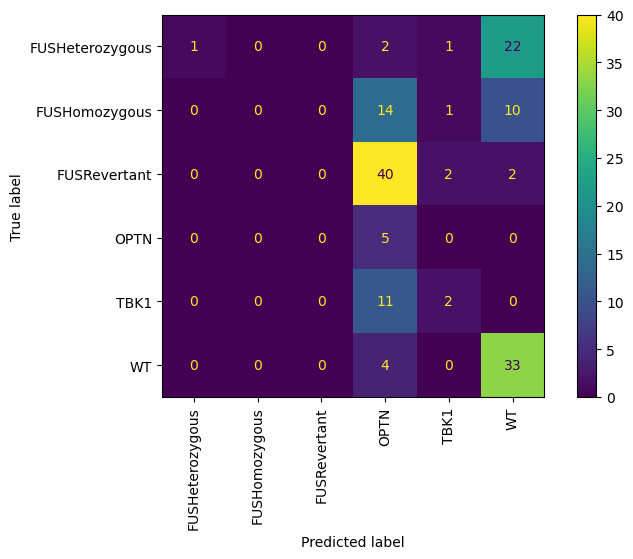

Train dataset
batches [1, 2, 3, 7, 9, 10]
(35111,) (35111, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 4713
FUSHomozygous_Untreated: 4517
FUSRevertant_Untreated: 4333
OPTN_Untreated: 8420
TBK1_Untreated: 5326
WT_Untreated: 7802
Test dataset
batches [8]
(7986,) (7986, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 1567
FUSHomozygous_Untreated: 1562
FUSRevertant_Untreated: 1163
OPTN_Untreated: 1429
TBK1_Untreated: 755
WT_Untreated: 1510
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.81      0.22      0.35      1567
  FUSHomozygous_Untreated       0.55      0.95      0.69      1562
   FUSRevertant_Untreated       0.63      0.68      0.66      1163
           OPTN_Untreated       0.58      0

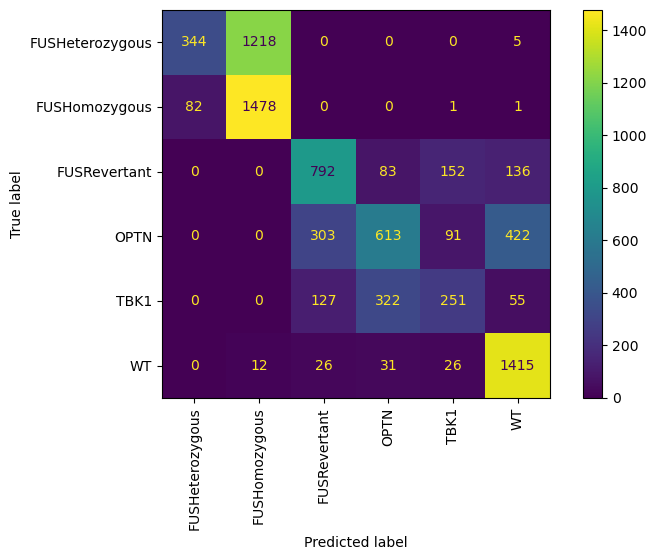

Train dataset
batches [1, 2, 3, 7, 8, 10]
(35343,) (35343, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 5317
FUSHomozygous_Untreated: 5460
FUSRevertant_Untreated: 4198
OPTN_Untreated: 8263
TBK1_Untreated: 5097
WT_Untreated: 7008
Test dataset
batches [9]
(7754,) (7754, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 963
FUSHomozygous_Untreated: 619
FUSRevertant_Untreated: 1298
OPTN_Untreated: 1586
TBK1_Untreated: 984
WT_Untreated: 2304
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.23      0.31      0.27       963
  FUSHomozygous_Untreated       0.28      0.52      0.37       619
   FUSRevertant_Untreated       0.90      0.16      0.27      1298
           OPTN_Untreated       0.26      0.5

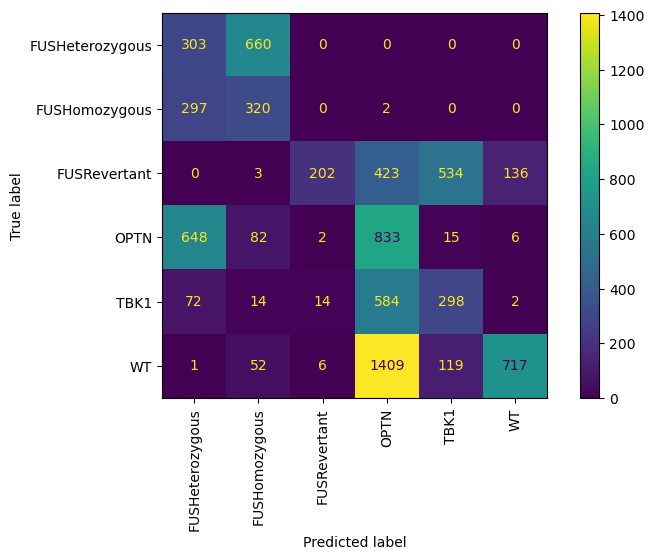

Train dataset
batches [1, 2, 3, 7, 8, 9]
(37972,) (37972, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 6013
FUSHomozygous_Untreated: 5413
FUSRevertant_Untreated: 5451
OPTN_Untreated: 8086
TBK1_Untreated: 5893
WT_Untreated: 7116
Test dataset
batches [10]
(5125,) (5125, 5568) ['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated' 'WT_Untreated']
FUSHeterozygous_Untreated: 267
FUSHomozygous_Untreated: 666
FUSRevertant_Untreated: 45
OPTN_Untreated: 1763
TBK1_Untreated: 188
WT_Untreated: 2196
fit
predict
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.59      0.19      0.29       267
  FUSHomozygous_Untreated       0.75      0.95      0.84       666
   FUSRevertant_Untreated       0.06      0.89      0.11        45
           OPTN_Untreated       0.98      0.05 

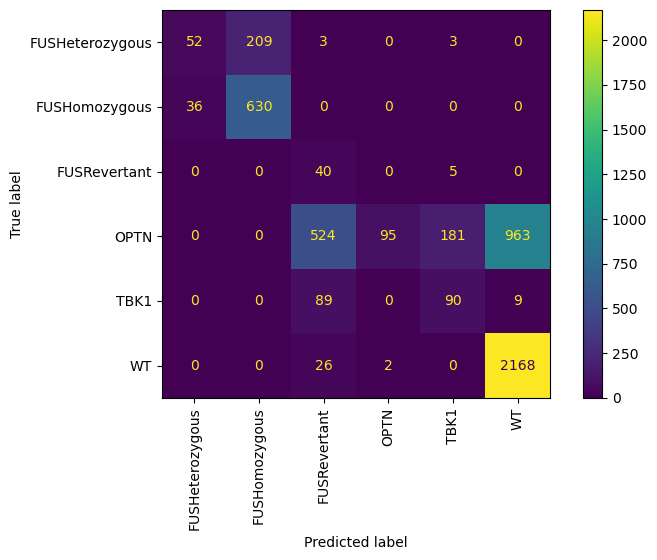

0.5328807777108169 [0.5884327954077765, 0.6857476635514018, 0.6252291284785869, 0.2733333333333333, 0.6126972201352366, 0.34472530306938354, 0.6]


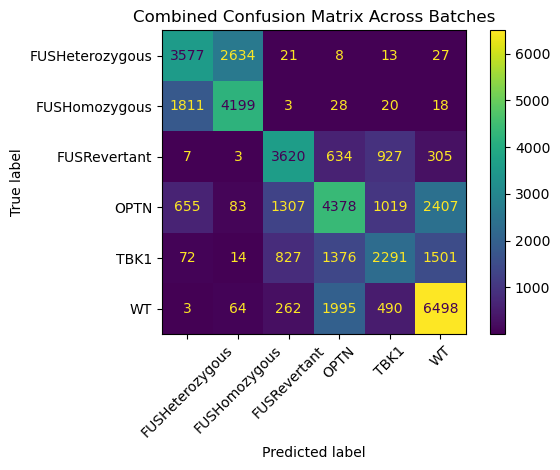

In [53]:
## without tdp43 balanced

batches = [1,2,3,7,8,9,10]
accuracies = []
accumulated_cm = None

for test_batches in batches:
    test_batches = [test_batches]
    train_batches = list(set(batches)-set(test_batches))

    X_train, y_train = load_batches(train_batches)
    X_test, y_test = load_batches(test_batches)

    # Filter out TDP43 from training and testing
    train_mask = [not str(lbl).startswith('TDP43') for lbl in y_train]
    test_mask = [not str(lbl).startswith('TDP43') for lbl in y_test]

    X_train = X_train[train_mask]
    y_train = np.array(y_train)[train_mask]
    X_test = X_test[test_mask]
    y_test = np.array(y_test)[test_mask]


    print('Train dataset')
    print('batches', train_batches)
    print(np.shape(y_train), np.shape(X_train), np.unique(y_train))
    count_labels(y_train)
    print('Test dataset')
    print('batches', test_batches)
    print(np.shape(y_test), np.shape(X_test), np.unique(y_test))
    count_labels(y_test)

    # Encode with same label encoder
    le = LabelEncoder()
    y_train_enc = le.fit_transform(y_train)
    y_test_enc = le.transform(y_test)

    # Optional: balance training set
    balance = True
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_train, y_train_enc = ros.fit_resample(X_train, y_train_enc)

    # Optional: normalize
    norm = False
    if norm:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Convert to GPU
    X_train = cudf.DataFrame.from_records(X_train)
    X_test = cudf.DataFrame.from_records(X_test)
    y_train_enc = cudf.Series(y_train_enc)

    # Train
    print('fit')
    clf = cuMLLogisticRegression(verbose=1)
    clf.fit(X_train, y_train_enc)

    # Predict
    print('predict')
    y_pred = clf.predict(X_test).to_numpy()
    report = classification_report(y_test_enc, y_pred, target_names=le.classes_, output_dict=True)
    print(classification_report(y_test_enc, y_pred, target_names=le.classes_))    
    plot_confusion_matrix(y_test_enc, y_pred, le)
    accuracy = report['accuracy']
    accuracies.append(accuracy)
    # Accumulate confusion matrix
    cm = confusion_matrix(y_test_enc, y_pred, labels=np.arange(len(le.classes_)))
    if accumulated_cm is None:
        accumulated_cm = cm
    else:
        accumulated_cm += cm
print(np.mean(accuracies), accuracies)
display_labels = [label.replace('_Untreated', '') for label in le.classes_]
disp = ConfusionMatrixDisplay(confusion_matrix=accumulated_cm, display_labels=display_labels)
disp.plot(xticks_rotation=45)
plt.title("Combined Confusion Matrix Across Batches")
plt.tight_layout()
plt.show()

## Kmeans

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


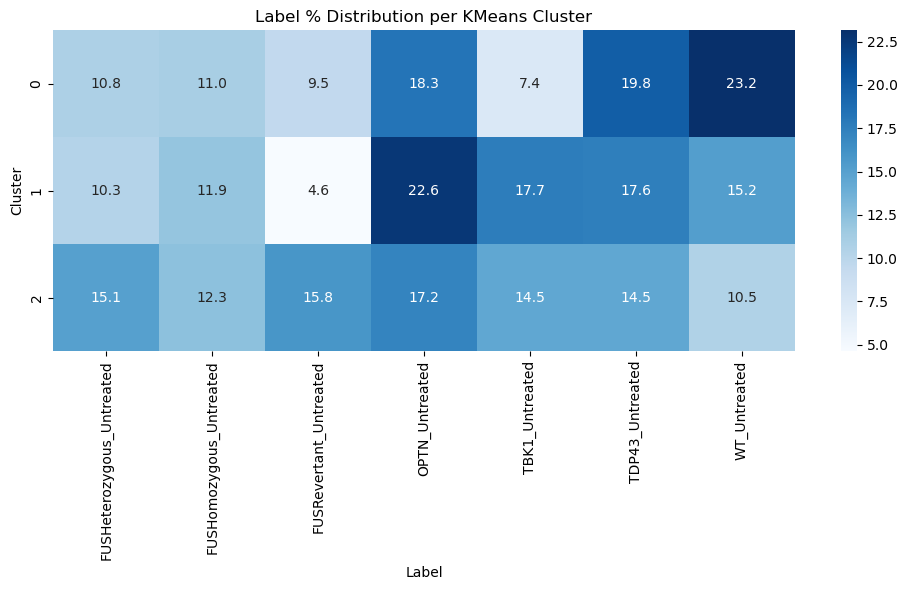

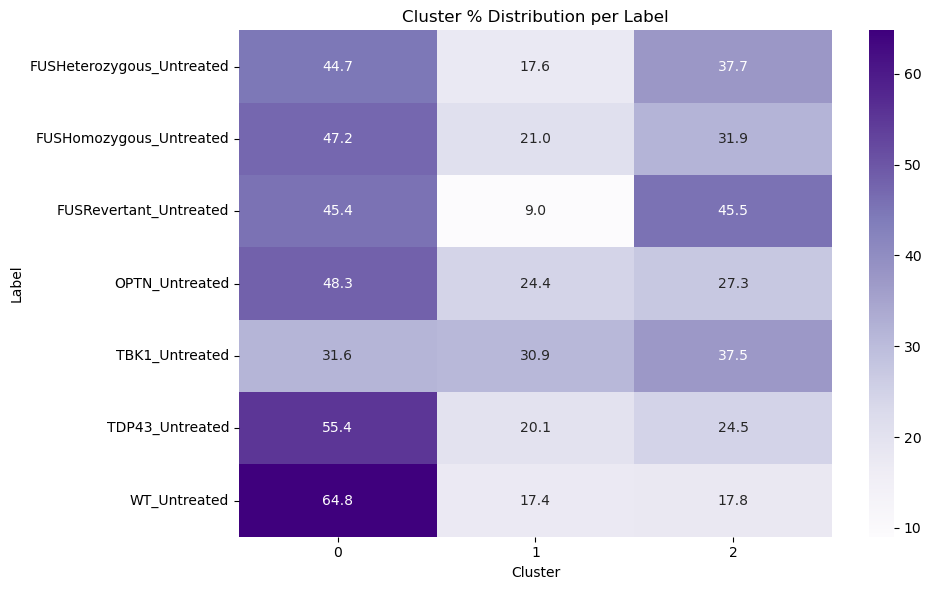

In [63]:
df = KMeans_cluster(
    batches=[1,2,3,8,9,10],
    n_clusters=3,
    normalize=False,
    balance=False,
    apply_pca=True,
    pca_components=50
)

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


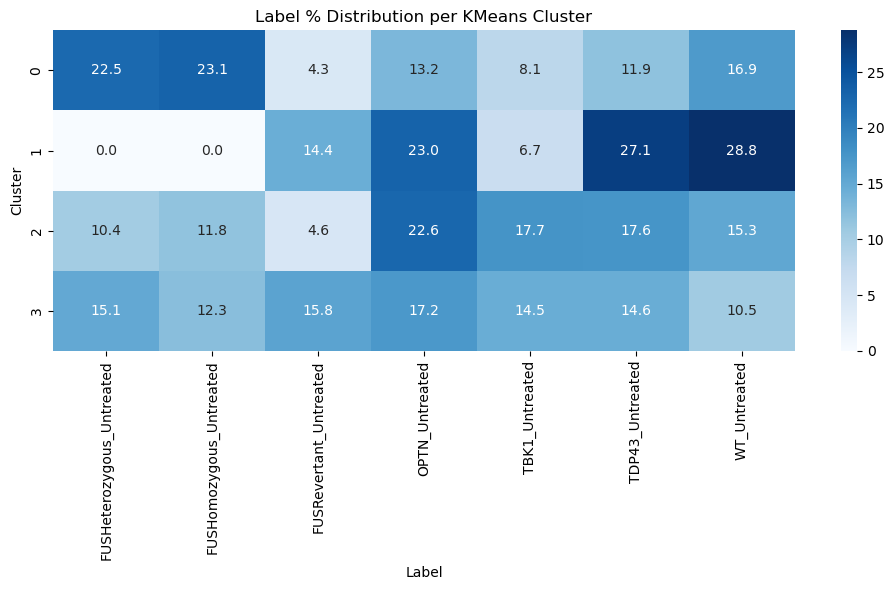

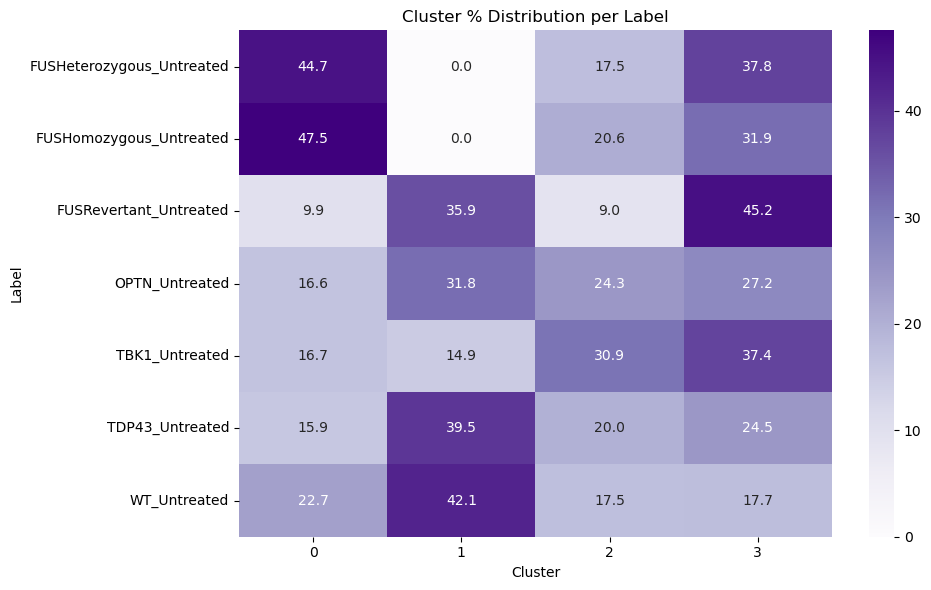

In [64]:
df = KMeans_cluster(
    batches=[1,2,3,8,9,10],
    n_clusters=4,
    normalize=False,
    balance=False,
    apply_pca=True,
    pca_components=50
)

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


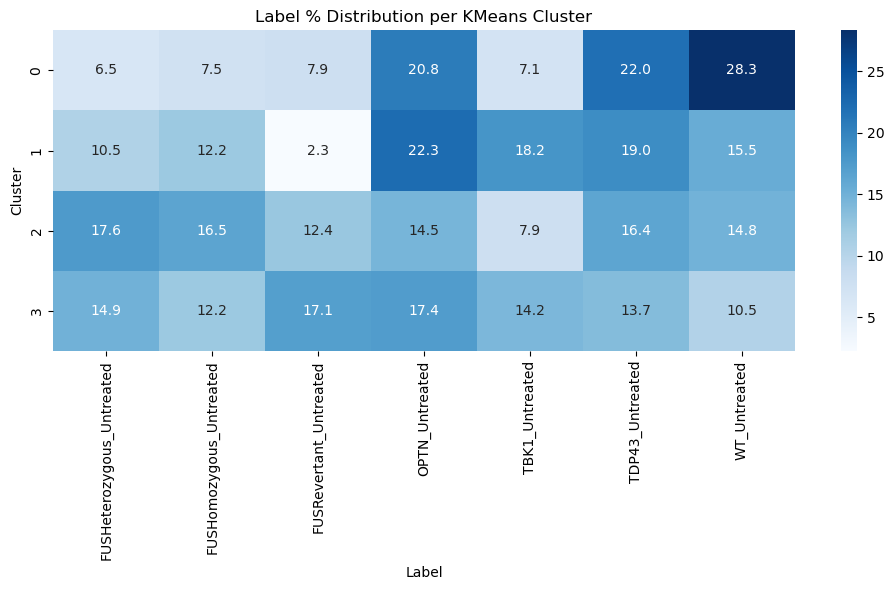

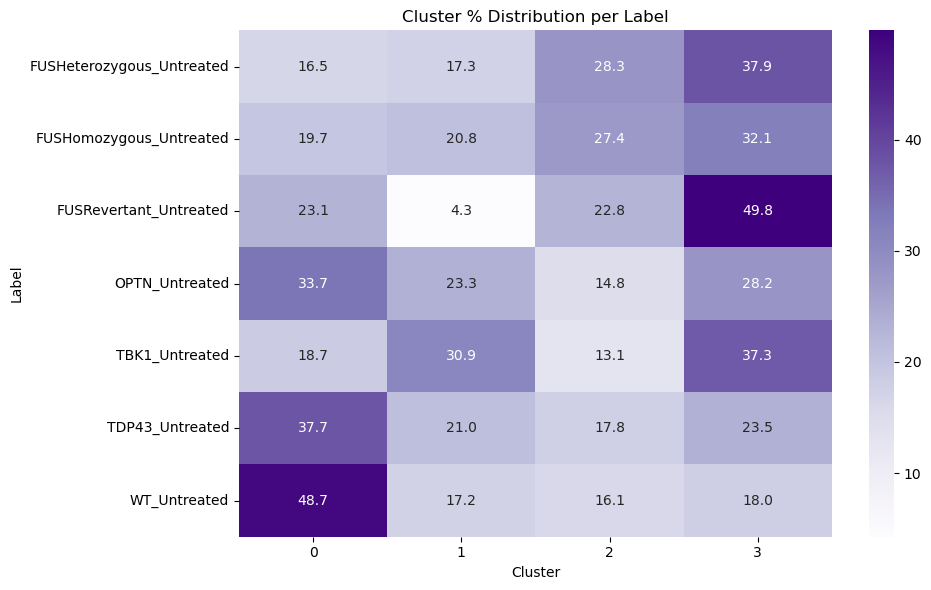

In [65]:
df = KMeans_cluster(
    batches=[1,2,3,8,9,10],
    n_clusters=4,
    normalize=True,
    balance=False,
    apply_pca=True,
    pca_components=50
)

/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


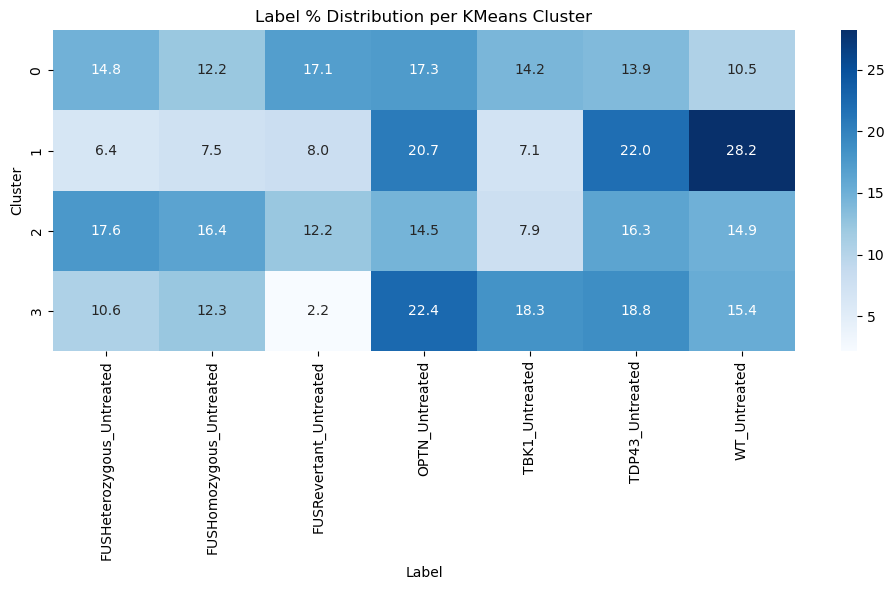

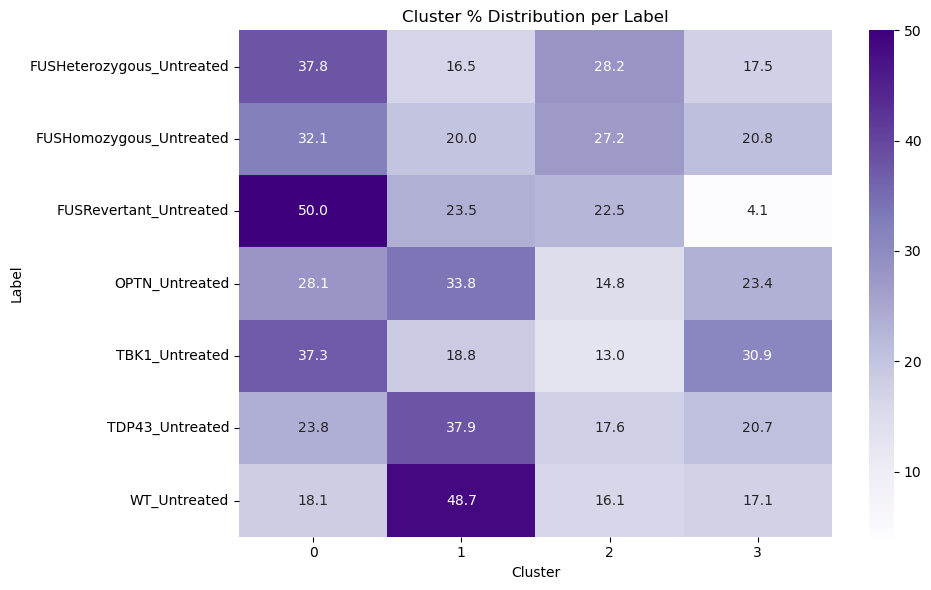

In [66]:
df = KMeans_cluster(
    batches=[1,2,3,8,9,10],
    n_clusters=4,
    normalize=True,
    balance=False,
    apply_pca=False,
    pca_components=50
)

Running: PCA=True, Normalize=True, Balance=True, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


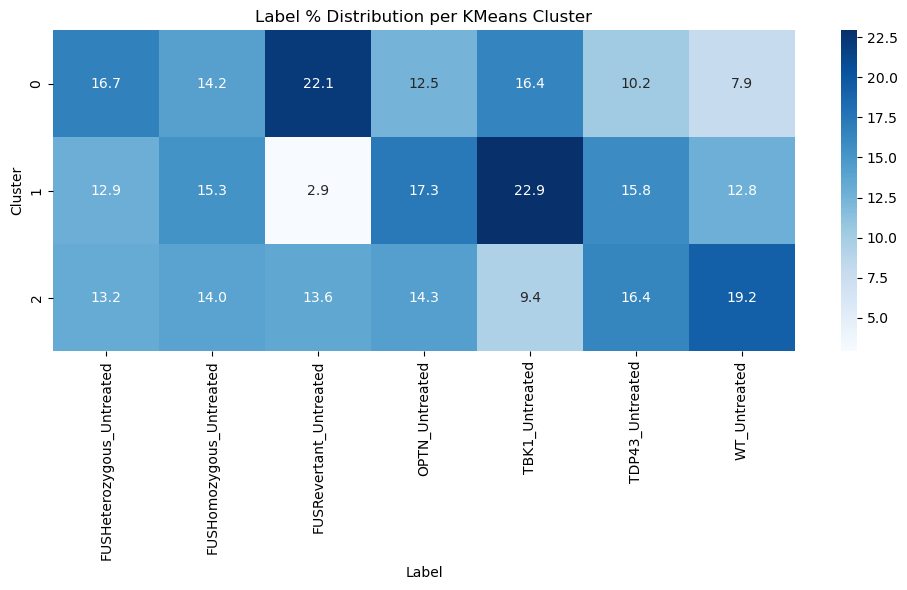

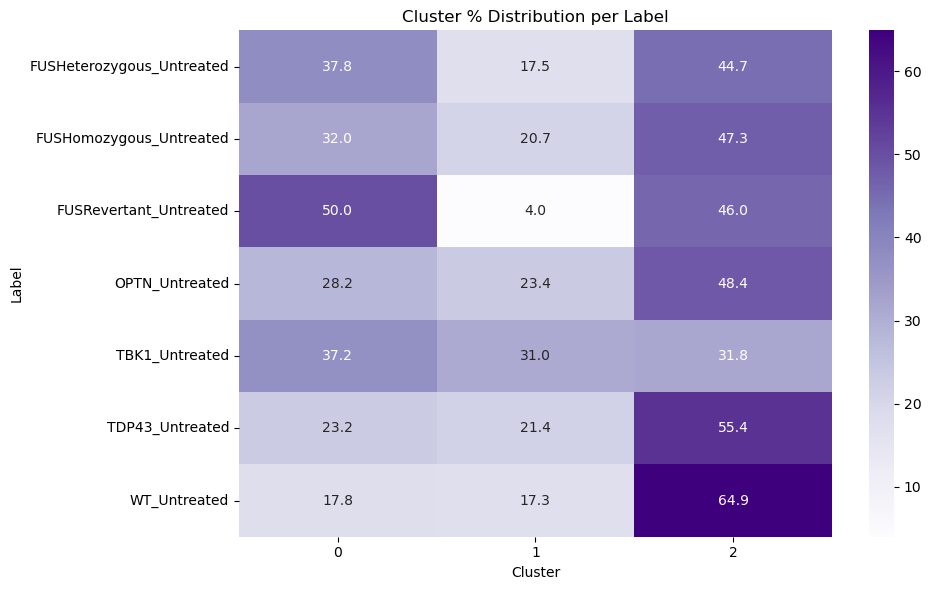

Running: PCA=True, Normalize=True, Balance=True, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


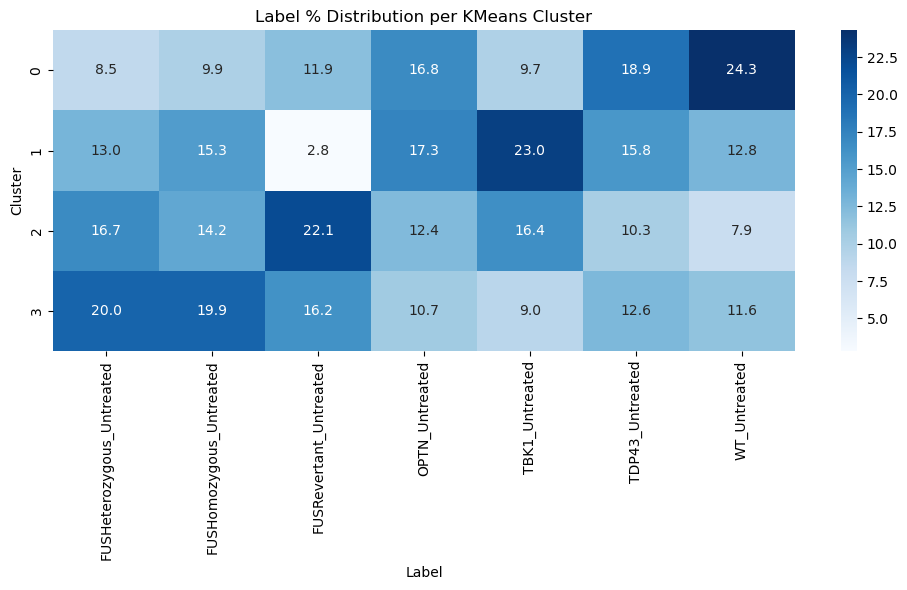

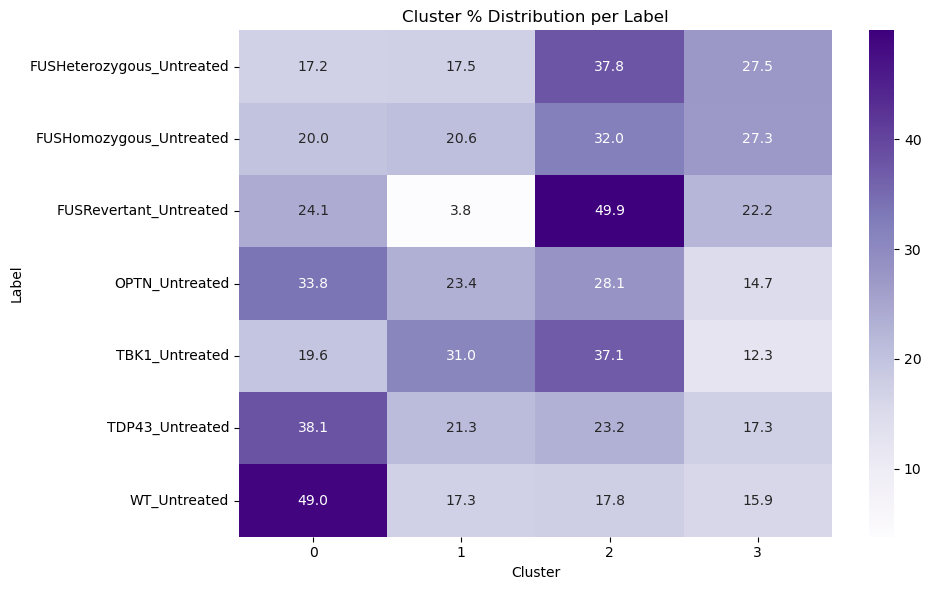

Running: PCA=True, Normalize=True, Balance=True, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


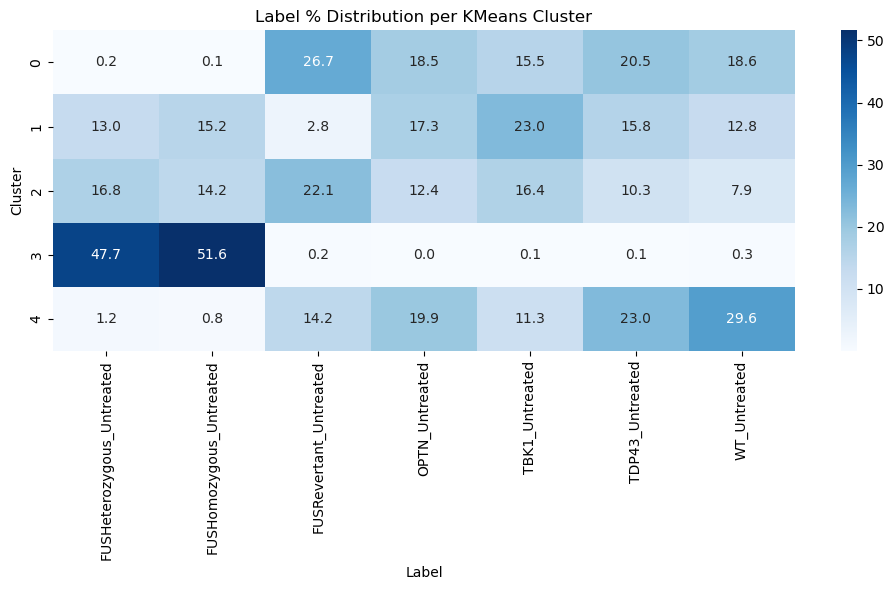

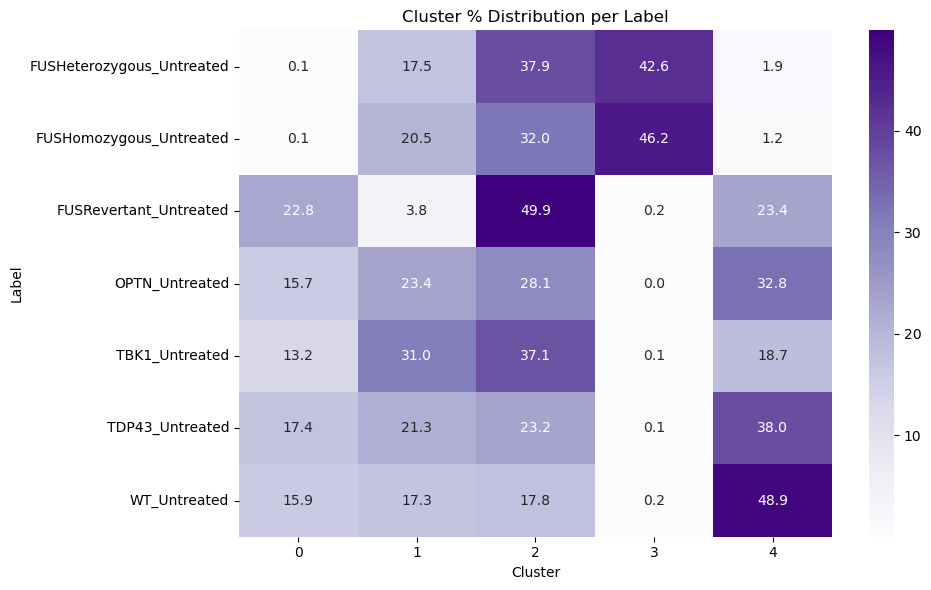

Running: PCA=True, Normalize=True, Balance=True, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


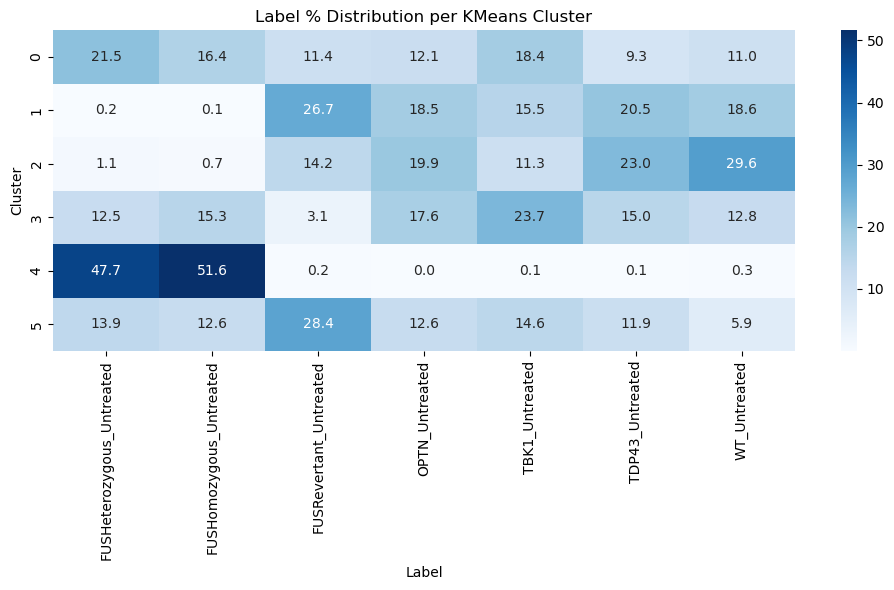

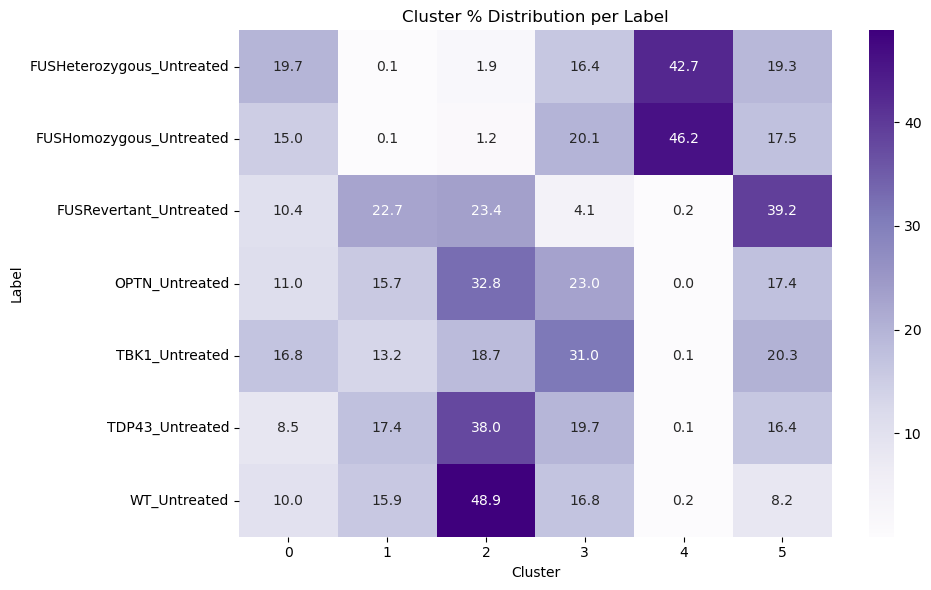

Running: PCA=True, Normalize=True, Balance=True, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


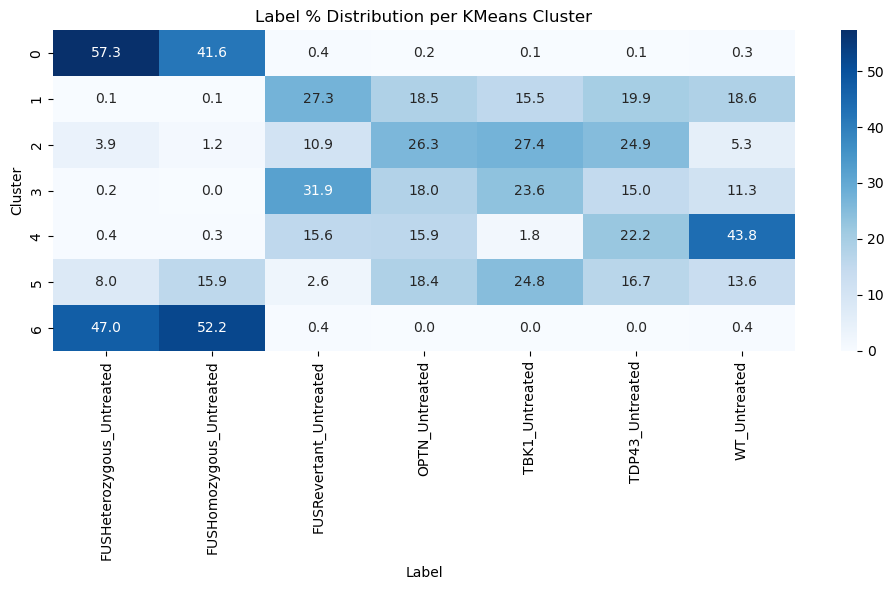

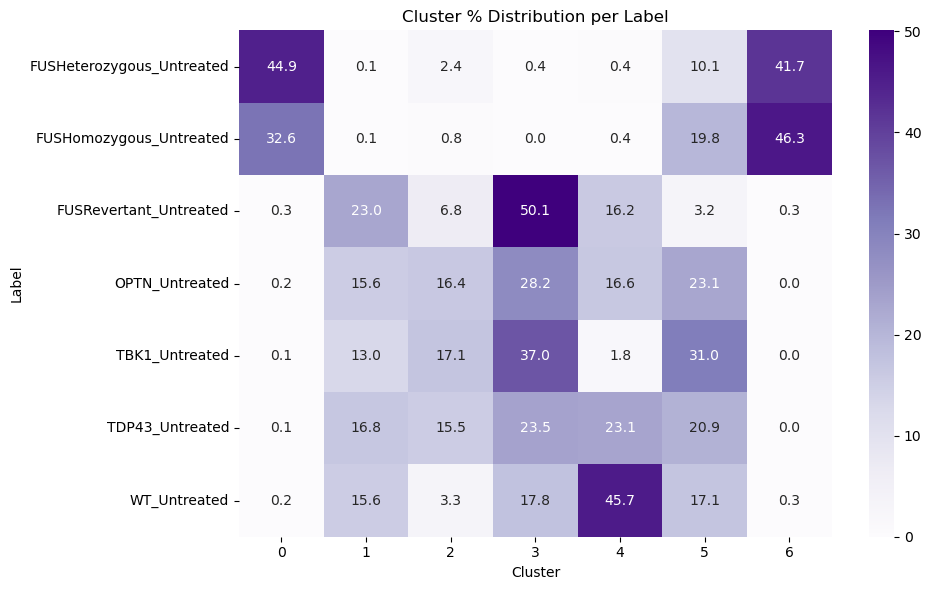

Running: PCA=True, Normalize=True, Balance=False, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


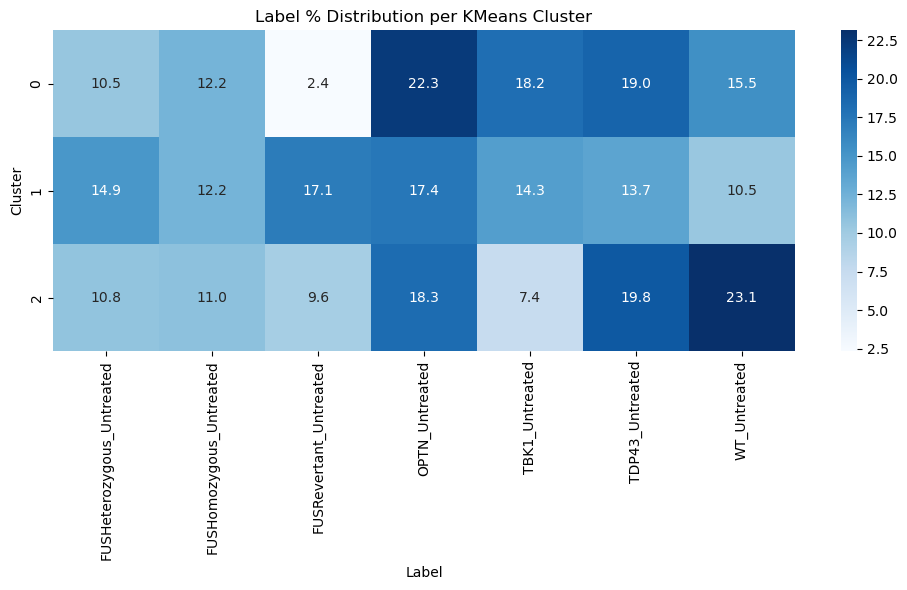

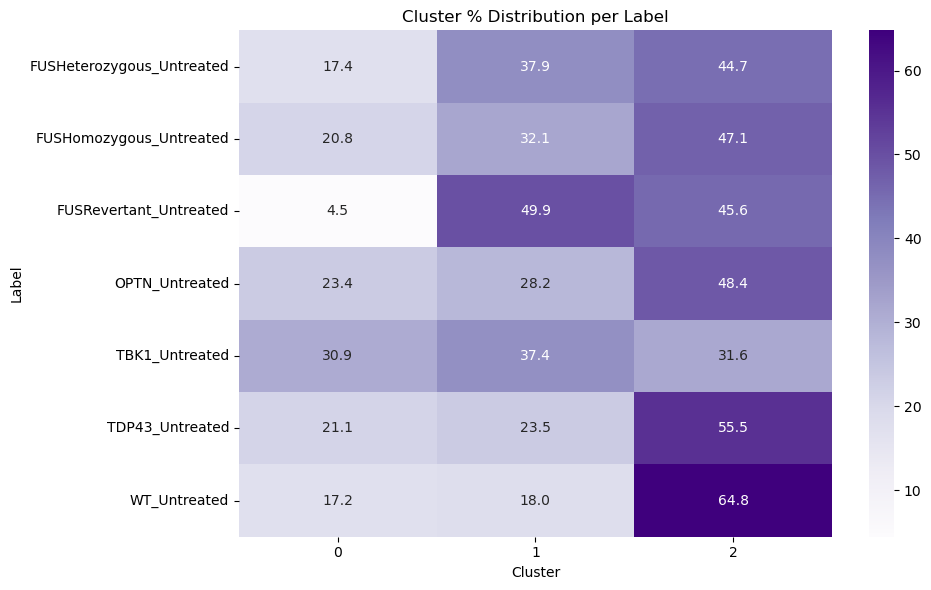

Running: PCA=True, Normalize=True, Balance=False, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


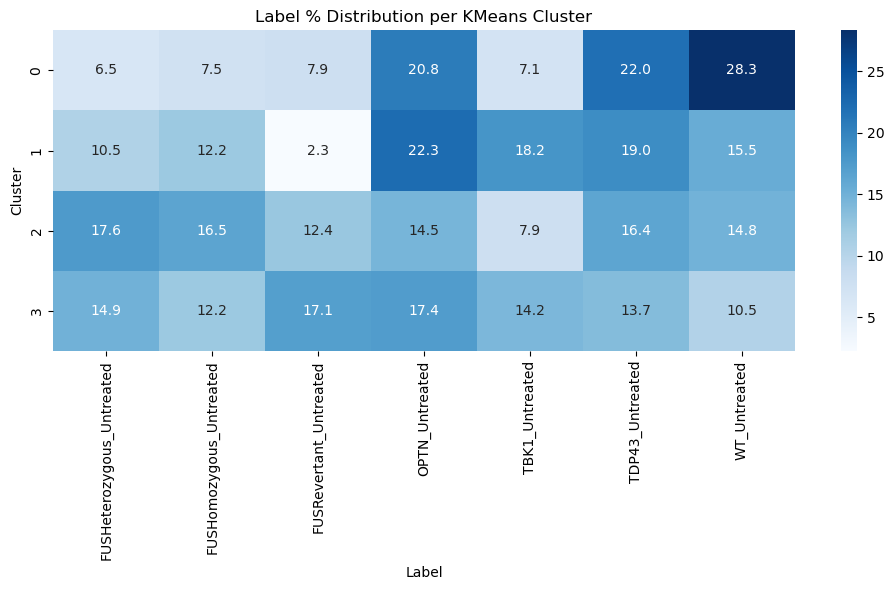

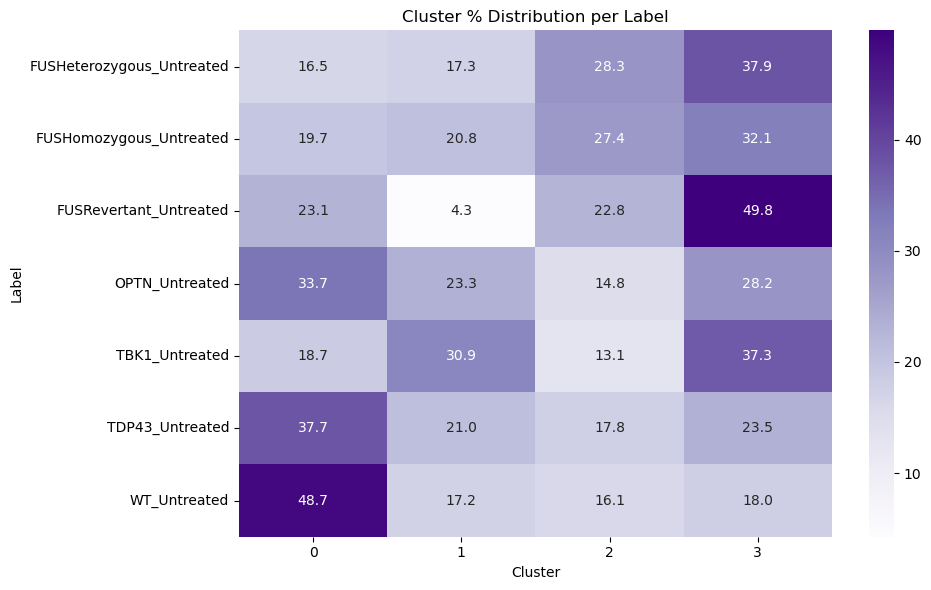

Running: PCA=True, Normalize=True, Balance=False, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


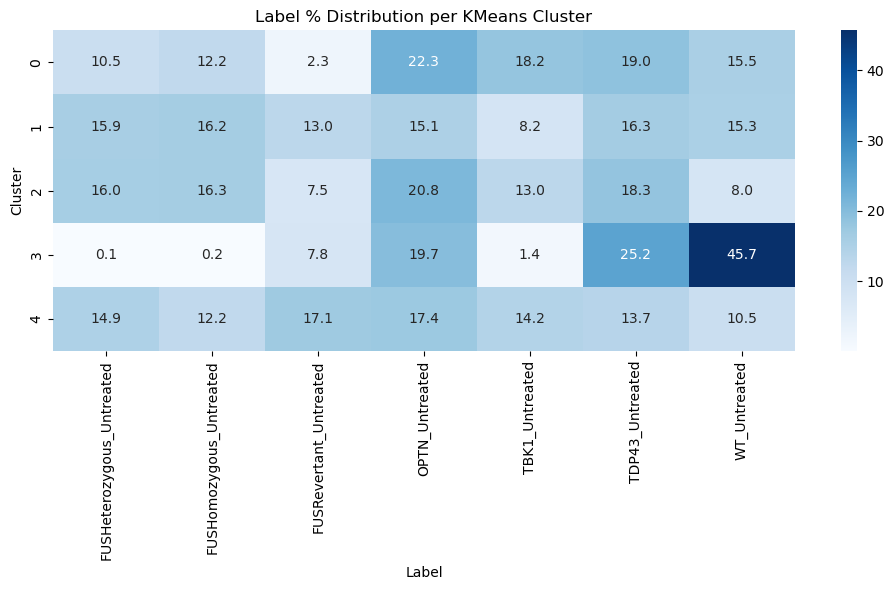

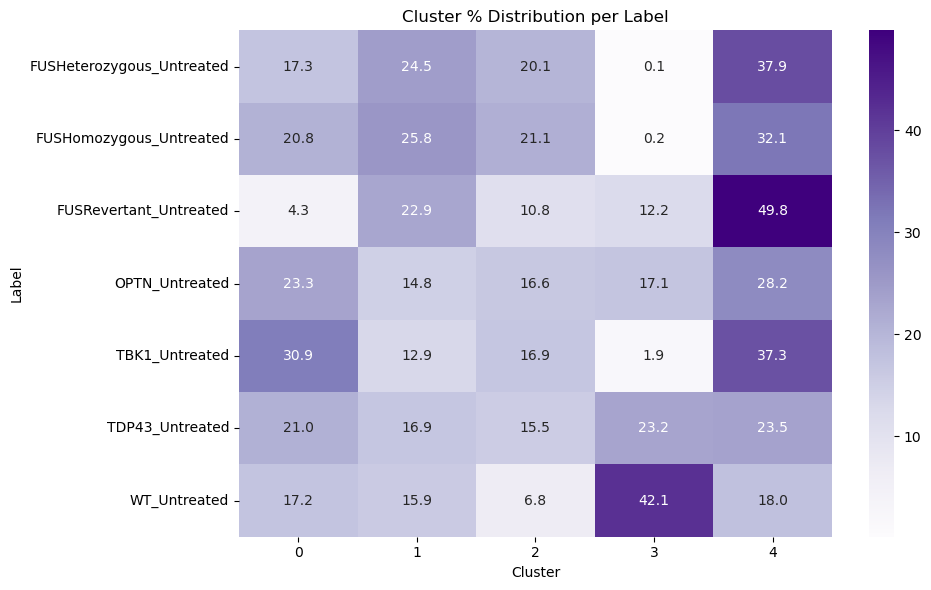

Running: PCA=True, Normalize=True, Balance=False, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


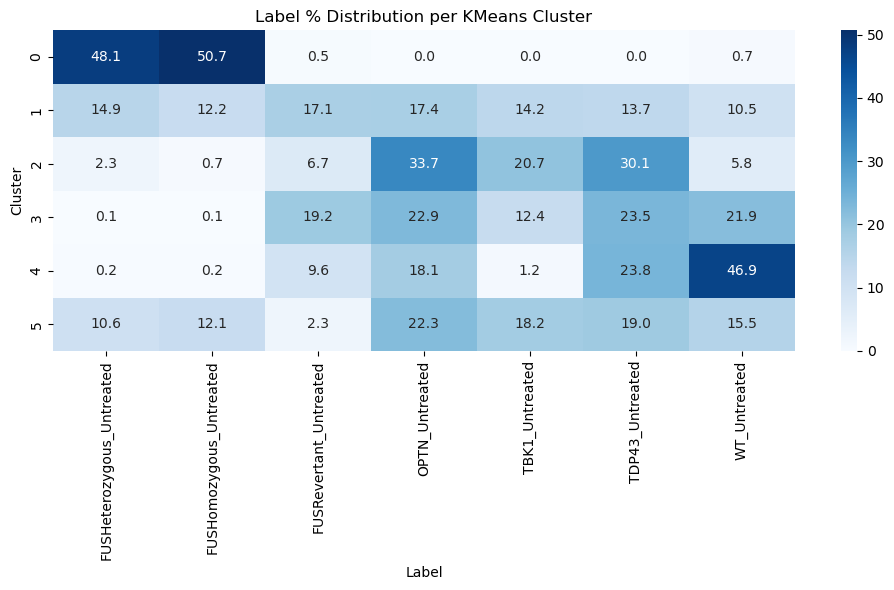

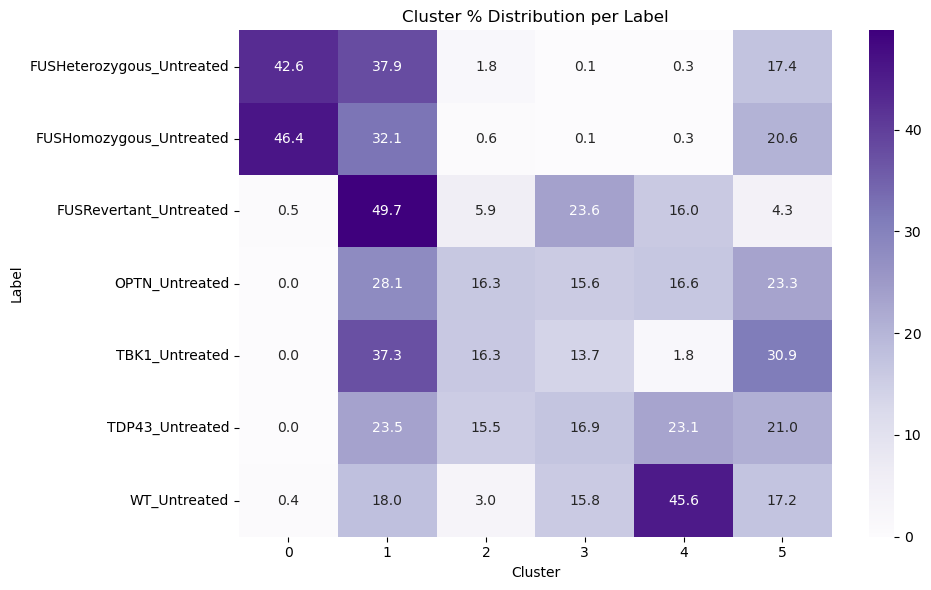

Running: PCA=True, Normalize=True, Balance=False, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


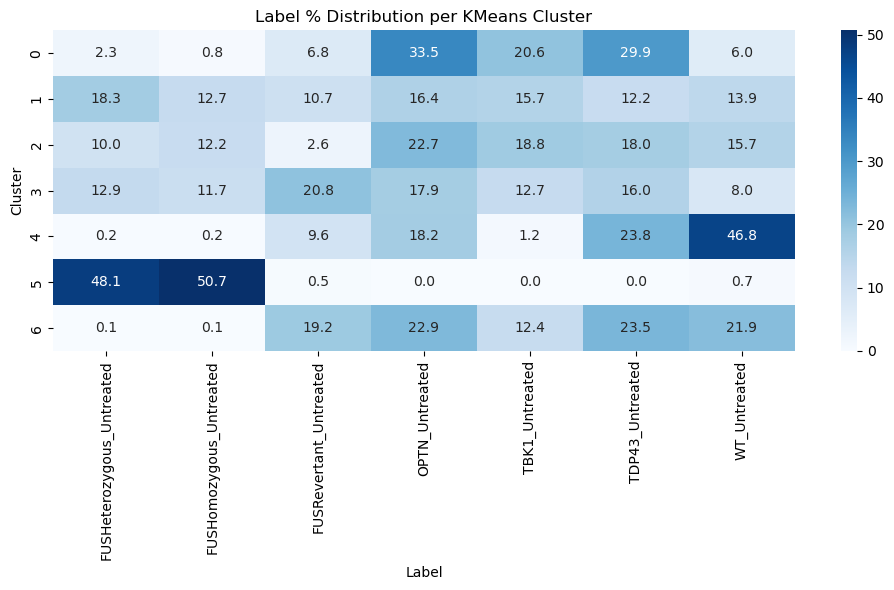

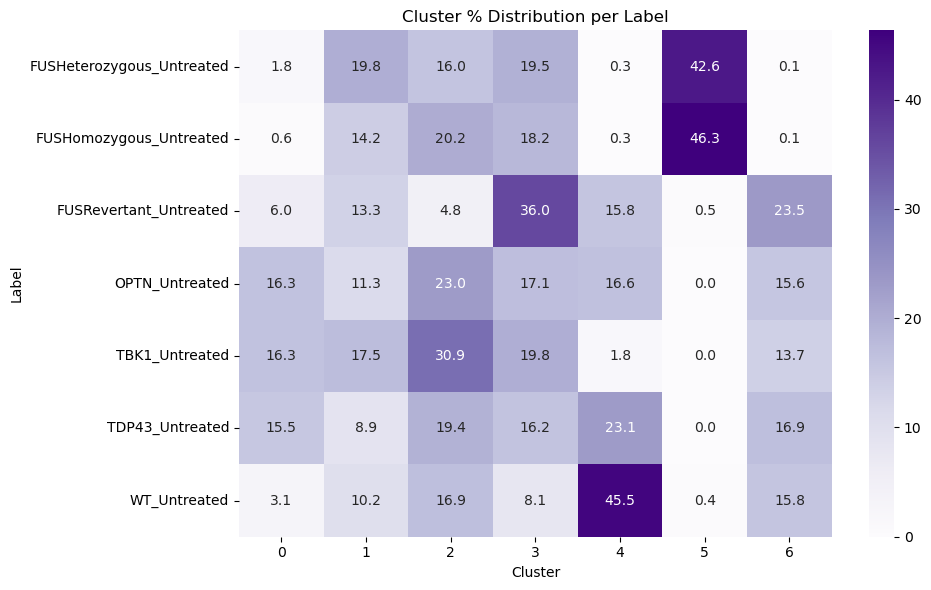

Running: PCA=True, Normalize=False, Balance=True, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


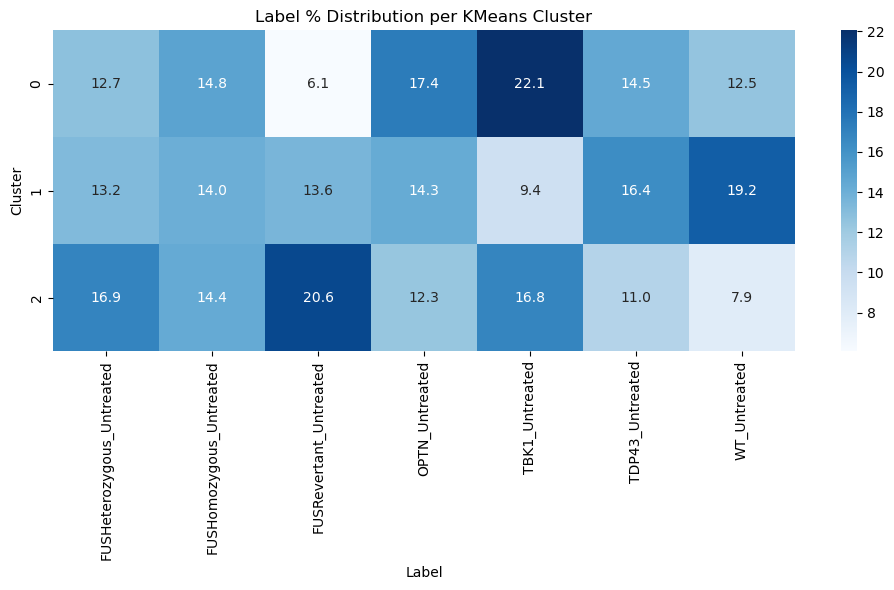

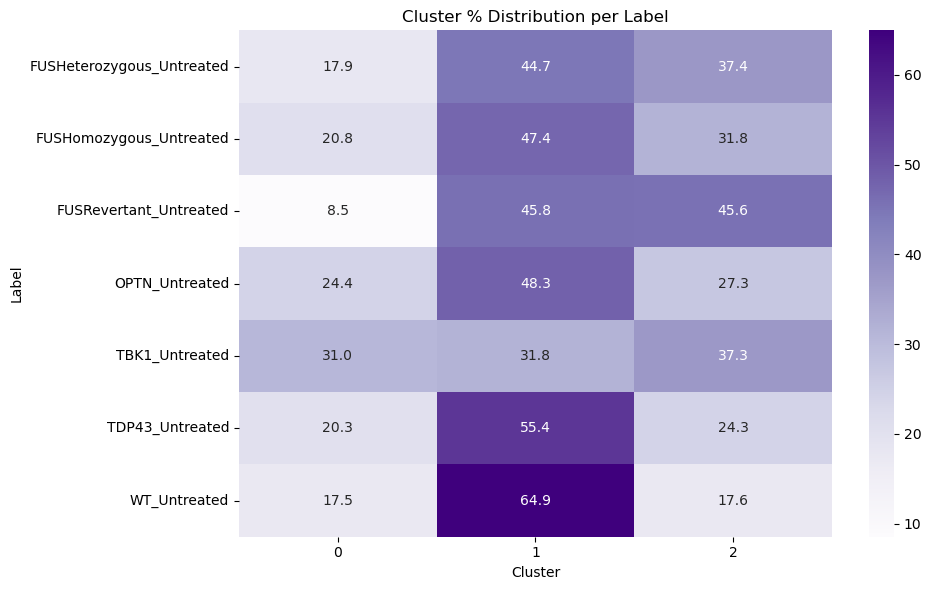

Running: PCA=True, Normalize=False, Balance=True, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


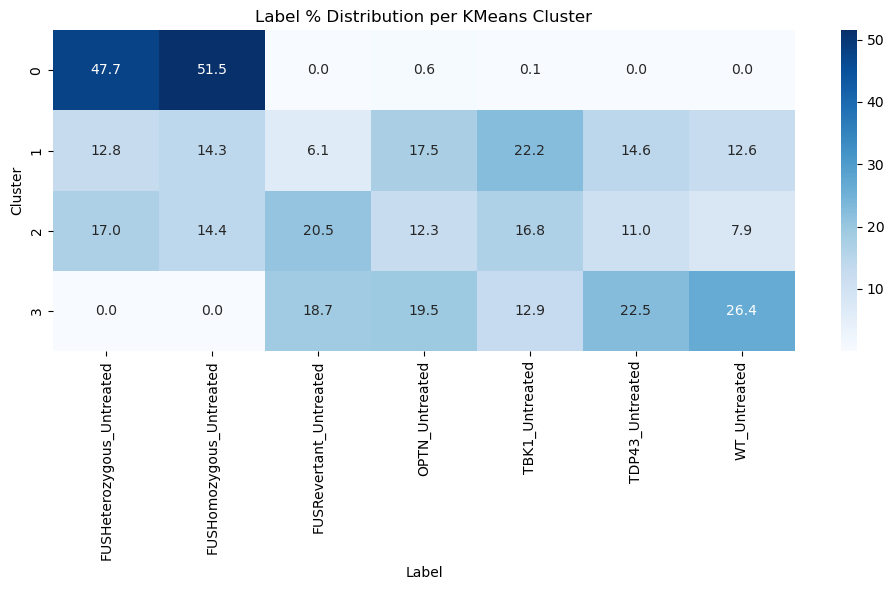

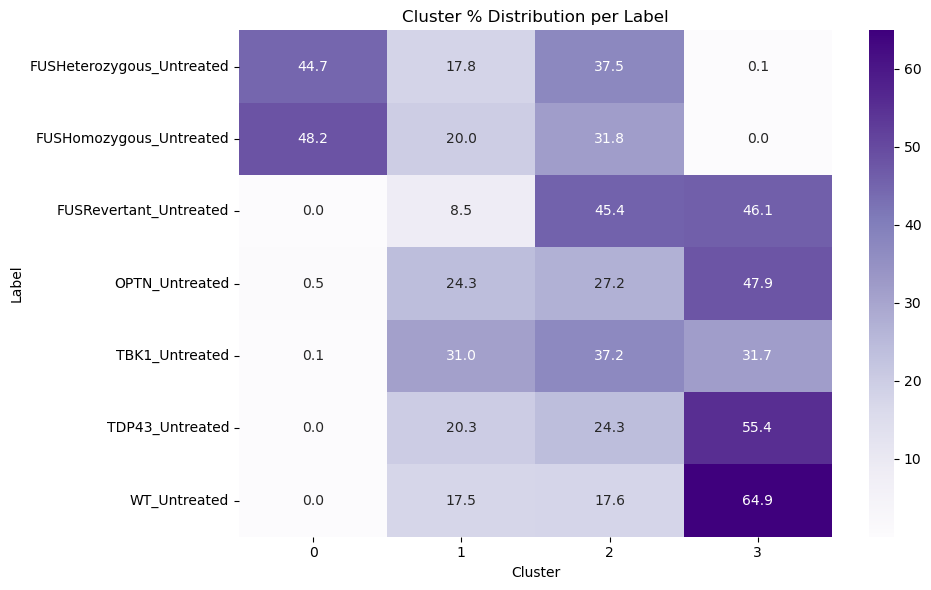

Running: PCA=True, Normalize=False, Balance=True, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


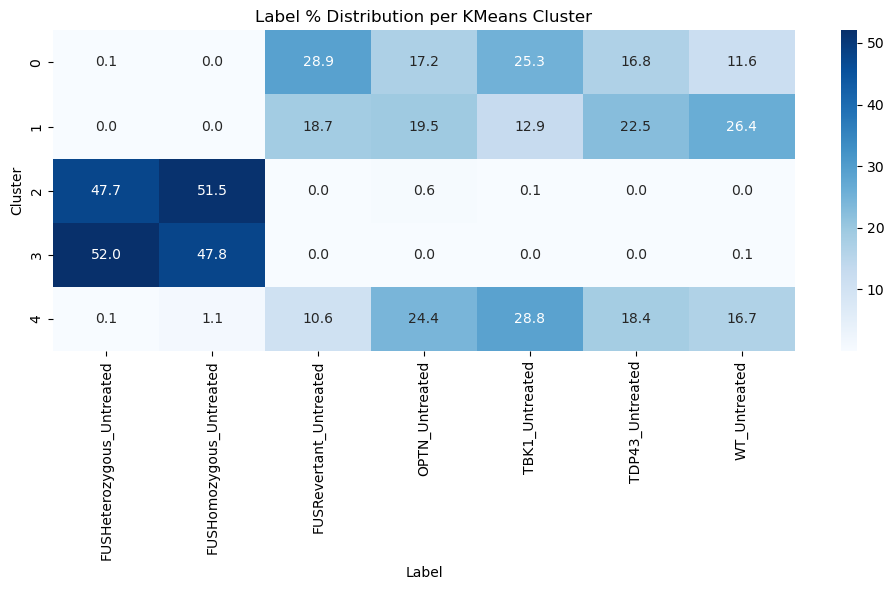

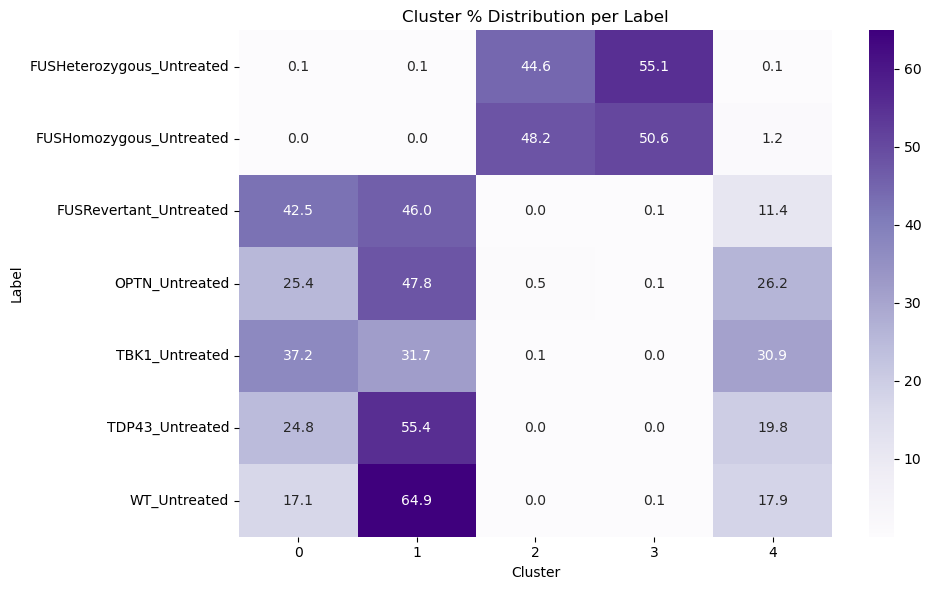

Running: PCA=True, Normalize=False, Balance=True, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


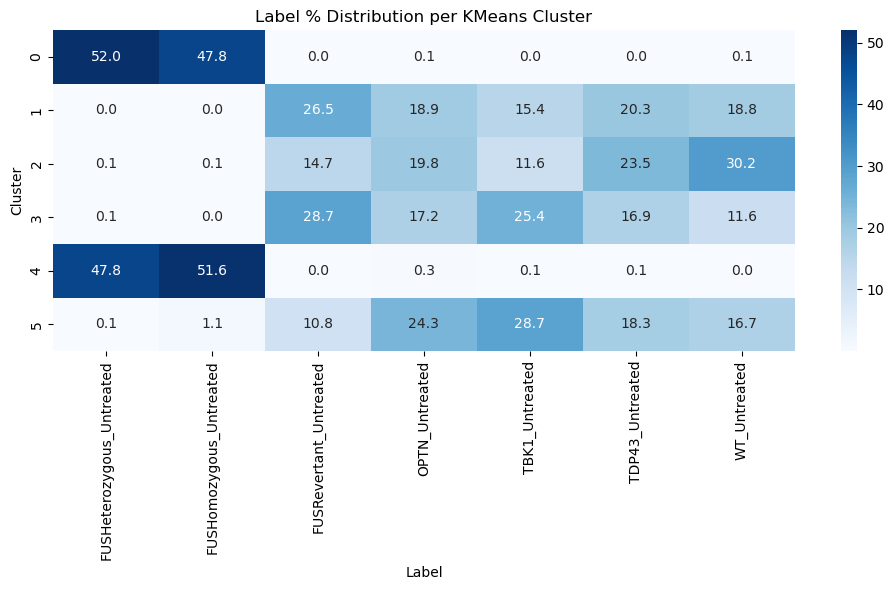

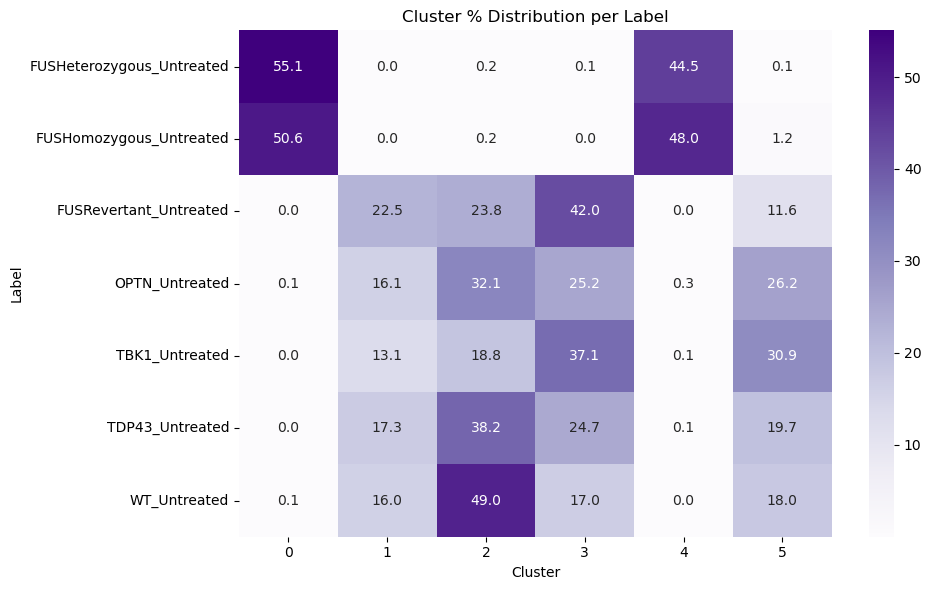

Running: PCA=True, Normalize=False, Balance=True, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


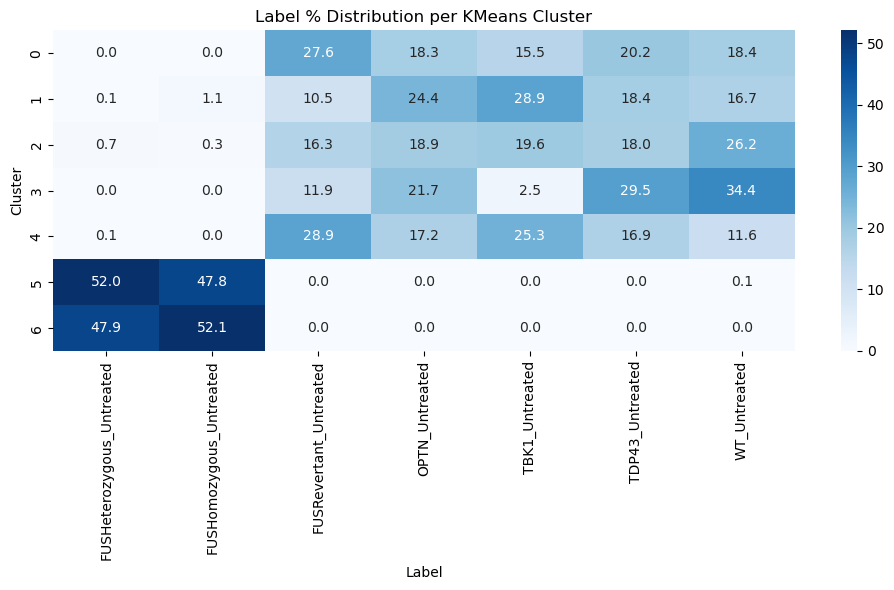

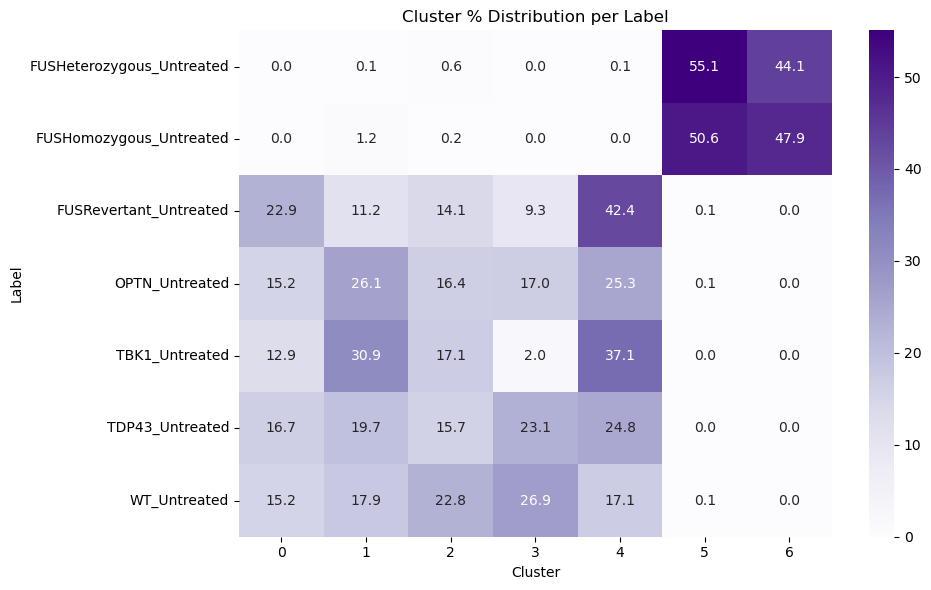

Running: PCA=True, Normalize=False, Balance=False, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


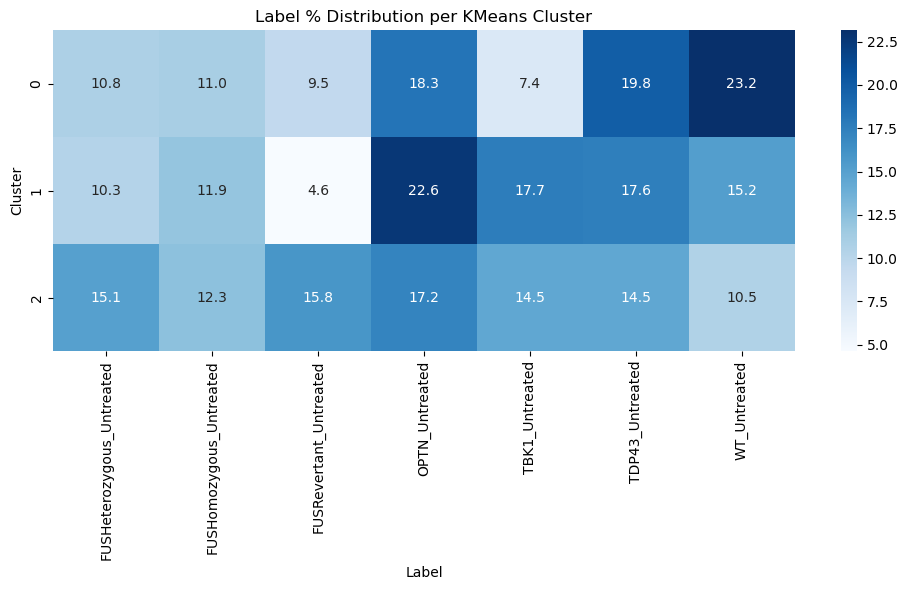

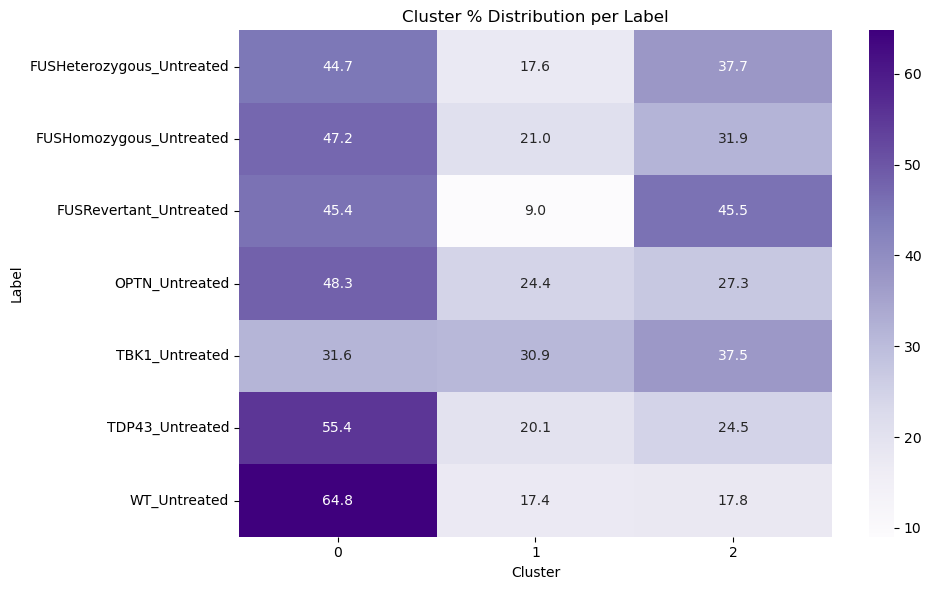

Running: PCA=True, Normalize=False, Balance=False, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


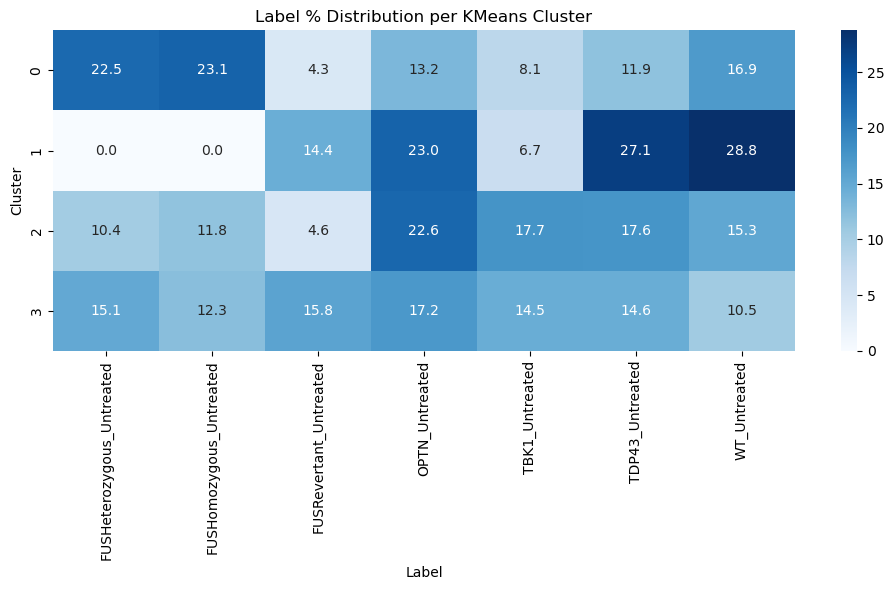

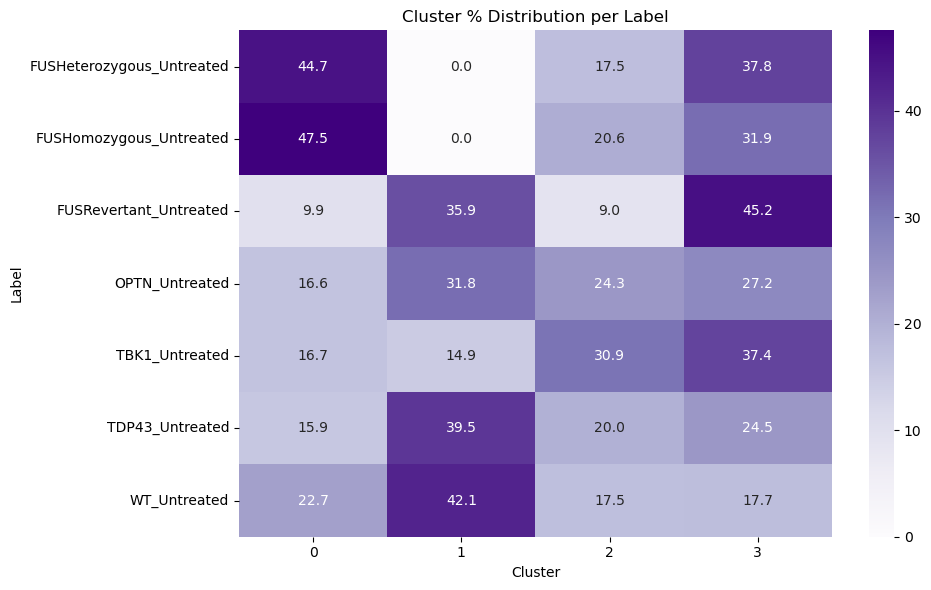

Running: PCA=True, Normalize=False, Balance=False, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


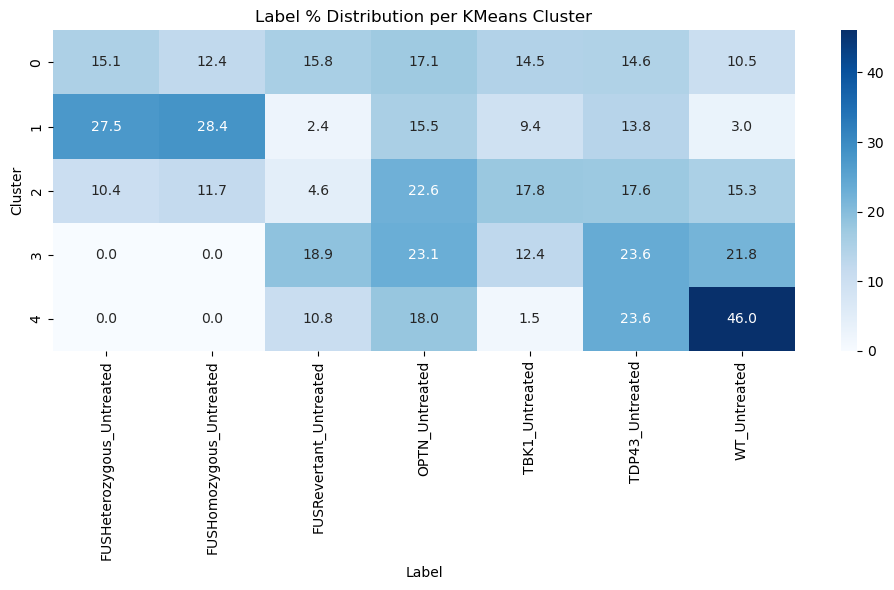

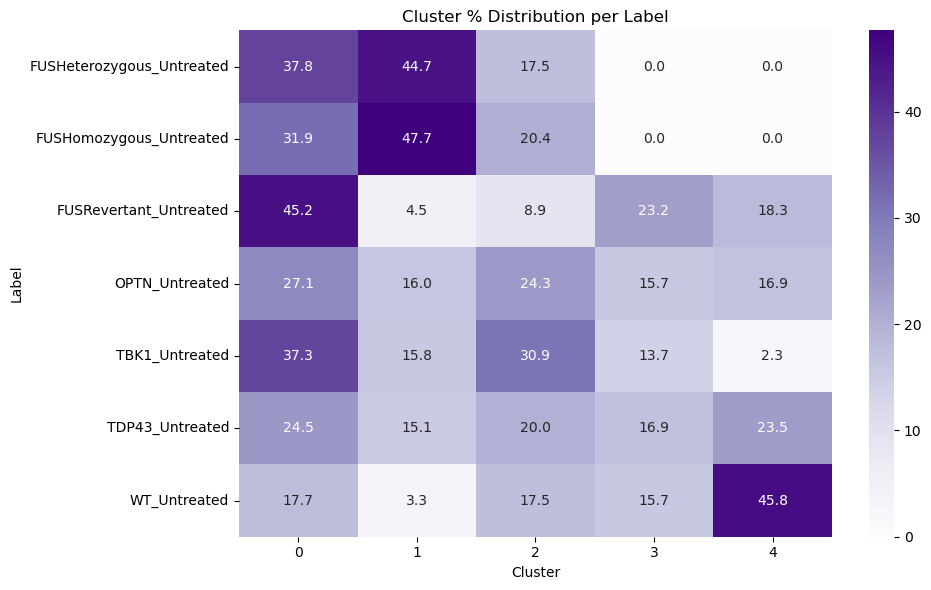

Running: PCA=True, Normalize=False, Balance=False, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


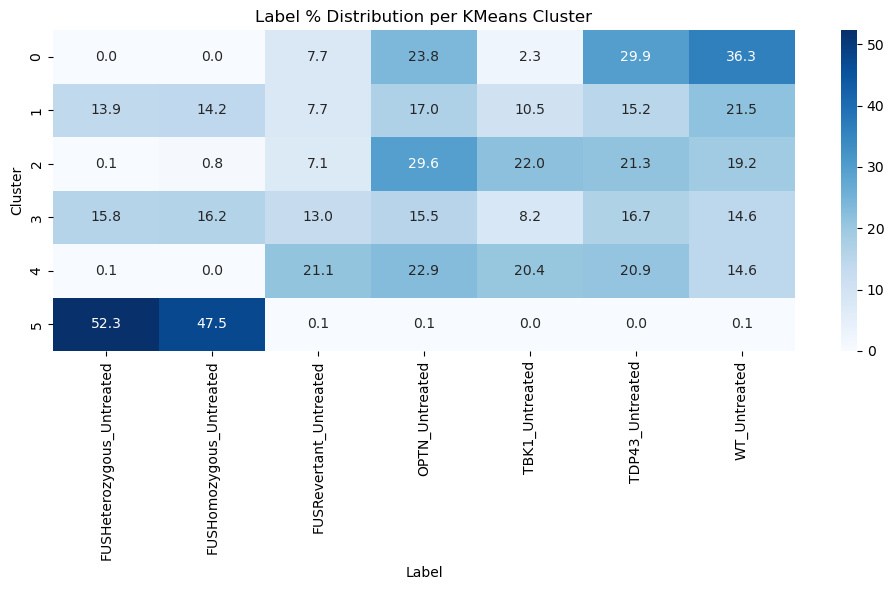

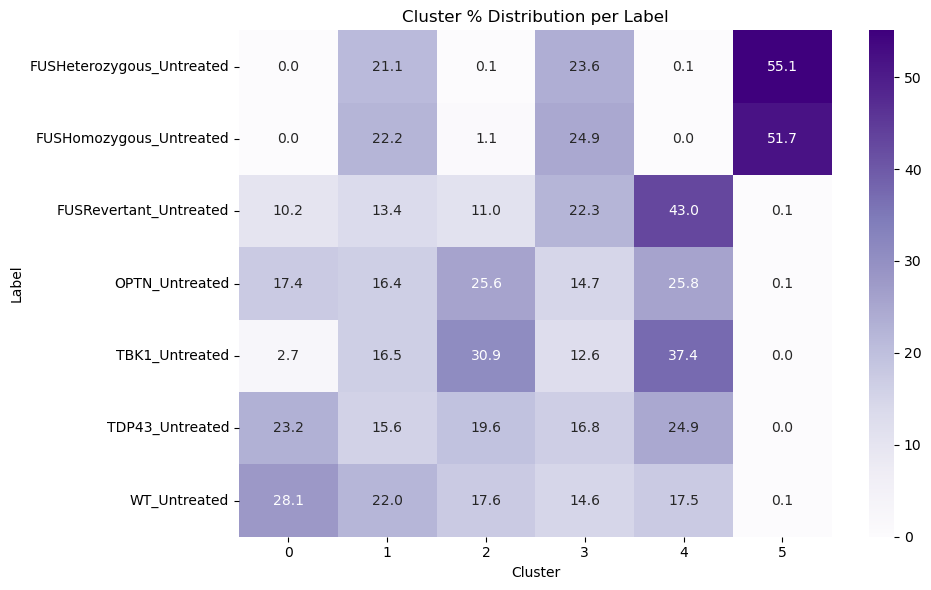

Running: PCA=True, Normalize=False, Balance=False, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


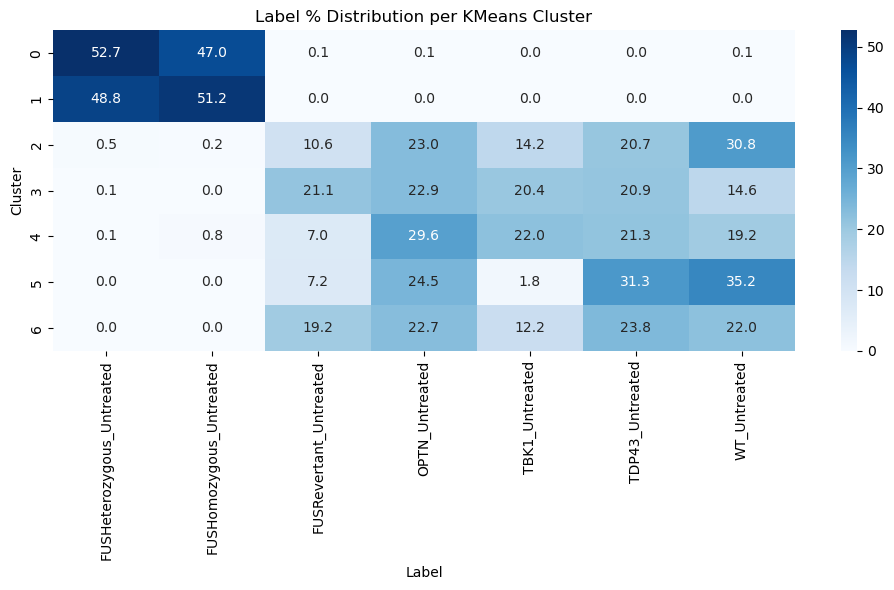

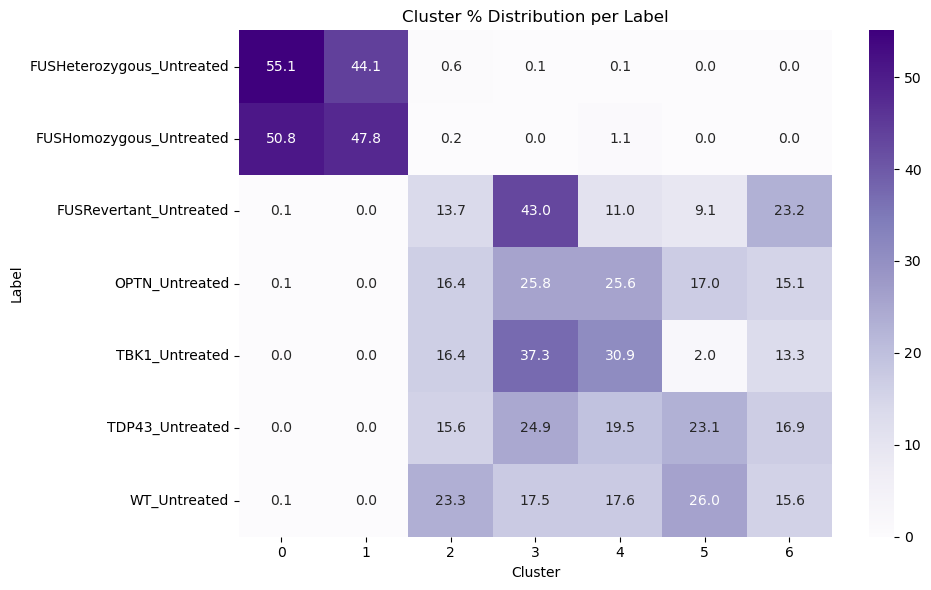

Running: PCA=False, Normalize=True, Balance=True, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


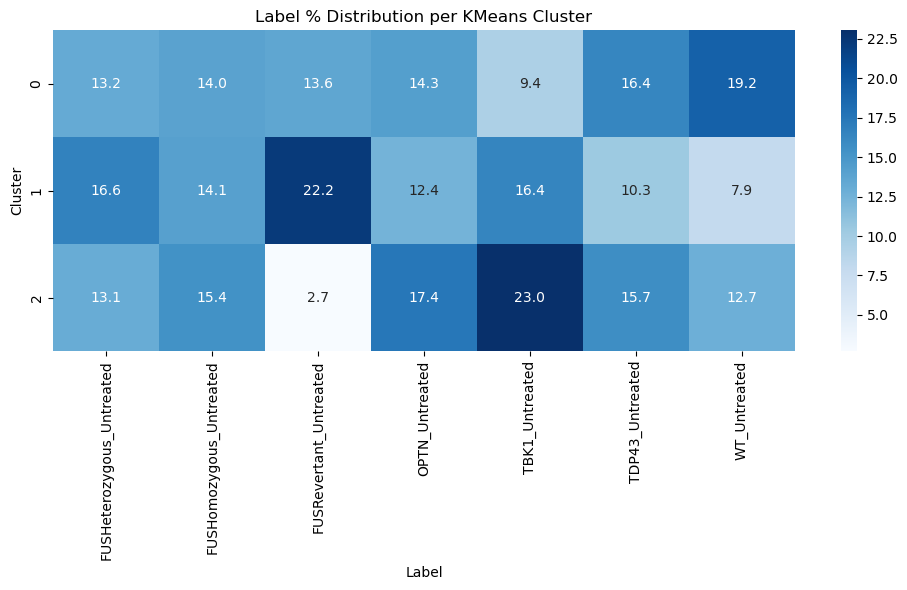

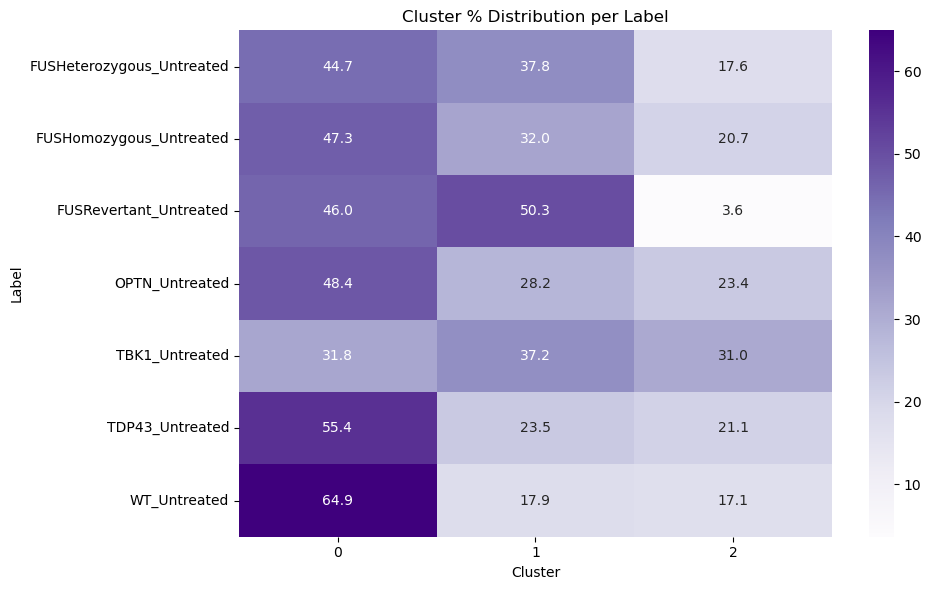

Running: PCA=False, Normalize=True, Balance=True, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


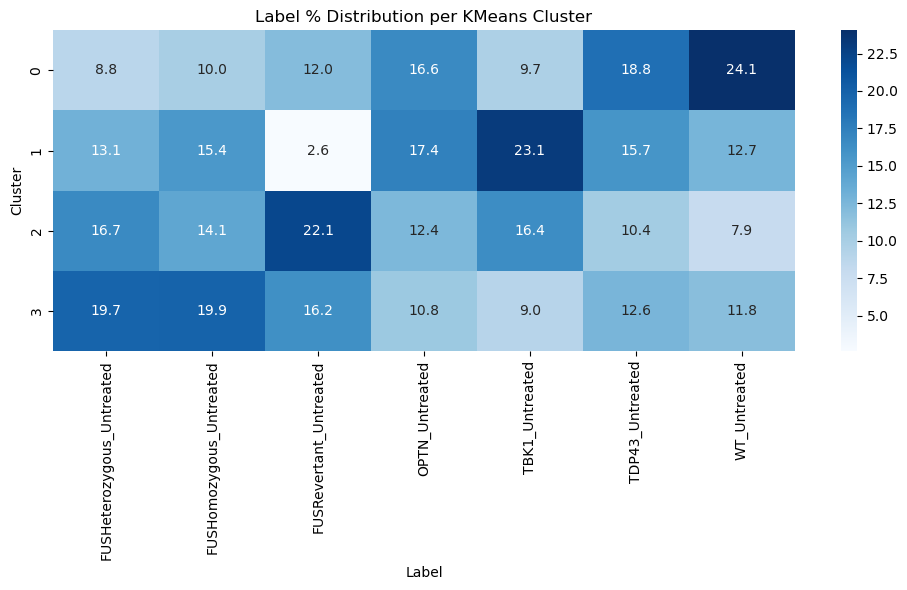

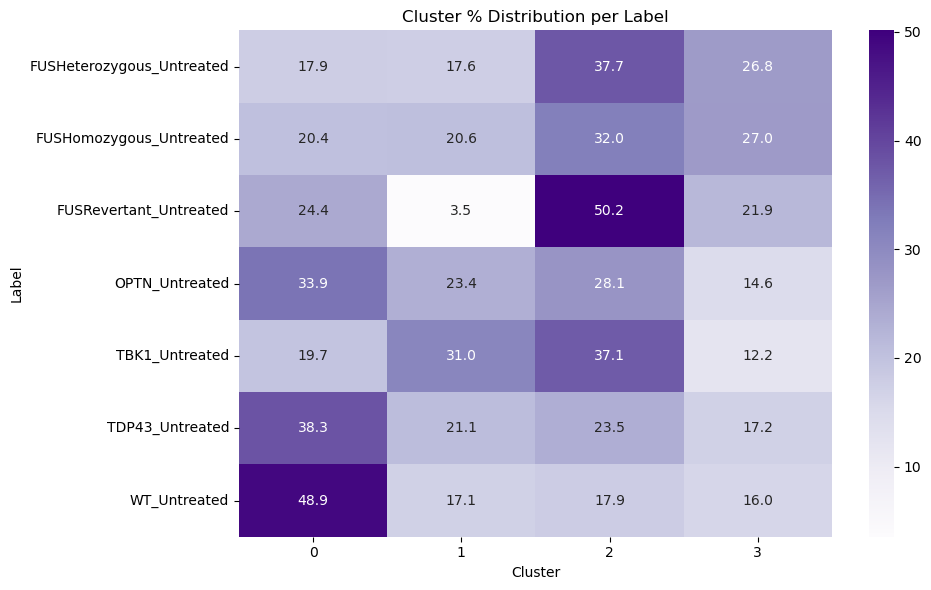

Running: PCA=False, Normalize=True, Balance=True, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


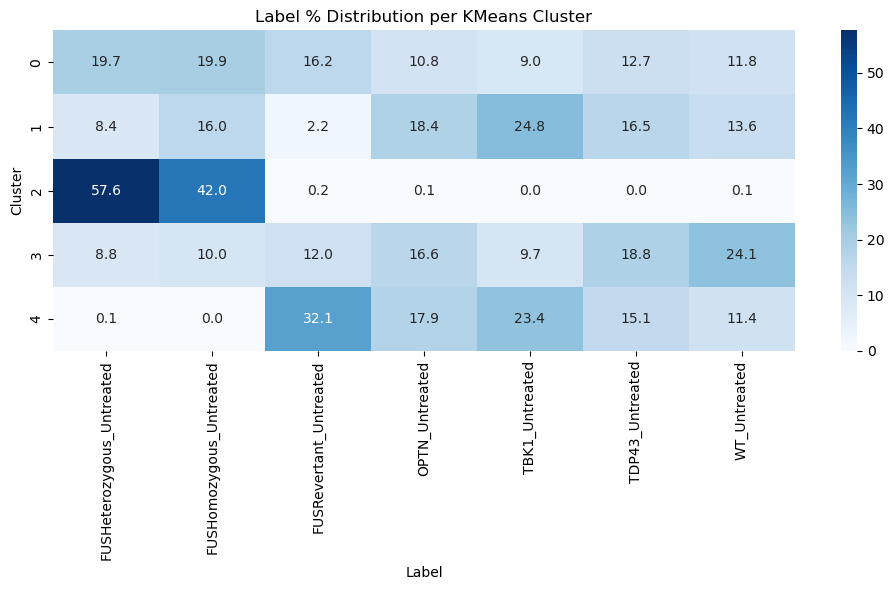

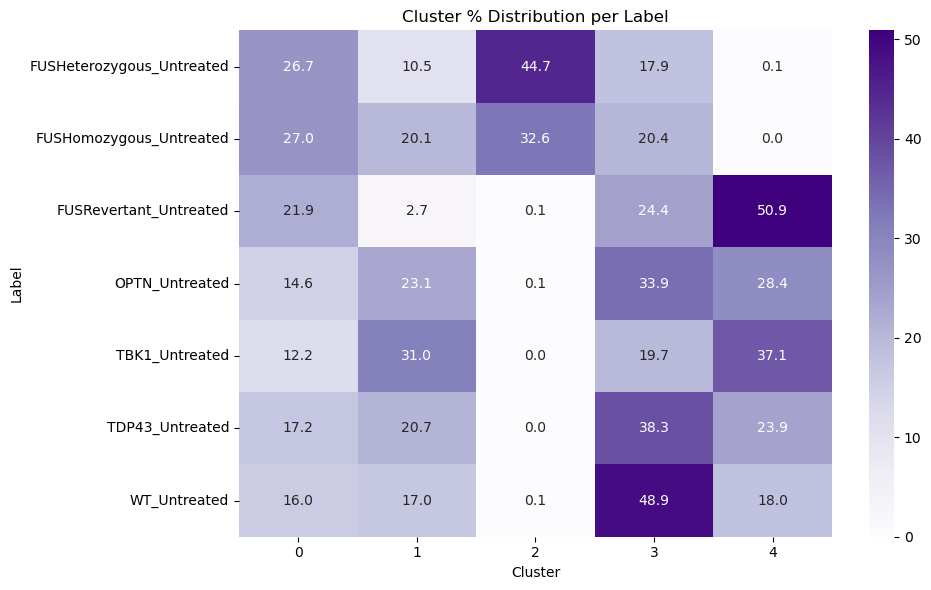

Running: PCA=False, Normalize=True, Balance=True, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


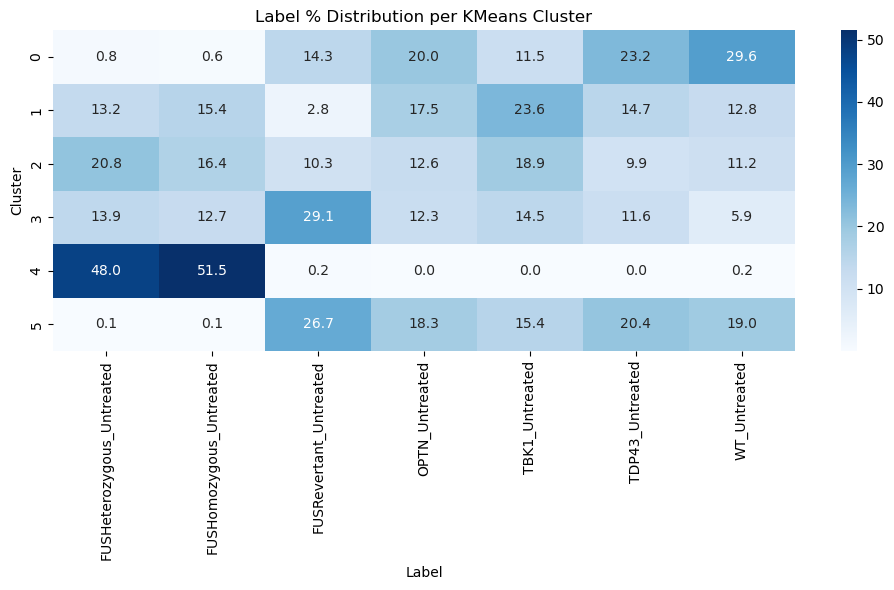

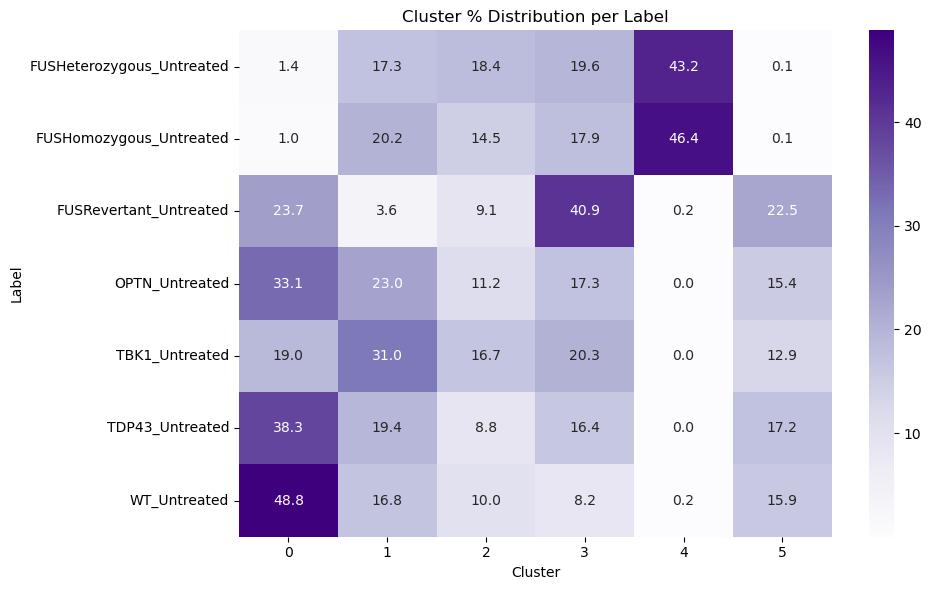

Running: PCA=False, Normalize=True, Balance=True, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


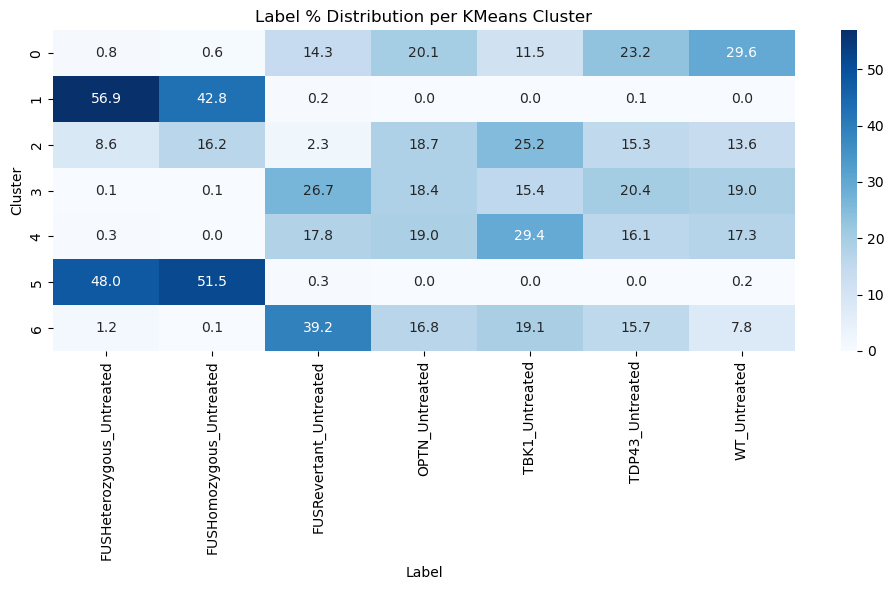

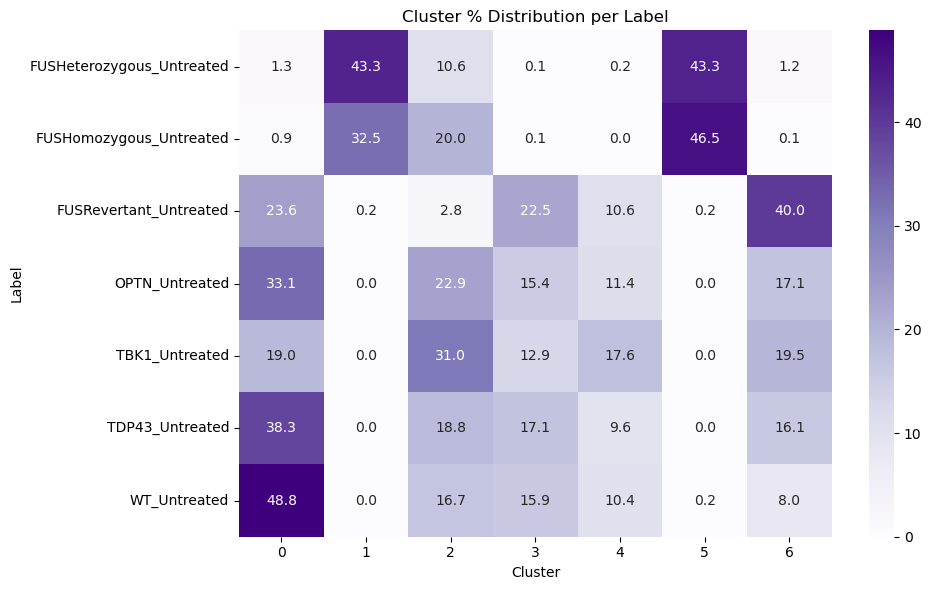

Running: PCA=False, Normalize=True, Balance=False, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


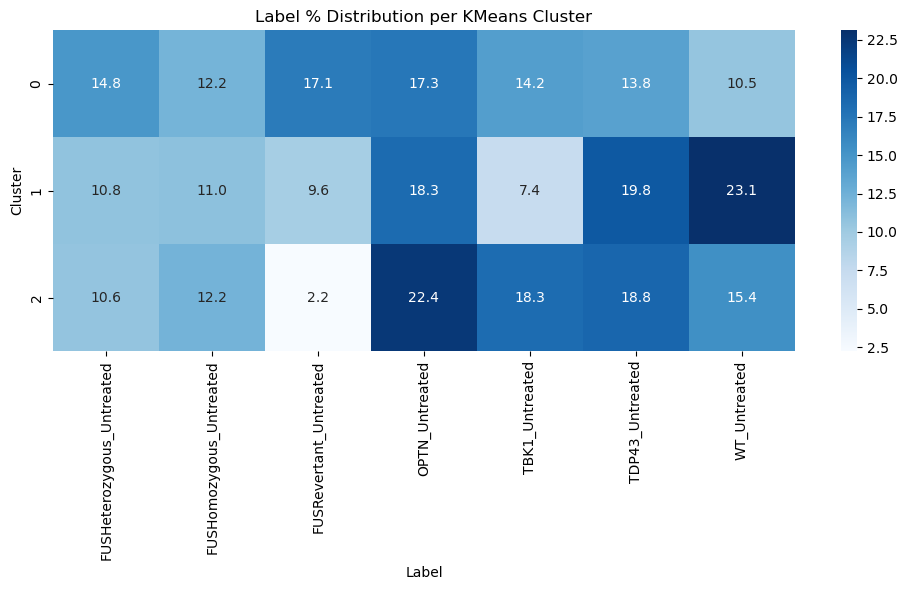

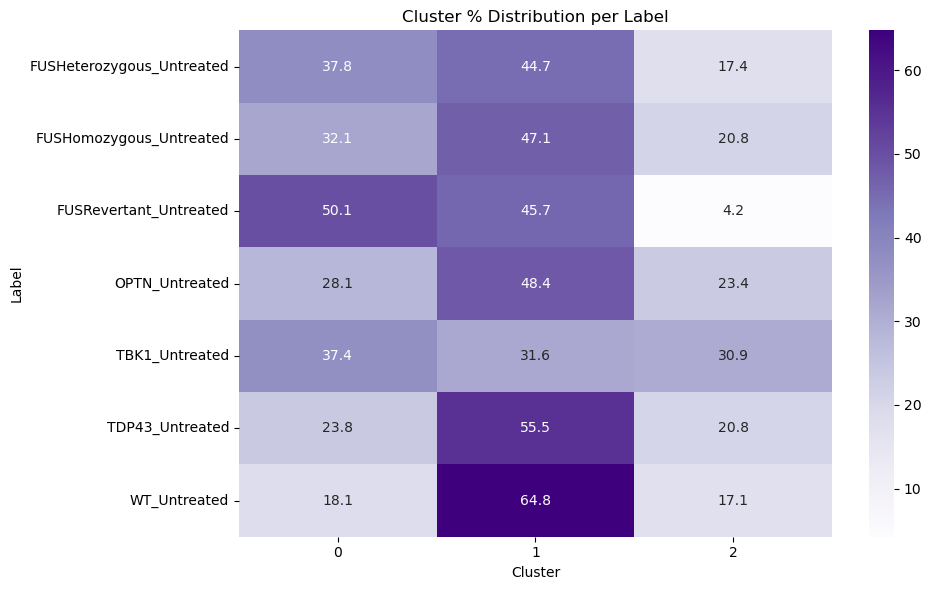

Running: PCA=False, Normalize=True, Balance=False, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


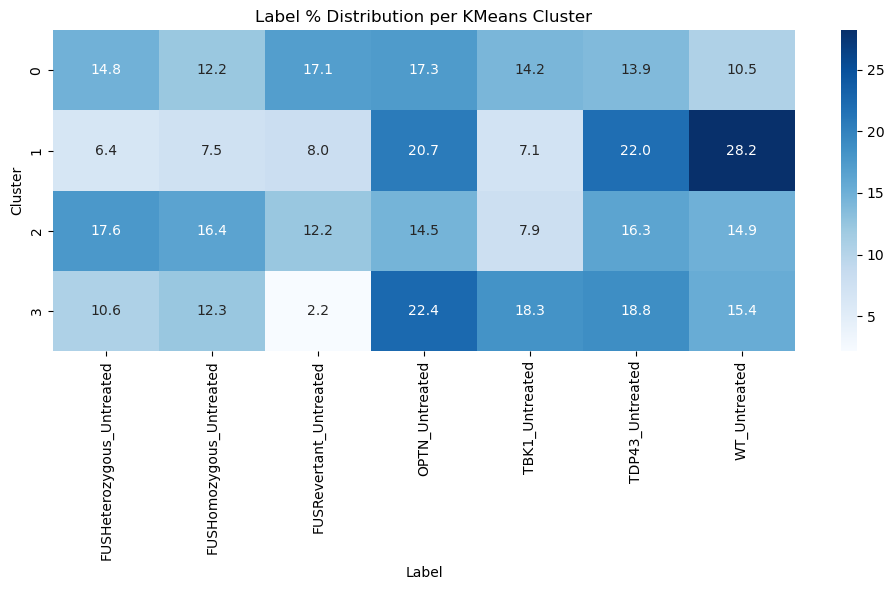

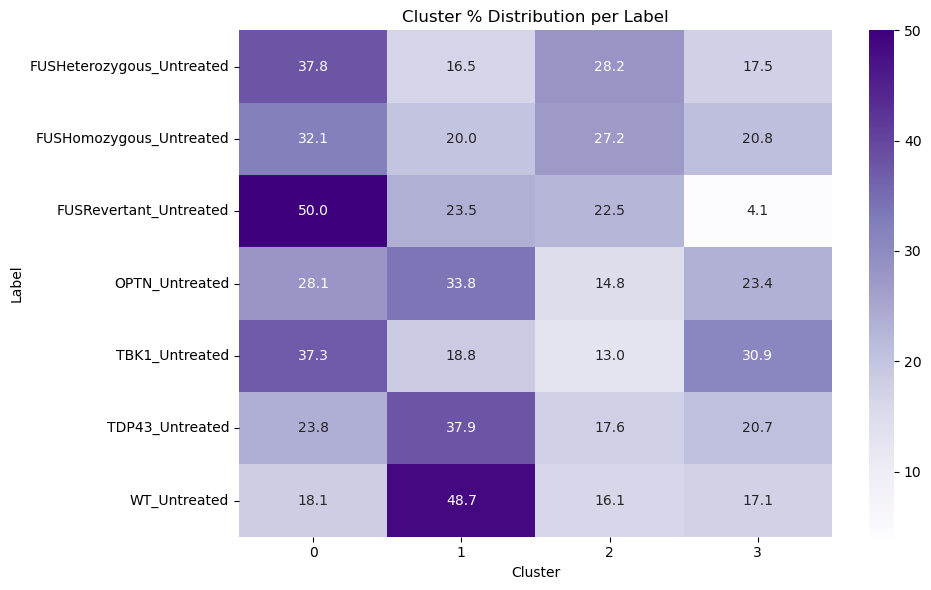

Running: PCA=False, Normalize=True, Balance=False, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


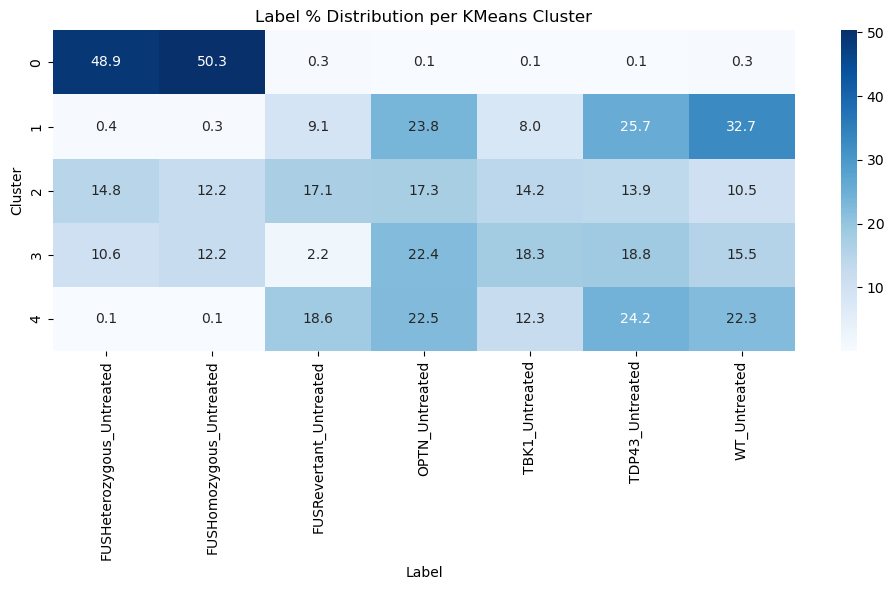

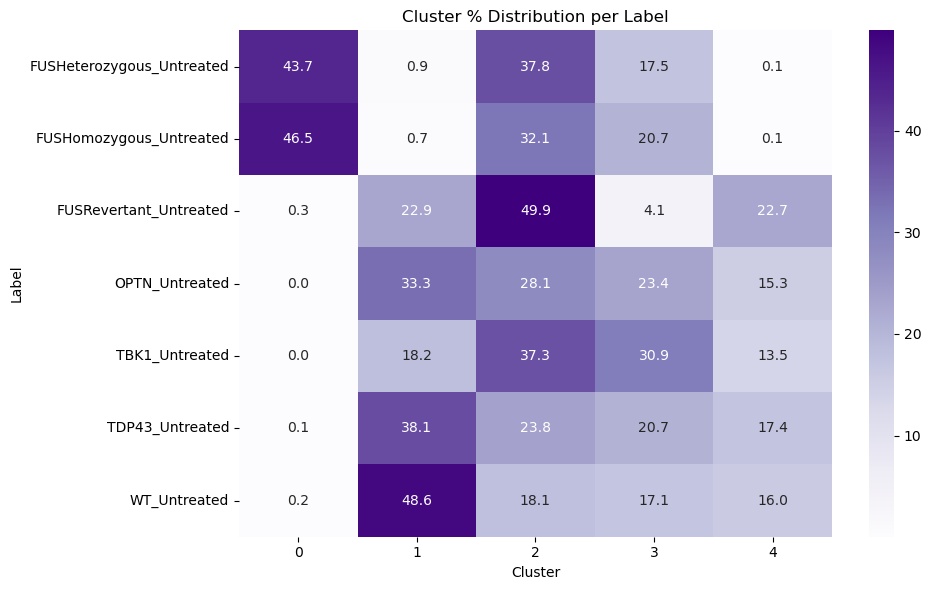

Running: PCA=False, Normalize=True, Balance=False, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


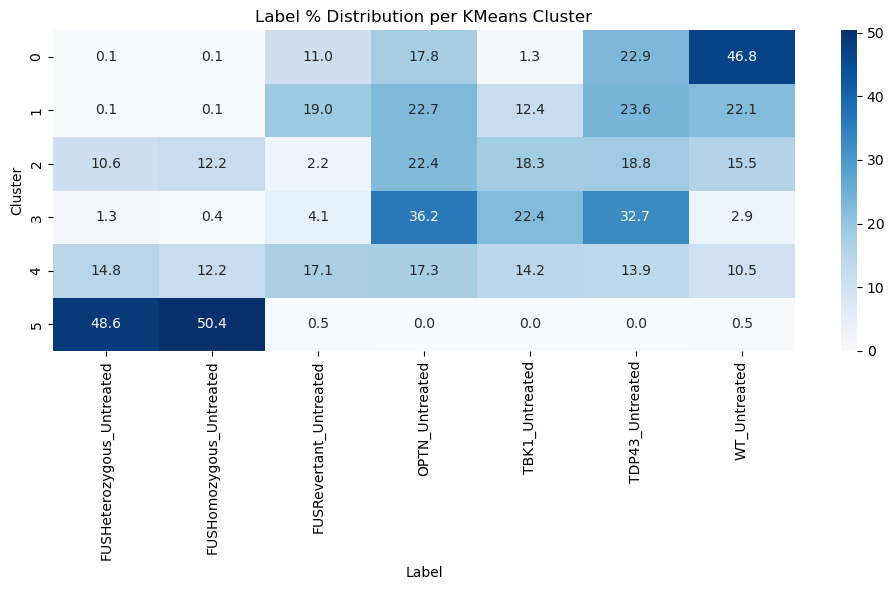

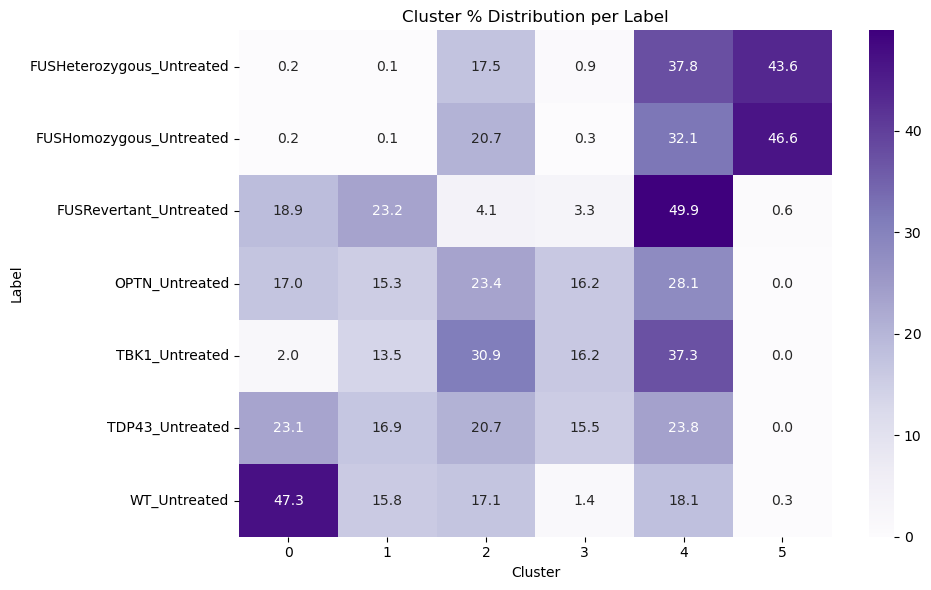

Running: PCA=False, Normalize=True, Balance=False, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


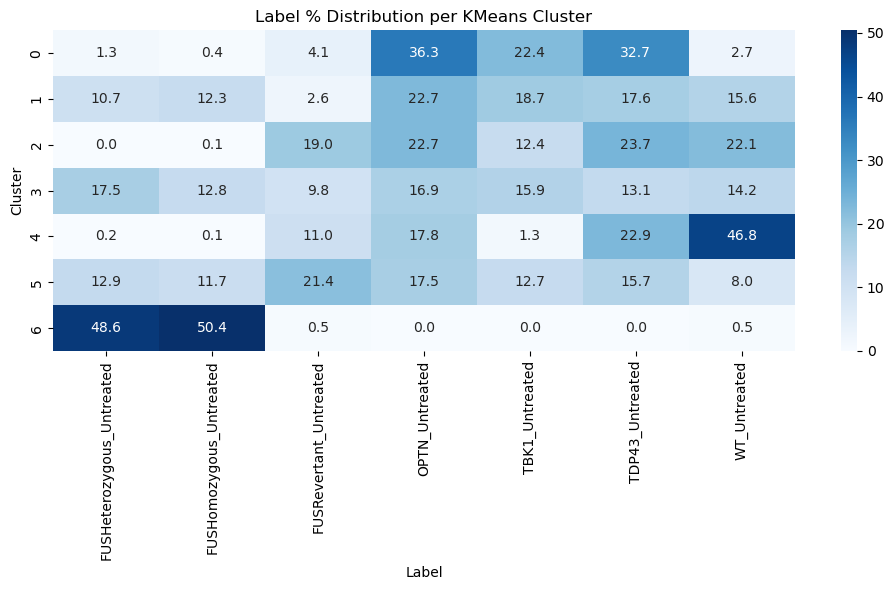

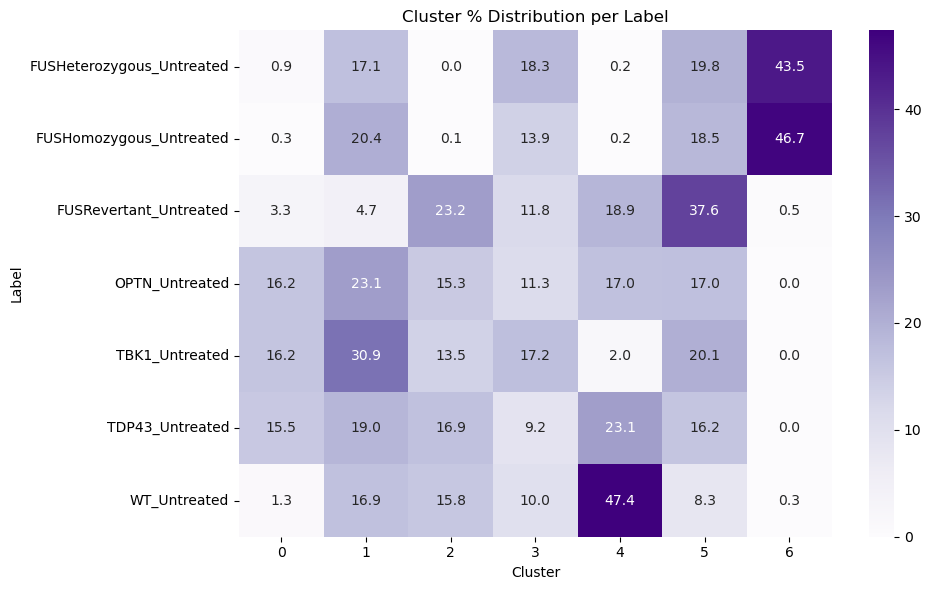

Running: PCA=False, Normalize=False, Balance=True, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


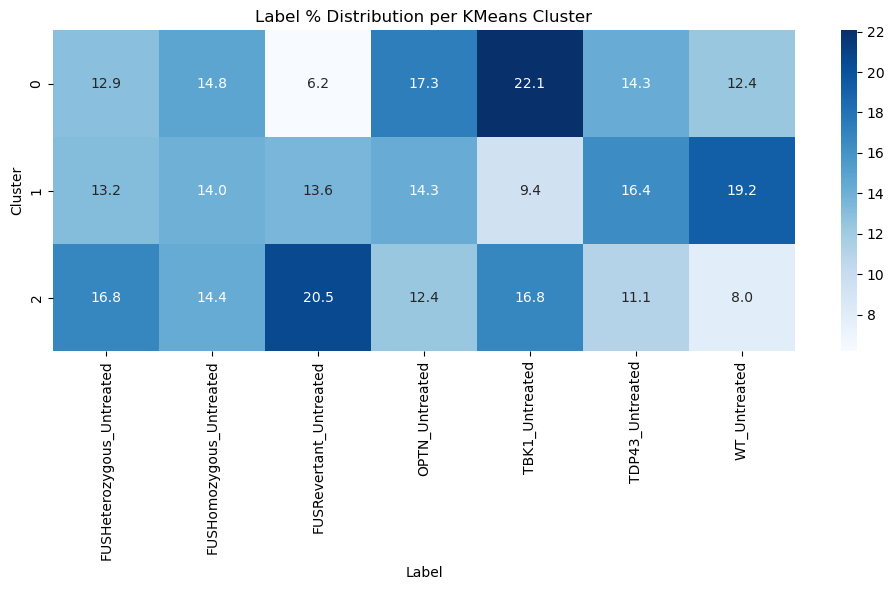

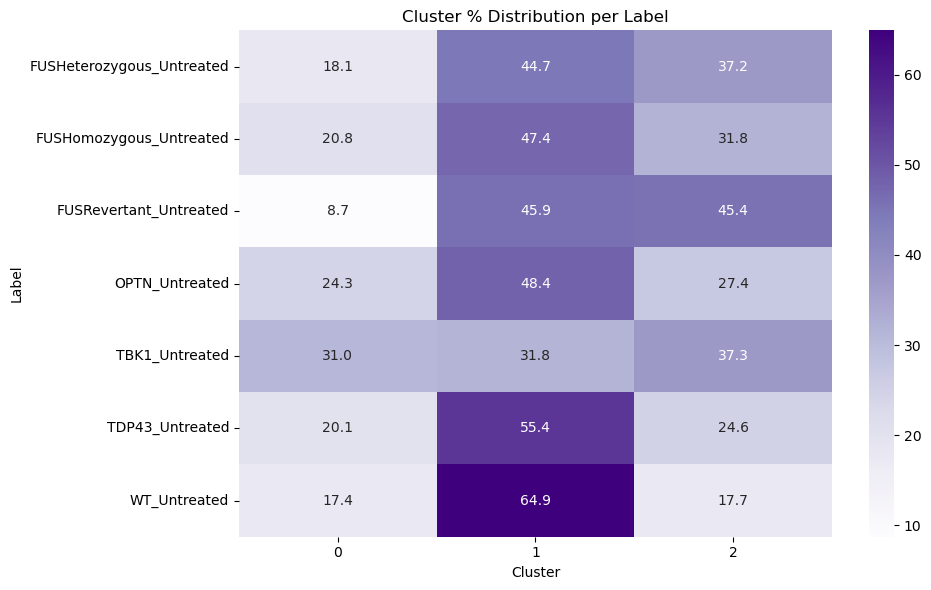

Running: PCA=False, Normalize=False, Balance=True, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


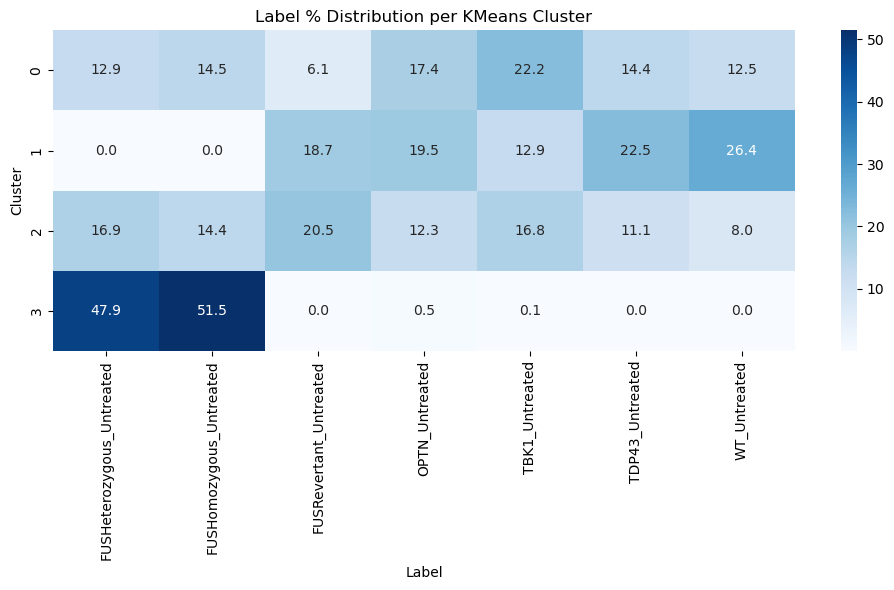

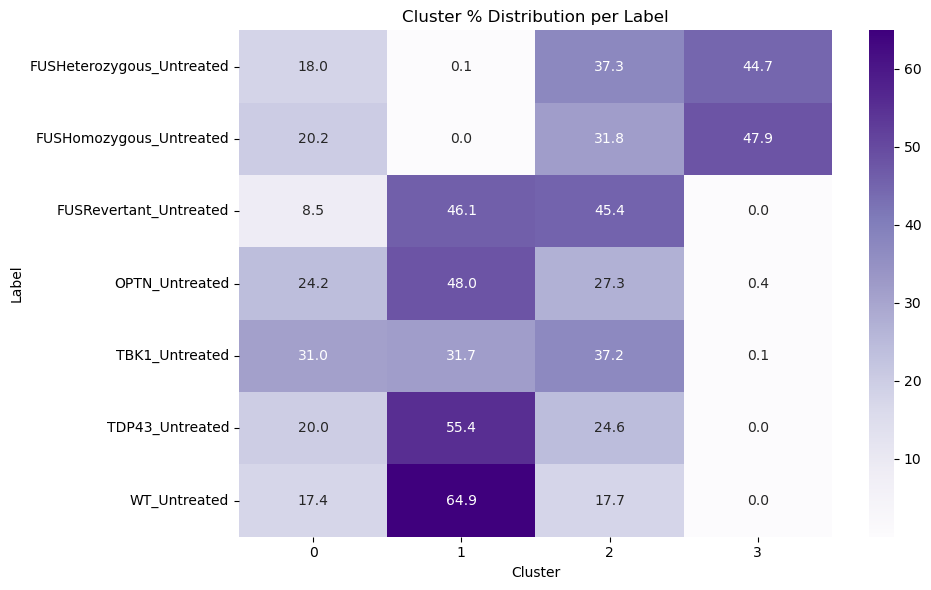

Running: PCA=False, Normalize=False, Balance=True, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


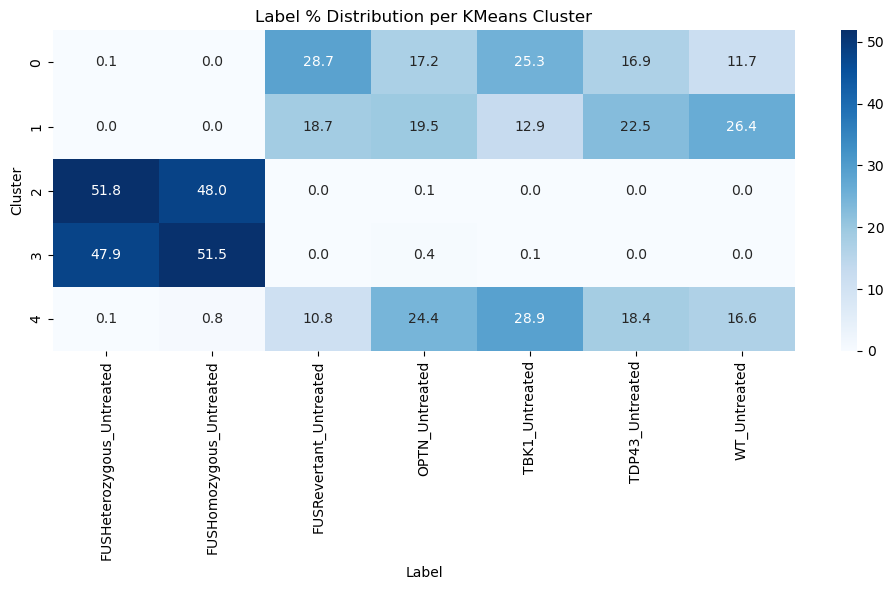

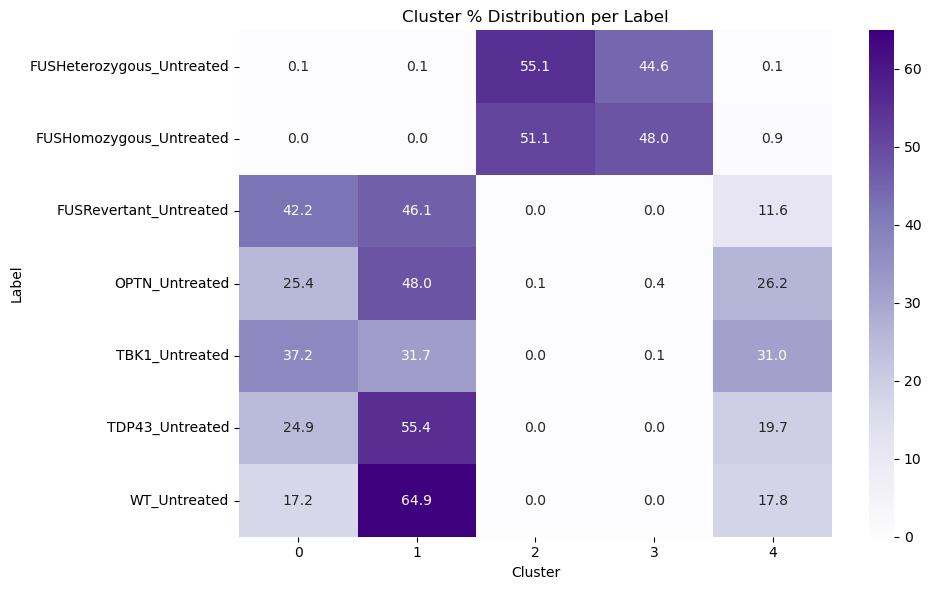

Running: PCA=False, Normalize=False, Balance=True, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


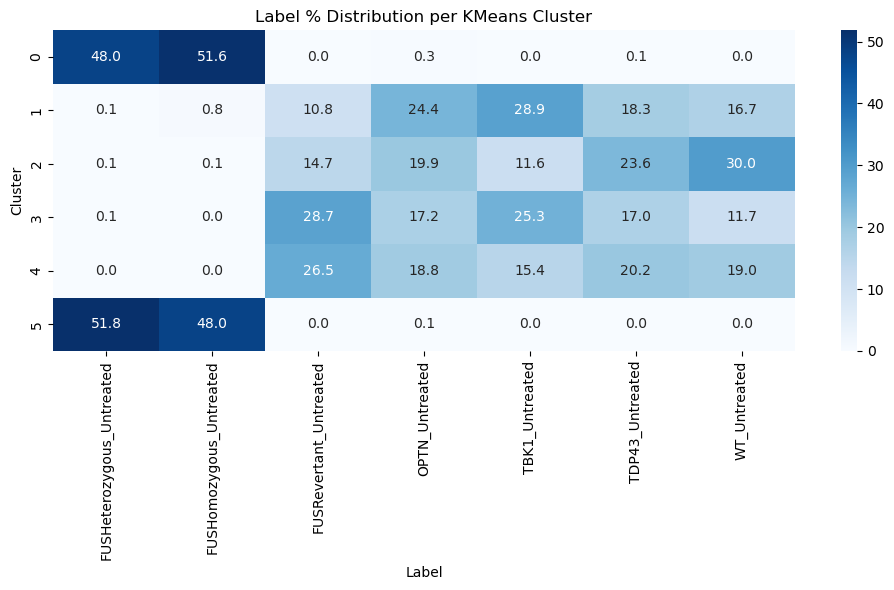

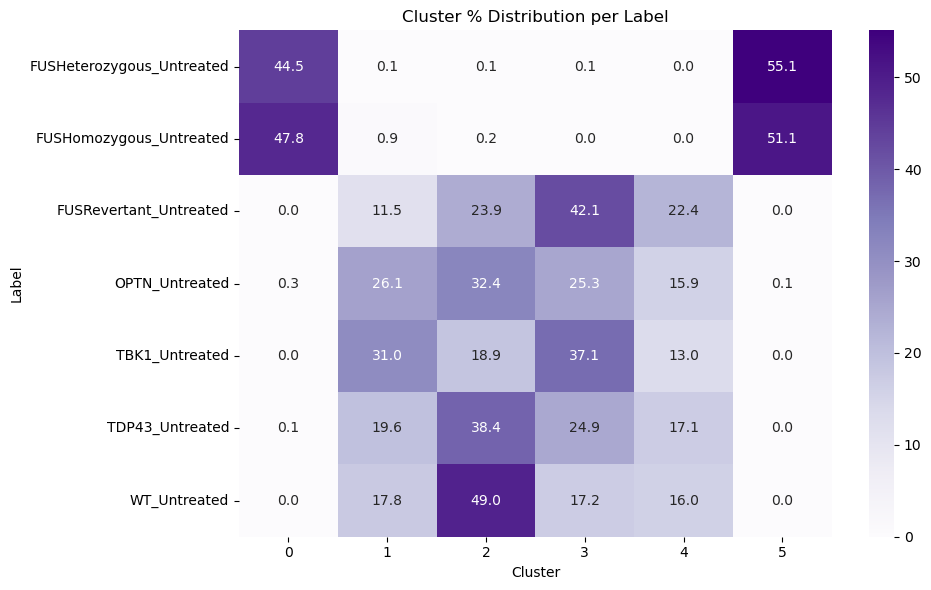

Running: PCA=False, Normalize=False, Balance=True, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


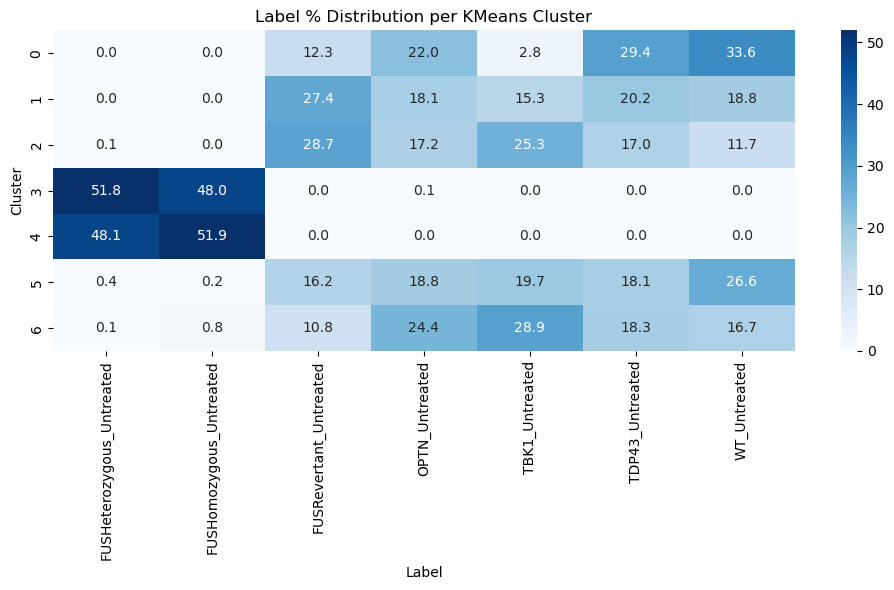

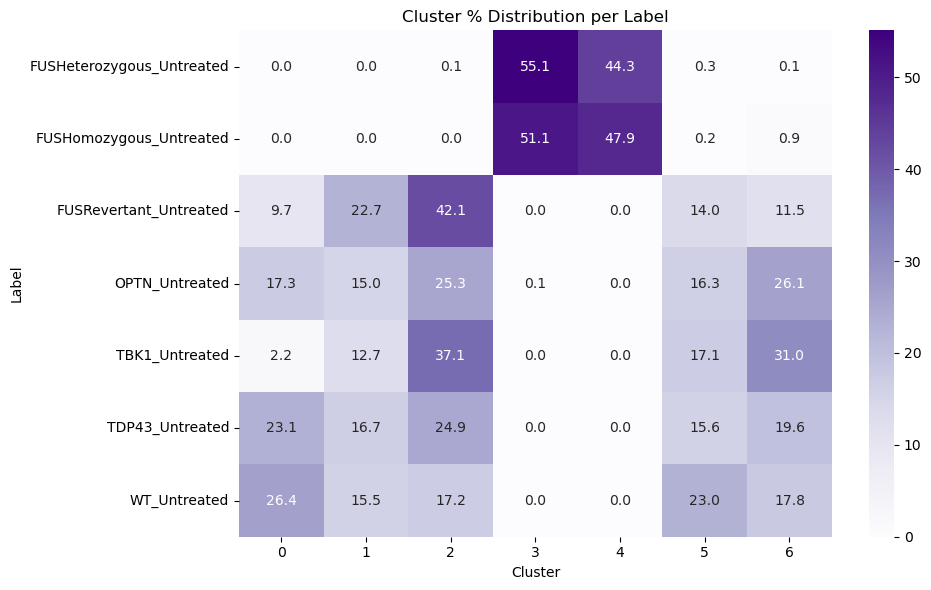

Running: PCA=False, Normalize=False, Balance=False, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


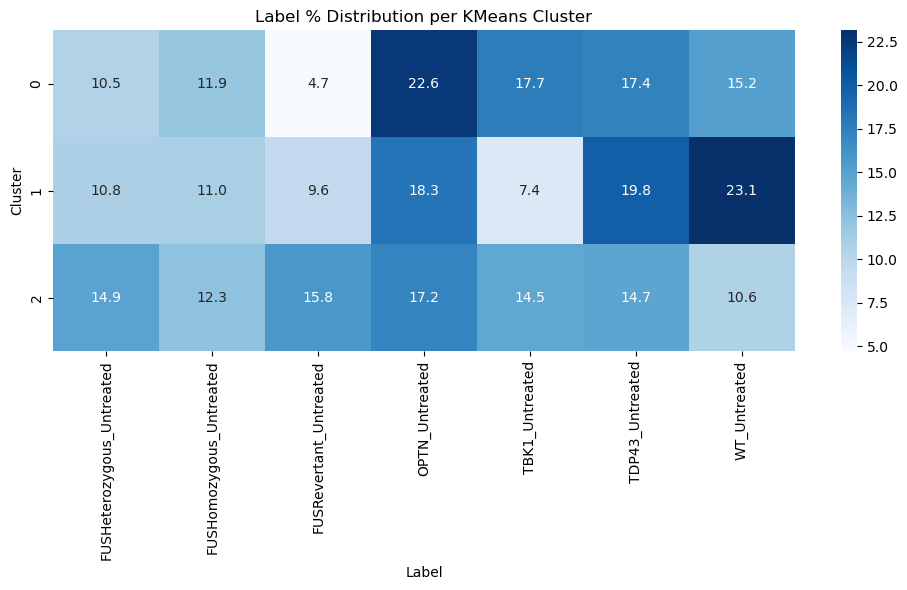

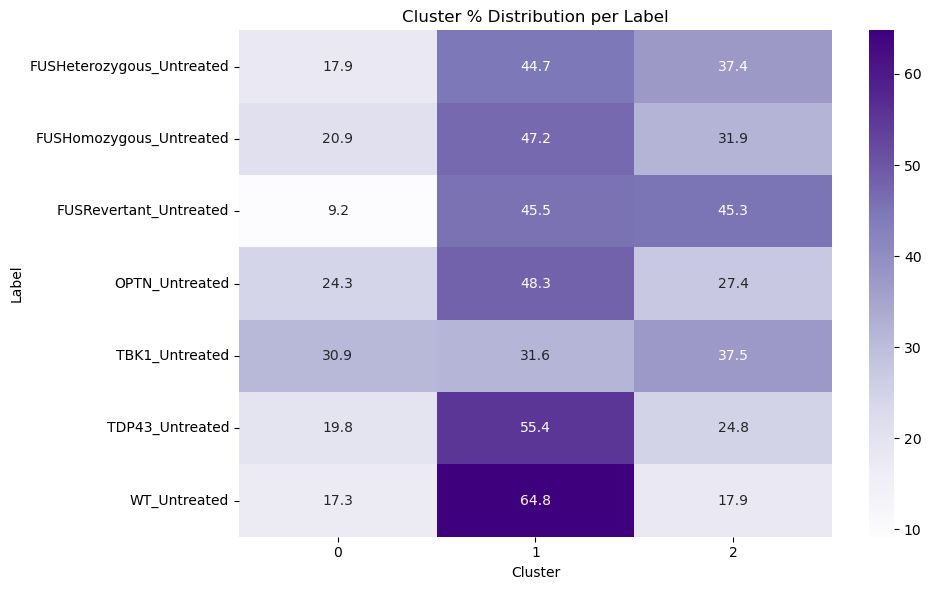

Running: PCA=False, Normalize=False, Balance=False, Clusters=4


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


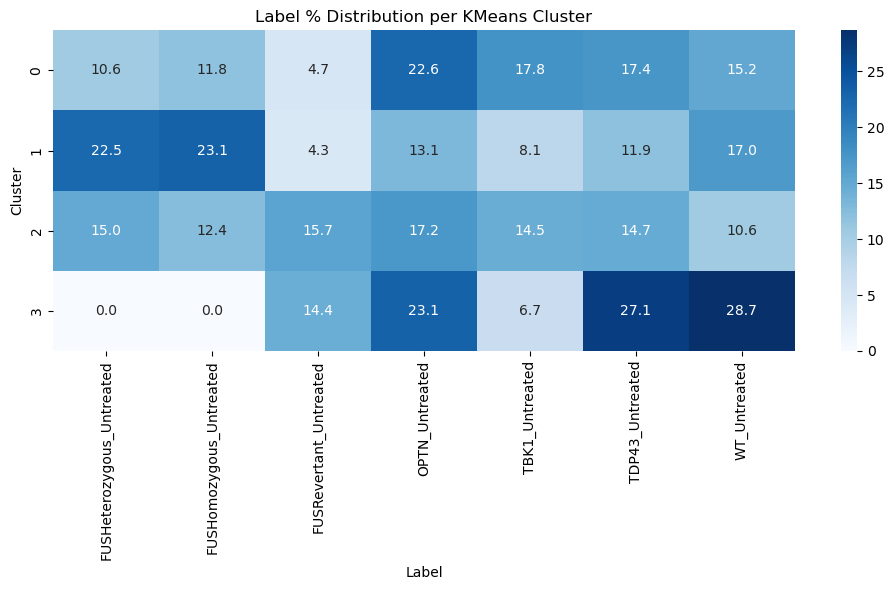

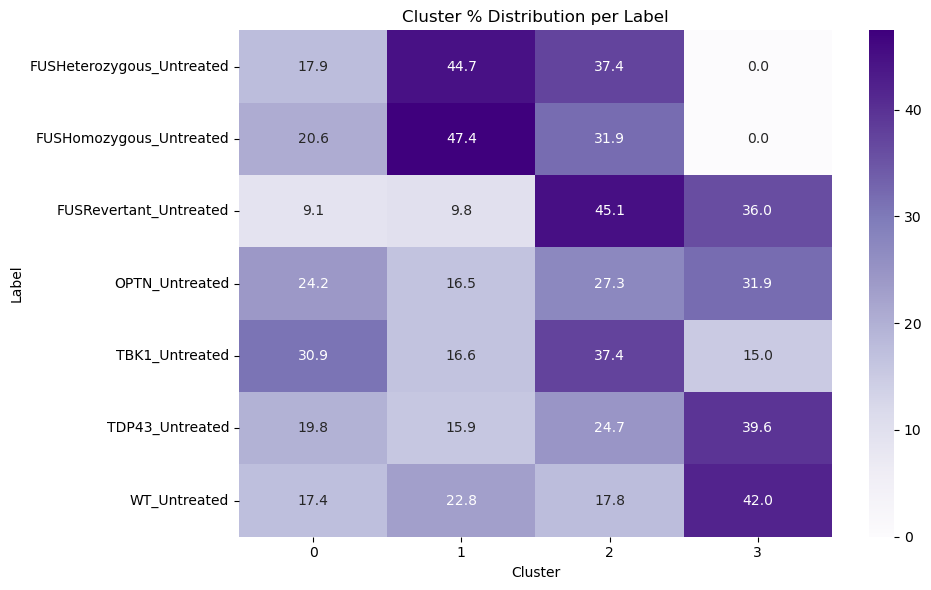

Running: PCA=False, Normalize=False, Balance=False, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


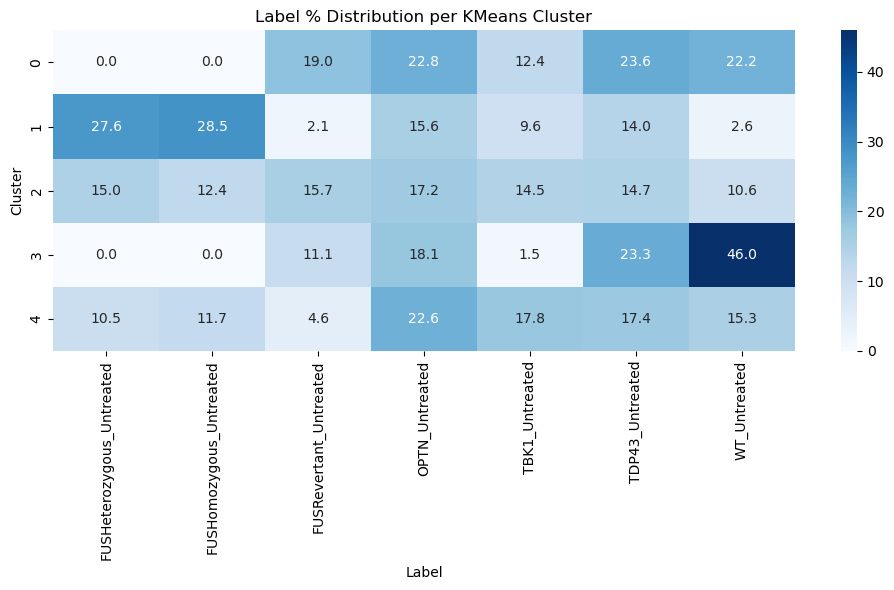

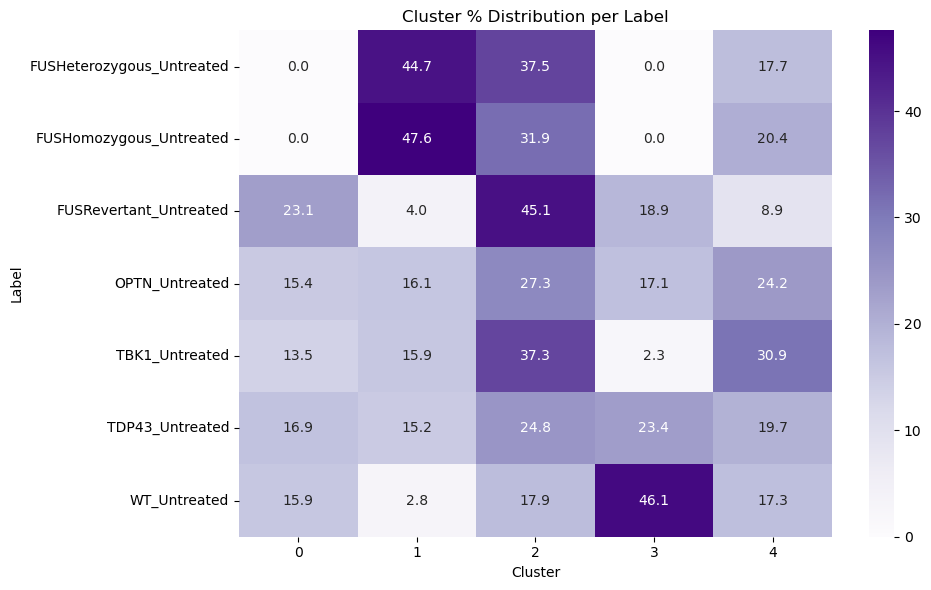

Running: PCA=False, Normalize=False, Balance=False, Clusters=6


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


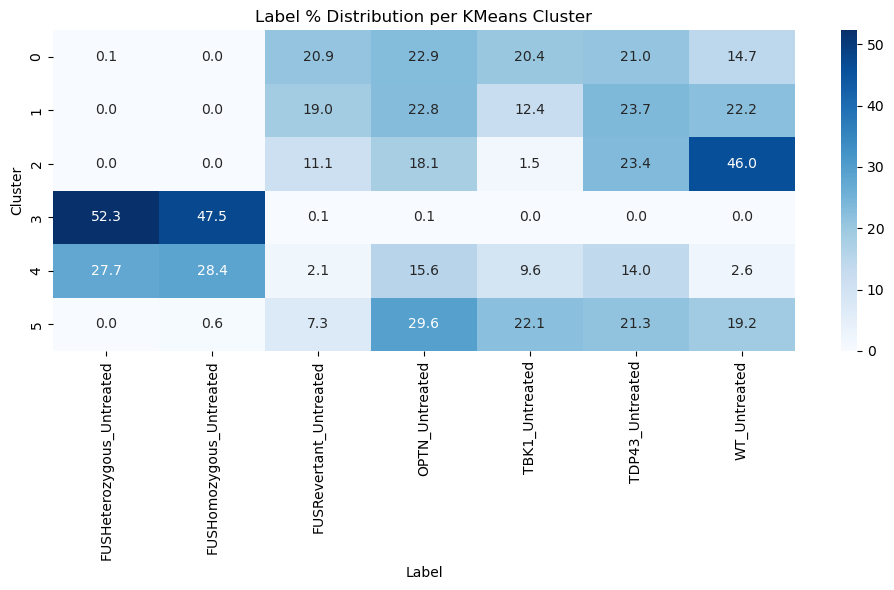

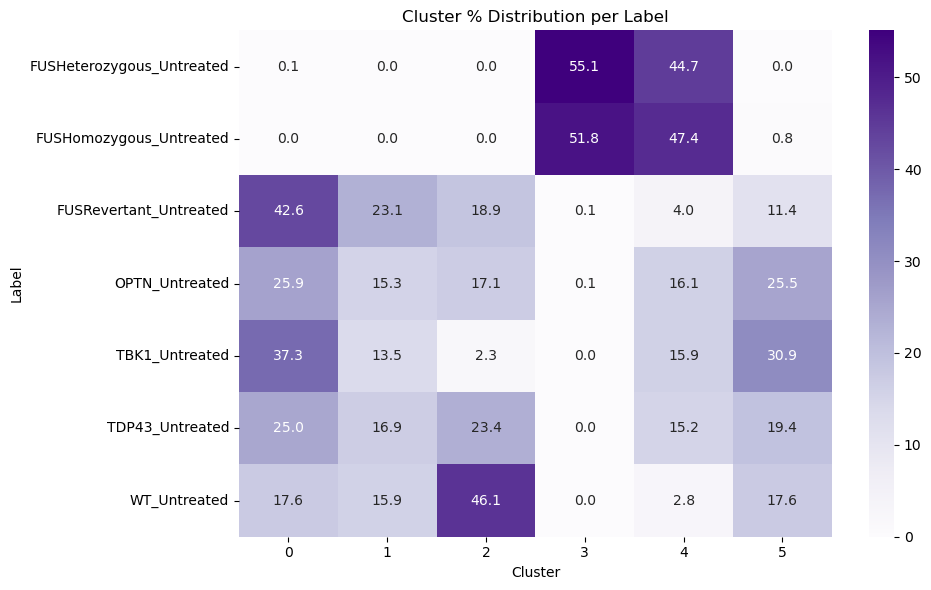

Running: PCA=False, Normalize=False, Balance=False, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


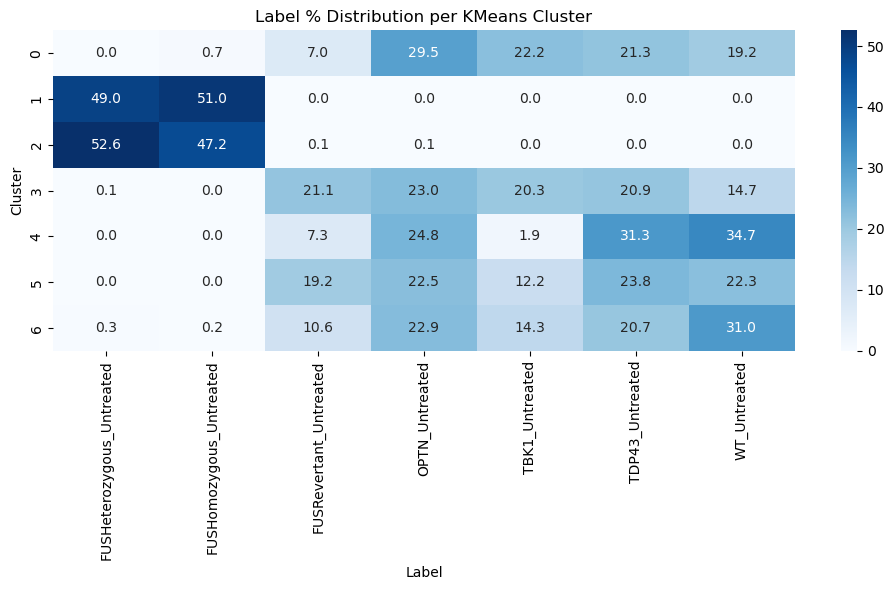

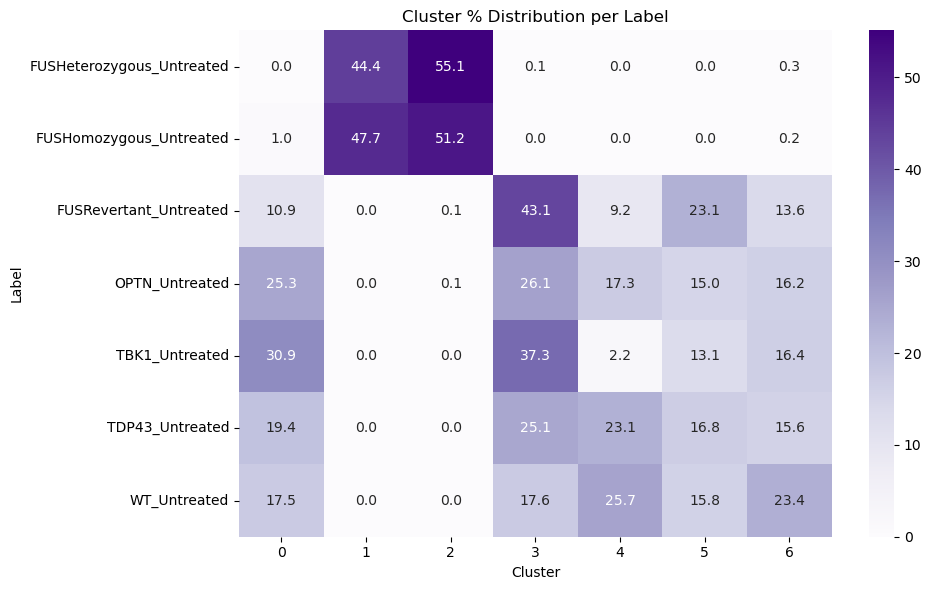

In [75]:
results_df = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True, False],
    norm_options=[True, False],
    balance_options=[True, False],
    cluster_range=[3, 4, 5, 6, 7]
)

      pca  normalize  balance  n_clusters  cluster_purity  label_consistency
32  False      False     True           5        0.374702           0.511131
12   True      False     True           5        0.375188           0.510042
20  False       True     True           3        0.214636           0.497562
25  False       True    False           3        0.209686           0.497163
0    True       True     True           3        0.214009           0.497112
5    True       True    False           3        0.209590           0.496829
11   True      False     True           4        0.301642           0.492018
31  False      False     True           4        0.301362           0.491844
30  False      False     True           3        0.205938           0.491293
10   True      False     True           3        0.206210           0.491177
15   True      False    False           3        0.209858           0.490577
35  False      False    False           3        0.209689           0.490530

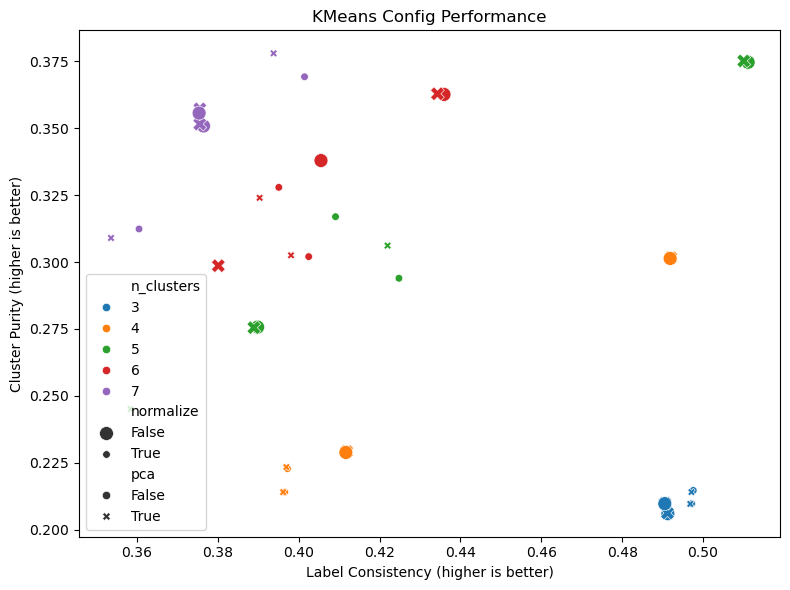

In [83]:
# Show best combinations sorted by label consistency and cluster purity
results_df.sort_values(['label_consistency',], ascending=False, inplace=True)
print(results_df)

plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=results_df,
    x='label_consistency',
    y='cluster_purity',
    hue='n_clusters',
    style='pca',
    size='normalize',
    sizes=(30, 100),
    palette='tab10'
)
plt.title("KMeans Config Performance")
plt.xlabel("Label Consistency (higher is better)")
plt.ylabel("Cluster Purity (higher is better)")
plt.tight_layout()
plt.show()

In [84]:
def summarize_best_conditions(results_df, score_col='score'):
    from collections import defaultdict

    # Define all parameter combinations to test
    params = ['pca', 'normalize', 'balance', 'n_clusters']
    insights = defaultdict(list)

    # For each parameter, test whether its value affects the score when all other parameters are equal
    for target_param in params:
        others = [p for p in params if p != target_param]
        grouped = results_df.groupby(others)

        for cond, group_df in grouped:
            # For this condition, test if one value of target_param is consistently better
            best_row = group_df.loc[group_df[score_col].idxmax()]
            best_value = best_row[target_param]

            unique_values = group_df[target_param].unique()
            if len(unique_values) == 1:
                # Only one value present—no conclusion
                continue

            # Check if best value is significantly better
            best_score = best_row[score_col]
            others_scores = group_df[group_df[target_param] != best_value][score_col].values

            tolerance = 0.01  # allow 1% margin
            if all(best_score >= s - tolerance for s in others_scores):

                insights[target_param].append((cond, best_value))

    # Summarize results
    for param in params:
        entries = insights[param]
        if entries:
            print(f"\n📊 For parameter '{param}', these conditions consistently favored one value:")
            for cond, best_val in entries:
                cond_str = ', '.join(f"{k}={v}" for k, v in zip([p for p in params if p != param], cond))
                print(f"  - Condition: {cond_str} → best {param} = {best_val}")
        else:
            print(f"\n⚠️ No consistent preference found for parameter '{param}'")

In [85]:
summarize_best_conditions(results_df, 'label_consistency')


📊 For parameter 'pca', these conditions consistently favored one value:
  - Condition: normalize=False, balance=False, n_clusters=3 → best pca = True
  - Condition: normalize=False, balance=False, n_clusters=4 → best pca = True
  - Condition: normalize=False, balance=False, n_clusters=5 → best pca = False
  - Condition: normalize=False, balance=False, n_clusters=6 → best pca = False
  - Condition: normalize=False, balance=False, n_clusters=7 → best pca = False
  - Condition: normalize=False, balance=True, n_clusters=3 → best pca = False
  - Condition: normalize=False, balance=True, n_clusters=4 → best pca = True
  - Condition: normalize=False, balance=True, n_clusters=5 → best pca = False
  - Condition: normalize=False, balance=True, n_clusters=6 → best pca = False
  - Condition: normalize=False, balance=True, n_clusters=7 → best pca = True
  - Condition: normalize=True, balance=False, n_clusters=3 → best pca = False
  - Condition: normalize=True, balance=False, n_clusters=4 → best pc

In [88]:
def KMeans_cluster_normL2(
    batches,
    n_clusters=5,
    normalize=False,
    balance=False,
    apply_pca=False,
    pca_components=50
):
    # Load data
    X_all, y_all = load_batches(batches)
    y_all = np.array(y_all)
    
    # Optional: Normalize
    if normalize:
        # L2 normalize each sample
        X_all /= np.linalg.norm(X_all, axis=1, keepdims=True)

    # Optional: Balance dataset
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_all, y_all = ros.fit_resample(X_all, y_all)

    # Optional: PCA
    if apply_pca:
        X_all = PCA(n_components=pca_components, random_state=42).fit_transform(X_all)

    # KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    clusters = kmeans.fit_predict(X_all)

    # Build DataFrame
    df = pd.DataFrame({'cluster': clusters, 'label': y_all})

    # Cluster → Label distribution
    cluster_summary = df.groupby('cluster')['label'].value_counts(normalize=True).unstack().fillna(0) * 100
    plt.figure(figsize=(10, 6))
    sns.heatmap(cluster_summary, annot=True, fmt=".1f", cmap='Blues')
    plt.title("Label % Distribution per KMeans Cluster")
    plt.ylabel("Cluster")
    plt.xlabel("Label")
    plt.tight_layout()
    plt.show()

    # Label → Cluster distribution
    label_summary = df.groupby('label')['cluster'].value_counts(normalize=True).unstack().fillna(0) * 100
    plt.figure(figsize=(10, 6))
    sns.heatmap(label_summary, annot=True, fmt=".1f", cmap='Purples')
    plt.title("Cluster % Distribution per Label")
    plt.xlabel("Cluster")
    plt.ylabel("Label")
    plt.tight_layout()
    plt.show()

    return df, cluster_summary, label_summary

def run_kmeans_eval_normL2(batches, pca_options, norm_options, balance_options, cluster_range):
    results = []

    for pca_flag, norm_flag, balance_flag, n_clusters in product(pca_options, norm_options, balance_options, cluster_range):
        print(f"Running: PCA={pca_flag}, Normalize={norm_flag}, Balance={balance_flag}, Clusters={n_clusters}")
        df, _, _ = KMeans_cluster_normL2(
            batches=batches,
            n_clusters=n_clusters,
            normalize=norm_flag,
            balance=balance_flag,
            apply_pca=pca_flag,
        )

        # Cluster purity: each cluster dominated by 1 label
        cluster_purity = (
            df.groupby('cluster')['label'].value_counts(normalize=True)
            .groupby(level=0).max().mean()
        )

        # Label consistency: each label mostly in one cluster
        label_consistency = (
            df.groupby('label')['cluster'].value_counts(normalize=True)
            .groupby(level=0).max().mean()
        )

        results.append({
            'pca': pca_flag,
            'normalize': norm_flag,
            'balance': balance_flag,
            'n_clusters': n_clusters,
            'cluster_purity': cluster_purity,
            'label_consistency': label_consistency
        })

    return pd.DataFrame(results)

Running: PCA=True, Normalize=True, Balance=True, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


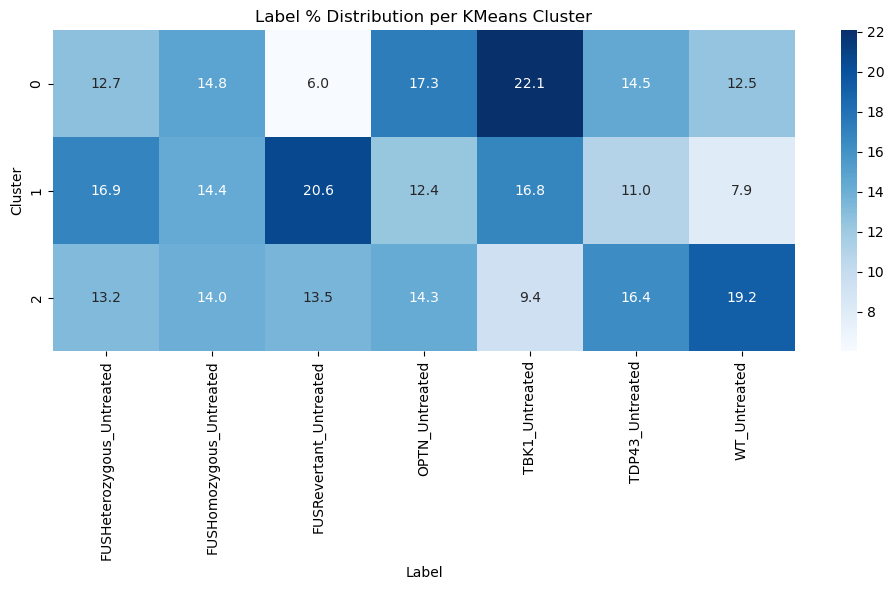

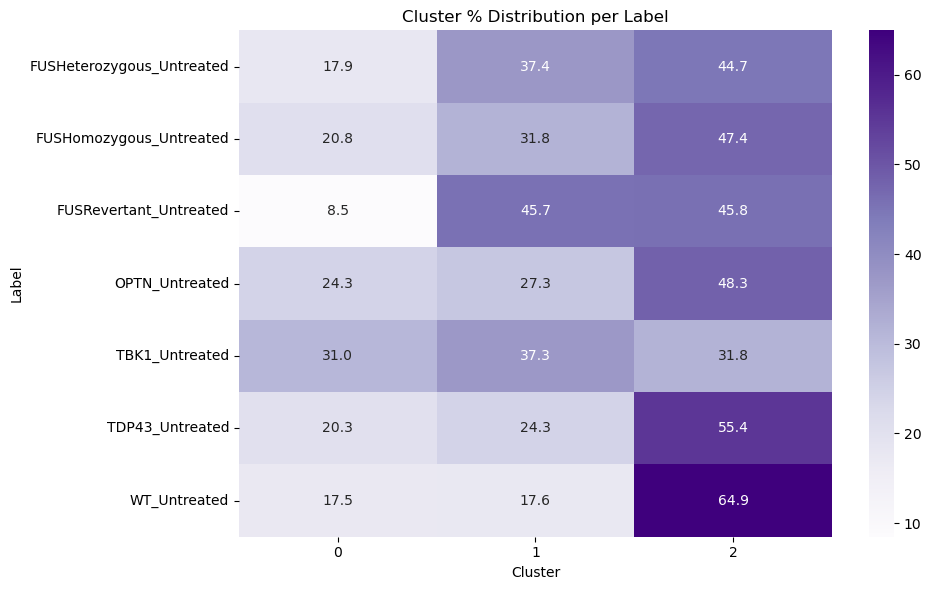

Running: PCA=True, Normalize=True, Balance=True, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


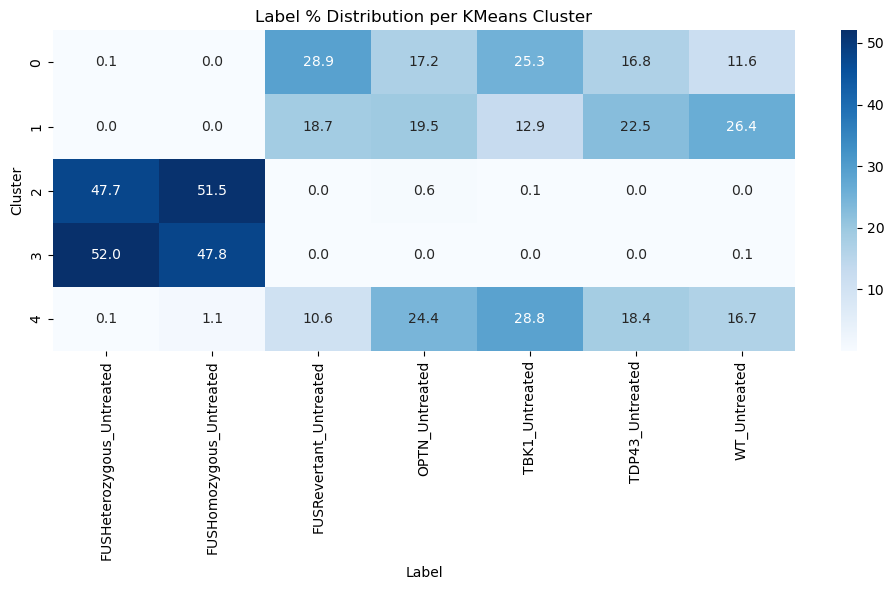

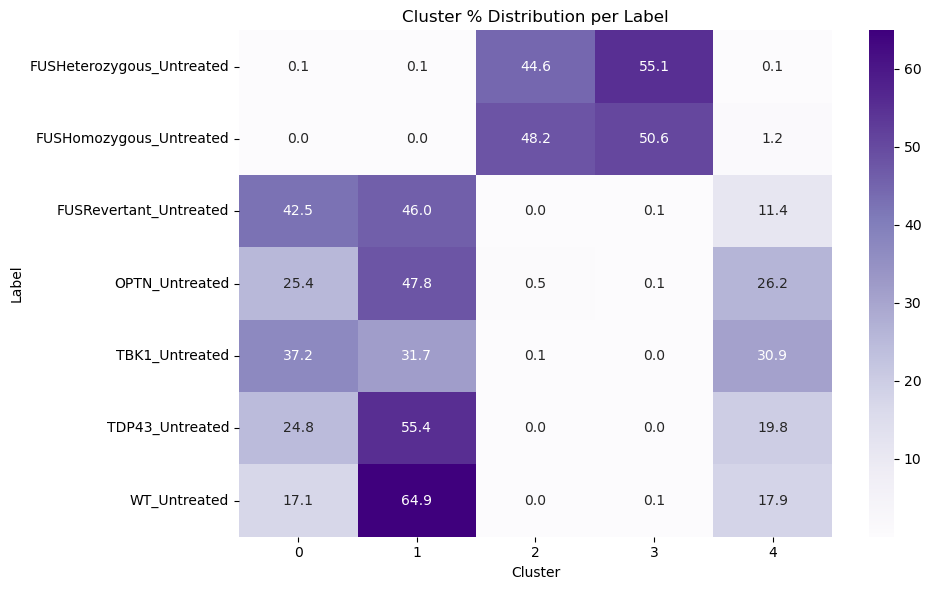

Running: PCA=True, Normalize=True, Balance=True, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


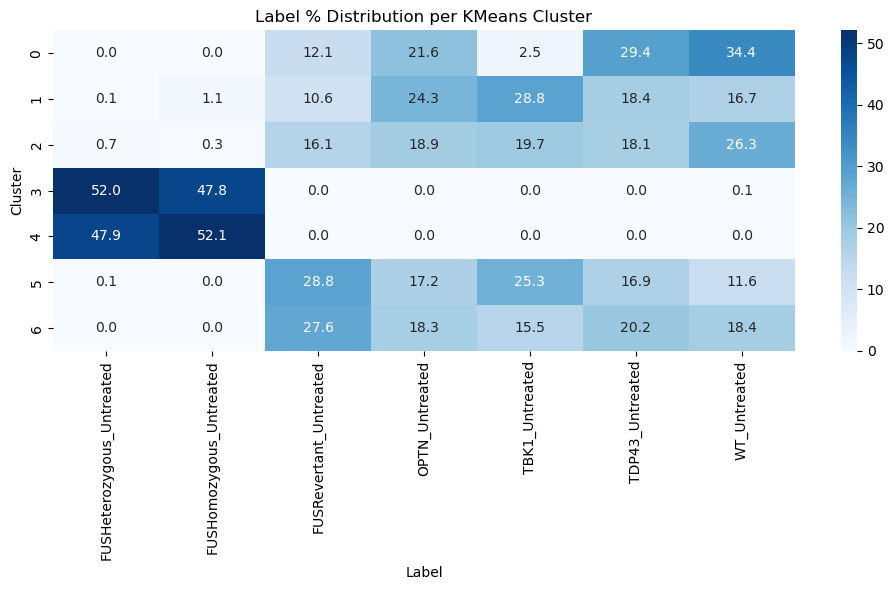

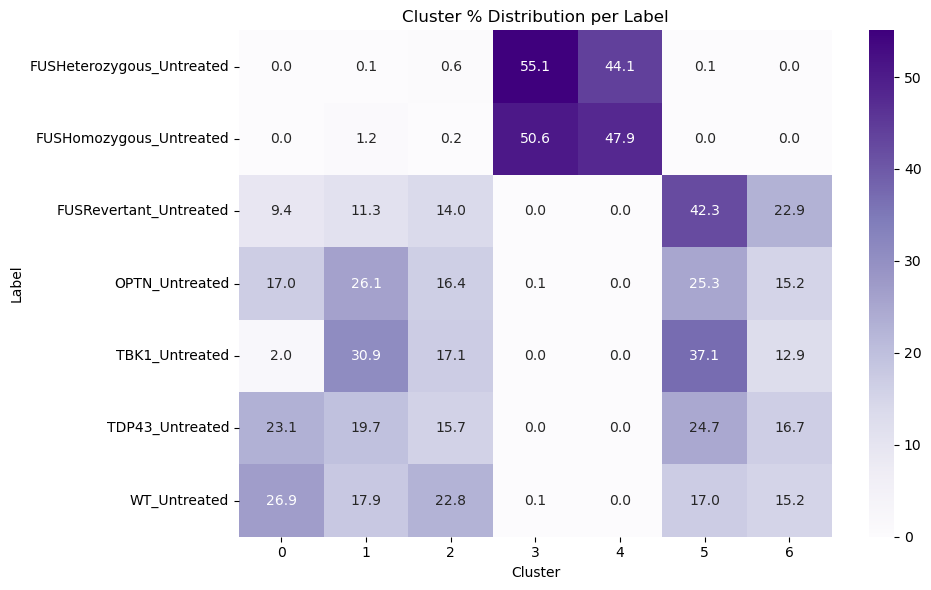

Running: PCA=False, Normalize=True, Balance=True, Clusters=3


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


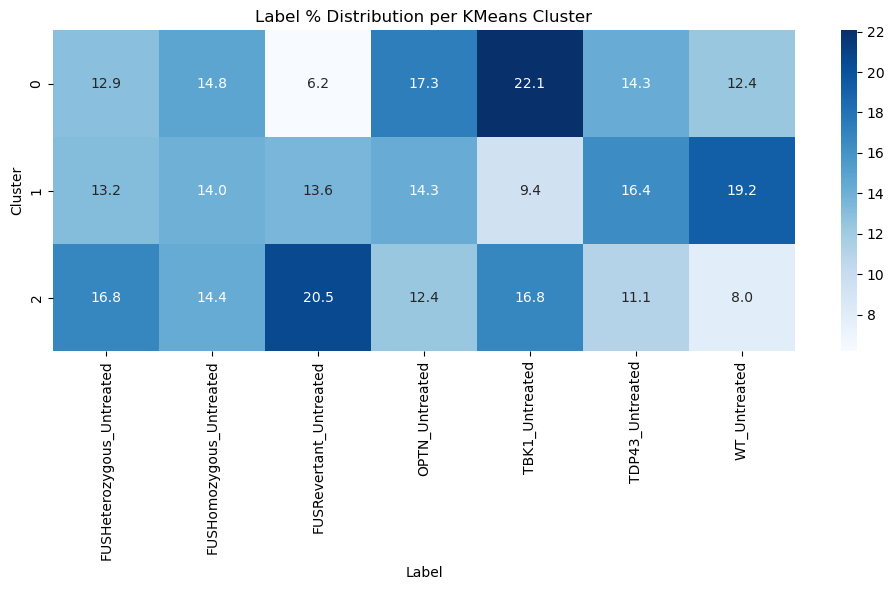

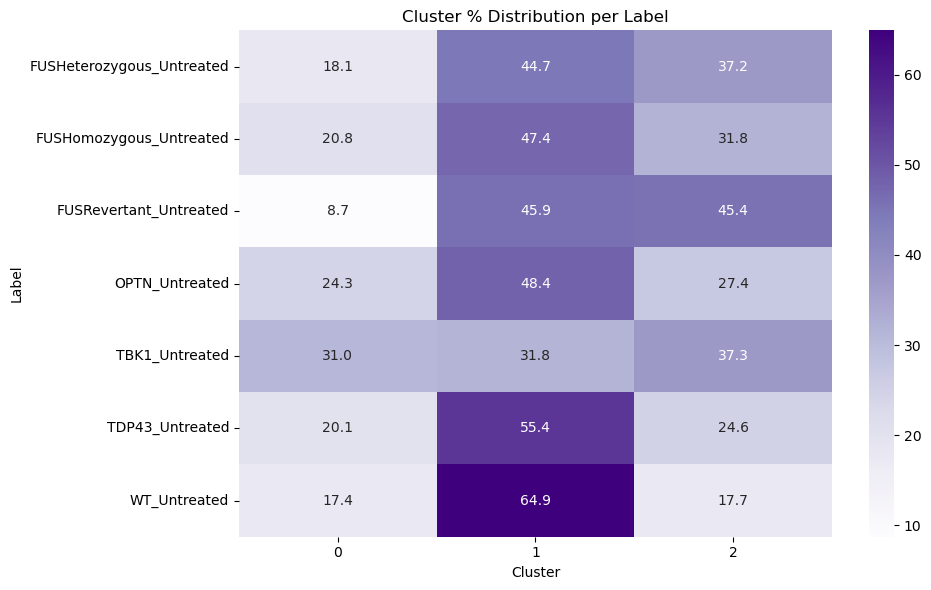

Running: PCA=False, Normalize=True, Balance=True, Clusters=5


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


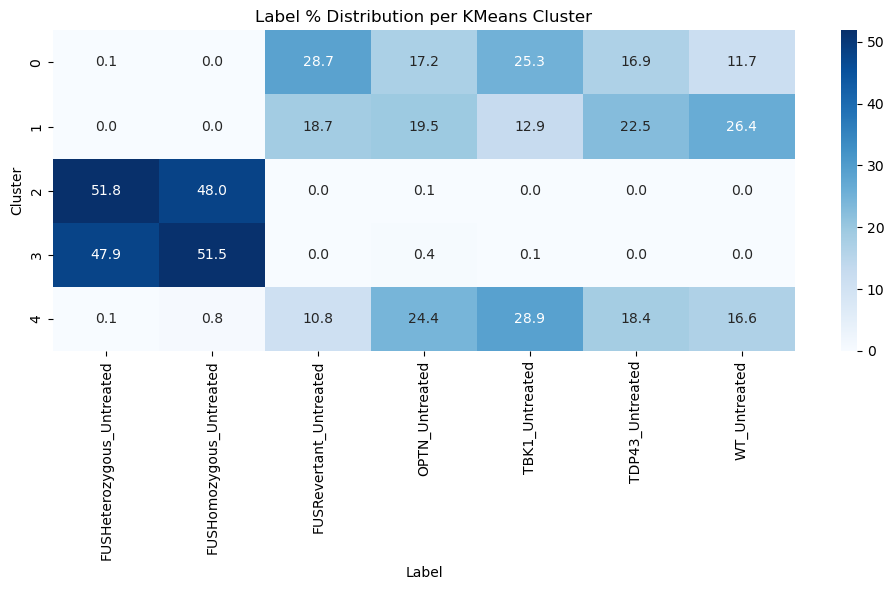

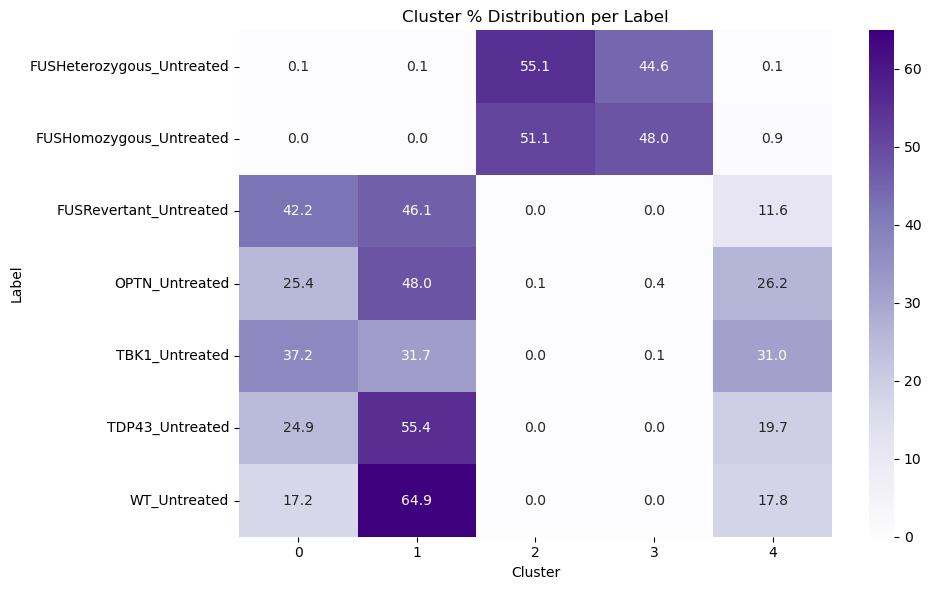

Running: PCA=False, Normalize=True, Balance=True, Clusters=7


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


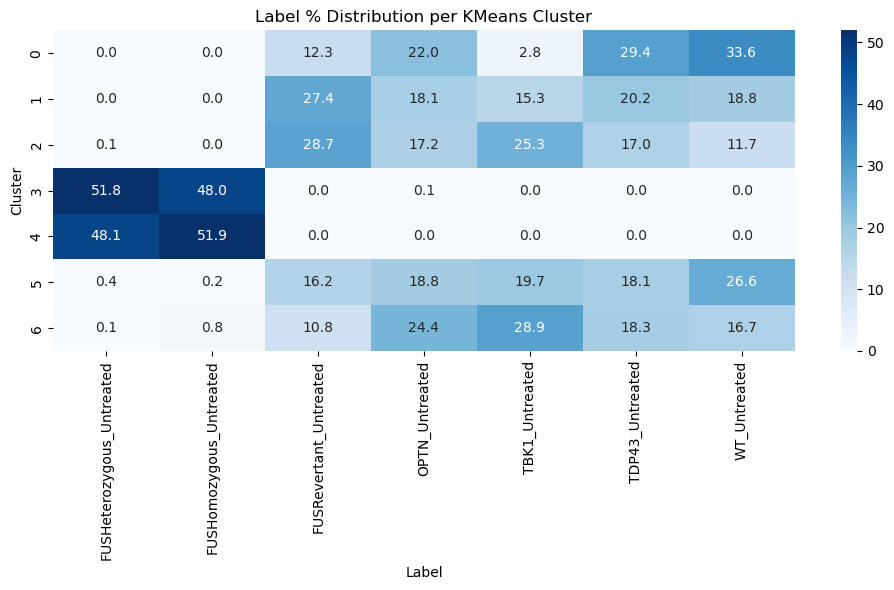

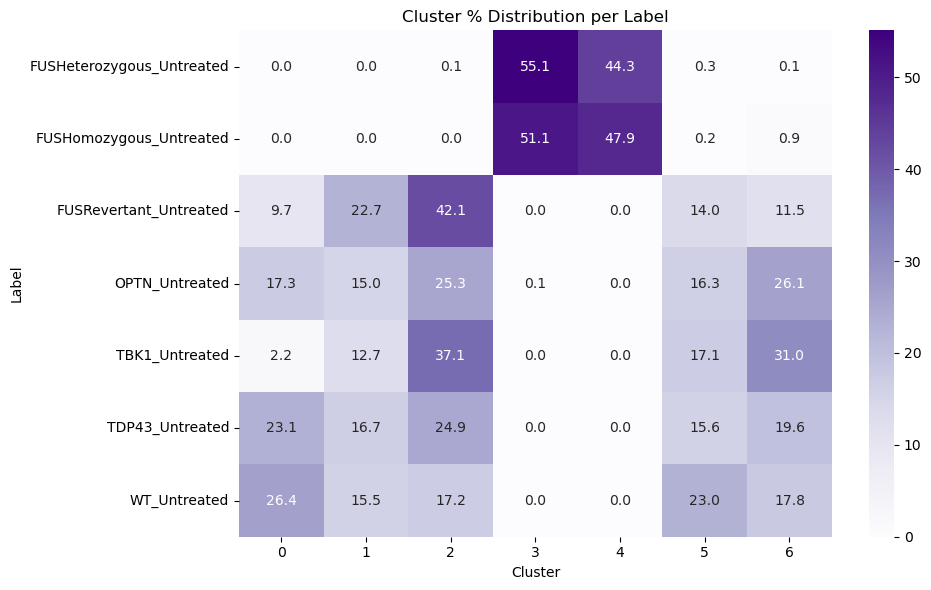

In [89]:
results_df_normL2 = run_kmeans_eval_normL2(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True, False],
    norm_options=[True],
    balance_options=[True],
    cluster_range=[3, 5, 7]
)

In [91]:
results_df_normL2.sort_values(['label_consistency',], ascending=False, inplace=True)
print(results_df_normL2)

     pca  normalize  balance  n_clusters  cluster_purity  label_consistency
4  False       True     True           5        0.374702           0.511131
1   True       True     True           5        0.375188           0.510042
3  False       True     True           3        0.205938           0.491293
0   True       True     True           3        0.206332           0.491191
2   True       True     True           7        0.357176           0.375501
5  False       True     True           7        0.355707           0.375399


In [92]:
## l2norm doesnt matter a lot

Running: PCA=True, Normalize=True, Balance=True, Clusters=10


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


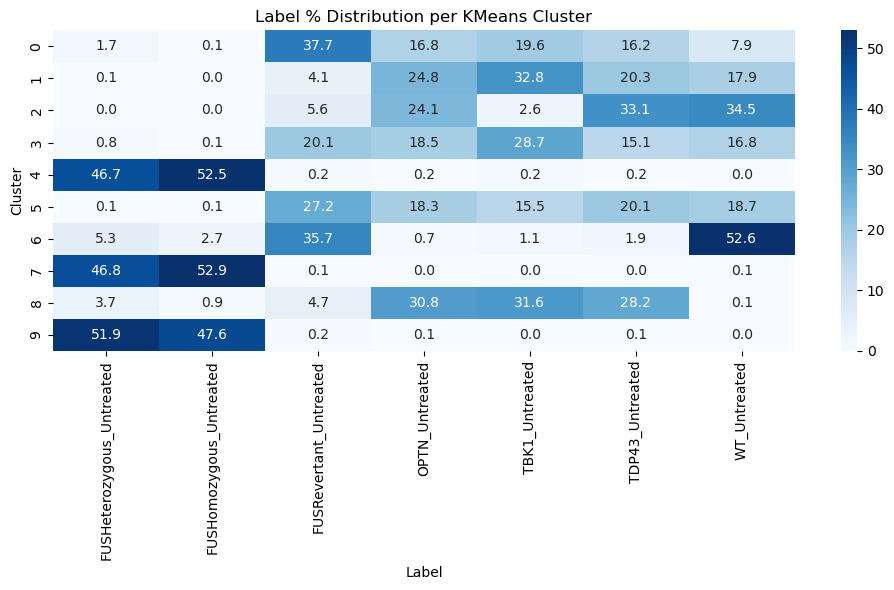

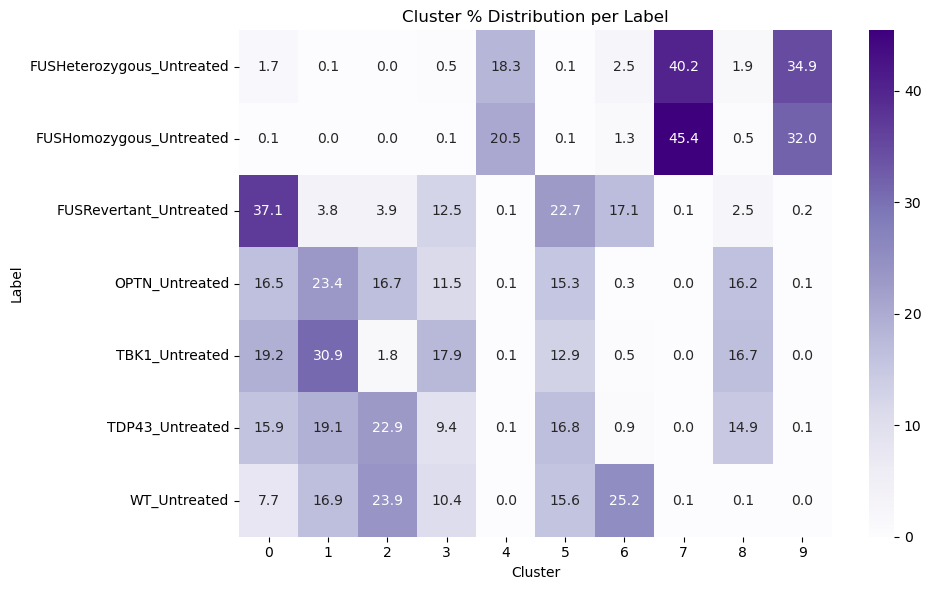

Running: PCA=True, Normalize=True, Balance=True, Clusters=15


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


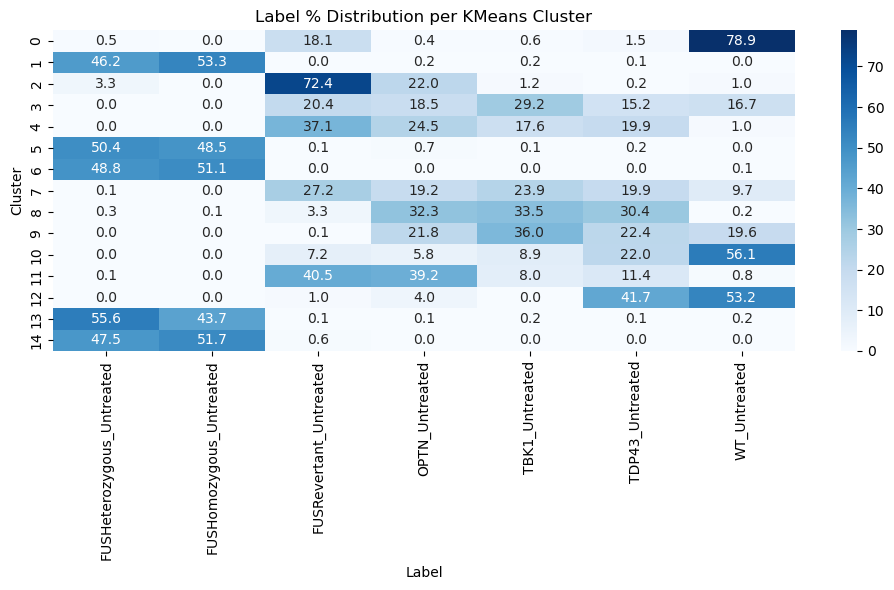

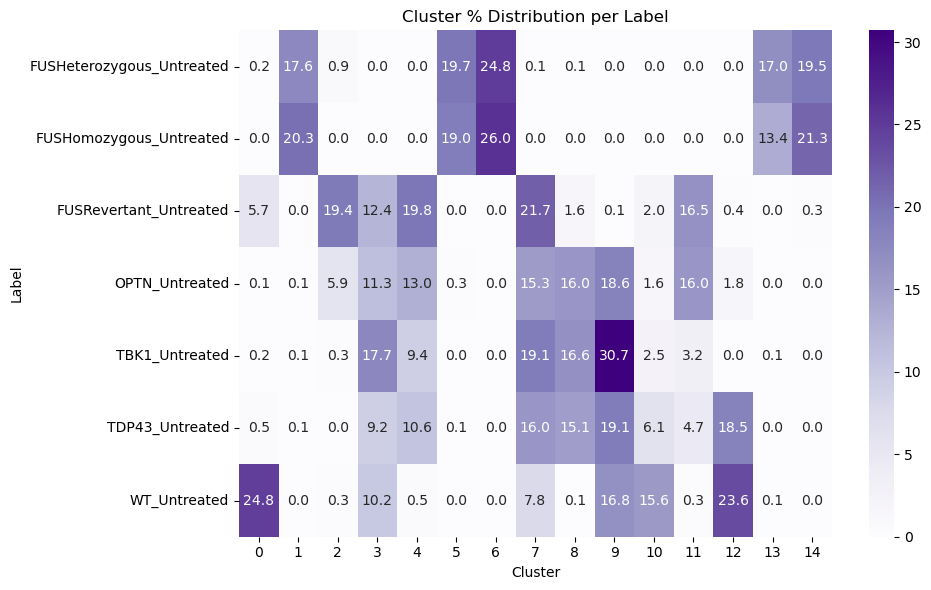

Running: PCA=True, Normalize=True, Balance=True, Clusters=20


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


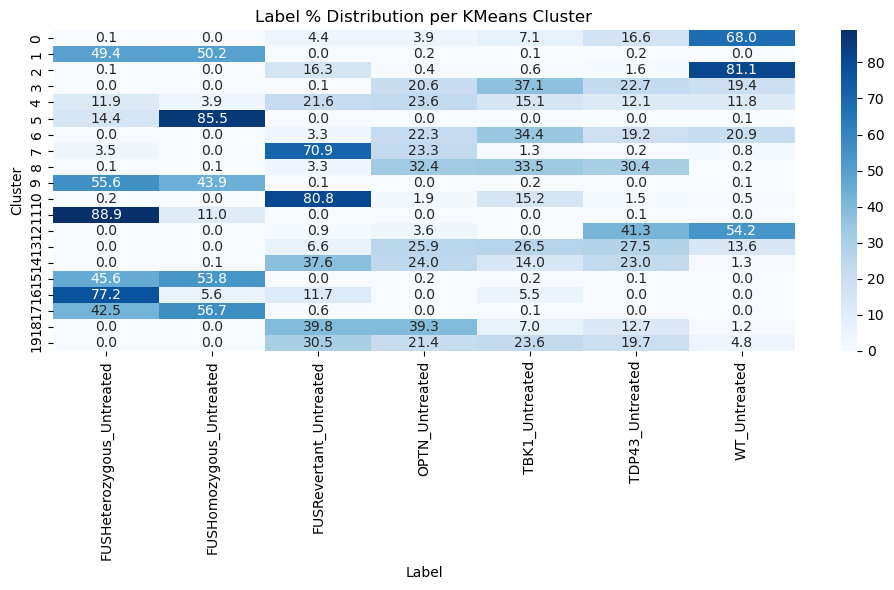

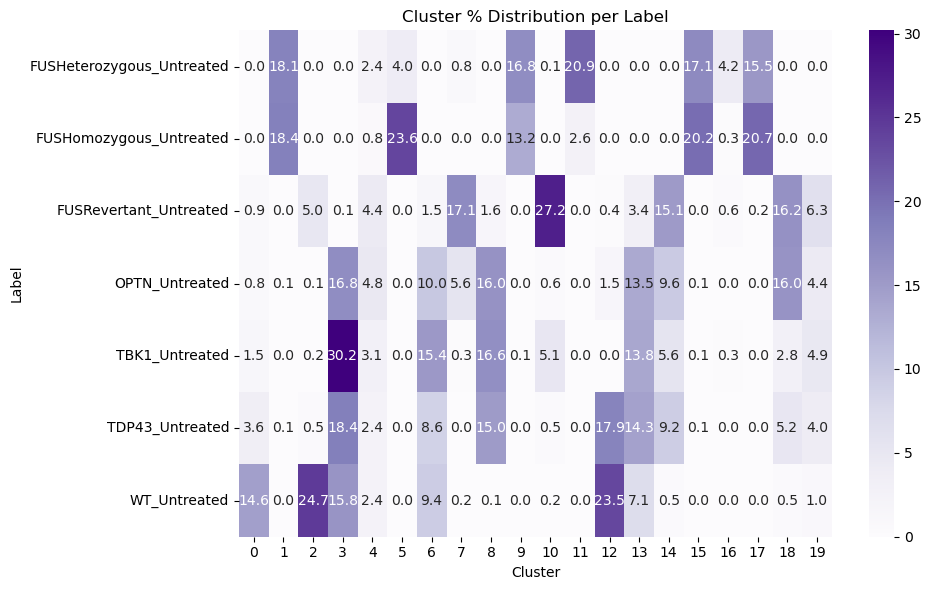

Running: PCA=True, Normalize=False, Balance=True, Clusters=10


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


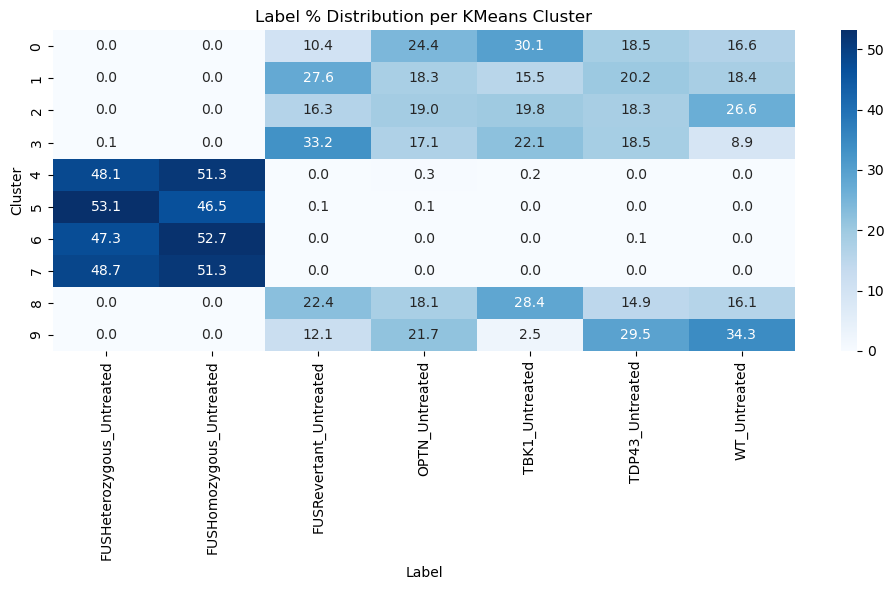

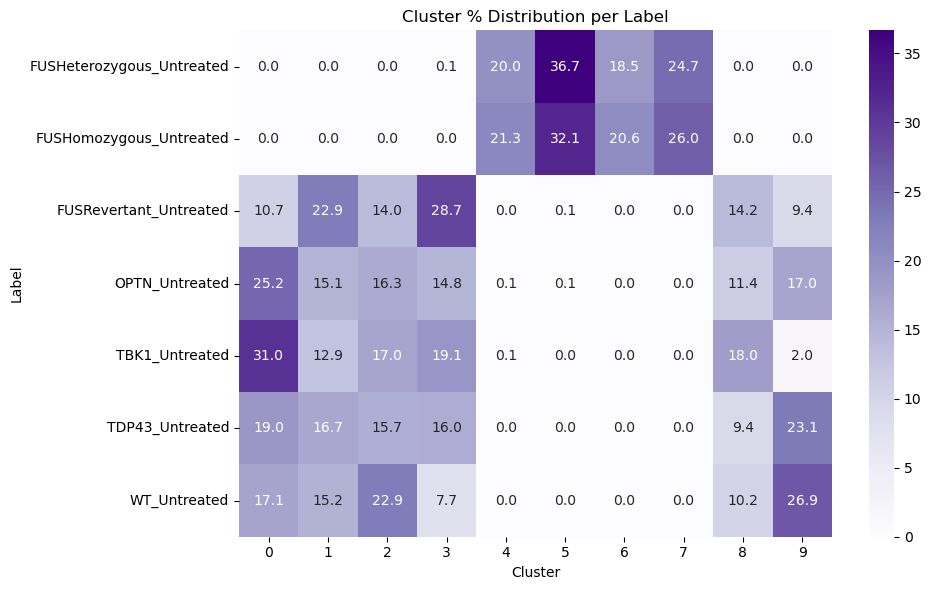

Running: PCA=True, Normalize=False, Balance=True, Clusters=15


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


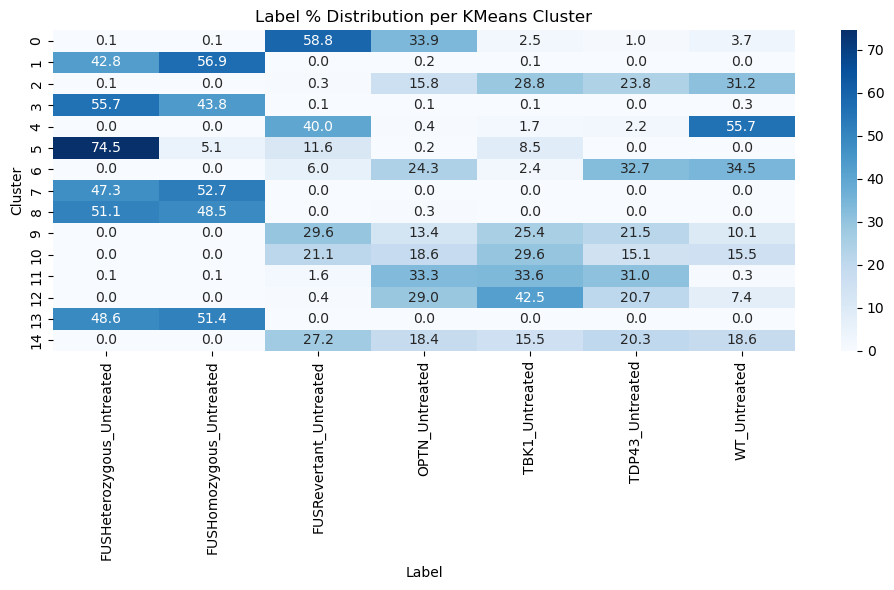

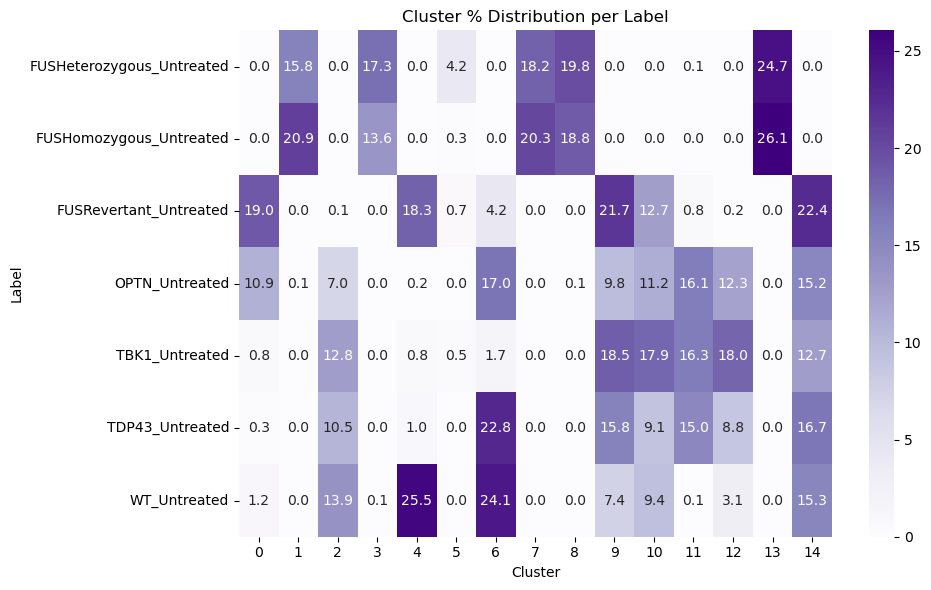

Running: PCA=True, Normalize=False, Balance=True, Clusters=20


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


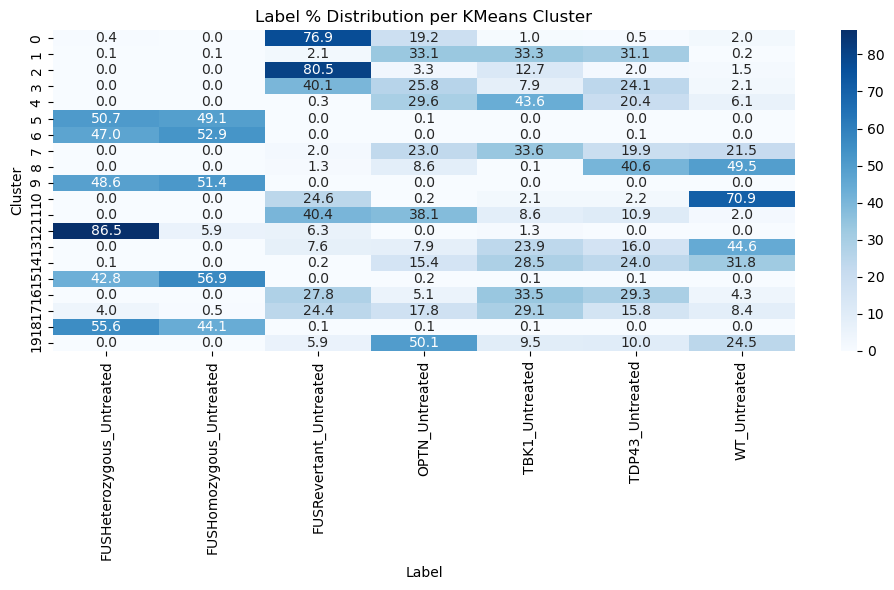

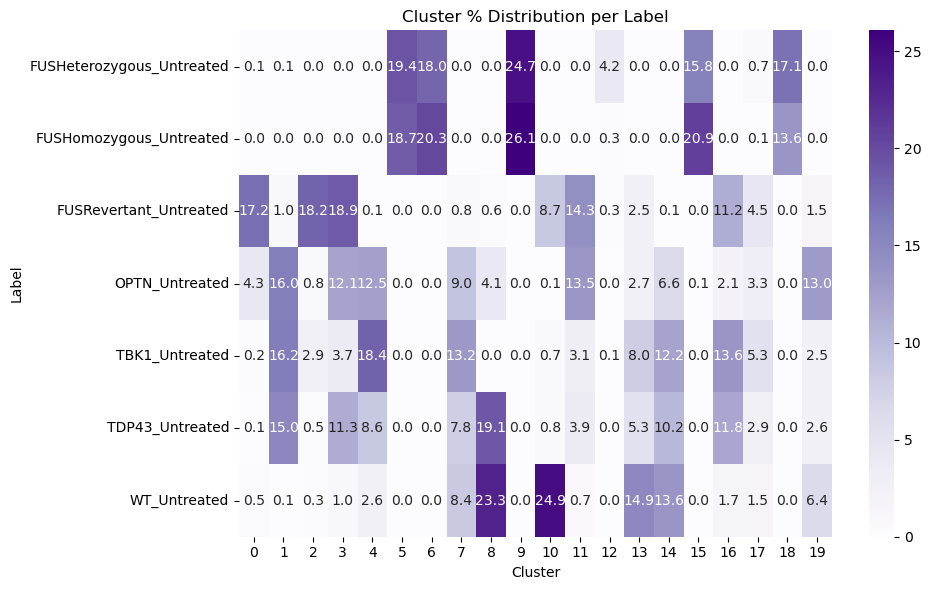

Running: PCA=False, Normalize=True, Balance=True, Clusters=10


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


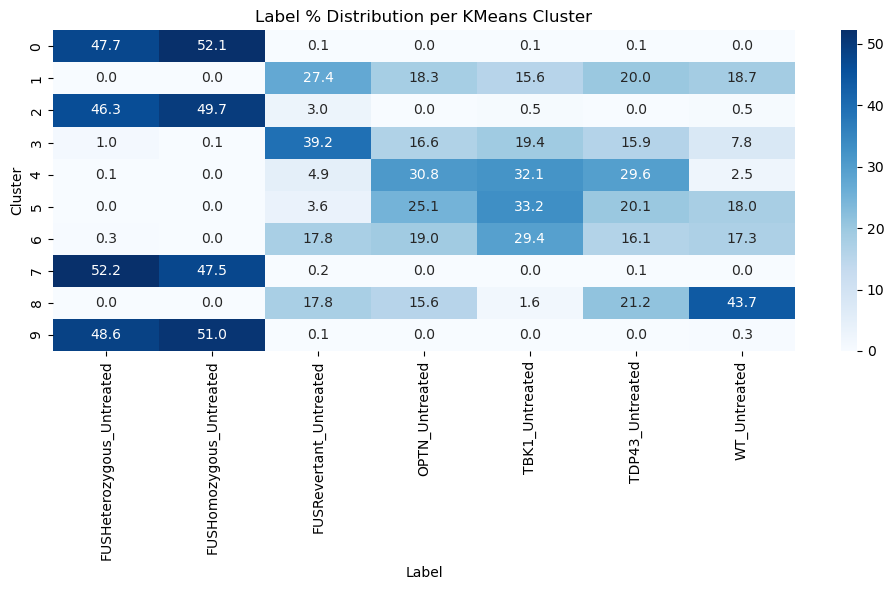

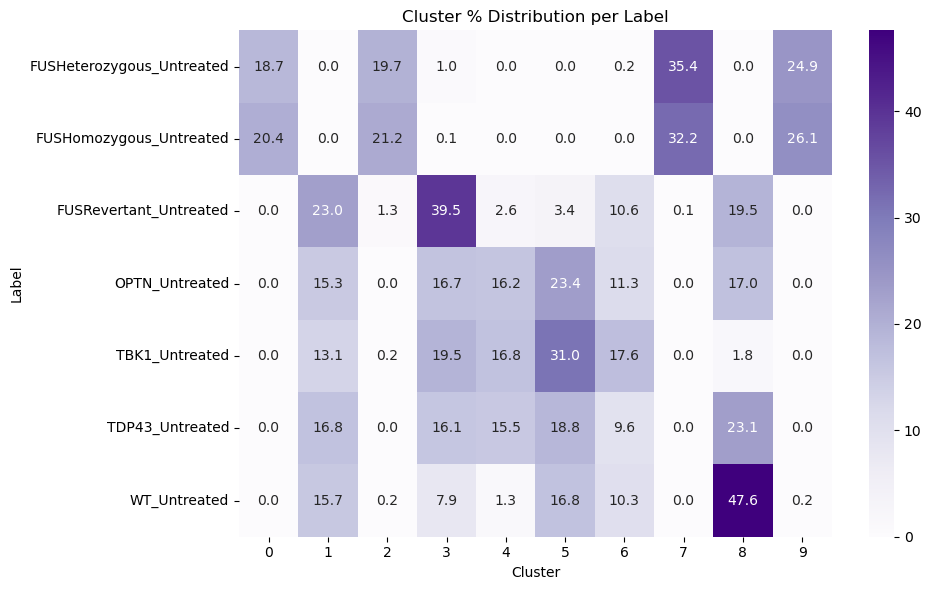

Running: PCA=False, Normalize=True, Balance=True, Clusters=15


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


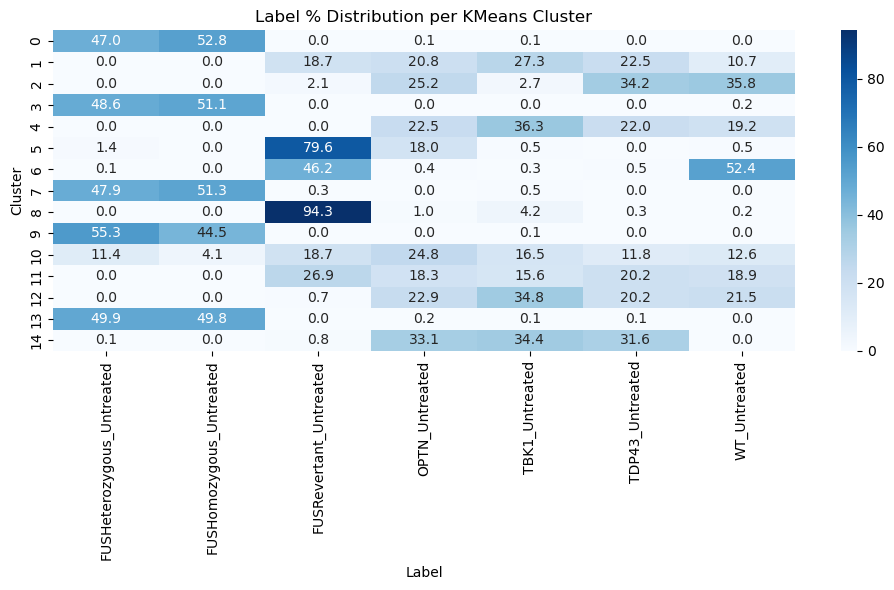

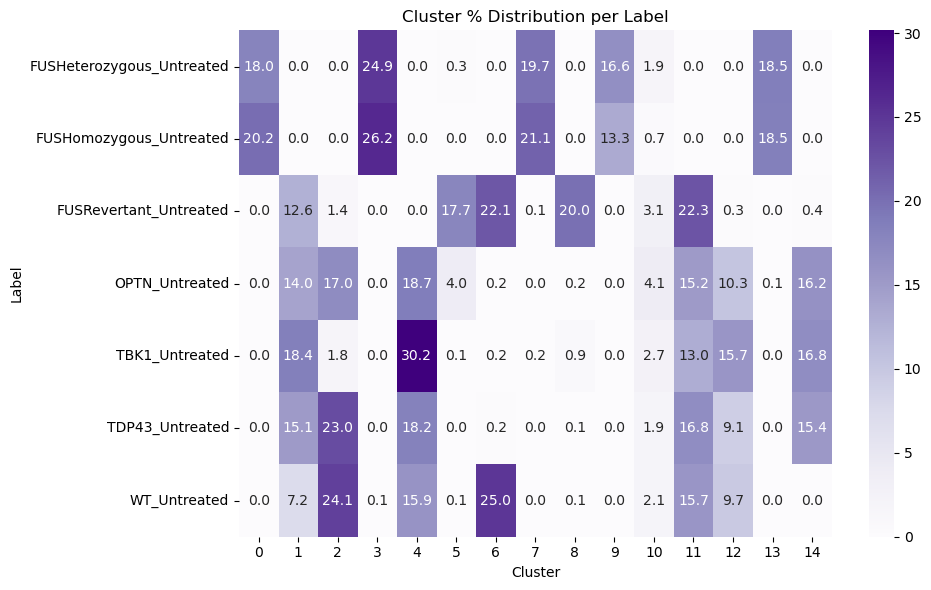

Running: PCA=False, Normalize=True, Balance=True, Clusters=20


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


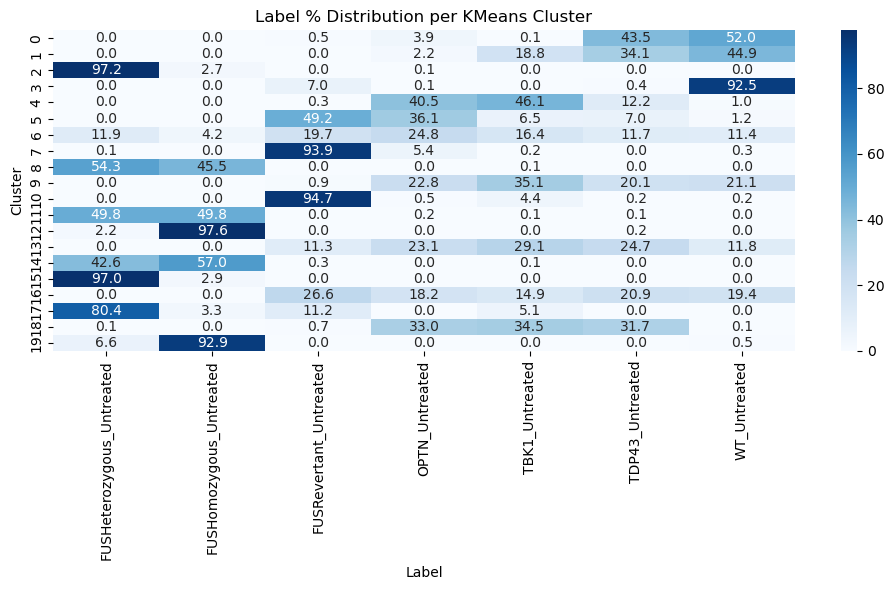

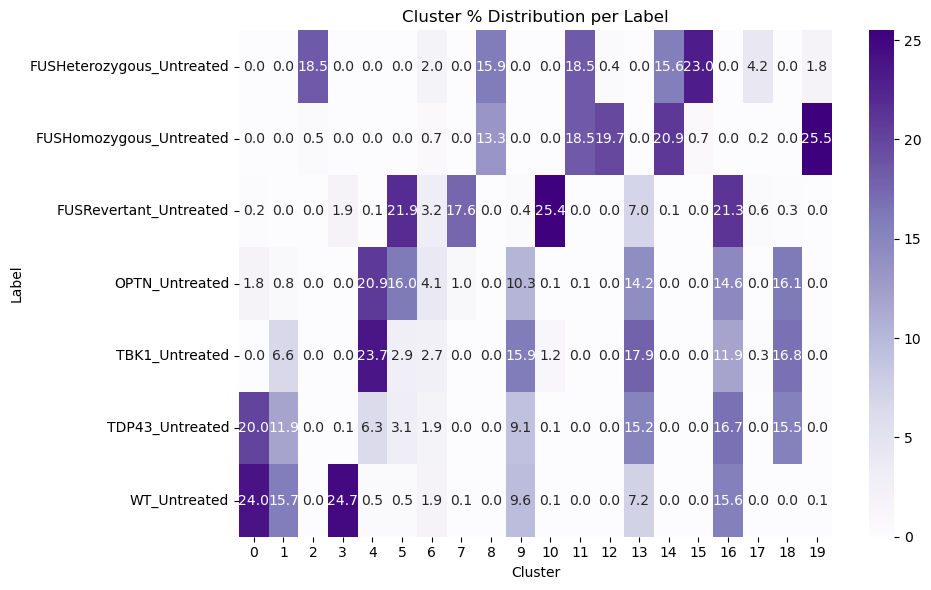

Running: PCA=False, Normalize=False, Balance=True, Clusters=10


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


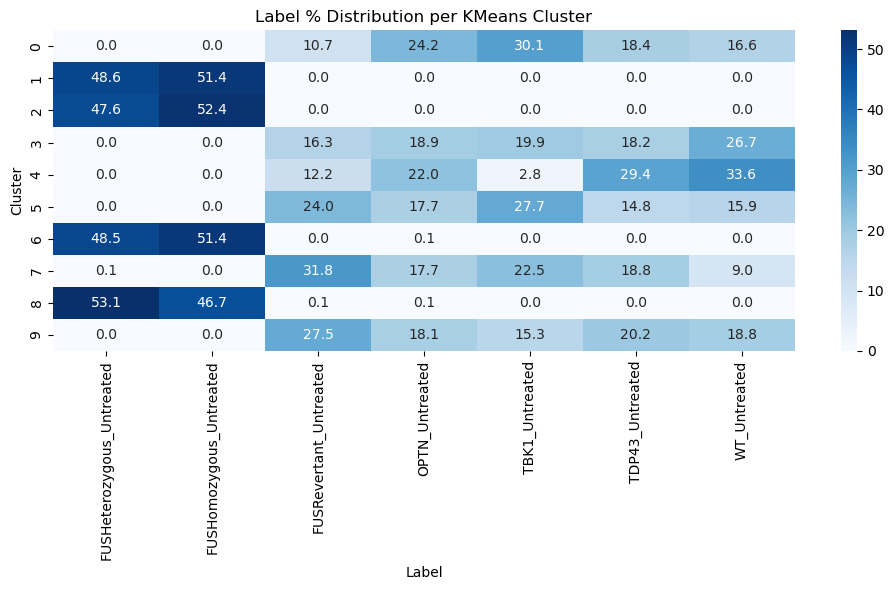

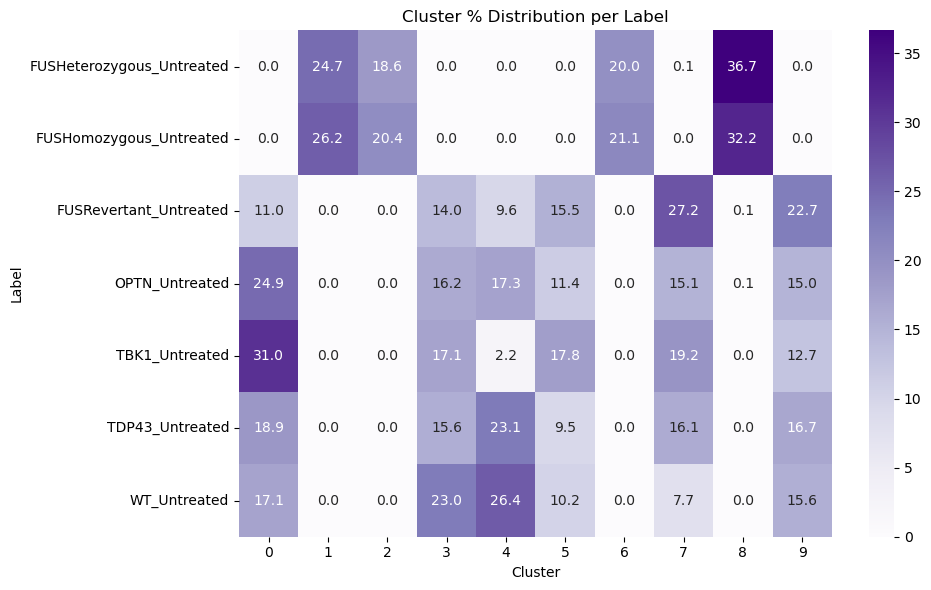

Running: PCA=False, Normalize=False, Balance=True, Clusters=15


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


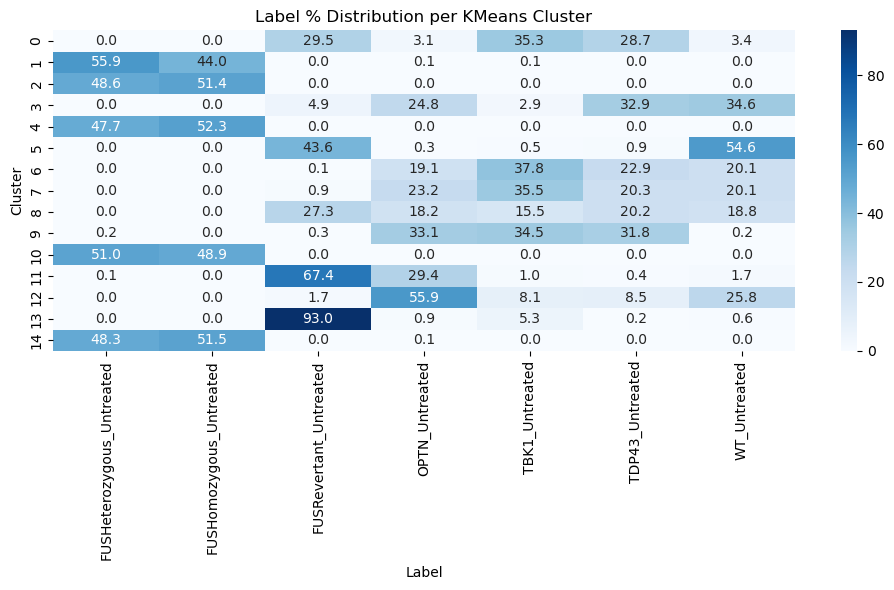

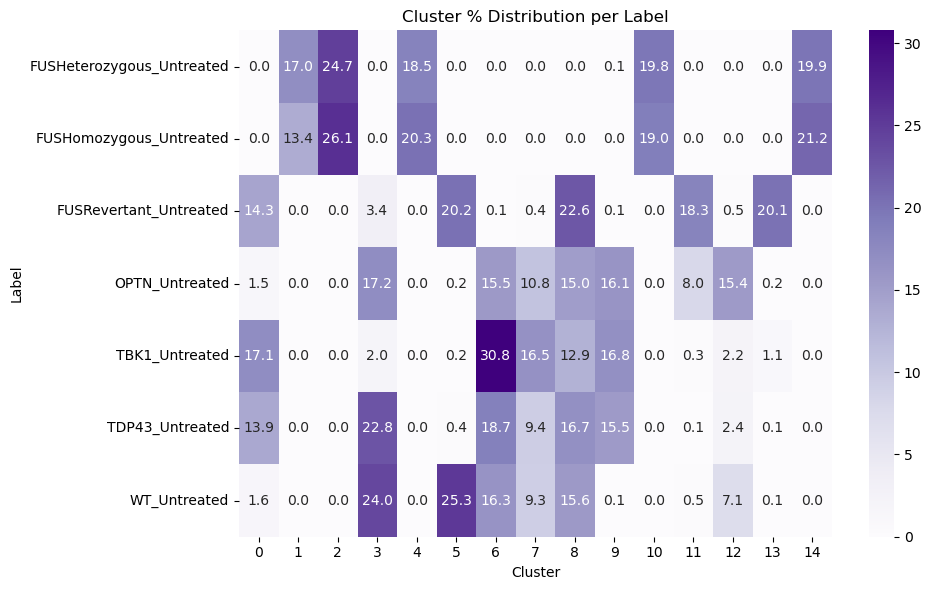

Running: PCA=False, Normalize=False, Balance=True, Clusters=20


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


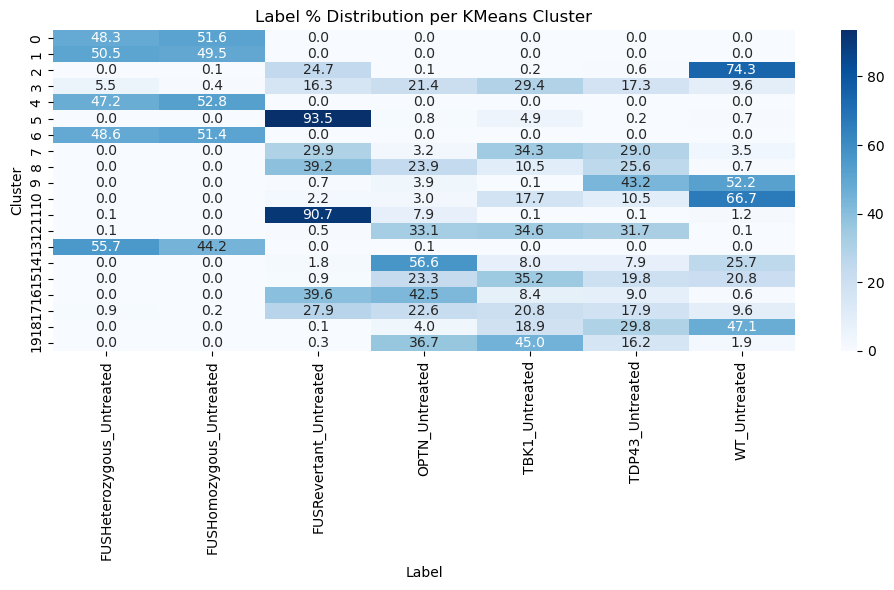

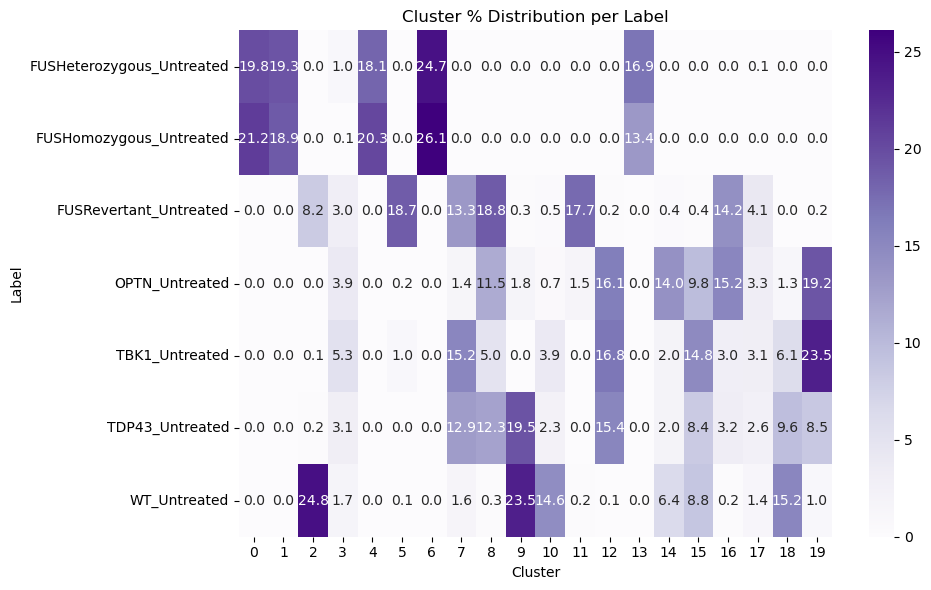

In [93]:
results_df_more_cluster = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True, False],
    norm_options=[True, False],
    balance_options=[True],
    cluster_range=[10, 15, 20]
)

In [94]:
results_df_more_cluster

,pca,normalize,balance,n_clusters,cluster_purity,label_consistency
0,True,True,True,10,0.402667,0.321530
1,True,True,True,15,0.484109,0.236925
2,True,True,True,20,0.543500,0.231308
3,True,False,True,10,0.388696,0.290750
4,True,False,True,15,0.456726,0.224154
5,True,False,True,20,0.505968,0.211557
6,False,True,True,10,0.409979,0.331776
7,False,True,True,15,0.471388,0.243136
8,False,True,True,20,0.624819,0.233166
9,False,False,True,10,0.385794,0.287790


In [95]:
from sklearn.mixture import GaussianMixture

def GMM_cluster(
    batches,
    n_clusters=5,
    normalize=False,
    balance=False,
    apply_pca=False,
    pca_components=50
):
    # Load data
    X_all, y_all = load_batches(batches)
    y_all = np.array(y_all)

    # Optional: Balance dataset
    if balance:
        ros = RandomOverSampler(random_state=42)
        X_all, y_all = ros.fit_resample(X_all, y_all)

    # Optional: Normalize
    if normalize:
        scaler = StandardScaler()
        X_all = scaler.fit_transform(X_all)

    # Optional: PCA
    if apply_pca:
        X_all = PCA(n_components=pca_components, random_state=42).fit_transform(X_all)

    # GMM clustering
    gmm = GaussianMixture(n_components=n_clusters, random_state=42)
    clusters = gmm.fit_predict(X_all)

    # Build DataFrame
    df = pd.DataFrame({'cluster': clusters, 'label': y_all})

    # Cluster → Label distribution
    cluster_summary = df.groupby('cluster')['label'].value_counts(normalize=True).unstack().fillna(0) * 100
    plt.figure(figsize=(10, 6))
    sns.heatmap(cluster_summary, annot=True, fmt=".1f", cmap='Blues')
    plt.title("Label % Distribution per GMM Cluster")
    plt.ylabel("Cluster")
    plt.xlabel("Label")
    plt.tight_layout()
    plt.show()

    # Label → Cluster distribution
    label_summary = df.groupby('label')['cluster'].value_counts(normalize=True).unstack().fillna(0) * 100
    plt.figure(figsize=(10, 6))
    sns.heatmap(label_summary, annot=True, fmt=".1f", cmap='Purples')
    plt.title("Cluster % Distribution per Label")
    plt.xlabel("Cluster")
    plt.ylabel("Label")
    plt.tight_layout()
    plt.show()

    return df, cluster_summary, label_summary

Running: PCA=True, Normalize=True, Balance=True, Clusters=3


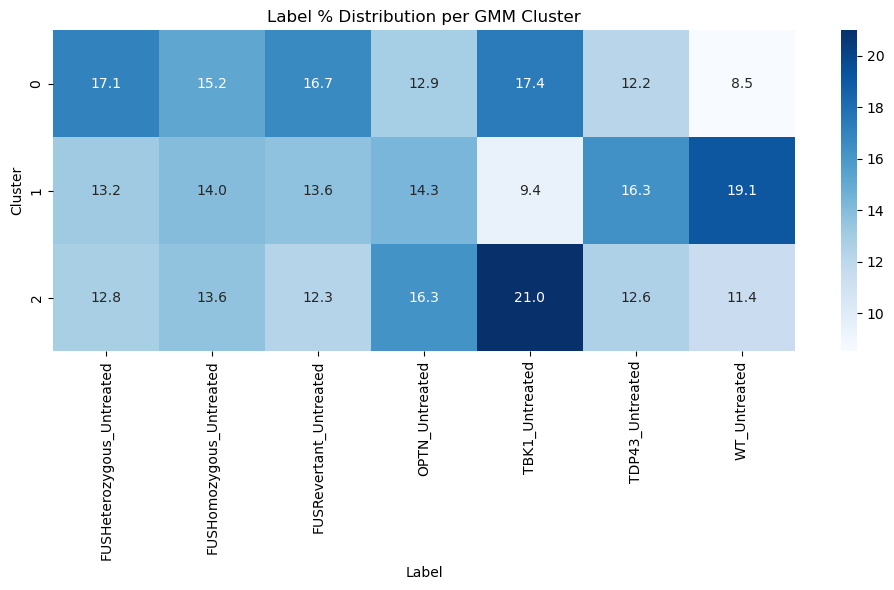

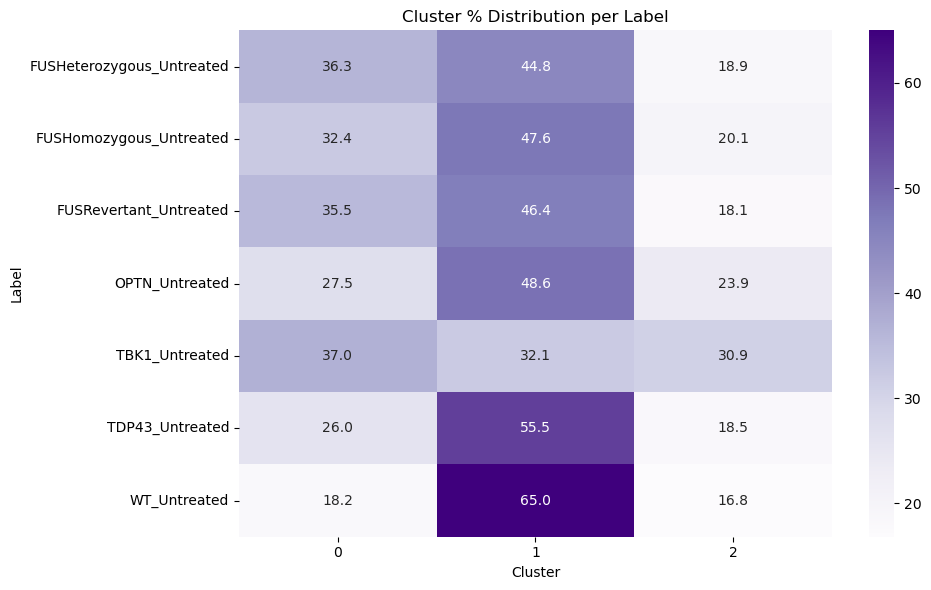

Running: PCA=True, Normalize=True, Balance=True, Clusters=5


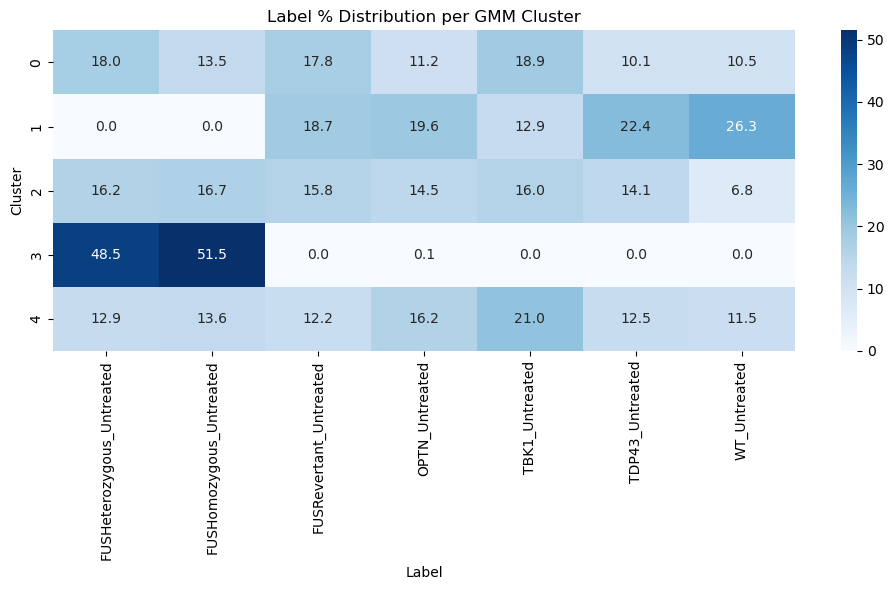

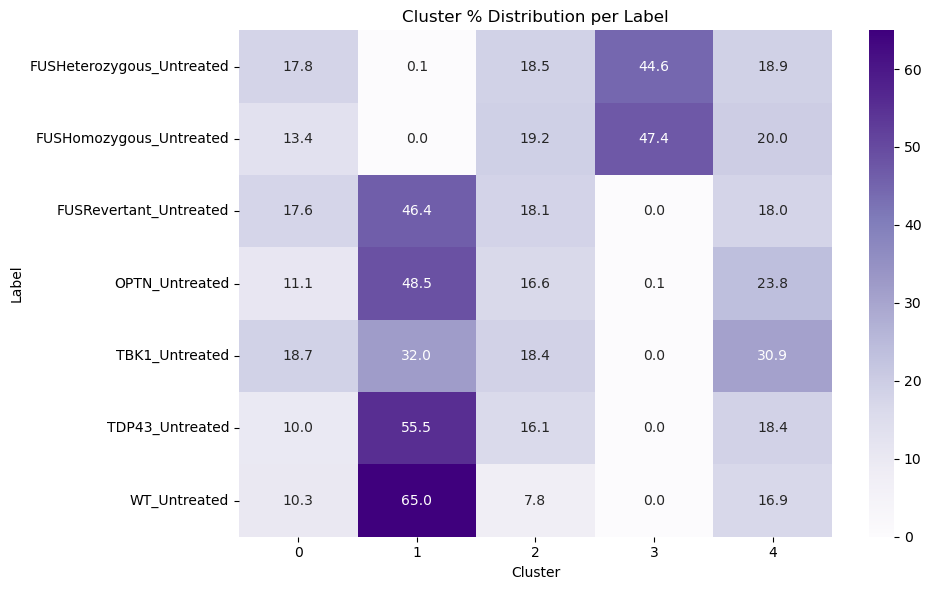

Running: PCA=True, Normalize=True, Balance=True, Clusters=7


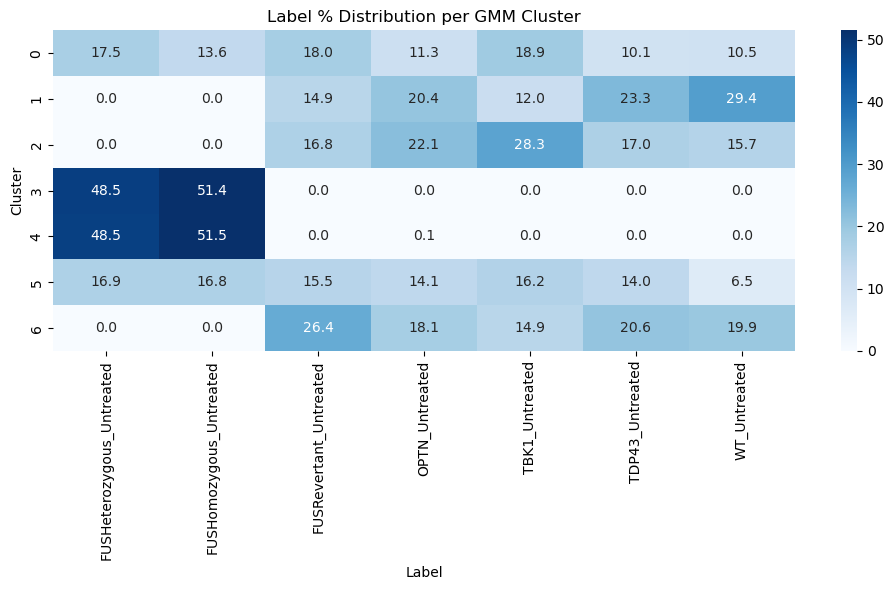

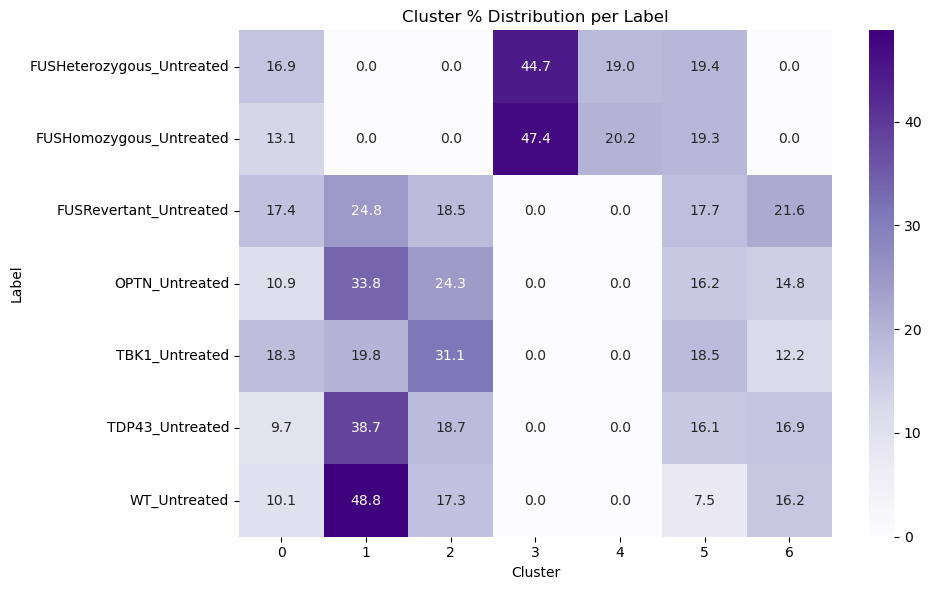

Running: PCA=True, Normalize=True, Balance=True, Clusters=10


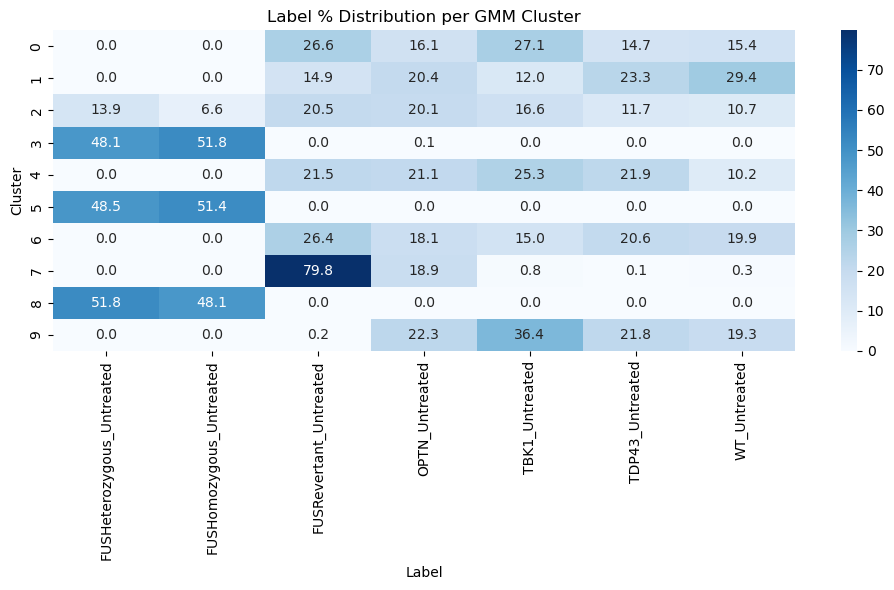

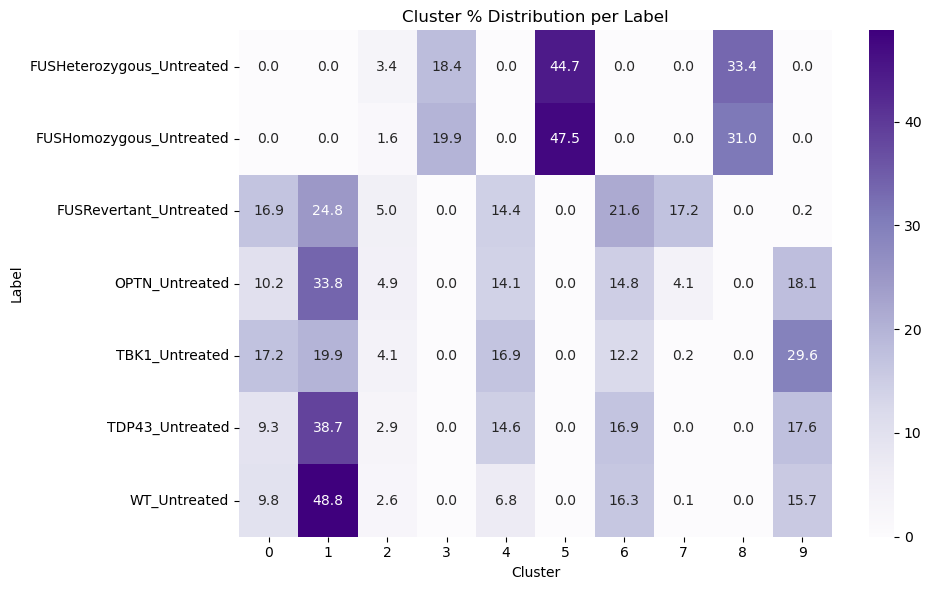

Running: PCA=True, Normalize=True, Balance=False, Clusters=3


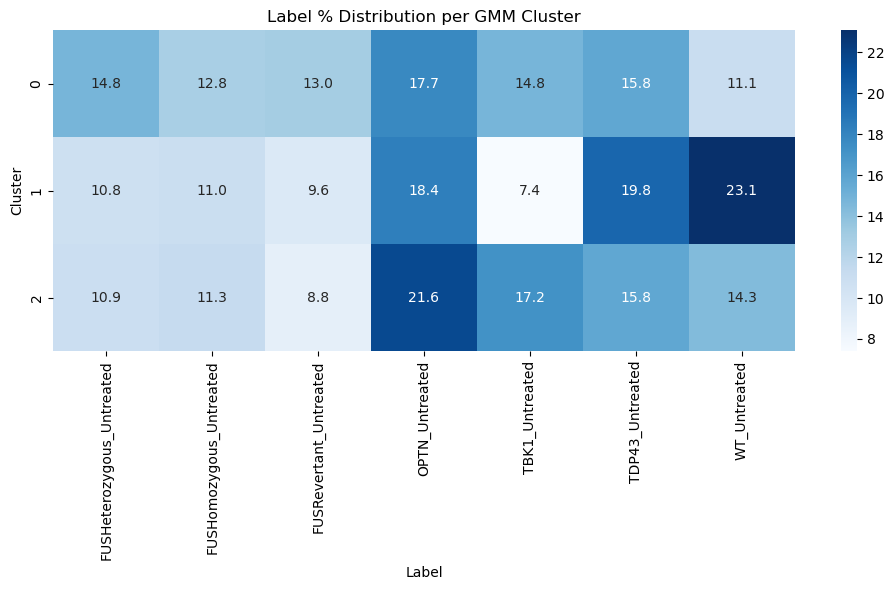

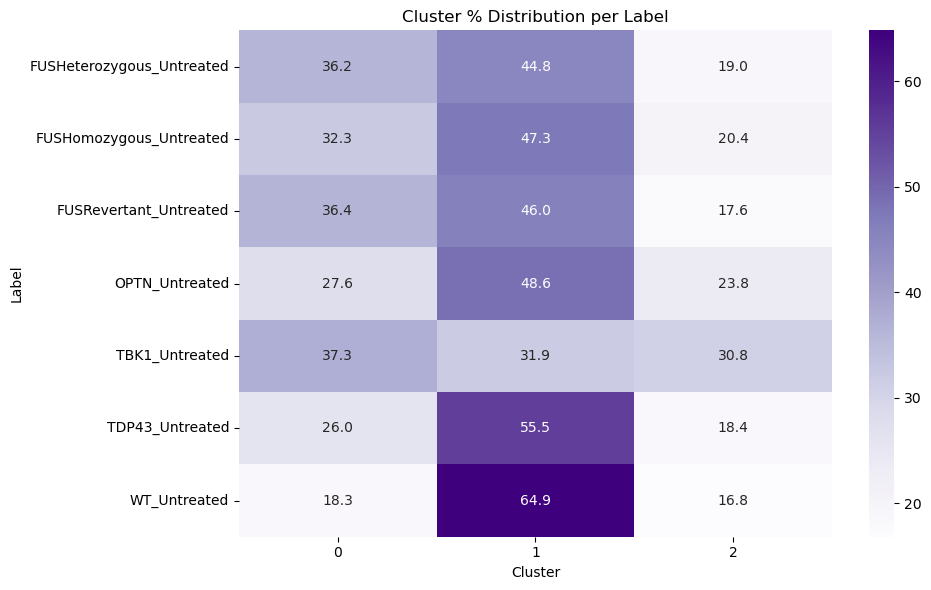

Running: PCA=True, Normalize=True, Balance=False, Clusters=5


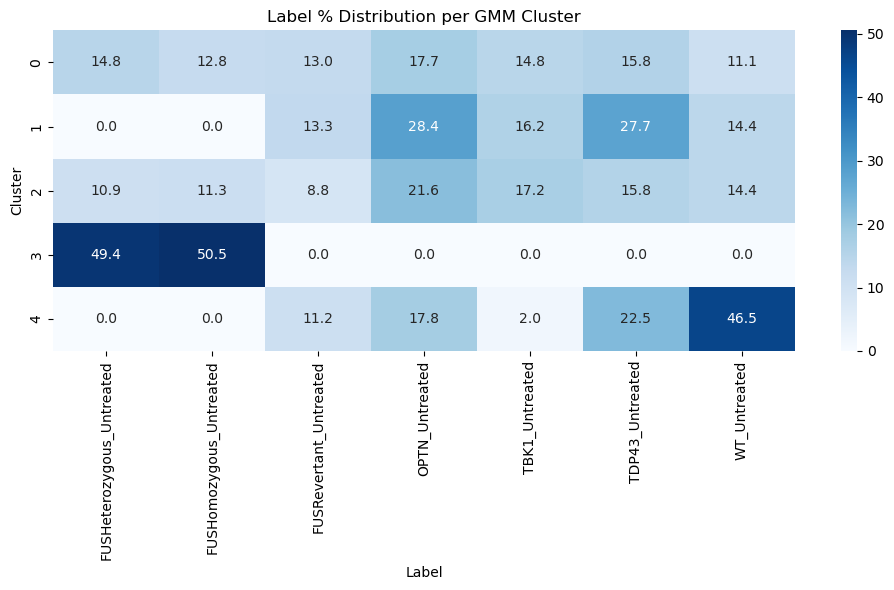

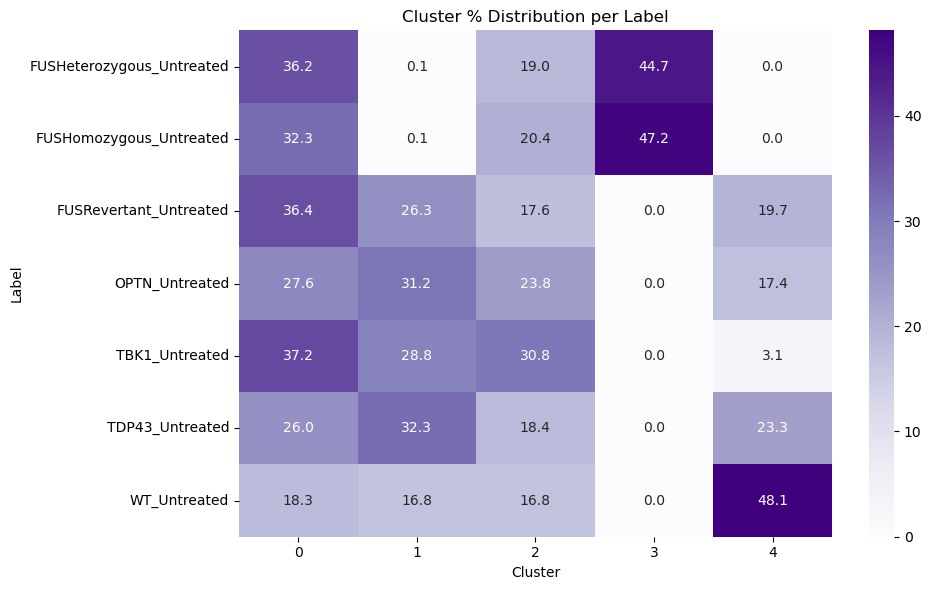

Running: PCA=True, Normalize=True, Balance=False, Clusters=7


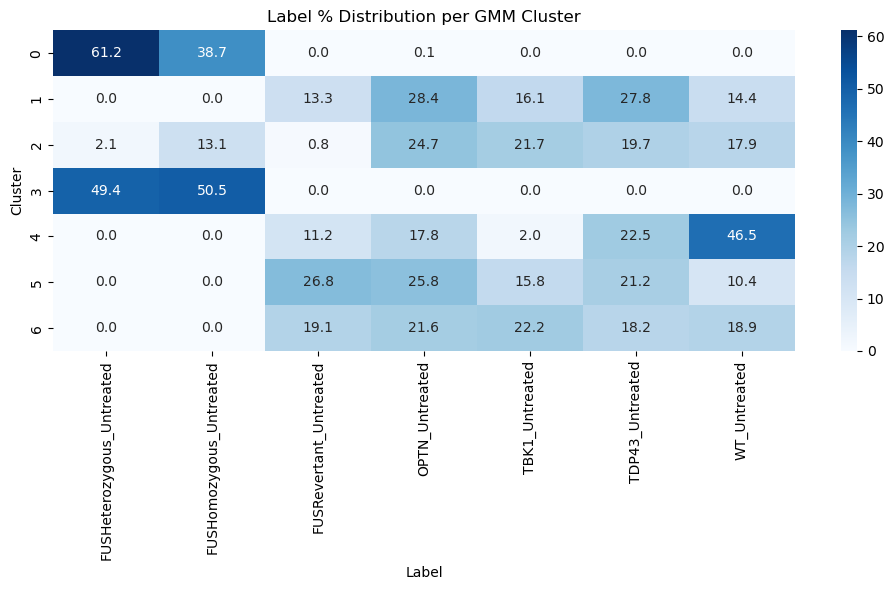

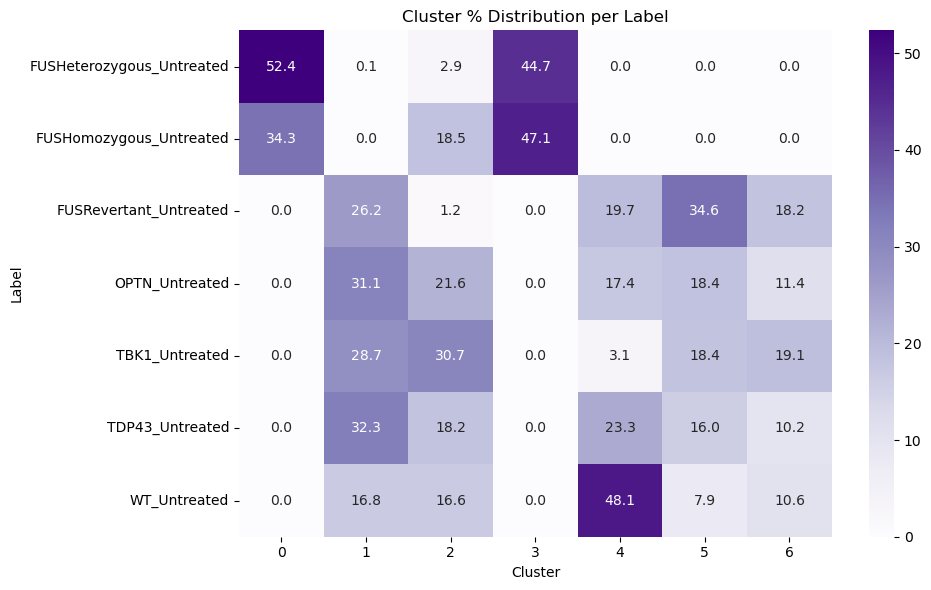

Running: PCA=True, Normalize=True, Balance=False, Clusters=10


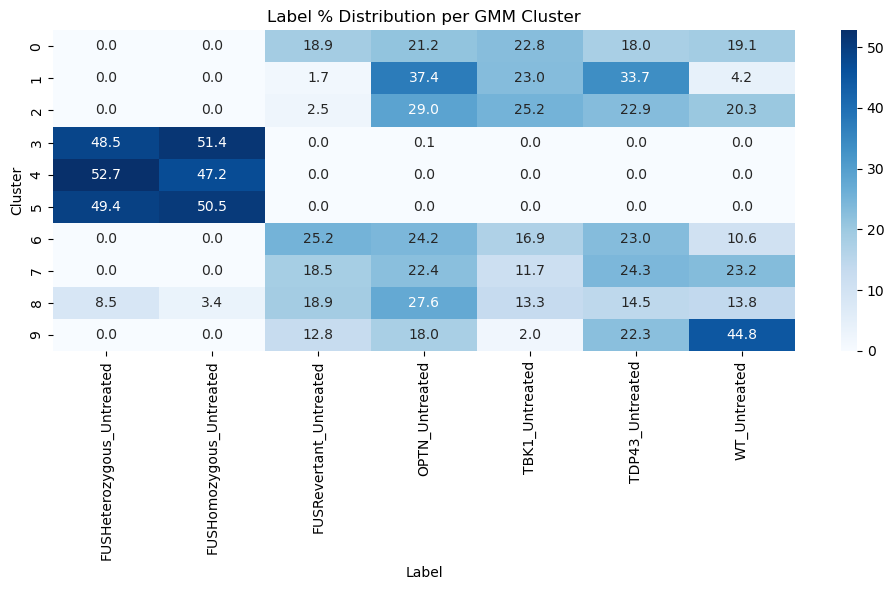

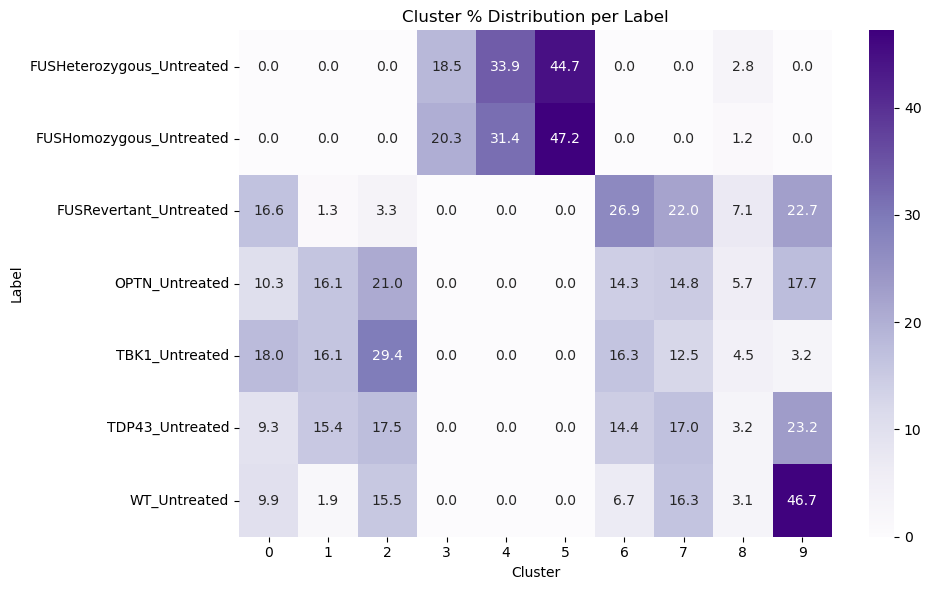

Running: PCA=True, Normalize=False, Balance=True, Clusters=3


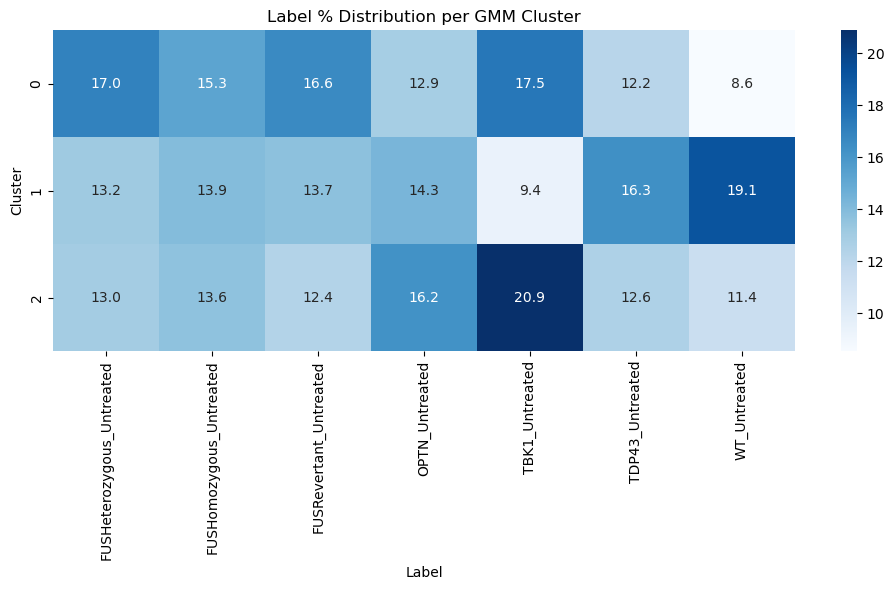

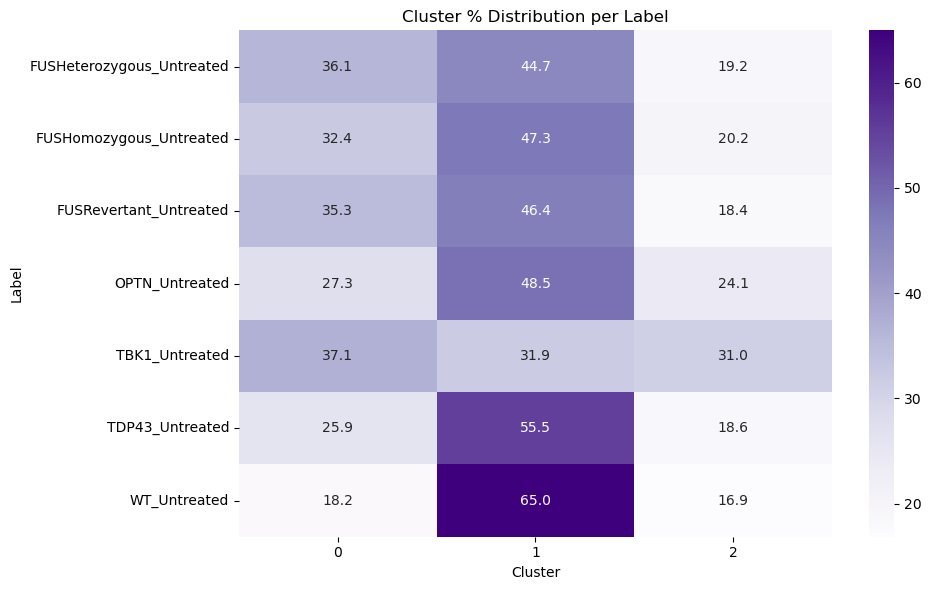

Running: PCA=True, Normalize=False, Balance=True, Clusters=5


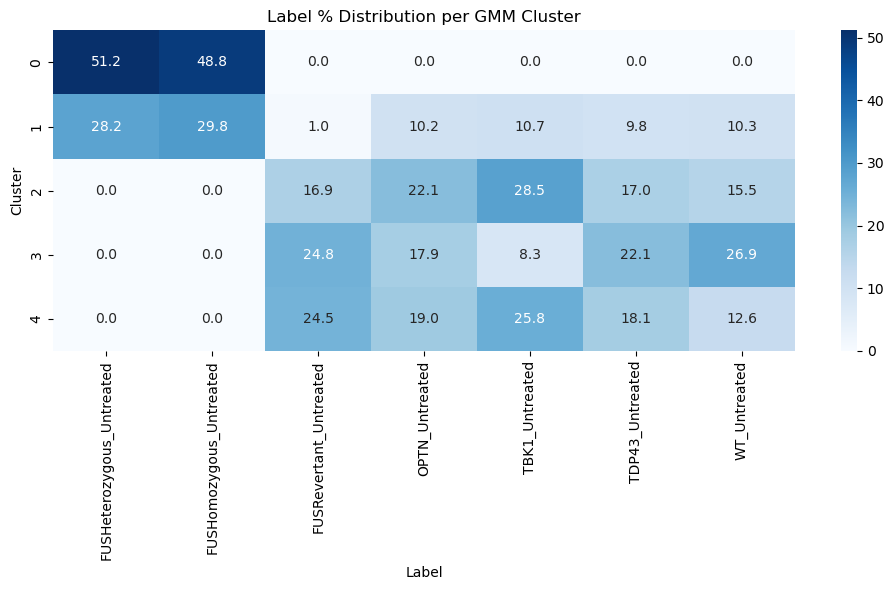

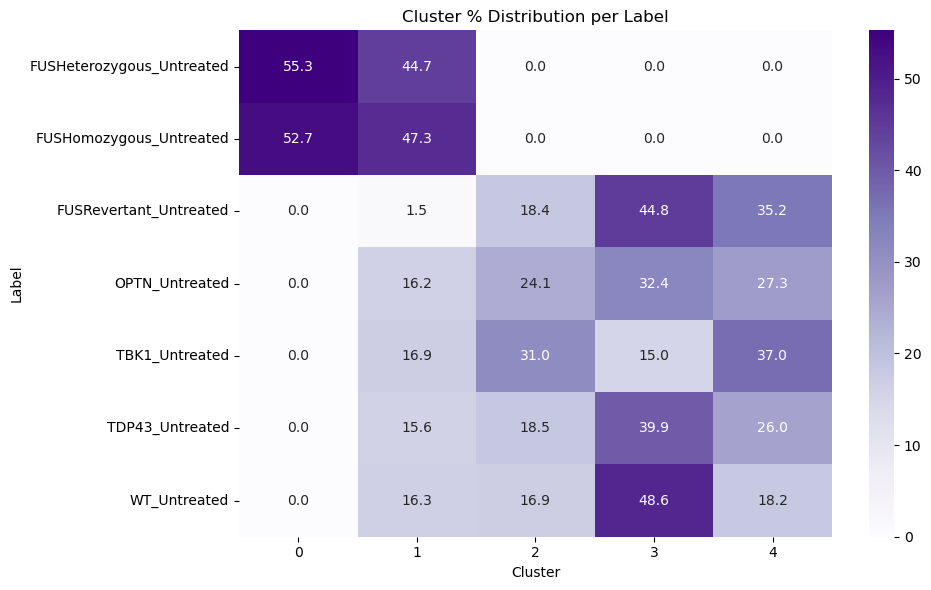

Running: PCA=True, Normalize=False, Balance=True, Clusters=7


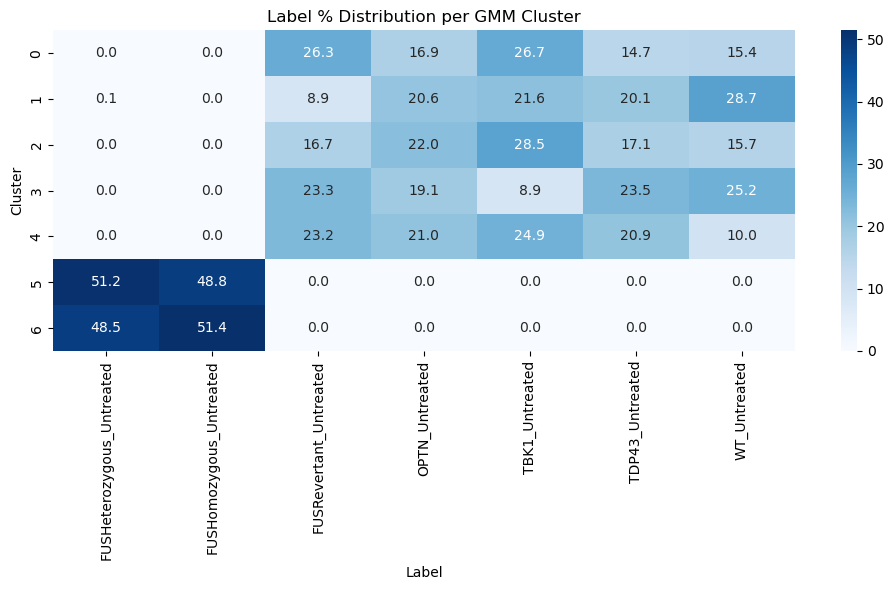

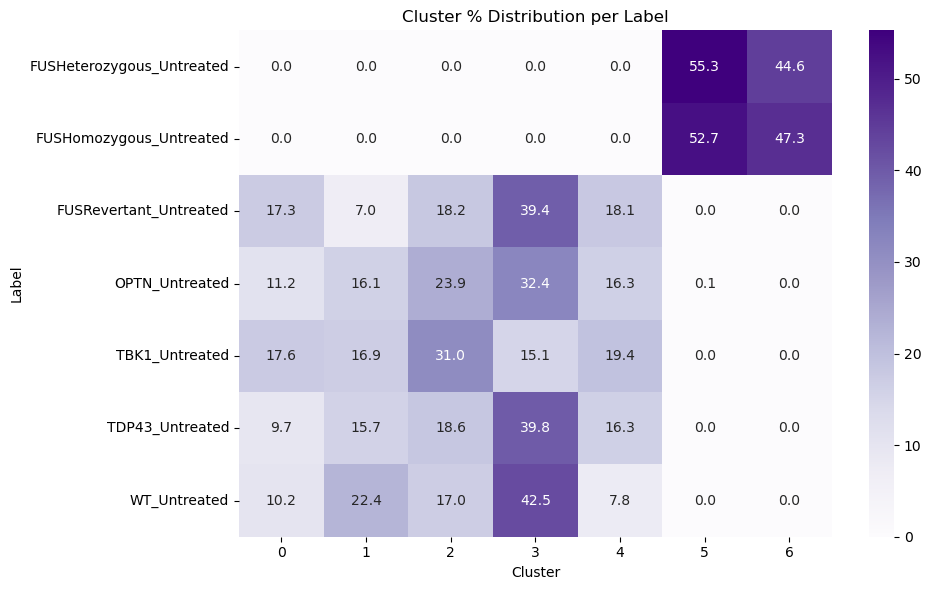

Running: PCA=True, Normalize=False, Balance=True, Clusters=10


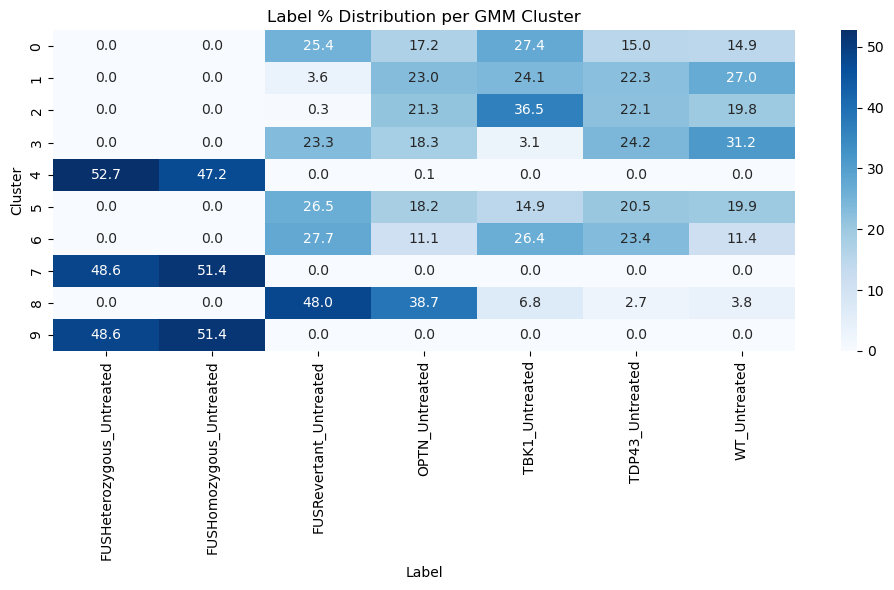

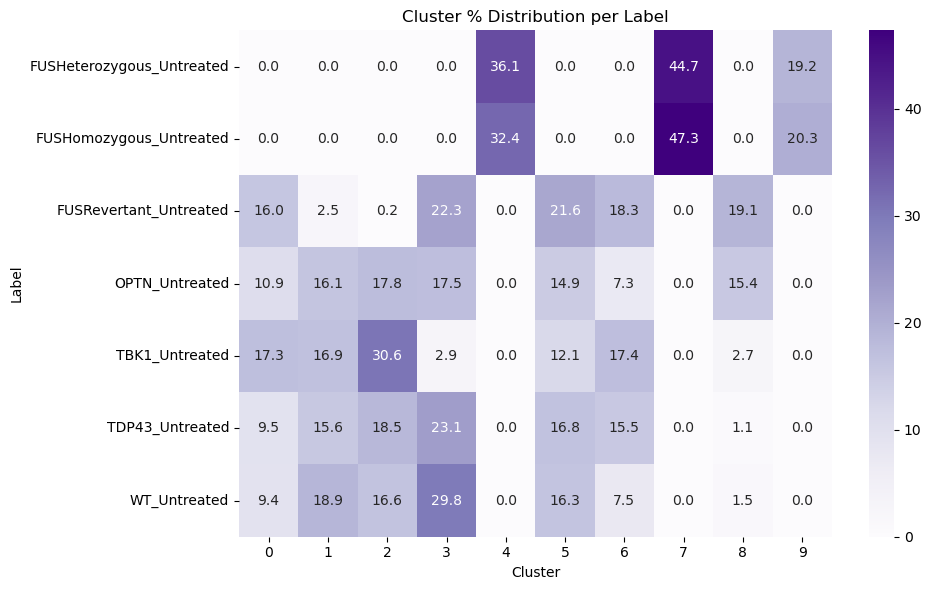

Running: PCA=True, Normalize=False, Balance=False, Clusters=3


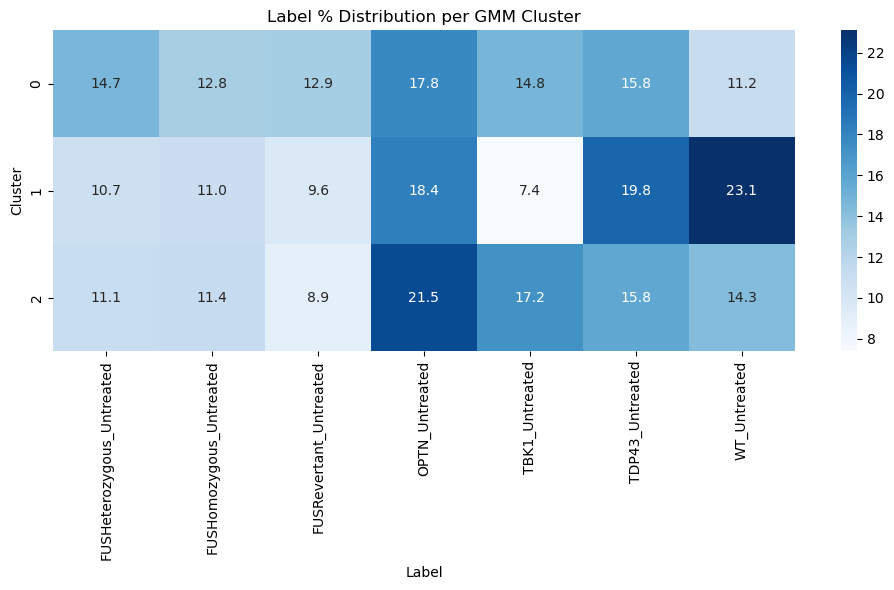

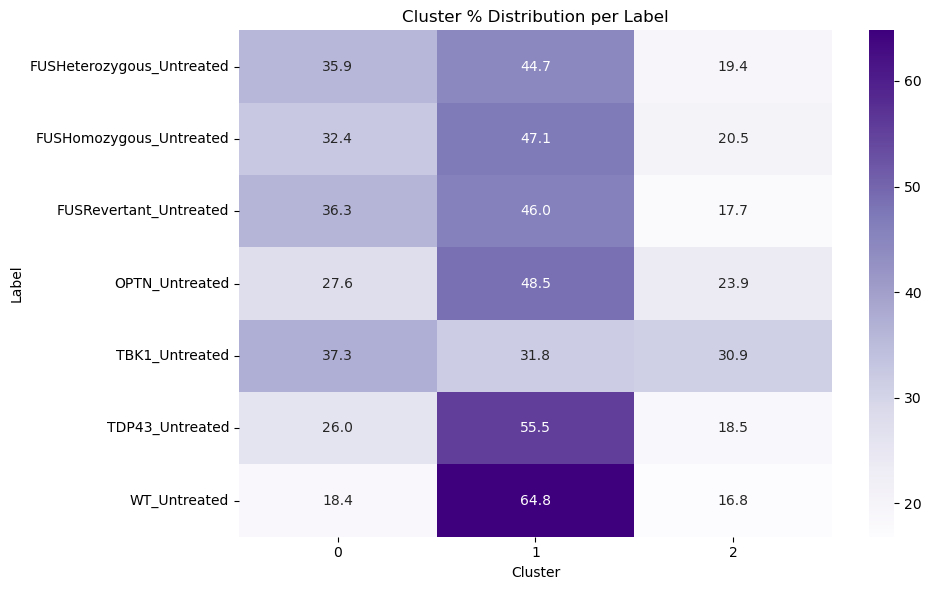

Running: PCA=True, Normalize=False, Balance=False, Clusters=5


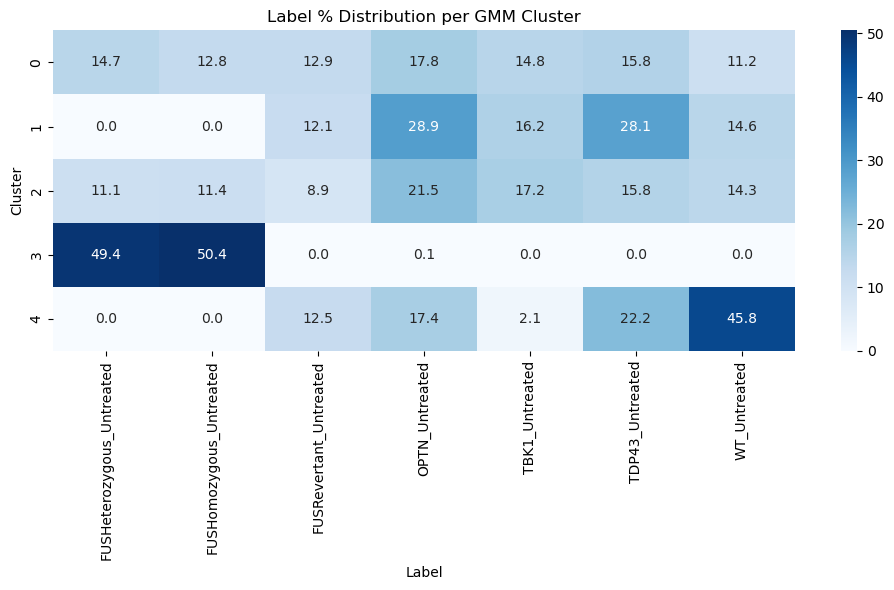

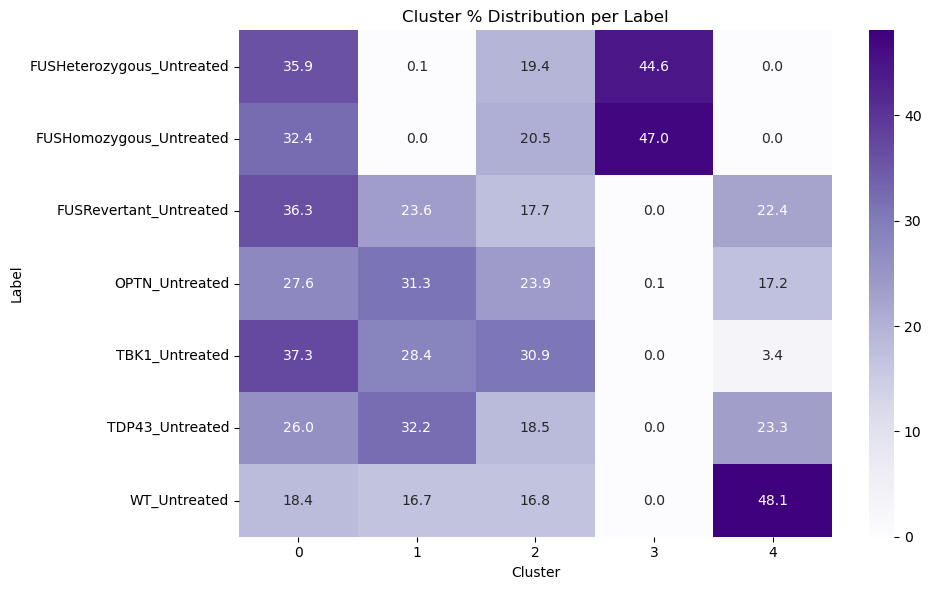

Running: PCA=True, Normalize=False, Balance=False, Clusters=7


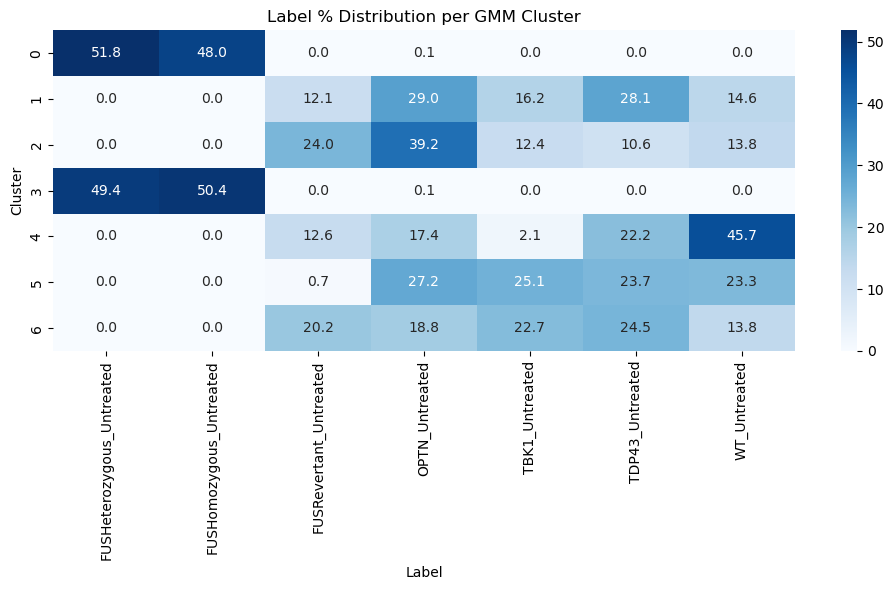

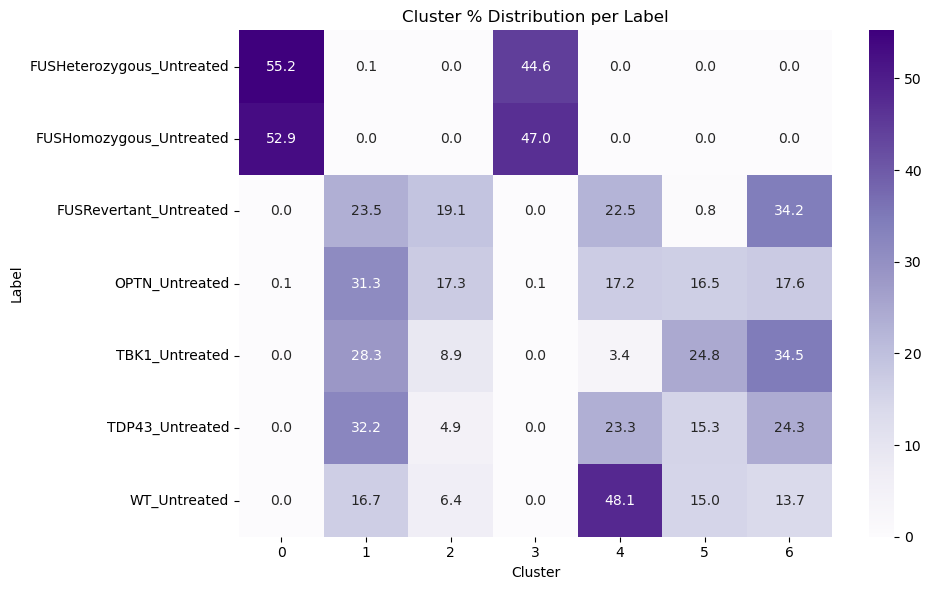

Running: PCA=True, Normalize=False, Balance=False, Clusters=10


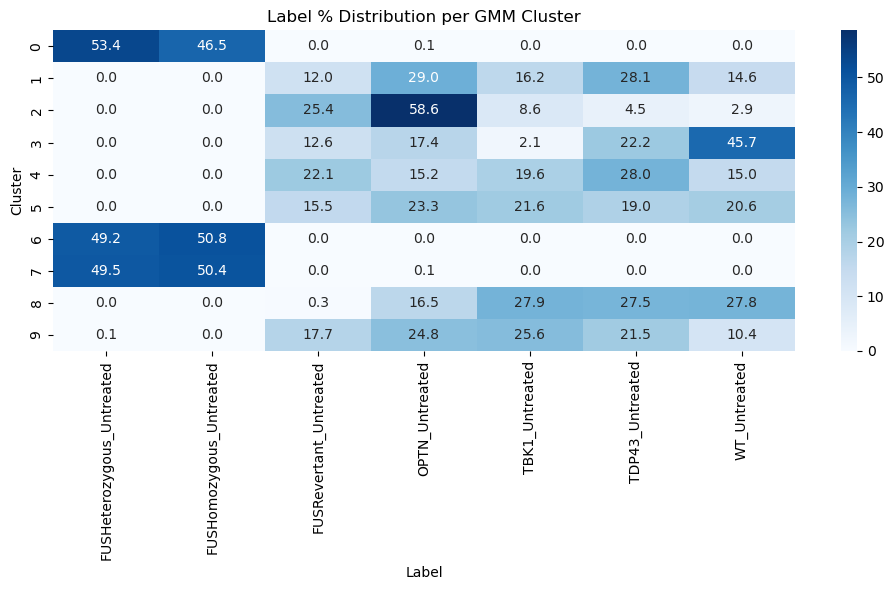

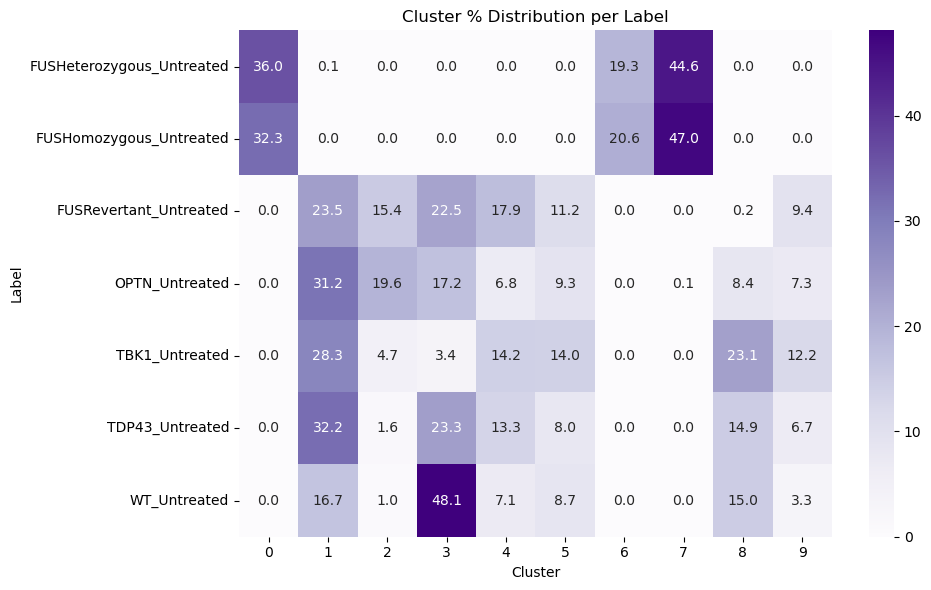

Running: PCA=False, Normalize=True, Balance=True, Clusters=3


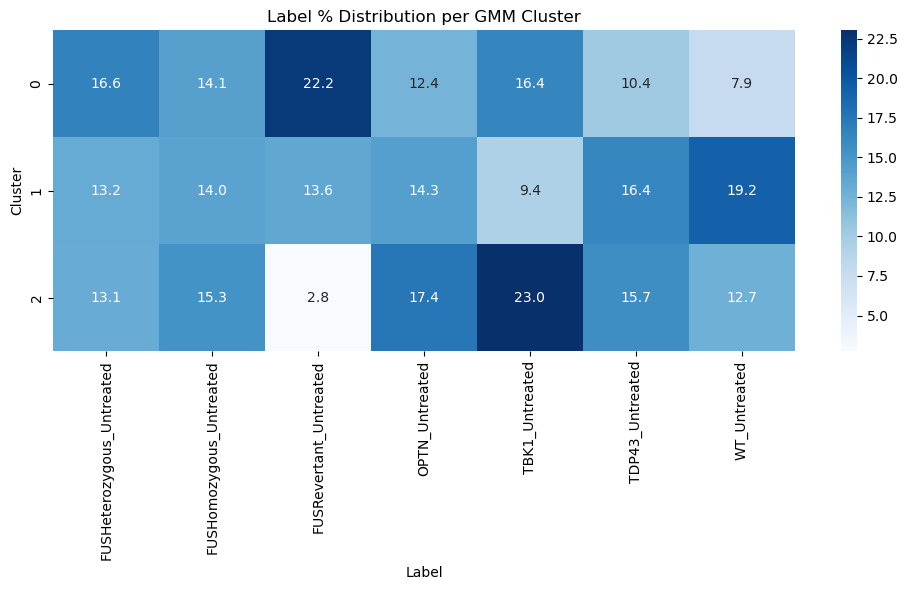

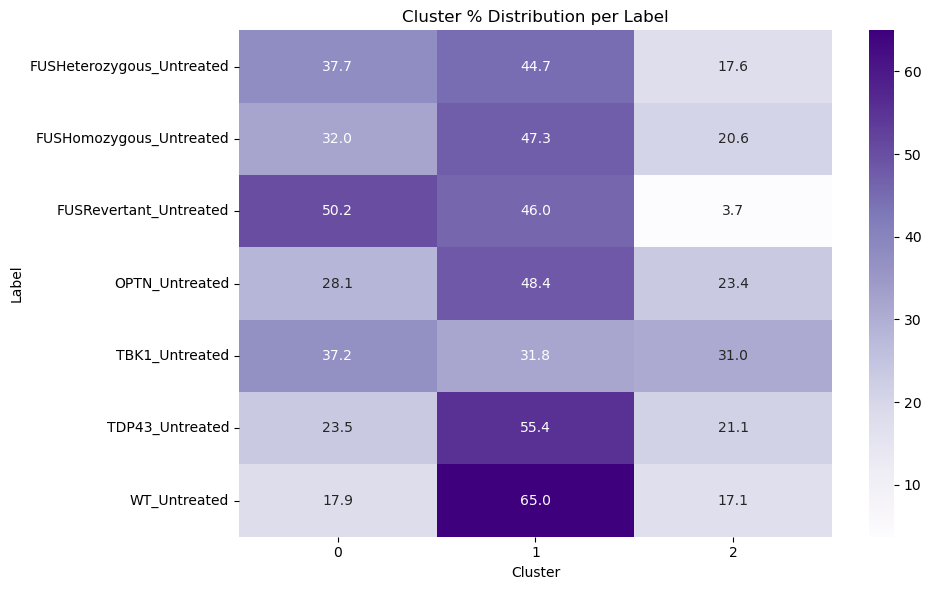

Running: PCA=False, Normalize=True, Balance=True, Clusters=5


In [ ]:
results_df_GMM = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True, False],
    norm_options=[True, False],
    balance_options=[True, False],
    cluster_range=[3,5,7,10],
    method = 'GMM'
)

Running: PCA=True, Normalize=True, Balance=True, Clusters=10


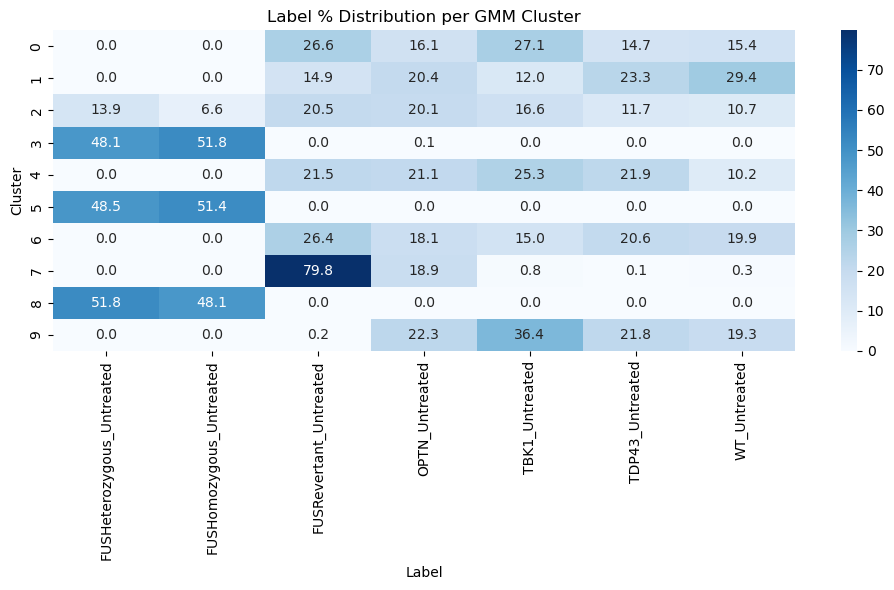

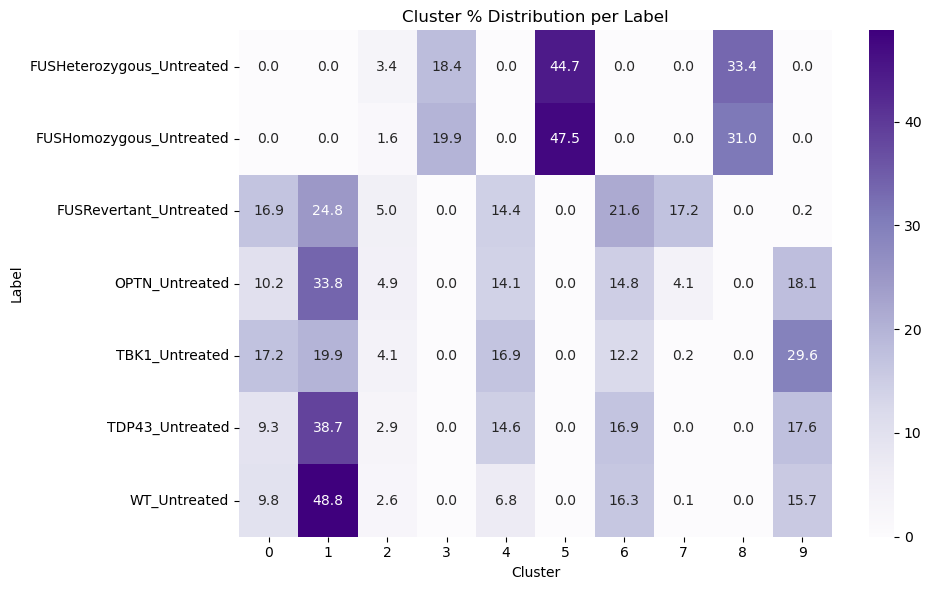

Running: PCA=True, Normalize=True, Balance=False, Clusters=10


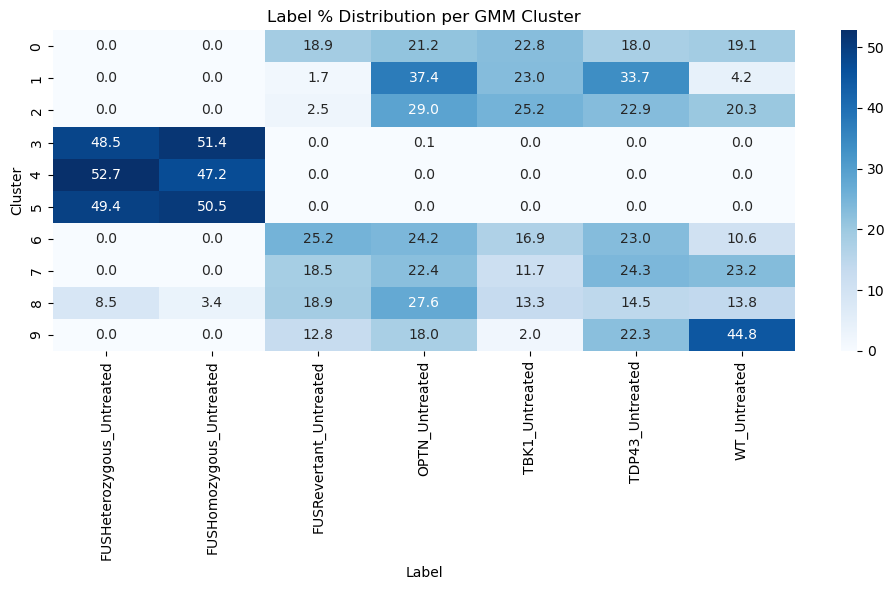

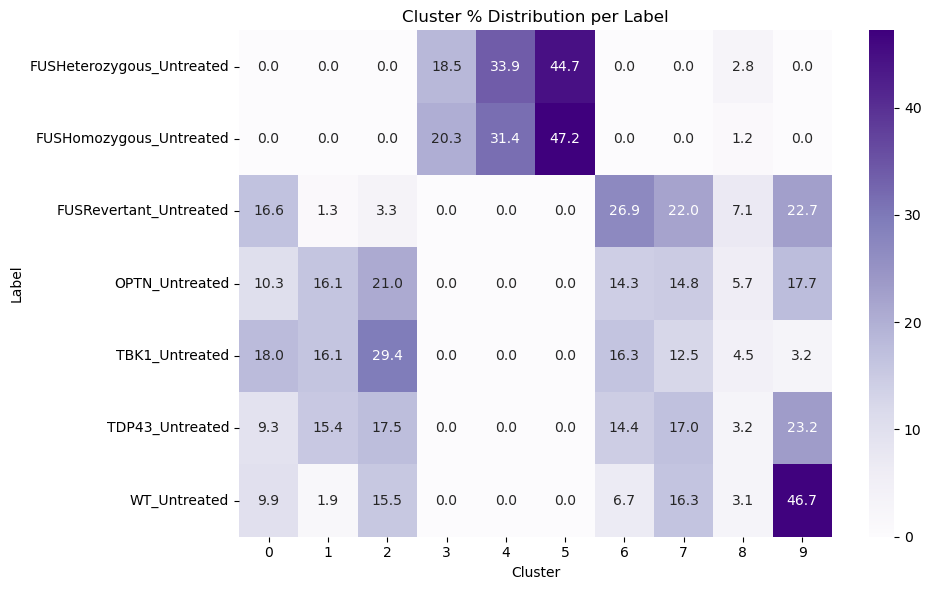

Running: PCA=True, Normalize=False, Balance=True, Clusters=10


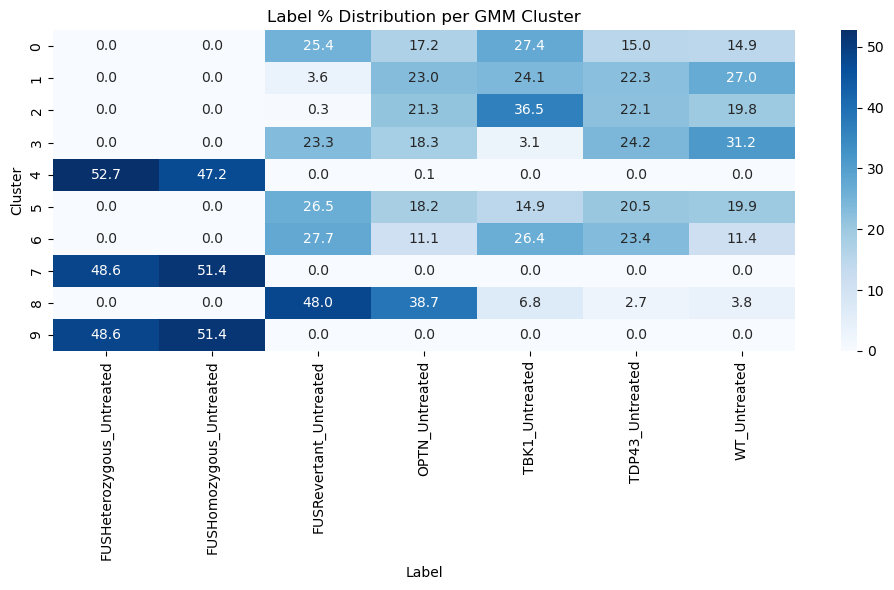

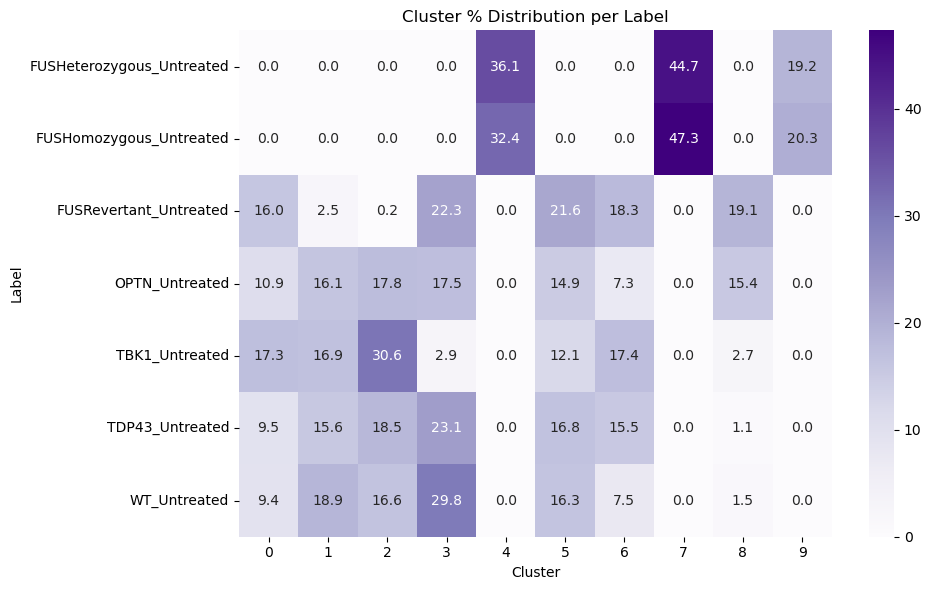

Running: PCA=True, Normalize=False, Balance=False, Clusters=10


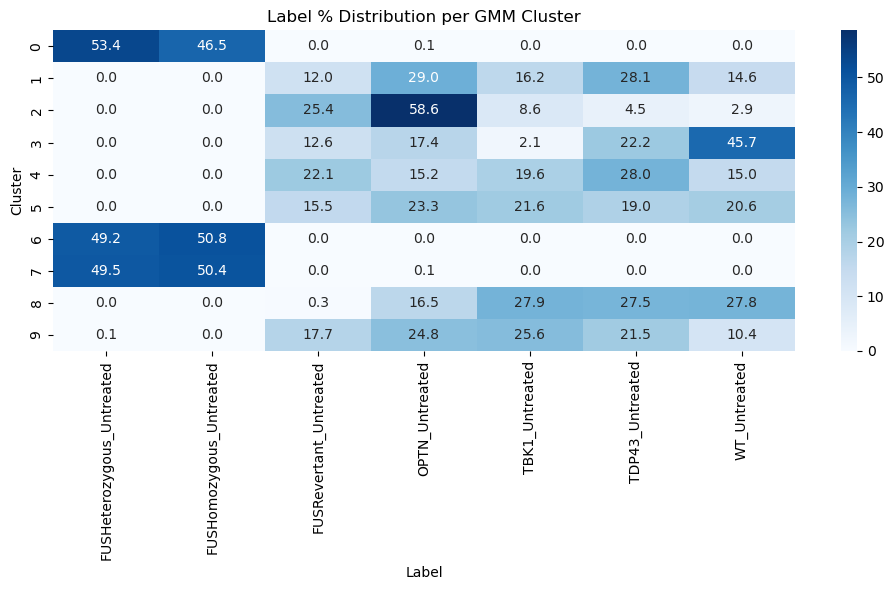

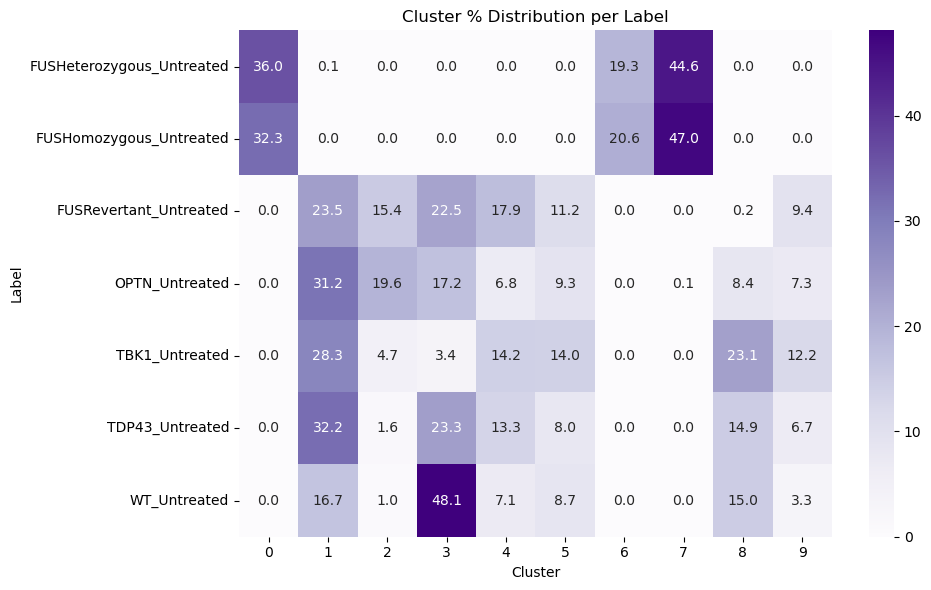

Running: PCA=False, Normalize=True, Balance=True, Clusters=10


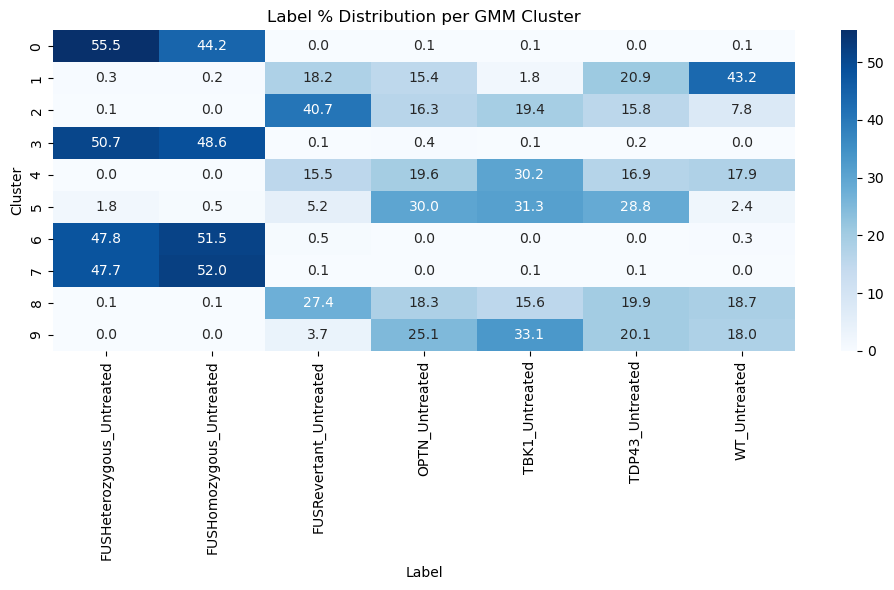

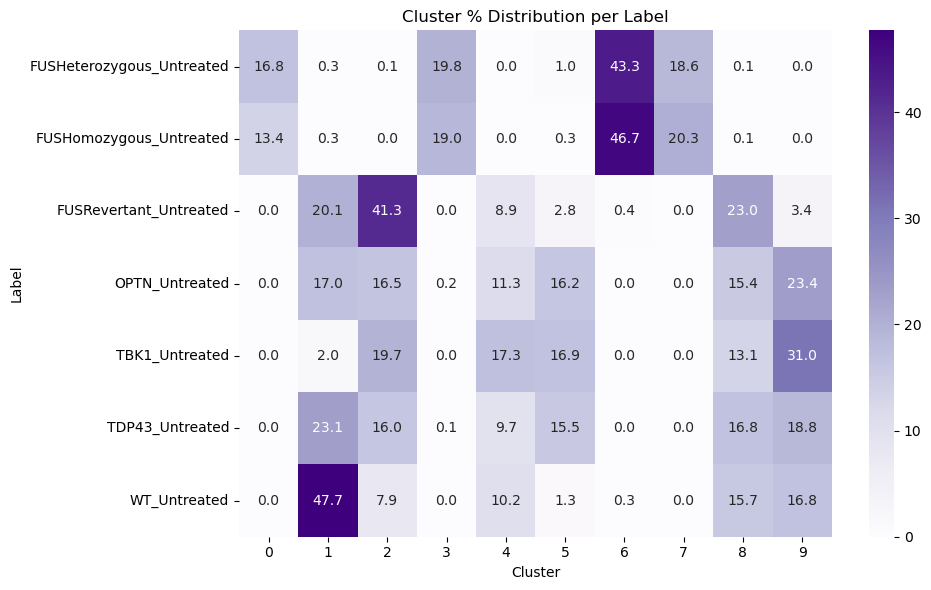

Running: PCA=False, Normalize=True, Balance=False, Clusters=10


In [ ]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True, False],
    norm_options=[True, False],
    balance_options=[True, False],
    cluster_range=[10],
    method = 'GMM'
)

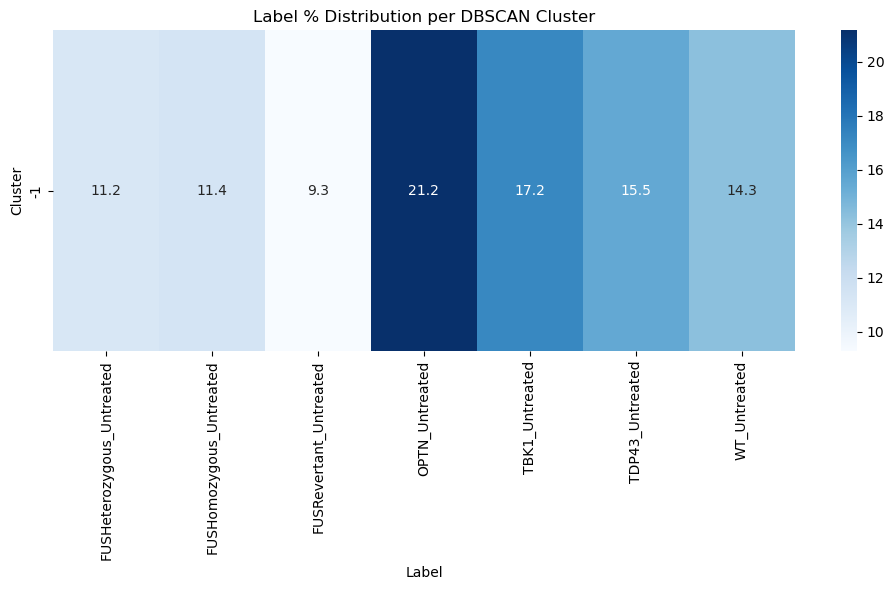

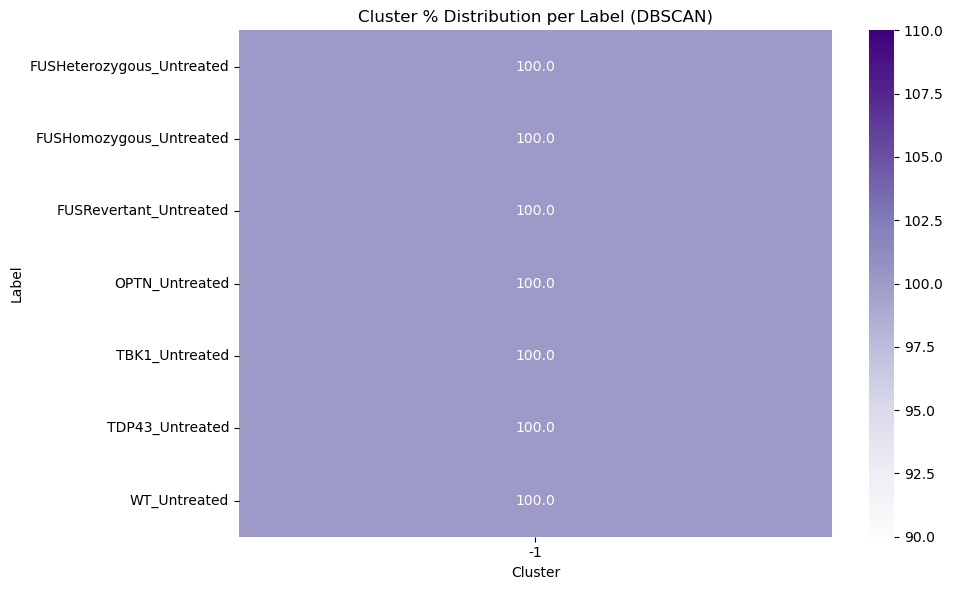

In [14]:
df = run_clustering(
    [1],
    method='dbscan',  # 'kmeans', 'gmm', or 'dbscan'
    normalize=True,
    balance=False,
    apply_pca=True,
    pca_components=50,
    cluster_kwargs={'eps': 0.05, 'min_samples': 5})  # e.g., {'n_clusters': 5} or {'eps': 1.2}

In [29]:
from utils import *

Running: PCA=True, Normalize=False, Balance=False, Clusters=15


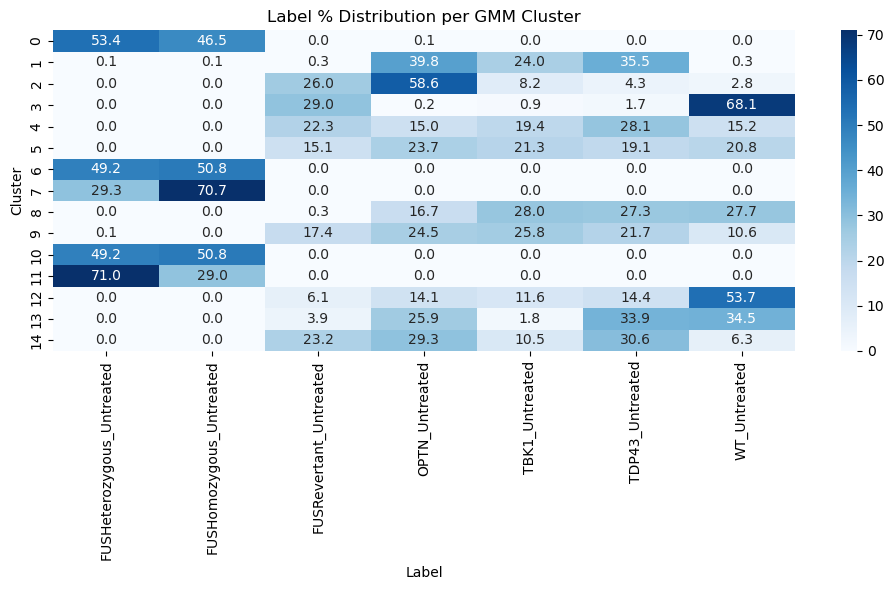

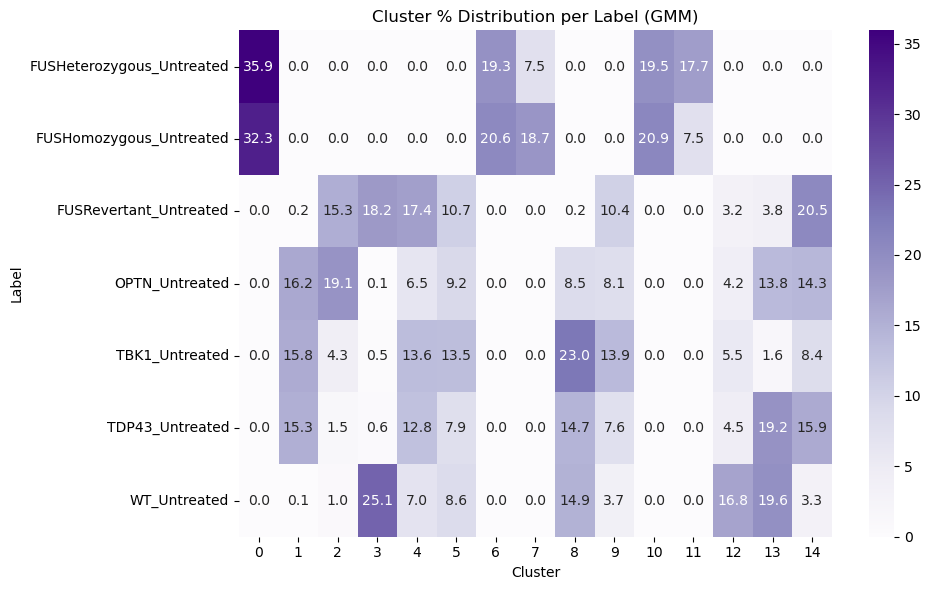

In [32]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False],
    cluster_range=[15],
    method = 'gmm'
)

Running: PCA=True, Normalize=False, Balance=False, Clusters=25


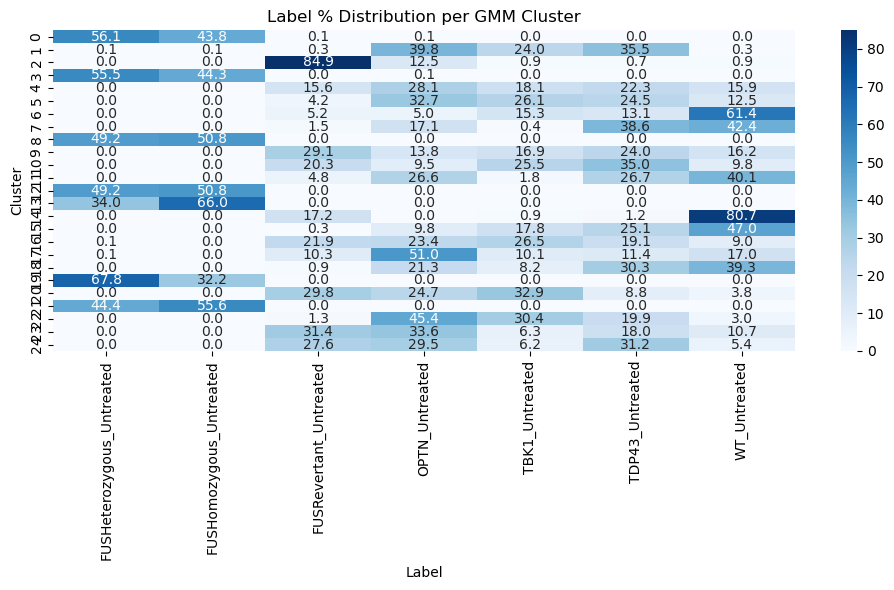

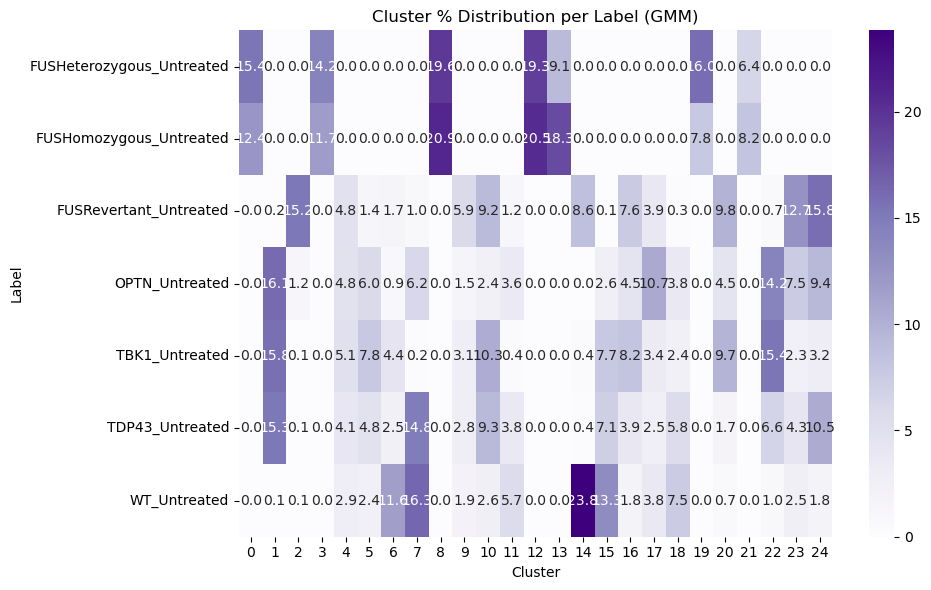

Running: PCA=True, Normalize=False, Balance=True, Clusters=25


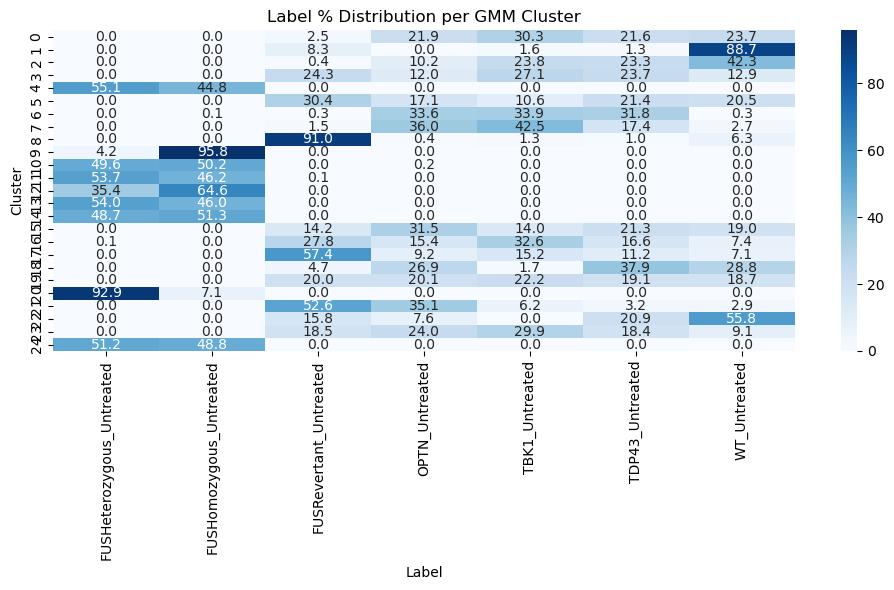

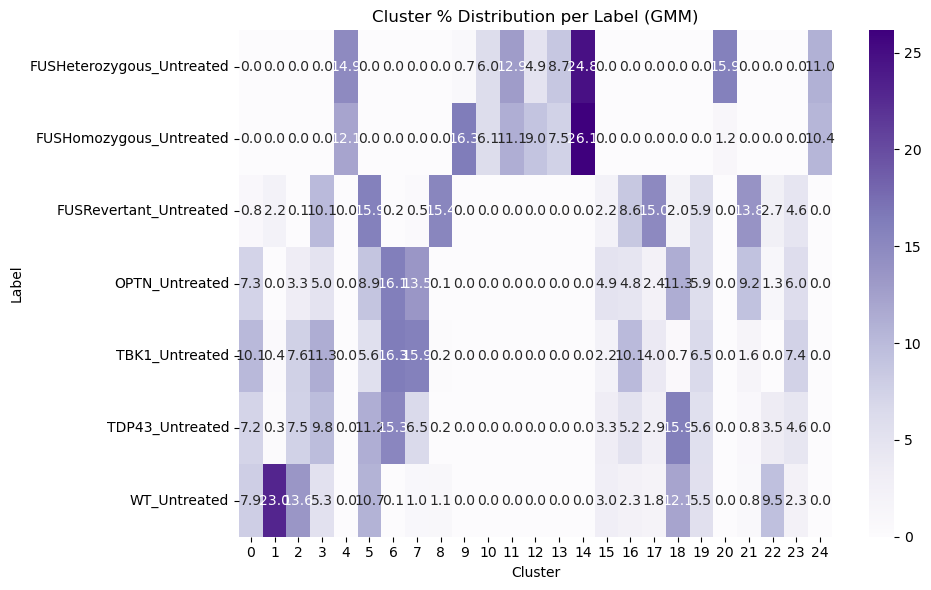

In [34]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False, True],
    cluster_range=[25],
    method = 'gmm'
)

Running: PCA=True, Normalize=False, Balance=False, Clusters=25


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


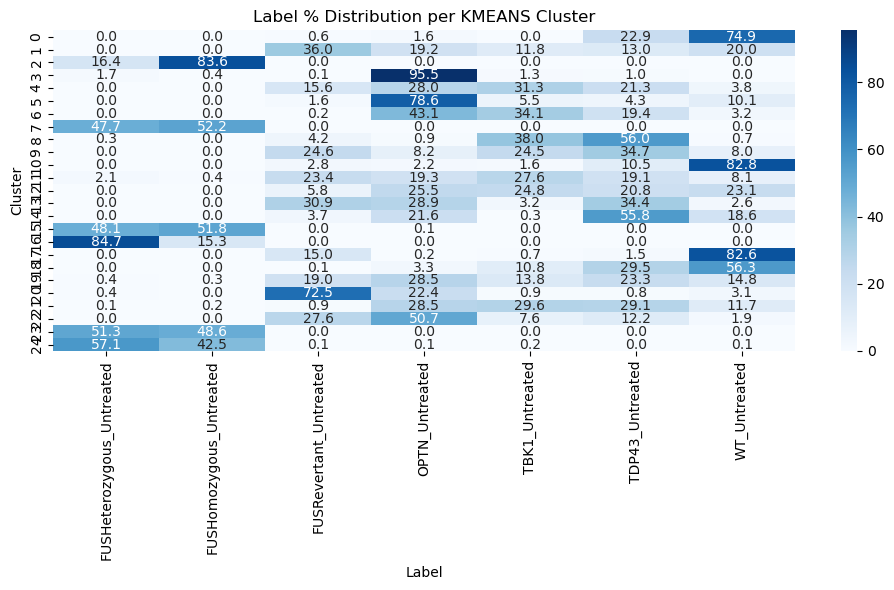

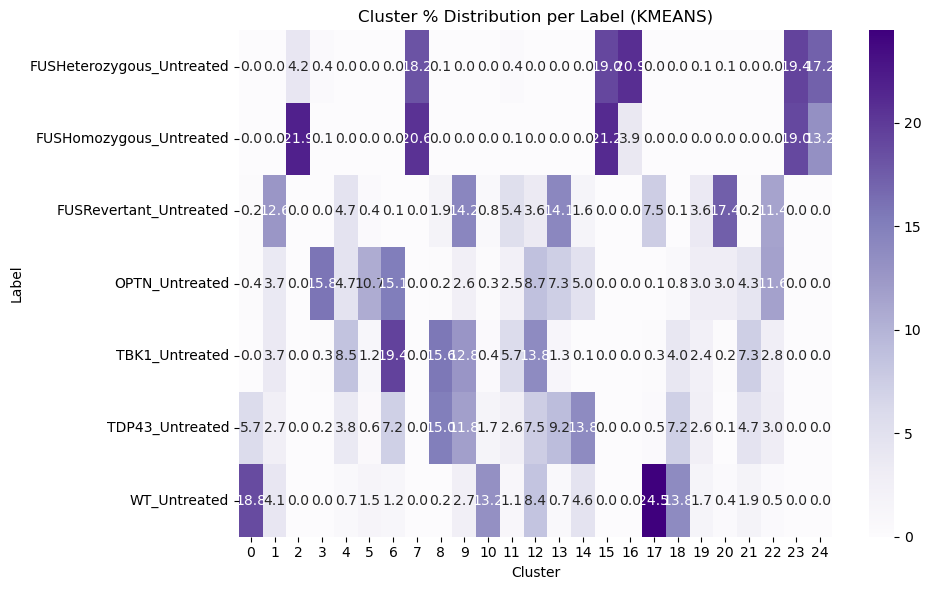

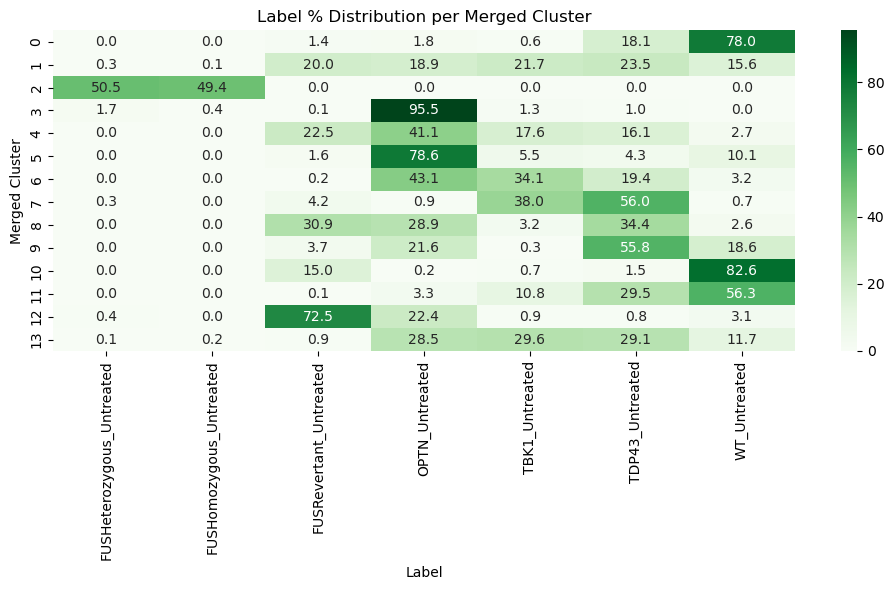

Running: PCA=True, Normalize=False, Balance=True, Clusters=25


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


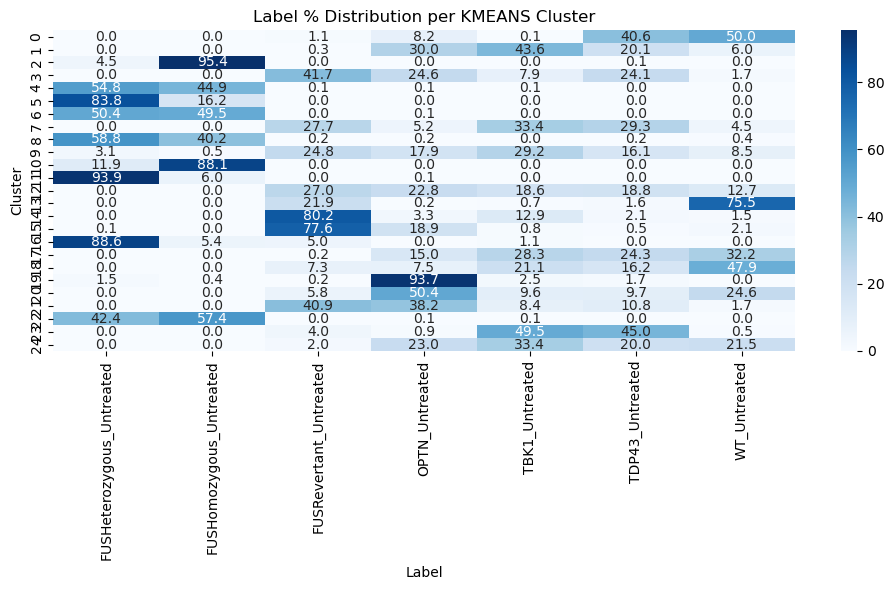

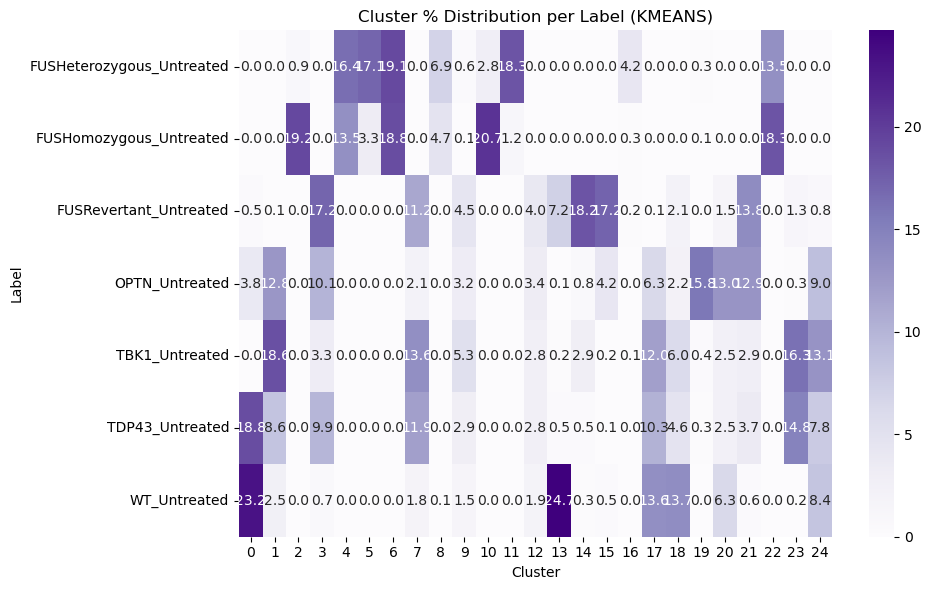

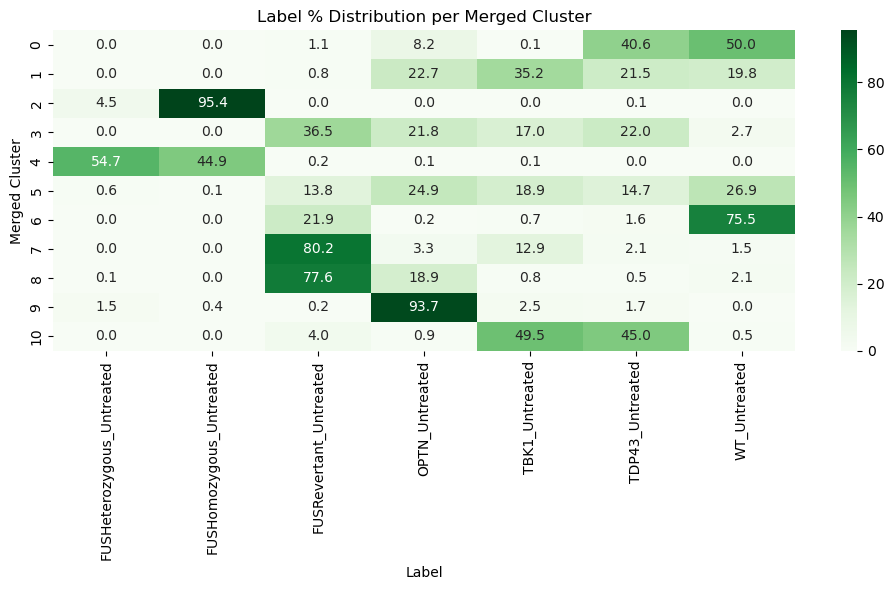

In [40]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False, True],
    cluster_range=[25],
    method = 'kmeans'
)

Running: PCA=True, Normalize=False, Balance=True, Clusters=50


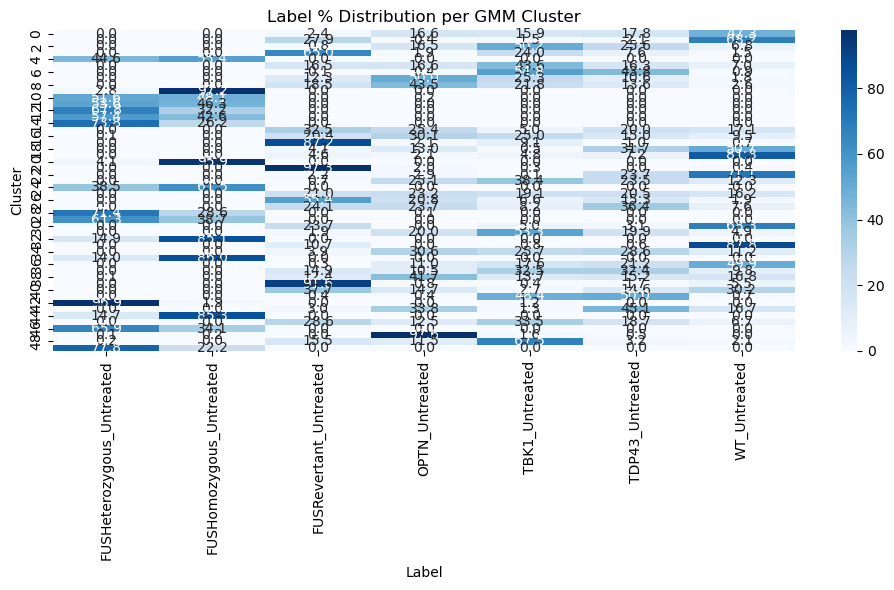

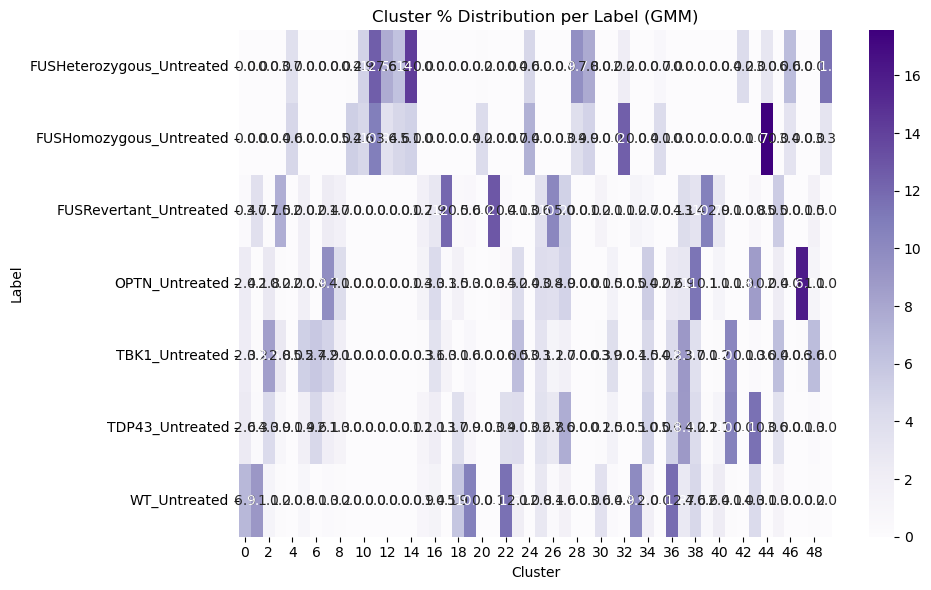

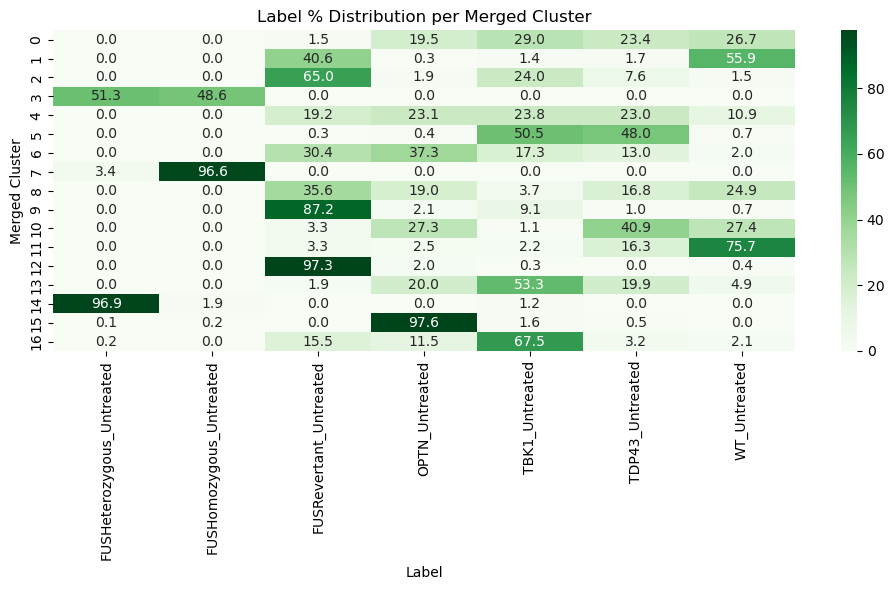

Running: PCA=True, Normalize=False, Balance=False, Clusters=50


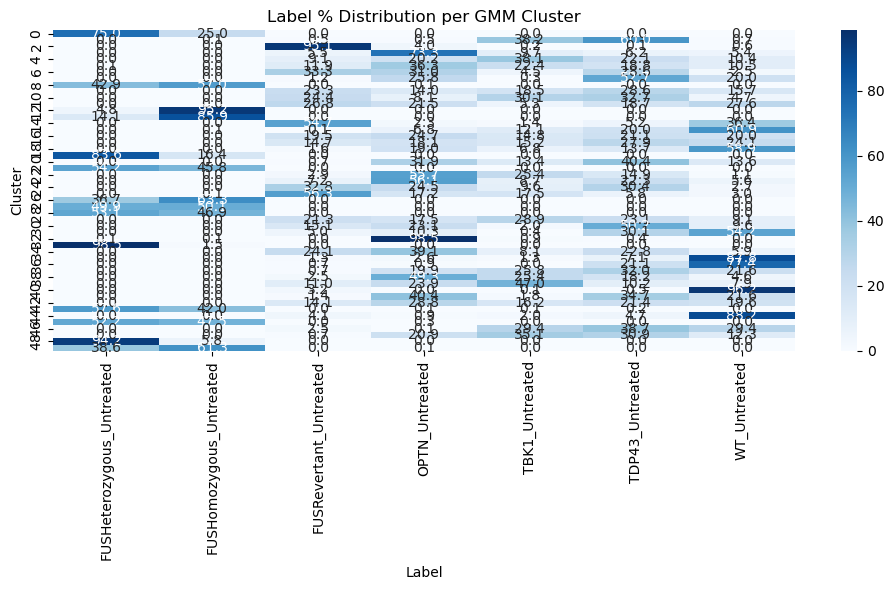

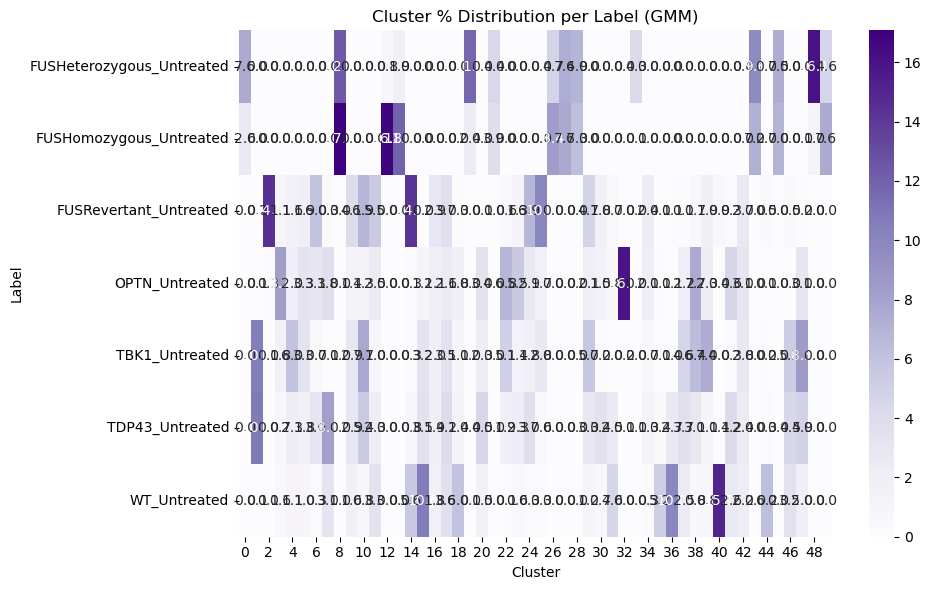

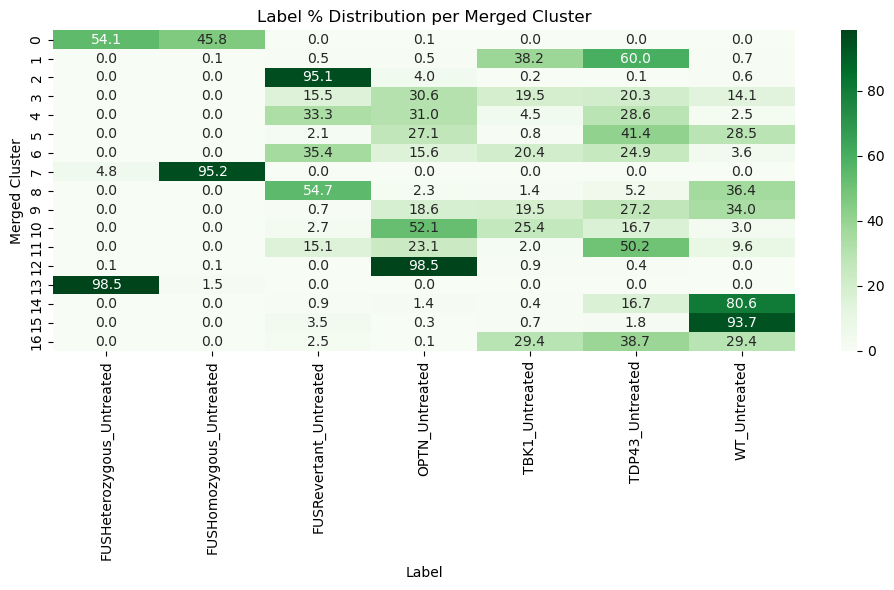

In [41]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[True, False],
    cluster_range=[50],
    method = 'gmm'
)

Running: PCA=True, Normalize=False, Balance=True, Clusters=50


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


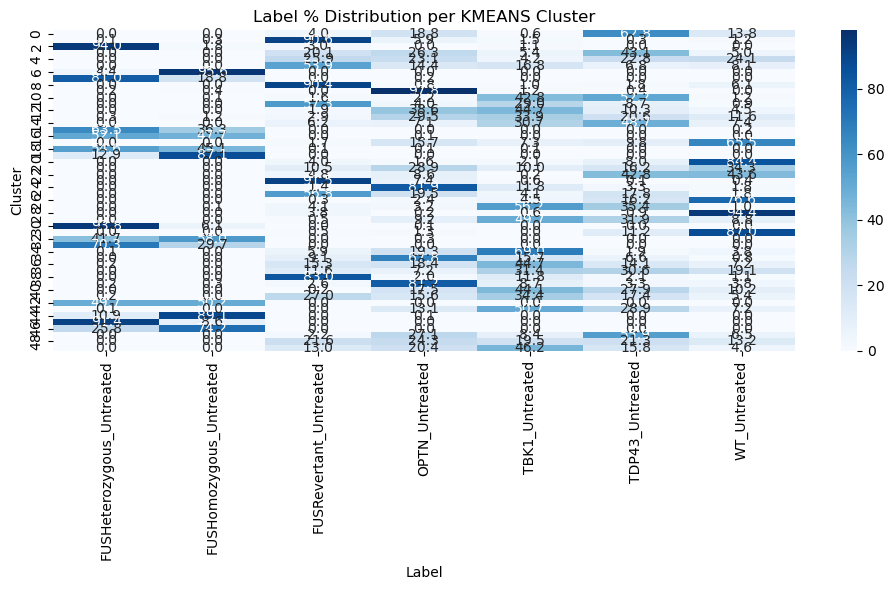

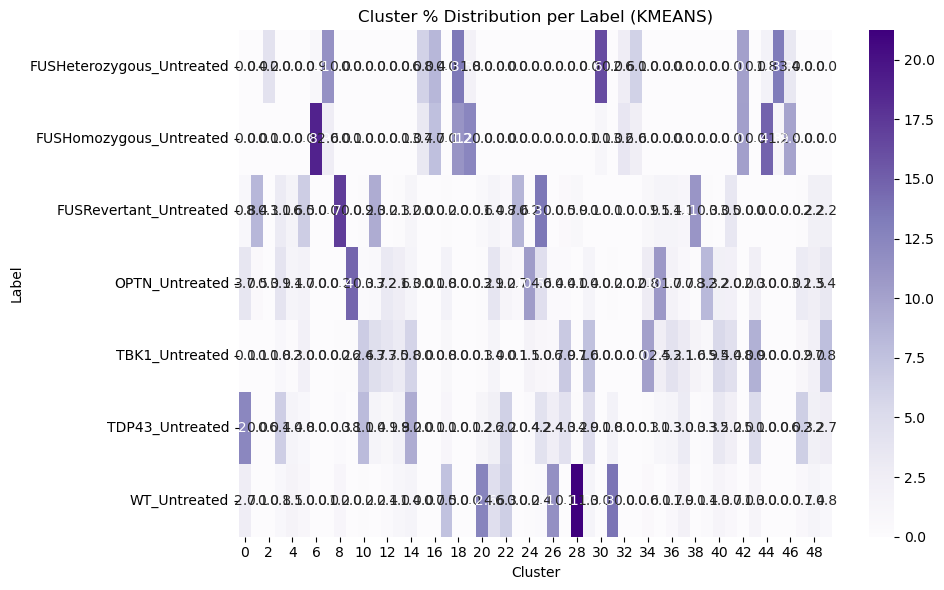

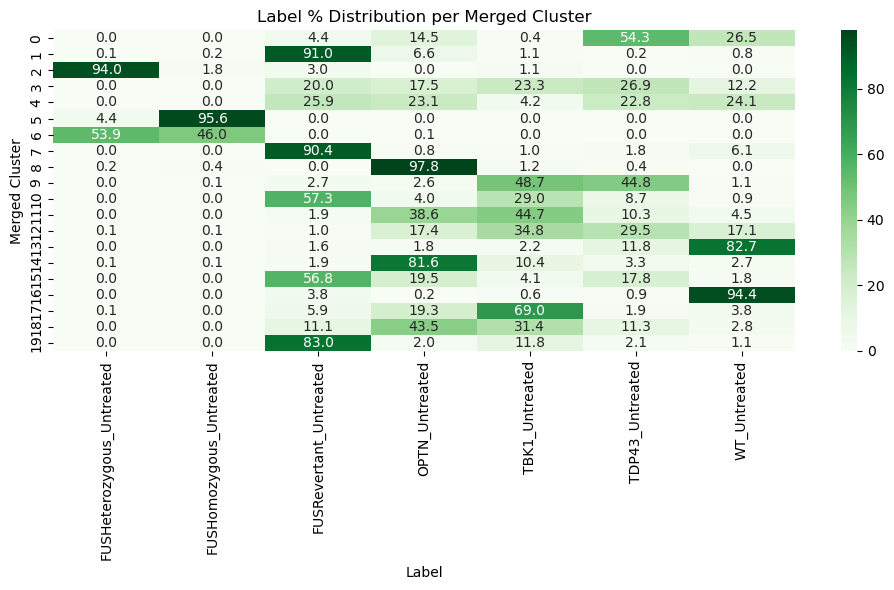

Running: PCA=True, Normalize=False, Balance=False, Clusters=50


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


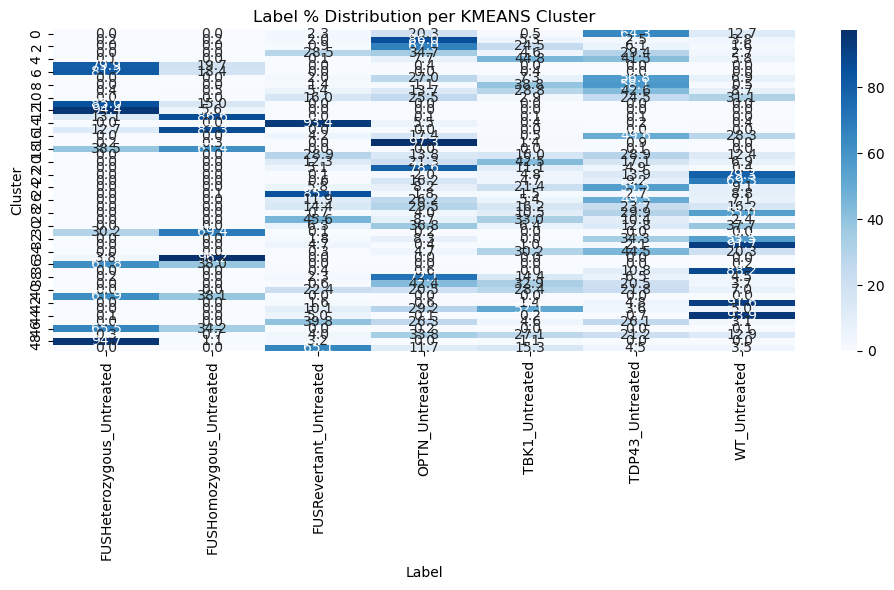

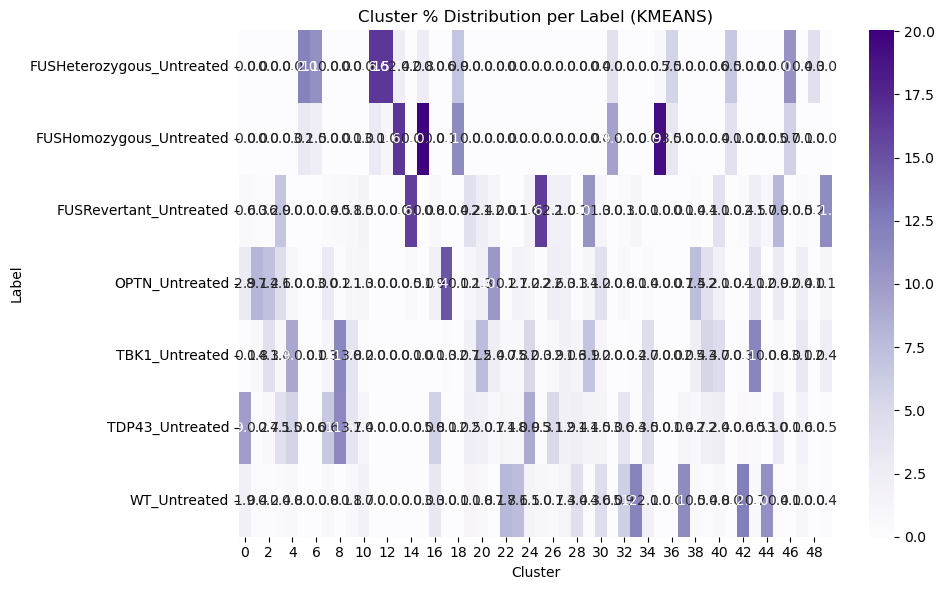

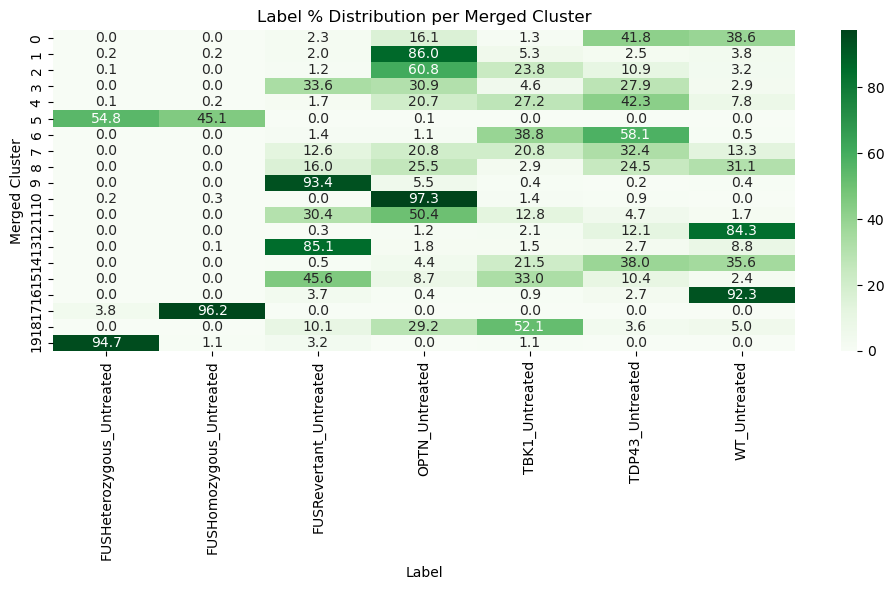

In [42]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[True, False],
    cluster_range=[50],
    method = 'kmeans'
)

Running: PCA=True, Normalize=False, Balance=False, Clusters=30


/home/projects/hornsteinlab/galavir/.conda/envs/nova/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


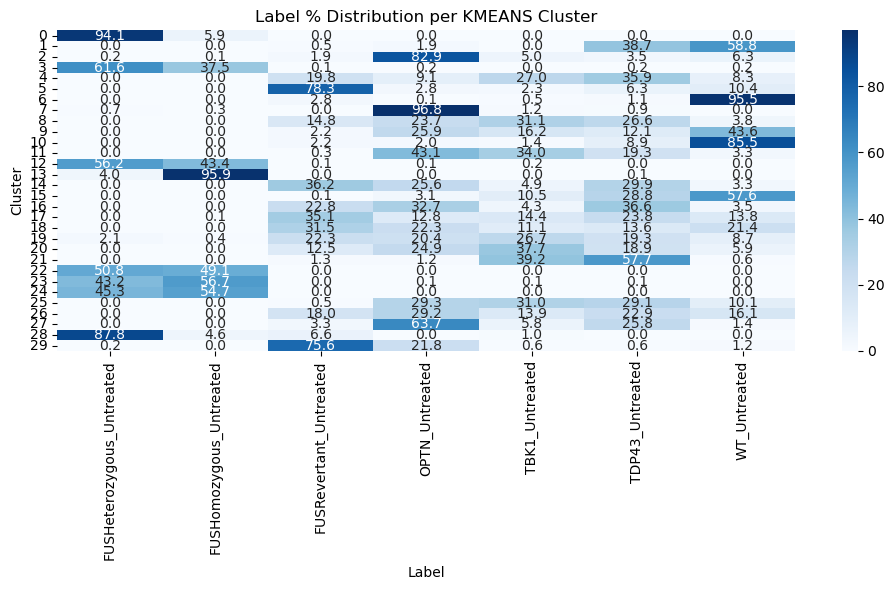

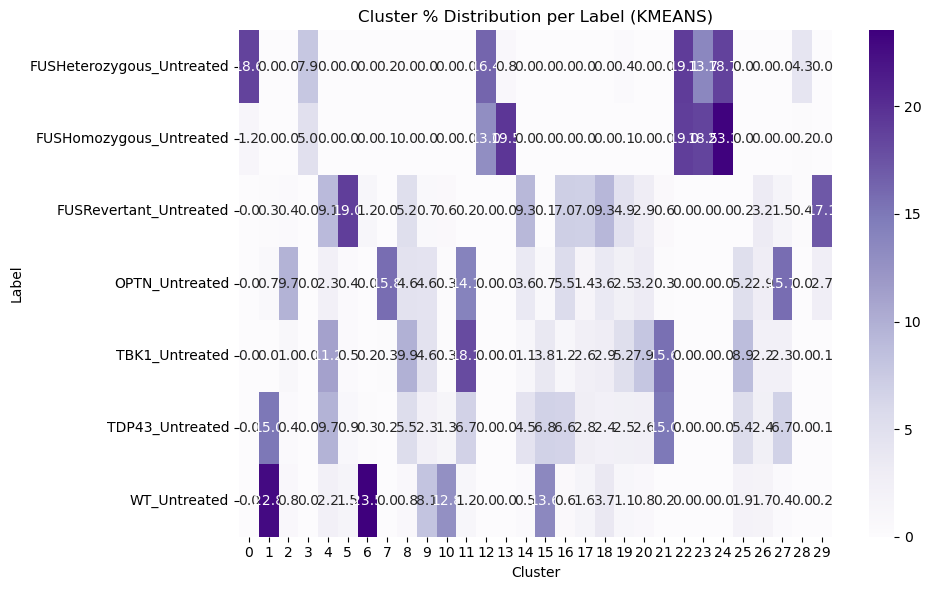

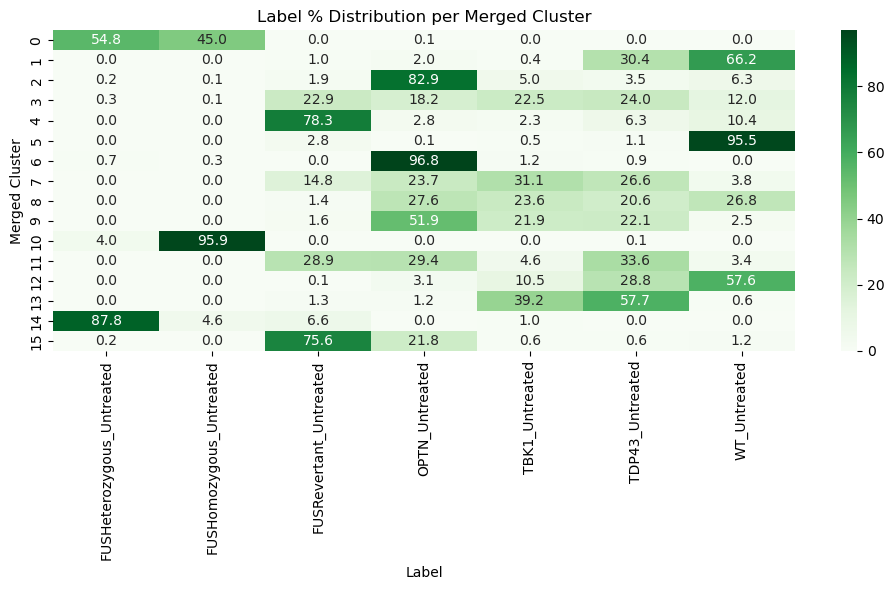

In [43]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False],
    cluster_range=[30],
    method = 'kmeans'
)

Running: PCA=True, Normalize=False, Balance=False, Clusters=30


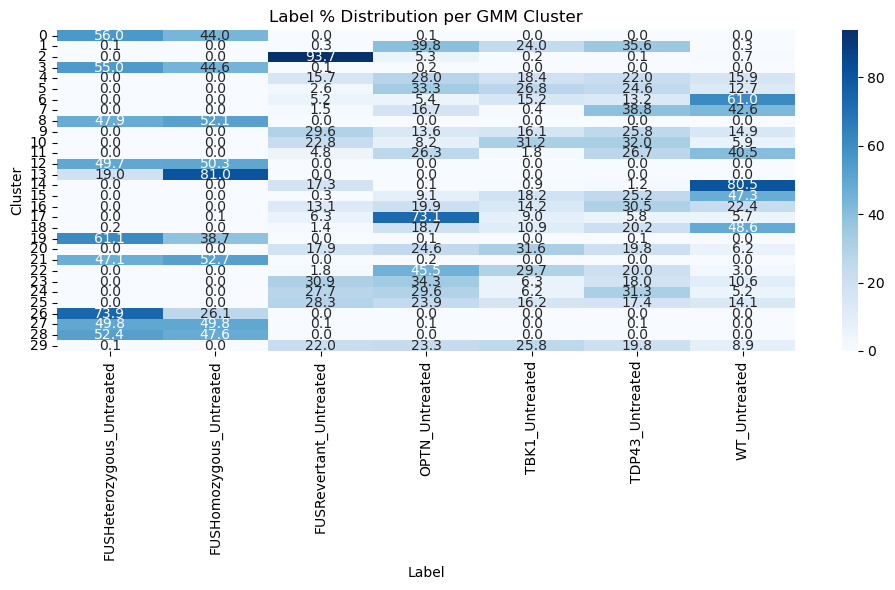

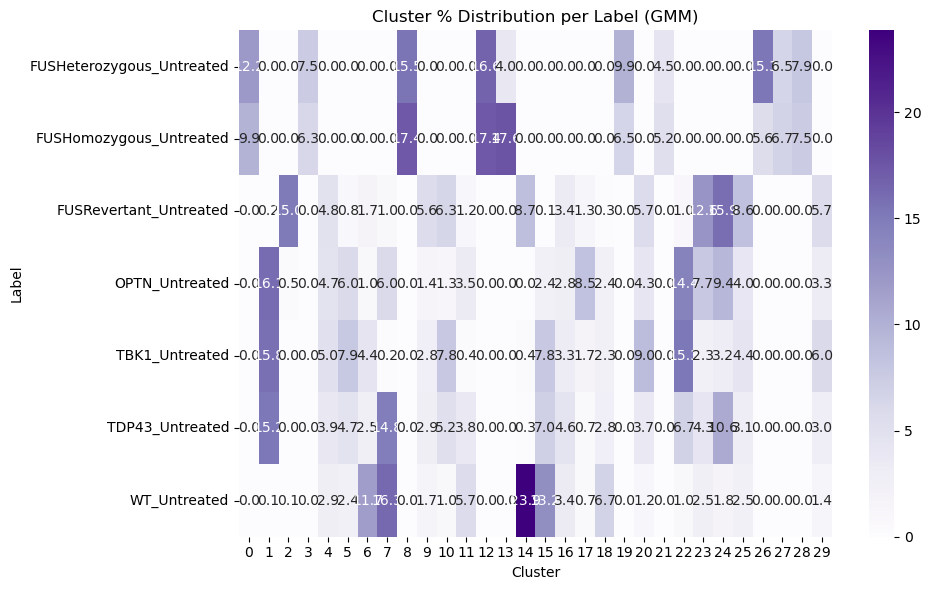

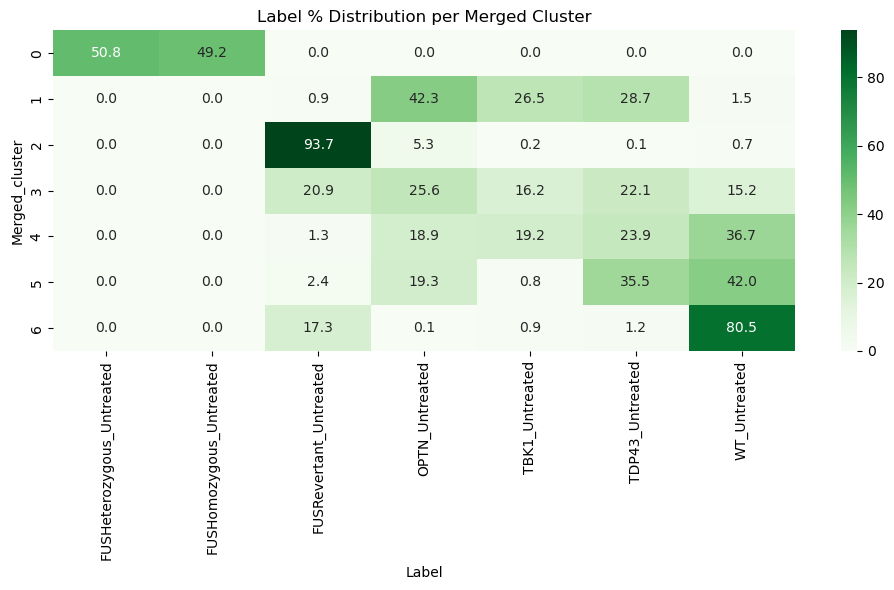

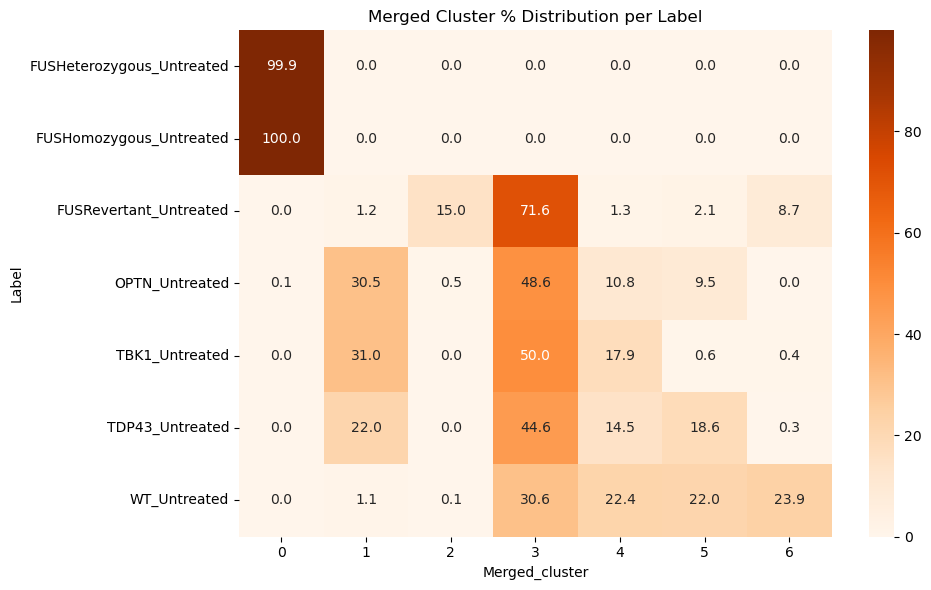

In [47]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False],
    cluster_range=[30],
    method = 'gmm'
)

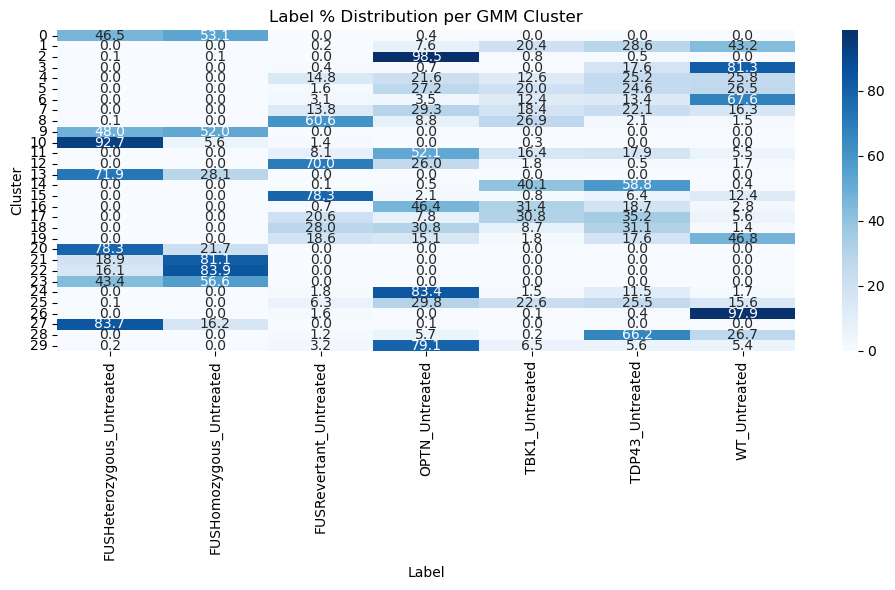

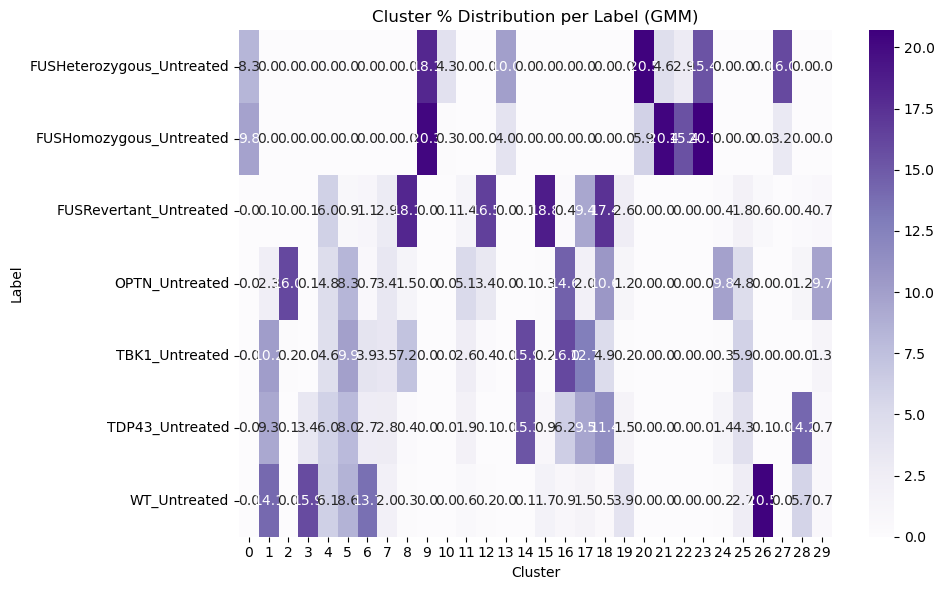

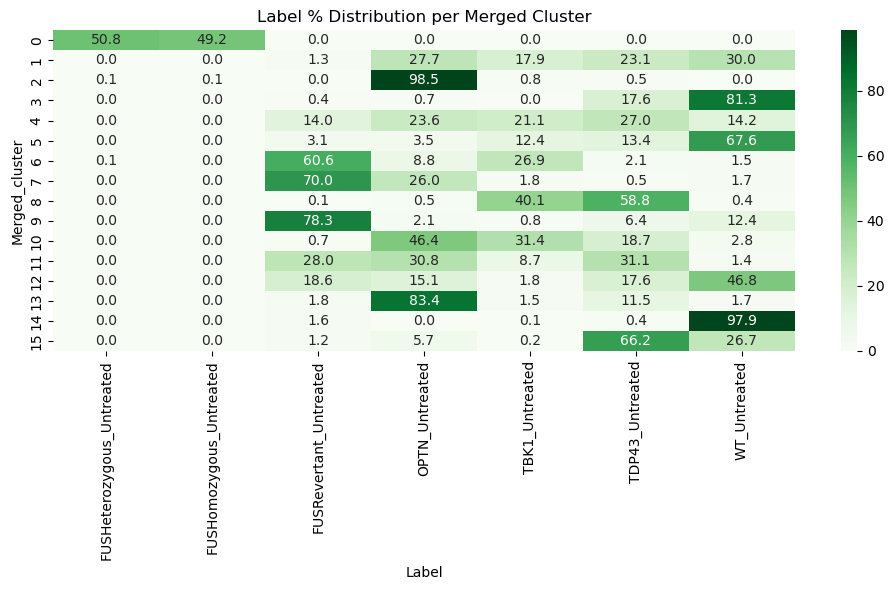

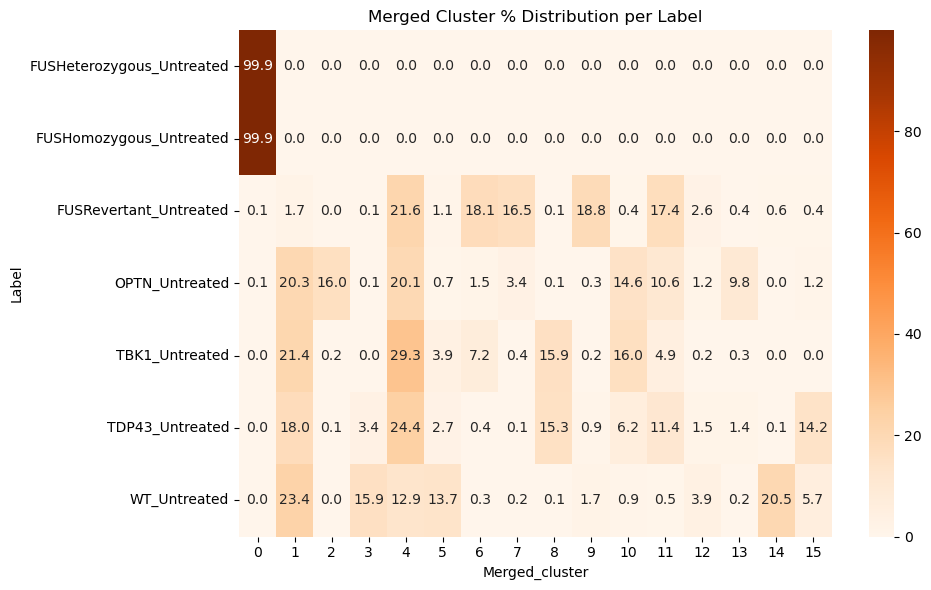

In [46]:
df, _, _ = run_clustering(batches=[1, 2, 3, 8, 9, 10], 
                          method='gmm', 
                          cluster_kwargs={'n_components': 30},
                          normalize=False, 
                          balance=False, 
                          apply_pca=True,
                         pca_components = 100)

Running: PCA=True, Normalize=False, Balance=False, Clusters=100


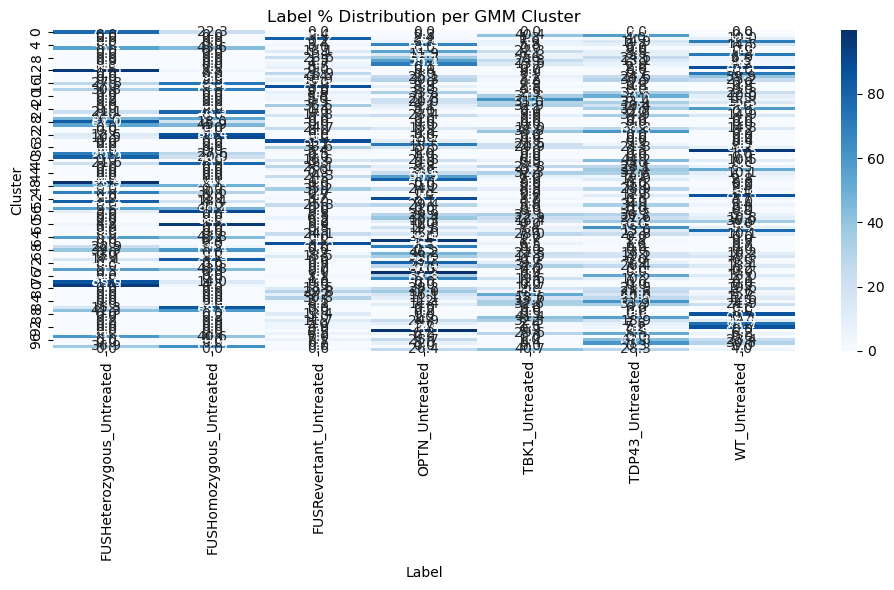

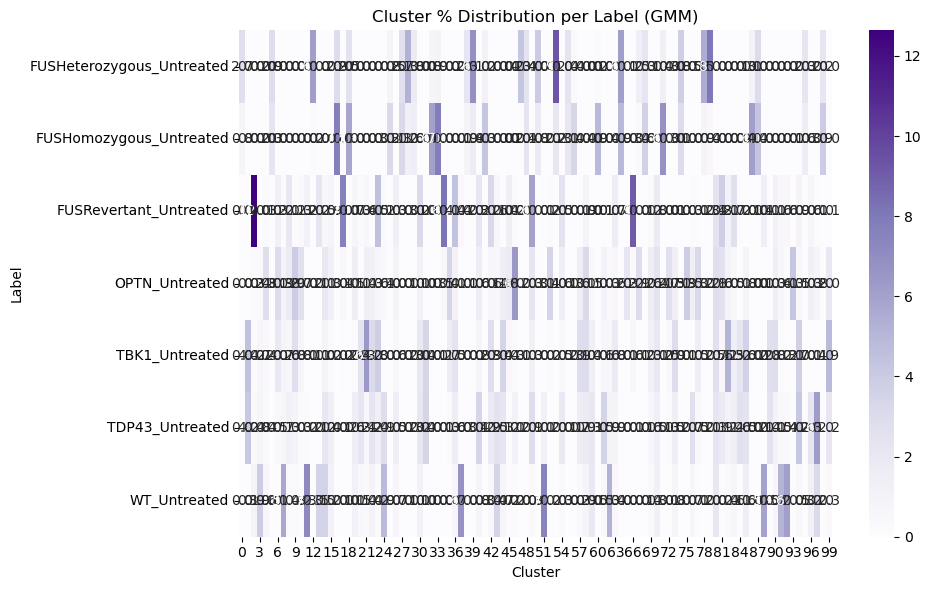

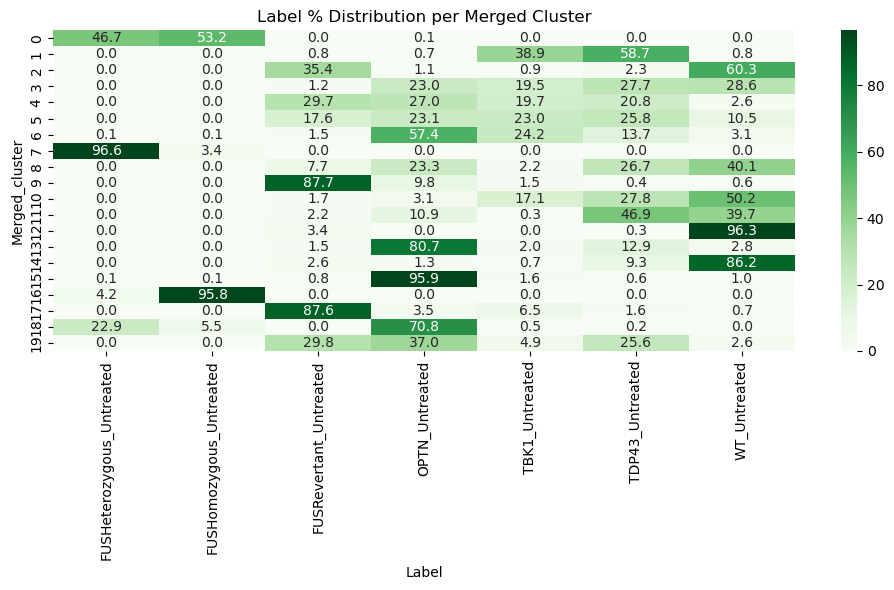

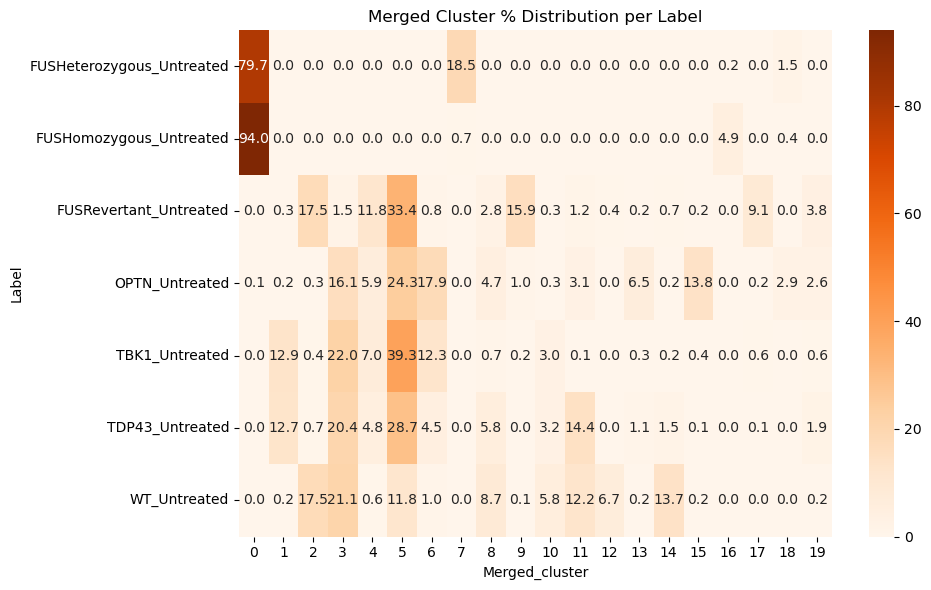

In [48]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False],
    cluster_range=[100],
    method = 'gmm'
)

Running: PCA=True, Normalize=False, Balance=False, Clusters=50


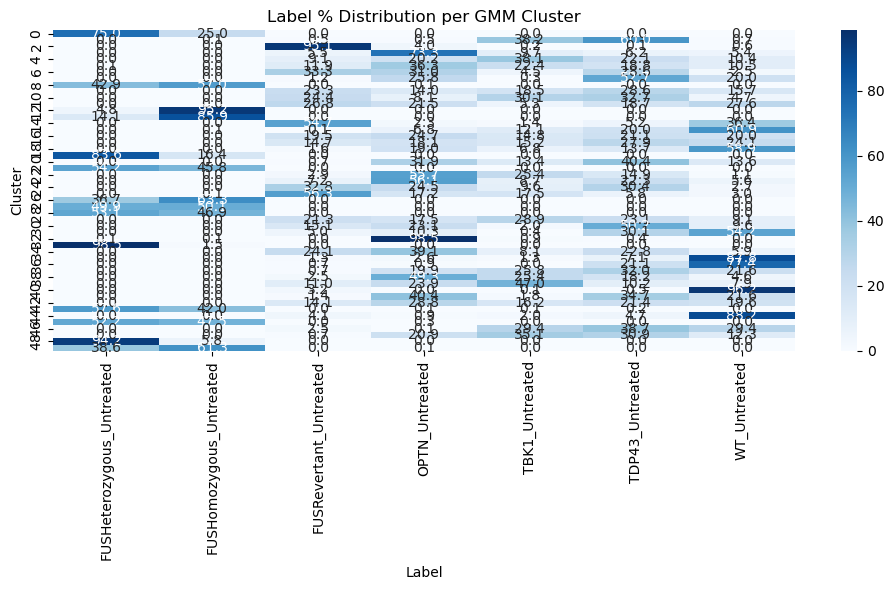

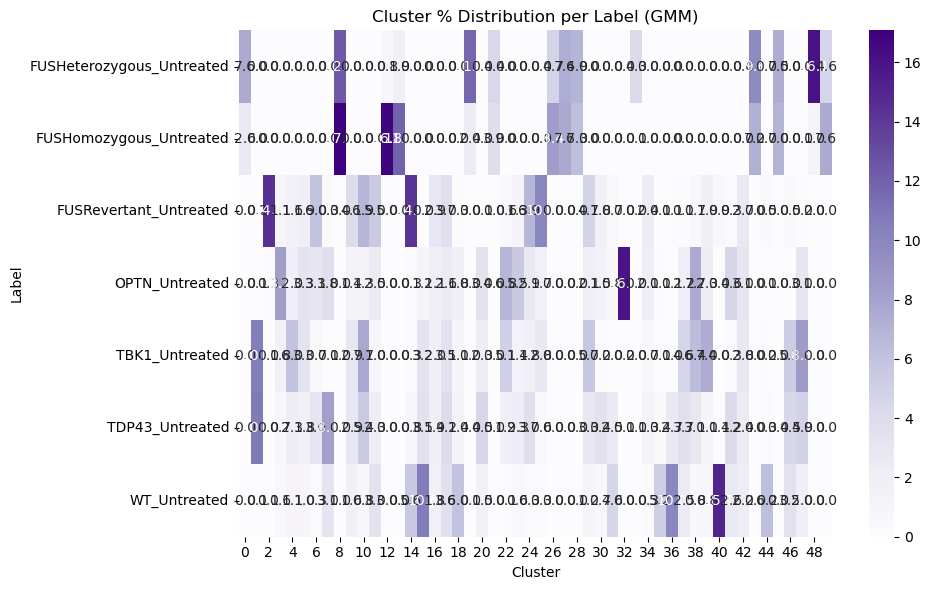

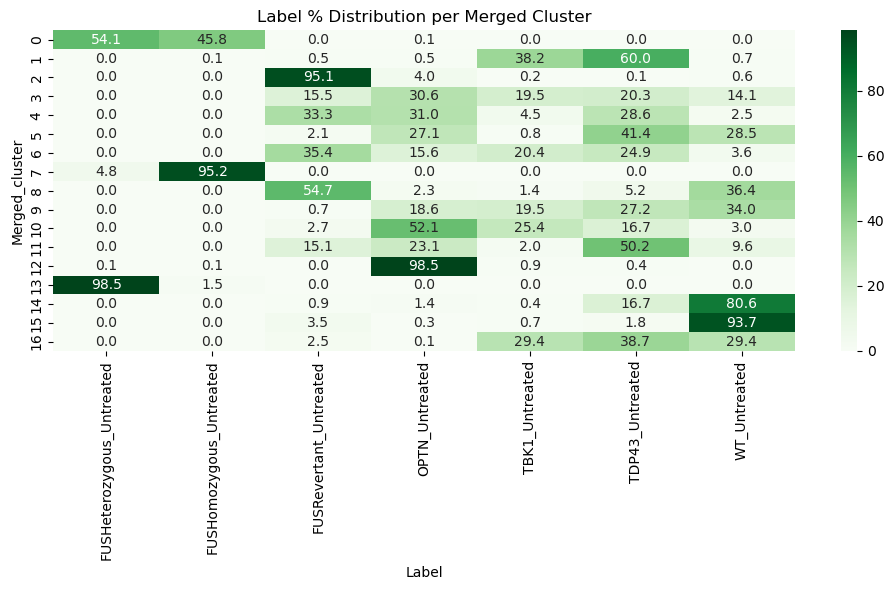

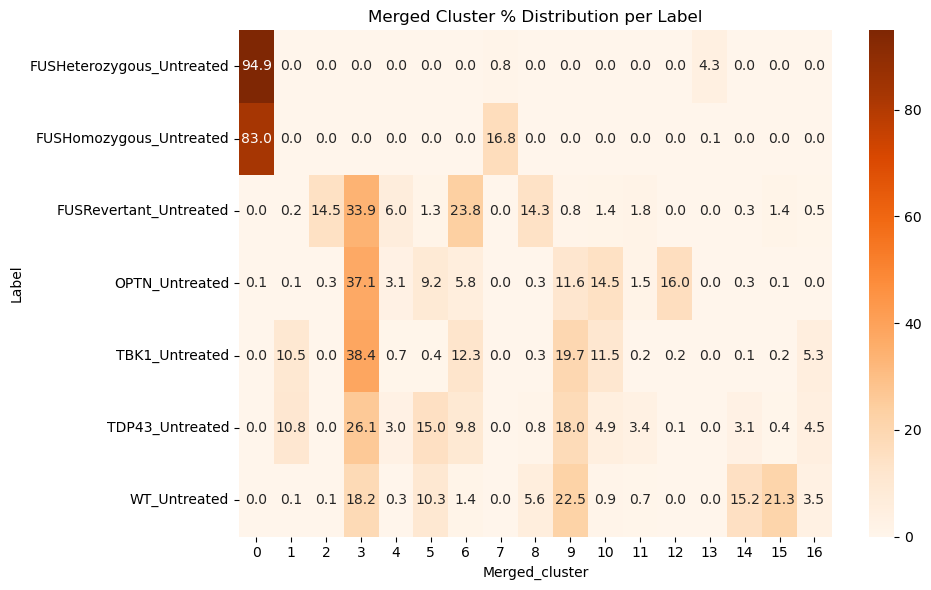

In [49]:
results_df_GMM_more = run_cluster_eval(
    batches=[1, 2, 3, 8, 9, 10],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False],
    cluster_range=[50],
    method = 'gmm'
)

In [ ]:
results_df_GMM_more = run_cluster_eval(
    batches=[1],
    pca_options=[True],
    norm_options=[False],
    balance_options=[False],
    cluster_range=[25,50],
    method = 'gmm'
)

In [ ]:
print('tets')